In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)     

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

C:\Users\User\AppData\Local\Temp\ipykernel_89740\4164614309.py:383: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.42725031 0.69695044 0.32924264 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.51683609 0.42215989 ... 0.66276202 0.49013564 0.22934649]
 [0.43218249 0.62674714 0.3411641  ... 0.37854501 0.40197287 0.23181258]
 ...
 [0.47102343 0.46473952 0.46949509 ... 0.43218249 0.47163995 0.33908755]
 [0.43464858 0.51620076 0.3997195  ... 0.51911221 0.46300863 0.21454994]
 [0.44389642 0.52414231 0.42356241 ... 0.50184957 0.52034525 0.30641184]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.43464858 0.62313675 0.34639831 ... 0.38902589 0.41122072 0.1701603 ]
 [0.42725031 0.71548931 0.32450565 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.53175632 0.4180791  ... 0.66276202 0.49013564 0.22934649]
 ...
 [0.47102343 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 03:57:53,762] A new study created in memory with name: no-name-c3d19e64-5baa-4f87-80f0-4510fa4f5d8f
[I 2025-05-18 04:05:28,710] Trial 0 finished with value: 0.08733056783676148 and parameters: {'lr': 0.006852772587838959, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24291603209456925}. Best is trial 0 with value: 0.08733056783676148.


Cross Validation Accuracies:
[0.0870104432106018, 0.08195406198501587, 0.10535269230604172, 0.08527377247810364, 0.07706186920404434]
Mean Cross Validation Accuracy:
0.08733056783676148
Standard Deviation of Cross Validation Accuracy:
0.009627905733785738


[I 2025-05-18 04:11:02,200] Trial 1 finished with value: 0.06515960693359375 and parameters: {'lr': 0.034521967987560485, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.126616018619194}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.0586191862821579, 0.060745421797037125, 0.07266683131456375, 0.0740114226937294, 0.059755172580480576]
Mean Cross Validation Accuracy:
0.06515960693359375
Standard Deviation of Cross Validation Accuracy:
0.006725817475255363


[I 2025-05-18 04:18:19,827] Trial 2 finished with value: 0.08201485127210617 and parameters: {'lr': 0.9671450393625394, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.19840189991171414}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.07461289316415787, 0.07596247643232346, 0.08993038535118103, 0.08309178799390793, 0.08647671341896057]
Mean Cross Validation Accuracy:
0.08201485127210617
Standard Deviation of Cross Validation Accuracy:
0.005918511828328963


[I 2025-05-18 04:25:51,734] Trial 3 finished with value: 0.07097347155213356 and parameters: {'lr': 0.002093375360864706, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25039931514661645}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.0591355562210083, 0.06806645542383194, 0.08030017465353012, 0.08669491857290268, 0.06067025288939476]
Mean Cross Validation Accuracy:
0.07097347155213356
Standard Deviation of Cross Validation Accuracy:
0.01085259954239311


[I 2025-05-18 04:30:31,259] Trial 4 finished with value: 0.09490444511175156 and parameters: {'lr': 0.009893087760109803, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.49491515706269795}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.09857993572950363, 0.08530549705028534, 0.08563227951526642, 0.11095461249351501, 0.09404990077018738]
Mean Cross Validation Accuracy:
0.09490444511175156
Standard Deviation of Cross Validation Accuracy:
0.009486413537590221


[I 2025-05-18 04:38:55,091] Trial 5 finished with value: 0.08080743551254273 and parameters: {'lr': 0.005952388095858344, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3717952348048309}. Best is trial 1 with value: 0.06515960693359375.


Cross Validation Accuracies:
[0.07911556959152222, 0.07102717459201813, 0.07945657521486282, 0.0941181406378746, 0.08031971752643585]
Mean Cross Validation Accuracy:
0.08080743551254273
Standard Deviation of Cross Validation Accuracy:
0.007453233892473891


[I 2025-05-18 04:44:38,687] Trial 6 finished with value: 0.0644819788634777 and parameters: {'lr': 0.031226496051293618, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.29365858571850323}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05829097330570221, 0.0603116899728775, 0.07220349460840225, 0.07324053347110748, 0.05836320295929909]
Mean Cross Validation Accuracy:
0.0644819788634777
Standard Deviation of Cross Validation Accuracy:
0.006774855895544612


[I 2025-05-18 04:51:22,810] Trial 7 finished with value: 0.06480574756860732 and parameters: {'lr': 0.01170830720249485, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3795764149546029}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058910056948661804, 0.06102729216217995, 0.072336845099926, 0.07301124930381775, 0.05874329432845116]
Mean Cross Validation Accuracy:
0.06480574756860732
Standard Deviation of Cross Validation Accuracy:
0.006478223848962451


[I 2025-05-18 04:56:10,559] Trial 8 finished with value: 0.06597714424133301 and parameters: {'lr': 0.05582184353873265, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11961414422554642}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05926438421010971, 0.06191624701023102, 0.07341498136520386, 0.07301132380962372, 0.062278784811496735]
Mean Cross Validation Accuracy:
0.06597714424133301
Standard Deviation of Cross Validation Accuracy:
0.006000516632937694


[I 2025-05-18 05:02:44,960] Trial 9 finished with value: 0.06733584403991699 and parameters: {'lr': 0.6044366212481619, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.23832766659508464}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05363680422306061, 0.06297479569911957, 0.0763048455119133, 0.07751186192035675, 0.06625091284513474]
Mean Cross Validation Accuracy:
0.06733584403991699
Standard Deviation of Cross Validation Accuracy:
0.00885272655784309


[I 2025-05-18 05:09:06,849] Trial 10 finished with value: 1.9088381290435792 and parameters: {'lr': 0.1389436780266168, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.32586627420135345}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[1.6955386400222778, 1.895651936531067, 2.158759832382202, 1.9801356792449951, 1.8141045570373535]
Mean Cross Validation Accuracy:
1.9088381290435792
Standard Deviation of Cross Validation Accuracy:
0.15632606680856914


[I 2025-05-18 05:13:30,788] Trial 11 finished with value: 0.06498941481113434 and parameters: {'lr': 0.016946557795890143, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.42225344950172605}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06000598892569542, 0.06117194518446922, 0.07245074212551117, 0.07298538088798523, 0.05833301693201065]
Mean Cross Validation Accuracy:
0.06498941481113434
Standard Deviation of Cross Validation Accuracy:
0.006376866306043929


[I 2025-05-18 05:20:03,208] Trial 12 finished with value: 0.6170796871185302 and parameters: {'lr': 0.0010141466224767401, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.353580364513228}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.5924214720726013, 0.6659021377563477, 0.592002809047699, 0.5024327635765076, 0.7326392531394958]
Mean Cross Validation Accuracy:
0.6170796871185302
Standard Deviation of Cross Validation Accuracy:
0.0776124209723122


[I 2025-05-18 05:26:46,111] Trial 13 finished with value: 0.06486959904432296 and parameters: {'lr': 0.10457424080830446, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4256735699539732}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05343516170978546, 0.062068238854408264, 0.07276741415262222, 0.07398679852485657, 0.06209038197994232]
Mean Cross Validation Accuracy:
0.06486959904432296
Standard Deviation of Cross Validation Accuracy:
0.007639592049511162


[I 2025-05-18 05:33:13,745] Trial 14 finished with value: 0.06505416855216026 and parameters: {'lr': 0.019325309290182217, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2918771730957758}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05933903157711029, 0.06079639121890068, 0.07251892238855362, 0.07364854961633682, 0.0589679479598999]
Mean Cross Validation Accuracy:
0.06505416855216026
Standard Deviation of Cross Validation Accuracy:
0.006594231953382932


[I 2025-05-18 05:40:31,070] Trial 15 finished with value: 0.07621315121650696 and parameters: {'lr': 0.22989569172414914, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4033363962662422}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.059532009065151215, 0.08304080367088318, 0.08214428275823593, 0.08961466699838638, 0.06673399358987808]
Mean Cross Validation Accuracy:
0.07621315121650696
Standard Deviation of Cross Validation Accuracy:
0.011220612438180181


[I 2025-05-18 05:45:57,633] Trial 16 finished with value: 0.07543852031230927 and parameters: {'lr': 0.004091668905436434, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.47940198968798264}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.08500225841999054, 0.06620180606842041, 0.07670953869819641, 0.0813688263297081, 0.06791017204523087]
Mean Cross Validation Accuracy:
0.07543852031230927
Standard Deviation of Cross Validation Accuracy:
0.007351761985310142


[I 2025-05-18 05:52:46,867] Trial 17 finished with value: 0.06480916440486909 and parameters: {'lr': 0.05104446424669211, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30291325847760037}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05878270044922829, 0.06098467484116554, 0.07224367558956146, 0.07236979156732559, 0.059664979577064514]
Mean Cross Validation Accuracy:
0.06480916440486909
Standard Deviation of Cross Validation Accuracy:
0.0061618611704438945


[I 2025-05-18 05:57:25,174] Trial 18 finished with value: 0.06473578959703445 and parameters: {'lr': 0.01806458508841983, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20201657252409821}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05854441225528717, 0.06104561313986778, 0.072163425385952, 0.07302520424127579, 0.058900292962789536]
Mean Cross Validation Accuracy:
0.06473578959703445
Standard Deviation of Cross Validation Accuracy:
0.006479008337673043


[I 2025-05-18 06:03:56,144] Trial 19 finished with value: 1.3457515478134154 and parameters: {'lr': 0.020902851908805593, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.1782580601487516}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[1.3513787984848022, 1.5079224109649658, 1.4588007926940918, 1.1496223211288452, 1.2610334157943726]
Mean Cross Validation Accuracy:
1.3457515478134154
Standard Deviation of Cross Validation Accuracy:
0.13019602300086755


[I 2025-05-18 06:10:14,749] Trial 20 finished with value: 0.25556874871253965 and parameters: {'lr': 0.0029051925969288605, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16956730056691016}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.3440645933151245, 0.16777995228767395, 0.1861828863620758, 0.27395984530448914, 0.30585646629333496]
Mean Cross Validation Accuracy:
0.25556874871253965
Standard Deviation of Cross Validation Accuracy:
0.06814671255036316


[I 2025-05-18 06:15:58,937] Trial 21 finished with value: 0.06500409469008446 and parameters: {'lr': 0.012805913323055376, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.28208057378244256}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05922934040427208, 0.06132577359676361, 0.07248660922050476, 0.0731114000082016, 0.05886735022068024]
Mean Cross Validation Accuracy:
0.06500409469008446
Standard Deviation of Cross Validation Accuracy:
0.006422676841145945


[I 2025-05-18 06:20:42,601] Trial 22 finished with value: 0.06538009494543076 and parameters: {'lr': 0.03565152732637164, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3467150813039088}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06045181676745415, 0.060752298682928085, 0.07207204401493073, 0.07403423637151718, 0.05959007889032364]
Mean Cross Validation Accuracy:
0.06538009494543076
Standard Deviation of Cross Validation Accuracy:
0.006307218977277371


[I 2025-05-18 06:25:32,377] Trial 23 finished with value: 0.06463759243488312 and parameters: {'lr': 0.06766935319160063, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22052100405669145}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.055232394486665726, 0.061835531145334244, 0.0731724202632904, 0.07296077162027359, 0.059986844658851624]
Mean Cross Validation Accuracy:
0.06463759243488312
Standard Deviation of Cross Validation Accuracy:
0.007211897789132559


[I 2025-05-18 06:30:40,917] Trial 24 finished with value: 0.06516145914793015 and parameters: {'lr': 0.08106014160961159, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20893523577176967}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06109489127993584, 0.06030638515949249, 0.07237853109836578, 0.07453367859125137, 0.05749380961060524]
Mean Cross Validation Accuracy:
0.06516145914793015
Standard Deviation of Cross Validation Accuracy:
0.006911240003313152


[I 2025-05-18 06:36:46,866] Trial 25 finished with value: 0.07158823907375336 and parameters: {'lr': 0.22440637143170364, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.26983303101694267}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.0691615417599678, 0.06491498649120331, 0.07400091737508774, 0.07732764631509781, 0.07253610342741013]
Mean Cross Validation Accuracy:
0.07158823907375336
Standard Deviation of Cross Validation Accuracy:
0.004244559312435272


[I 2025-05-18 06:42:28,138] Trial 26 finished with value: 0.06496029049158096 and parameters: {'lr': 0.028061684810528235, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2145115928108312}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058061037212610245, 0.06152840703725815, 0.07235881686210632, 0.07367153465747833, 0.05918165668845177]
Mean Cross Validation Accuracy:
0.06496029049158096
Standard Deviation of Cross Validation Accuracy:
0.00668422165783497


[I 2025-05-18 06:49:22,360] Trial 27 finished with value: 0.06572922840714454 and parameters: {'lr': 0.1778334342515709, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.14716446195915397}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058129455894231796, 0.06782189011573792, 0.07462859153747559, 0.07151759415864944, 0.05654861032962799]
Mean Cross Validation Accuracy:
0.06572922840714454
Standard Deviation of Cross Validation Accuracy:
0.007198935556852156


[I 2025-05-18 06:56:10,786] Trial 28 finished with value: 0.1992583990097046 and parameters: {'lr': 0.38057637486619605, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.16339182615816195}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.19409805536270142, 0.1897234320640564, 0.21195149421691895, 0.1977914422750473, 0.2027275711297989]
Mean Cross Validation Accuracy:
0.1992583990097046
Standard Deviation of Cross Validation Accuracy:
0.0076530585311935725


[I 2025-05-18 07:02:00,192] Trial 29 finished with value: 0.372409325838089 and parameters: {'lr': 0.0652285275477742, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.23406374797141943}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.3262183368206024, 0.5201787948608398, 0.31830766797065735, 0.31494101881980896, 0.3824008107185364]
Mean Cross Validation Accuracy:
0.372409325838089
Standard Deviation of Cross Validation Accuracy:
0.07784452313085027


[I 2025-05-18 07:07:26,311] Trial 30 finished with value: 0.1076286941766739 and parameters: {'lr': 0.036619750449104635, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25922671720000695}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.09915215522050858, 0.1107976883649826, 0.11185193806886673, 0.11418798565864563, 0.1021537035703659]
Mean Cross Validation Accuracy:
0.1076286941766739
Standard Deviation of Cross Validation Accuracy:
0.005877582031728598


[I 2025-05-18 07:15:11,829] Trial 31 finished with value: 0.06494279056787491 and parameters: {'lr': 0.007416332774918687, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3912393111493974}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05908488854765892, 0.061521515250205994, 0.07226014137268066, 0.07303650677204132, 0.05881090089678764]
Mean Cross Validation Accuracy:
0.06494279056787491
Standard Deviation of Cross Validation Accuracy:
0.006366664379568082


[I 2025-05-18 07:22:41,586] Trial 32 finished with value: 0.06472141891717911 and parameters: {'lr': 0.011810692769369515, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3359129458147553}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05866983160376549, 0.061385490000247955, 0.07224424183368683, 0.07274409383535385, 0.058563437312841415]
Mean Cross Validation Accuracy:
0.06472141891717911
Standard Deviation of Cross Validation Accuracy:
0.006428484201830031


[I 2025-05-18 07:27:59,625] Trial 33 finished with value: 0.06496279910206795 and parameters: {'lr': 0.024475274534672485, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3198000461272283}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05808740481734276, 0.06198922172188759, 0.07255138456821442, 0.07327629625797272, 0.058909688144922256]
Mean Cross Validation Accuracy:
0.06496279910206795
Standard Deviation of Cross Validation Accuracy:
0.006625016612871479


[I 2025-05-18 07:32:51,717] Trial 34 finished with value: 0.0650268018245697 and parameters: {'lr': 0.04123190857091856, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19113982359341888}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05959993600845337, 0.061029981821775436, 0.07265472412109375, 0.07323996722698212, 0.05860939994454384]
Mean Cross Validation Accuracy:
0.0650268018245697
Standard Deviation of Cross Validation Accuracy:
0.006515362984513155


[I 2025-05-18 07:39:36,169] Trial 35 finished with value: 0.06573347300291062 and parameters: {'lr': 0.007181800451130054, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22422872097237623}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.060380324721336365, 0.06273309886455536, 0.07347292453050613, 0.07283781468868256, 0.059243202209472656]
Mean Cross Validation Accuracy:
0.06573347300291062
Standard Deviation of Cross Validation Accuracy:
0.00616689285139581


[I 2025-05-18 07:45:01,052] Trial 36 finished with value: 0.1774233728647232 and parameters: {'lr': 0.014184539402860038, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.10293360221497799}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.10672786831855774, 0.21846117079257965, 0.2242792248725891, 0.20496338605880737, 0.13268521428108215]
Mean Cross Validation Accuracy:
0.1774233728647232
Standard Deviation of Cross Validation Accuracy:
0.0482439244866602


[I 2025-05-18 07:53:06,115] Trial 37 finished with value: 0.06495279669761658 and parameters: {'lr': 0.00482198670479718, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3125224603058566}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.058476146310567856, 0.06044933944940567, 0.0726715698838234, 0.07276160269975662, 0.06040532514452934]
Mean Cross Validation Accuracy:
0.06495279669761658
Standard Deviation of Cross Validation Accuracy:
0.006379099240924585


[I 2025-05-18 07:57:55,836] Trial 38 finished with value: 0.2552641421556473 and parameters: {'lr': 0.008842198361902169, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2529314012827731}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.27180126309394836, 0.3458985388278961, 0.17149865627288818, 0.2285454124212265, 0.2585768401622772]
Mean Cross Validation Accuracy:
0.2552641421556473
Standard Deviation of Cross Validation Accuracy:
0.05697296085152923


[I 2025-05-18 08:02:36,525] Trial 39 finished with value: 0.0661480687558651 and parameters: {'lr': 0.07488502109185773, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.34653639031290506}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.06246767193078995, 0.06077456846833229, 0.07282795757055283, 0.07400771975517273, 0.06066242605447769]
Mean Cross Validation Accuracy:
0.0661480687558651
Standard Deviation of Cross Validation Accuracy:
0.0059817577748506505


[I 2025-05-18 08:08:44,521] Trial 40 finished with value: 0.06977671161293983 and parameters: {'lr': 0.10929444320475057, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.27171603847060755}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05815328285098076, 0.06812271475791931, 0.07725079357624054, 0.08093801140785217, 0.06441875547170639]
Mean Cross Validation Accuracy:
0.06977671161293983
Standard Deviation of Cross Validation Accuracy:
0.00833047429739968


[I 2025-05-18 08:15:47,305] Trial 41 finished with value: 0.06499473005533218 and parameters: {'lr': 0.011814559234722783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3658166211110136}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05897584930062294, 0.06143830716609955, 0.0724996030330658, 0.07312938570976257, 0.05893050506711006]
Mean Cross Validation Accuracy:
0.06499473005533218
Standard Deviation of Cross Validation Accuracy:
0.006452063779013925


[I 2025-05-18 08:23:57,051] Trial 42 finished with value: 0.06476338729262351 and parameters: {'lr': 0.02724756446539404, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33111040053738494}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05868936702609062, 0.061038270592689514, 0.07238073647022247, 0.0727483257651329, 0.058960236608982086]
Mean Cross Validation Accuracy:
0.06476338729262351
Standard Deviation of Cross Validation Accuracy:
0.006422305277494298


[I 2025-05-18 08:31:54,981] Trial 43 finished with value: 0.06563892662525177 and parameters: {'lr': 0.05154277116855204, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3250618165472974}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.059907782822847366, 0.06309126317501068, 0.07193686068058014, 0.07276272028684616, 0.0604960061609745]
Mean Cross Validation Accuracy:
0.06563892662525177
Standard Deviation of Cross Validation Accuracy:
0.005589251090077308


[I 2025-05-18 08:38:34,955] Trial 44 finished with value: 0.06549851447343827 and parameters: {'lr': 0.024915852222960187, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1411931949688665}. Best is trial 6 with value: 0.0644819788634777.


Cross Validation Accuracies:
[0.05996907129883766, 0.06113767623901367, 0.07273119688034058, 0.07426098734140396, 0.059393640607595444]
Mean Cross Validation Accuracy:
0.06549851447343827
Standard Deviation of Cross Validation Accuracy:
0.006571967169832126


[I 2025-05-18 08:46:06,932] Trial 45 finished with value: 0.06423451751470566 and parameters: {'lr': 0.0158991624517979, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2949525711187056}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05528297647833824, 0.06053026020526886, 0.07320637255907059, 0.07385191321372986, 0.05830106511712074]
Mean Cross Validation Accuracy:
0.06423451751470566
Standard Deviation of Cross Validation Accuracy:
0.00777233490610637


[I 2025-05-18 08:54:11,631] Trial 46 finished with value: 0.0652372382581234 and parameters: {'lr': 0.010305706199003579, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29230795275161614}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05798908695578575, 0.060833606868982315, 0.07334286719560623, 0.07303476333618164, 0.06098586693406105]
Mean Cross Validation Accuracy:
0.0652372382581234
Standard Deviation of Cross Validation Accuracy:
0.006580341065069097


[I 2025-05-18 08:59:37,070] Trial 47 finished with value: 0.06533191725611687 and parameters: {'lr': 0.017835875082559034, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.24548966861958912}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05973180755972862, 0.061460230499506, 0.0725870132446289, 0.07304586470127106, 0.05983467027544975]
Mean Cross Validation Accuracy:
0.06533191725611687
Standard Deviation of Cross Validation Accuracy:
0.006143489469486794


[I 2025-05-18 09:04:55,229] Trial 48 finished with value: 0.06738410070538521 and parameters: {'lr': 0.005484975406872349, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22846374835796252}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.060533035546541214, 0.06379196792840958, 0.07593858987092972, 0.07374314963817596, 0.06291376054286957]
Mean Cross Validation Accuracy:
0.06738410070538521
Standard Deviation of Cross Validation Accuracy:
0.006219987798698559


[I 2025-05-18 09:12:49,973] Trial 49 finished with value: 0.06613548174500465 and parameters: {'lr': 0.0033922078169913413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1868984656360589}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0601472407579422, 0.059886399656534195, 0.07267685979604721, 0.0742856040596962, 0.06368130445480347]
Mean Cross Validation Accuracy:
0.06613548174500465
Standard Deviation of Cross Validation Accuracy:
0.006166800852798971


[I 2025-05-18 09:18:37,791] Trial 50 finished with value: 0.0656913124024868 and parameters: {'lr': 0.01627550555509799, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20407987570893246}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05967547744512558, 0.06251437216997147, 0.07397334277629852, 0.07404587417840958, 0.05824749544262886]
Mean Cross Validation Accuracy:
0.0656913124024868
Standard Deviation of Cross Validation Accuracy:
0.006929420754832288


[I 2025-05-18 09:24:23,675] Trial 51 finished with value: 0.06513887196779251 and parameters: {'lr': 0.029031056784170072, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33647210623498547}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0598047599196434, 0.060936544090509415, 0.072574183344841, 0.07314300537109375, 0.059235867112874985]
Mean Cross Validation Accuracy:
0.06513887196779251
Standard Deviation of Cross Validation Accuracy:
0.006329419942760781


[I 2025-05-18 09:30:10,841] Trial 52 finished with value: 0.06509150862693787 and parameters: {'lr': 0.03931243857455388, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29886770651324024}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.058657385408878326, 0.06193961203098297, 0.07266098260879517, 0.07396250218153, 0.05823706090450287]
Mean Cross Validation Accuracy:
0.06509150862693787
Standard Deviation of Cross Validation Accuracy:
0.006845543226420953


[I 2025-05-18 09:38:24,500] Trial 53 finished with value: 0.1254415899515152 and parameters: {'lr': 0.022582193033491325, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.36123257157397143}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.16809189319610596, 0.09907849133014679, 0.1149832084774971, 0.12945537269115448, 0.11559898406267166]
Mean Cross Validation Accuracy:
0.1254415899515152
Standard Deviation of Cross Validation Accuracy:
0.02339412926952296


[I 2025-05-18 09:45:10,863] Trial 54 finished with value: 0.06929910555481911 and parameters: {'lr': 0.008874210980391414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3781971423390602}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06354646384716034, 0.06431920826435089, 0.07881082594394684, 0.07786920666694641, 0.061949823051691055]
Mean Cross Validation Accuracy:
0.06929910555481911
Standard Deviation of Cross Validation Accuracy:
0.007427296611609446


[I 2025-05-18 09:53:02,673] Trial 55 finished with value: 0.06610332503914833 and parameters: {'lr': 0.10125146941495537, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27914804746411365}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05544146150350571, 0.06641540676355362, 0.07301326841115952, 0.07580830901861191, 0.059838179498910904]
Mean Cross Validation Accuracy:
0.06610332503914833
Standard Deviation of Cross Validation Accuracy:
0.007680609469850377


[I 2025-05-18 09:59:40,631] Trial 56 finished with value: 0.06552574932575225 and parameters: {'lr': 0.049686168549651986, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.33417617856230675}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0613468661904335, 0.06160401925444603, 0.07233136892318726, 0.07285358011722565, 0.05949291214346886]
Mean Cross Validation Accuracy:
0.06552574932575225
Standard Deviation of Cross Validation Accuracy:
0.005818104806416554


[I 2025-05-18 10:05:46,838] Trial 57 finished with value: 0.404686826467514 and parameters: {'lr': 0.0019753133506939724, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.31064165541161953}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.3197219669818878, 0.40807580947875977, 0.35874608159065247, 0.4596647024154663, 0.47722557187080383]
Mean Cross Validation Accuracy:
0.404686826467514
Standard Deviation of Cross Validation Accuracy:
0.05937255430168947


[I 2025-05-18 10:11:05,130] Trial 58 finished with value: 0.06532563865184784 and parameters: {'lr': 0.015190069076081716, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.26341501993757677}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05634681135416031, 0.06171026453375816, 0.0751522108912468, 0.07414084672927856, 0.059278059750795364]
Mean Cross Validation Accuracy:
0.06532563865184784
Standard Deviation of Cross Validation Accuracy:
0.0078042667258933765


[I 2025-05-18 10:15:34,477] Trial 59 finished with value: 0.06527953073382378 and parameters: {'lr': 0.019451041022929372, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.430891014186365}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.059355493634939194, 0.06180958449840546, 0.07243179529905319, 0.07338589429855347, 0.05941488593816757]
Mean Cross Validation Accuracy:
0.06527953073382378
Standard Deviation of Cross Validation Accuracy:
0.006299155811050961


[I 2025-05-18 10:24:28,937] Trial 60 finished with value: 2.750420093536377 and parameters: {'lr': 0.032475876580529354, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.28697083359695963}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[2.705415964126587, 2.735508680343628, 2.8370532989501953, 2.7337512969970703, 2.7403712272644043]
Mean Cross Validation Accuracy:
2.750420093536377
Standard Deviation of Cross Validation Accuracy:
0.04501524781456091


[I 2025-05-18 10:31:36,522] Trial 61 finished with value: 0.06495164036750793 and parameters: {'lr': 0.010597350898311717, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3777535810936269}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05936073139309883, 0.06116505712270737, 0.07237525284290314, 0.07294118404388428, 0.05891597643494606]
Mean Cross Validation Accuracy:
0.06495164036750793
Standard Deviation of Cross Validation Accuracy:
0.0063398508701440195


[I 2025-05-18 10:38:03,909] Trial 62 finished with value: 0.06522631123661995 and parameters: {'lr': 0.01309029683006456, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39664101784342654}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06011906638741493, 0.06145184859633446, 0.07233452051877975, 0.07304994761943817, 0.05917617306113243]
Mean Cross Validation Accuracy:
0.06522631123661995
Standard Deviation of Cross Validation Accuracy:
0.006142810685096414


[I 2025-05-18 10:44:22,819] Trial 63 finished with value: 0.06510648280382156 and parameters: {'lr': 0.021282718963983153, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3513340090249491}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05972029268741608, 0.06113000959157944, 0.07223828881978989, 0.07328557968139648, 0.059158243238925934]
Mean Cross Validation Accuracy:
0.06510648280382156
Standard Deviation of Cross Validation Accuracy:
0.006292300372380373


[I 2025-05-18 10:49:27,990] Trial 64 finished with value: 0.06515489518642426 and parameters: {'lr': 0.043209401899663054, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4208342130387505}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.058851417154073715, 0.06141702085733414, 0.07324520498514175, 0.07352390885353088, 0.05873692408204079]
Mean Cross Validation Accuracy:
0.06515489518642426
Standard Deviation of Cross Validation Accuracy:
0.006788068875616096


[I 2025-05-18 10:54:00,584] Trial 65 finished with value: 0.06929235011339188 and parameters: {'lr': 0.06534417030827515, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.33782869338627386}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06844446808099747, 0.06333540380001068, 0.07509554922580719, 0.07527969032526016, 0.06430663913488388]
Mean Cross Validation Accuracy:
0.06929235011339188
Standard Deviation of Cross Validation Accuracy:
0.005110514456169185


[I 2025-05-18 11:00:07,667] Trial 66 finished with value: 0.0645978257060051 and parameters: {'lr': 0.03139181399571443, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43723590330100304}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.057205215096473694, 0.06145584210753441, 0.07225863635540009, 0.07331240177154541, 0.058757033199071884]
Mean Cross Validation Accuracy:
0.0645978257060051
Standard Deviation of Cross Validation Accuracy:
0.006830365516928563


[I 2025-05-18 11:06:21,413] Trial 67 finished with value: 0.06493713781237602 and parameters: {'lr': 0.03131279352760301, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.48989109769007055}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05816132202744484, 0.0619787834584713, 0.07284053415060043, 0.07329285144805908, 0.05841219797730446]
Mean Cross Validation Accuracy:
0.06493713781237602
Standard Deviation of Cross Validation Accuracy:
0.006775249130865848


[I 2025-05-18 11:11:09,429] Trial 68 finished with value: 0.06758930906653404 and parameters: {'lr': 0.9939294792476777, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22062701223889677}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.062337908893823624, 0.0622730627655983, 0.0774950310587883, 0.07511844485998154, 0.060722097754478455]
Mean Cross Validation Accuracy:
0.06758930906653404
Standard Deviation of Cross Validation Accuracy:
0.007180661302339529


[I 2025-05-18 11:16:25,915] Trial 69 finished with value: 0.06518158465623855 and parameters: {'lr': 0.025079051156343256, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.41384023320469715}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.059349510818719864, 0.06150728464126587, 0.0727664902806282, 0.07357561588287354, 0.05870902165770531]
Mean Cross Validation Accuracy:
0.06518158465623855
Standard Deviation of Cross Validation Accuracy:
0.006593909177125521


[I 2025-05-18 11:25:16,929] Trial 70 finished with value: 1.3794915437698365 and parameters: {'lr': 0.08669341370119076, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.451584446201294}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[1.2850205898284912, 1.5747876167297363, 1.3674957752227783, 1.2695122957229614, 1.4006414413452148]
Mean Cross Validation Accuracy:
1.3794915437698365
Standard Deviation of Cross Validation Accuracy:
0.10931785662332202


[I 2025-05-18 11:31:32,463] Trial 71 finished with value: 0.06501890271902085 and parameters: {'lr': 0.016730689570080576, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4607613957846833}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05962062254548073, 0.06123349443078041, 0.07237605005502701, 0.07301928102970123, 0.05884506553411484]
Mean Cross Validation Accuracy:
0.06501890271902085
Standard Deviation of Cross Validation Accuracy:
0.006320137346041644


[I 2025-05-18 11:37:09,575] Trial 72 finished with value: 0.06501179784536362 and parameters: {'lr': 0.006835604056232017, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4389473908333981}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05932046100497246, 0.061338938772678375, 0.0722748190164566, 0.0733371302485466, 0.05878764018416405]
Mean Cross Validation Accuracy:
0.06501179784536362
Standard Deviation of Cross Validation Accuracy:
0.006429369853186278


[I 2025-05-18 11:42:38,810] Trial 73 finished with value: 0.065019129216671 and parameters: {'lr': 0.013418218154062009, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3125598698203425}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05894452705979347, 0.061348166316747665, 0.07223623245954514, 0.07310590147972107, 0.05946081876754761]
Mean Cross Validation Accuracy:
0.065019129216671
Standard Deviation of Cross Validation Accuracy:
0.0063048241827751116


[I 2025-05-18 11:48:16,154] Trial 74 finished with value: 0.06504673138260841 and parameters: {'lr': 0.06001152400636838, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39080237719270794}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05903526768088341, 0.06273169070482254, 0.07221575081348419, 0.07260692864656448, 0.058644019067287445]
Mean Cross Validation Accuracy:
0.06504673138260841
Standard Deviation of Cross Validation Accuracy:
0.006181314689286199


[I 2025-05-18 11:53:00,403] Trial 75 finished with value: 0.06509395688772202 and parameters: {'lr': 0.0284581804544907, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24081220163941147}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05906915292143822, 0.0616447888314724, 0.07286111265420914, 0.07289300113916397, 0.059001728892326355]
Mean Cross Validation Accuracy:
0.06509395688772202
Standard Deviation of Cross Validation Accuracy:
0.006425948412446343


[I 2025-05-18 11:59:58,243] Trial 76 finished with value: 0.08711817264556884 and parameters: {'lr': 0.008117420547029507, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.30192996801469746}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.07960186898708344, 0.07532700151205063, 0.0846593901515007, 0.11420926451683044, 0.08179333806037903]
Mean Cross Validation Accuracy:
0.08711817264556884
Standard Deviation of Cross Validation Accuracy:
0.013884187198942402


[I 2025-05-18 12:05:13,914] Trial 77 finished with value: 0.06659530848264694 and parameters: {'lr': 0.149774698532553, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.16292247570864235}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06006214767694473, 0.06384792178869247, 0.07389692217111588, 0.07509732246398926, 0.06007222831249237]
Mean Cross Validation Accuracy:
0.06659530848264694
Standard Deviation of Cross Validation Accuracy:
0.006608762408501648


[I 2025-05-18 12:10:50,878] Trial 78 finished with value: 0.06524699926376343 and parameters: {'lr': 0.04517106148518522, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4060332507298612}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06040382757782936, 0.062201932072639465, 0.07249613851308823, 0.07334400713443756, 0.057789091020822525]
Mean Cross Validation Accuracy:
0.06524699926376343
Standard Deviation of Cross Validation Accuracy:
0.006425896013037856


[I 2025-05-18 12:18:26,442] Trial 79 finished with value: 0.06511145159602165 and parameters: {'lr': 0.010969514493371503, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3657112612217845}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.057353779673576355, 0.06144801527261734, 0.07529627531766891, 0.07164613157510757, 0.05981305614113808]
Mean Cross Validation Accuracy:
0.06511145159602165
Standard Deviation of Cross Validation Accuracy:
0.007044258803002064


[I 2025-05-18 12:24:46,025] Trial 80 finished with value: 0.06500098258256912 and parameters: {'lr': 0.01900496230517884, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3243054731706567}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05943972244858742, 0.06090788543224335, 0.07205462455749512, 0.07316450774669647, 0.05943817272782326]
Mean Cross Validation Accuracy:
0.06500098258256912
Standard Deviation of Cross Validation Accuracy:
0.006245365005436516


[I 2025-05-18 12:31:06,880] Trial 81 finished with value: 0.06537230089306831 and parameters: {'lr': 0.03467031365096178, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29672089069396157}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0594661720097065, 0.06220146641135216, 0.07256355881690979, 0.07434996217489243, 0.0582803450524807]
Mean Cross Validation Accuracy:
0.06537230089306831
Standard Deviation of Cross Validation Accuracy:
0.006746035575959294


[I 2025-05-18 12:38:01,863] Trial 82 finished with value: 0.06491264030337333 and parameters: {'lr': 0.024568213280073165, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27288102986274837}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05865273252129555, 0.06177875027060509, 0.07232750952243805, 0.07291088253259659, 0.05889332666993141]
Mean Cross Validation Accuracy:
0.06491264030337333
Standard Deviation of Cross Validation Accuracy:
0.006390493143545426


[I 2025-05-18 12:45:08,599] Trial 83 finished with value: 0.06437156572937966 and parameters: {'lr': 0.036595687940611604, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2536313909098895}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05640363693237305, 0.061513617634773254, 0.07247345894575119, 0.07268418371677399, 0.05878293141722679]
Mean Cross Validation Accuracy:
0.06437156572937966
Standard Deviation of Cross Validation Accuracy:
0.006893894133136115


[I 2025-05-18 12:51:55,065] Trial 84 finished with value: 0.06542617678642274 and parameters: {'lr': 0.03747246124549218, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2564089029515595}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05936873331665993, 0.06329402327537537, 0.07240988314151764, 0.07285771518945694, 0.059200529009103775]
Mean Cross Validation Accuracy:
0.06542617678642274
Standard Deviation of Cross Validation Accuracy:
0.0060662559741779


[I 2025-05-18 12:58:38,689] Trial 85 finished with value: 0.06489615738391877 and parameters: {'lr': 0.016442229258368392, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.19201633850449243}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05855913087725639, 0.06108425557613373, 0.072405144572258, 0.07311197370290756, 0.05932028219103813]
Mean Cross Validation Accuracy:
0.06489615738391877
Standard Deviation of Cross Validation Accuracy:
0.006475544932851958


[I 2025-05-18 13:04:03,769] Trial 86 finished with value: 0.06489325985312462 and parameters: {'lr': 0.05206949278865617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2041727377304}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.05940286070108414, 0.06051512807607651, 0.07207510620355606, 0.07373563200235367, 0.05873757228255272]
Mean Cross Validation Accuracy:
0.06489325985312462
Standard Deviation of Cross Validation Accuracy:
0.006587434590173714


[I 2025-05-18 13:09:02,546] Trial 87 finished with value: 0.06538324579596519 and parameters: {'lr': 0.02163632224981128, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2308757055555115}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.06011839956045151, 0.062044501304626465, 0.07223307341337204, 0.07348095625638962, 0.05903929844498634]
Mean Cross Validation Accuracy:
0.06538324579596519
Standard Deviation of Cross Validation Accuracy:
0.00619038838431153


[I 2025-05-18 13:17:24,580] Trial 88 finished with value: 1.3255895137786866 and parameters: {'lr': 0.07609297168983883, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.314872961978324}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[1.5418312549591064, 1.3710297346115112, 1.1621530055999756, 1.3014572858810425, 1.2514762878417969]
Mean Cross Validation Accuracy:
1.3255895137786866
Standard Deviation of Cross Validation Accuracy:
0.12775909453796372


[I 2025-05-18 13:24:22,321] Trial 89 finished with value: 0.06667808070778847 and parameters: {'lr': 0.027572012090884918, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.28096739675506427}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.0660010576248169, 0.06338523328304291, 0.07331572473049164, 0.07377456873655319, 0.056913819164037704]
Mean Cross Validation Accuracy:
0.06667808070778847
Standard Deviation of Cross Validation Accuracy:
0.00634130063042004


[I 2025-05-18 13:28:02,531] Trial 90 finished with value: 0.34467551708221433 and parameters: {'lr': 0.009348613588976934, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21522278862850158}. Best is trial 45 with value: 0.06423451751470566.


Cross Validation Accuracies:
[0.36847907304763794, 0.388105183839798, 0.32852575182914734, 0.2873567044734955, 0.35091087222099304]
Mean Cross Validation Accuracy:
0.34467551708221433
Standard Deviation of Cross Validation Accuracy:
0.03475021174491778


[I 2025-05-18 13:34:02,615] Trial 91 finished with value: 0.06418712139129638 and parameters: {'lr': 0.06159798934538093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33005465858705746}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05794515833258629, 0.06154700368642807, 0.07128743827342987, 0.07135432213544846, 0.05880168452858925]
Mean Cross Validation Accuracy:
0.06418712139129638
Standard Deviation of Cross Validation Accuracy:
0.0059450571209661105


[I 2025-05-18 13:39:56,960] Trial 92 finished with value: 0.06424802541732788 and parameters: {'lr': 0.06031738898777891, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3432120018738244}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05593768134713173, 0.06042497977614403, 0.07264082878828049, 0.07191146910190582, 0.06032516807317734]
Mean Cross Validation Accuracy:
0.06424802541732788
Standard Deviation of Cross Validation Accuracy:
0.006756238950960009


[I 2025-05-18 13:45:29,400] Trial 93 finished with value: 0.06540740430355071 and parameters: {'lr': 0.11774941525331144, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3319271417485369}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05893706902861595, 0.06340180337429047, 0.07232723385095596, 0.07046141475439072, 0.061909500509500504]
Mean Cross Validation Accuracy:
0.06540740430355071
Standard Deviation of Cross Validation Accuracy:
0.005129328751645546


[I 2025-05-18 13:51:27,853] Trial 94 finished with value: 0.0687219113111496 and parameters: {'lr': 0.08811499837677216, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34460941632219233}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.06179625168442726, 0.061629246920347214, 0.07243981957435608, 0.07898861914873123, 0.0687556192278862]
Mean Cross Validation Accuracy:
0.0687219113111496
Standard Deviation of Cross Validation Accuracy:
0.006595451725625741


[I 2025-05-18 13:58:17,519] Trial 95 finished with value: 0.0666958011686802 and parameters: {'lr': 0.05718332187953938, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3551500663852754}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.06263938546180725, 0.06413506716489792, 0.07328031957149506, 0.07327486574649811, 0.06014936789870262]
Mean Cross Validation Accuracy:
0.0666958011686802
Standard Deviation of Cross Validation Accuracy:
0.005522818644487027


[I 2025-05-18 14:04:47,515] Trial 96 finished with value: 0.06450194045901299 and parameters: {'lr': 0.06737752331275708, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24528295857840038}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.05631517246365547, 0.06123511493206024, 0.0724864974617958, 0.07269160449504852, 0.05978131294250488]
Mean Cross Validation Accuracy:
0.06450194045901299
Standard Deviation of Cross Validation Accuracy:
0.00679416501031283


[I 2025-05-18 14:10:51,958] Trial 97 finished with value: 0.06977825313806534 and parameters: {'lr': 0.07077173151823354, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.24726794545734548}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.059497490525245667, 0.06980927288532257, 0.07623325288295746, 0.07776123285293579, 0.0655900165438652]
Mean Cross Validation Accuracy:
0.06977825313806534
Standard Deviation of Cross Validation Accuracy:
0.006762120299572587


[I 2025-05-18 14:16:27,335] Trial 98 finished with value: 0.0647449590265751 and parameters: {'lr': 0.04574419991406429, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1795243662073455}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.059253741055727005, 0.06142866984009743, 0.072517029941082, 0.07135370373725891, 0.0591716505587101]
Mean Cross Validation Accuracy:
0.0647449590265751
Standard Deviation of Cross Validation Accuracy:
0.005937905506166378


[I 2025-05-18 14:23:44,056] Trial 99 finished with value: 0.22606630027294158 and parameters: {'lr': 0.13413447688148594, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.26629073878068854}. Best is trial 91 with value: 0.06418712139129638.


Cross Validation Accuracies:
[0.30571815371513367, 0.2124321311712265, 0.20927391946315765, 0.23546892404556274, 0.16743837296962738]
Mean Cross Validation Accuracy:
0.22606630027294158
Standard Deviation of Cross Validation Accuracy:
0.045470728102425556
Number of finished trials: 100
Best trial: {'lr': 0.06159798934538093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33005465858705746}
Best hyperparameters:  {'lr': 0.06159798934538093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.33005465858705746}
Fold 1:
Epoch 1/100
84/84 [==============================] - 26s 193ms/step - loss: 0.1560 - val_loss: 0.2043
Epoch 2/100
84/84 [==============================] - 12s 145ms/step - loss: 0.0694 - val_loss: 0.2002
Epoch 3/100
84/84 [==============================] - 11s 129ms/step - loss: 0.0704 - val_loss: 0.1976
Epoch 4/100
84/84 [==============================] - 13s 155ms/step - loss: 0.0676 - v

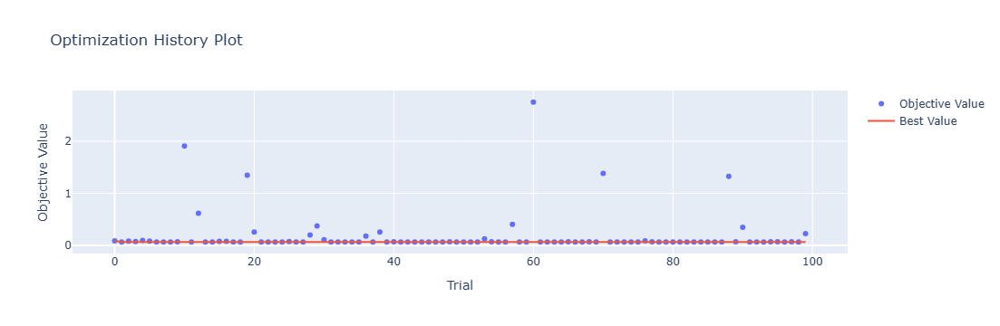

In [4]:
optuna.visualization.plot_optimization_history(study)

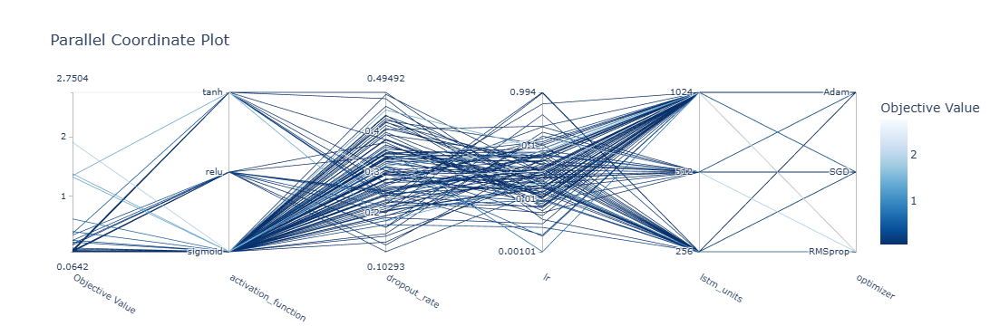

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

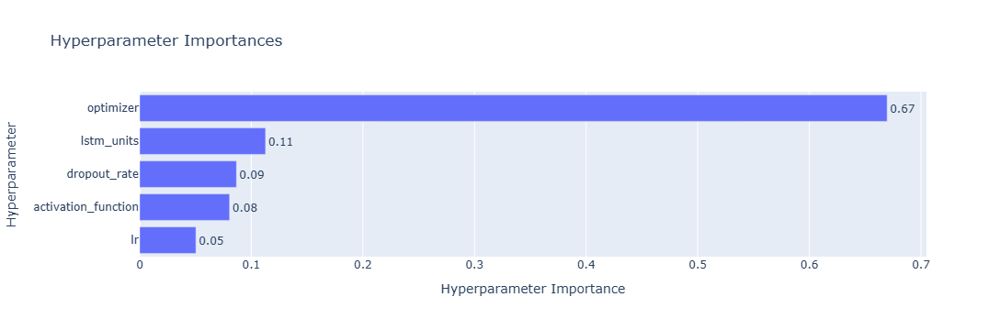

In [6]:
optuna.visualization.plot_param_importances(study)

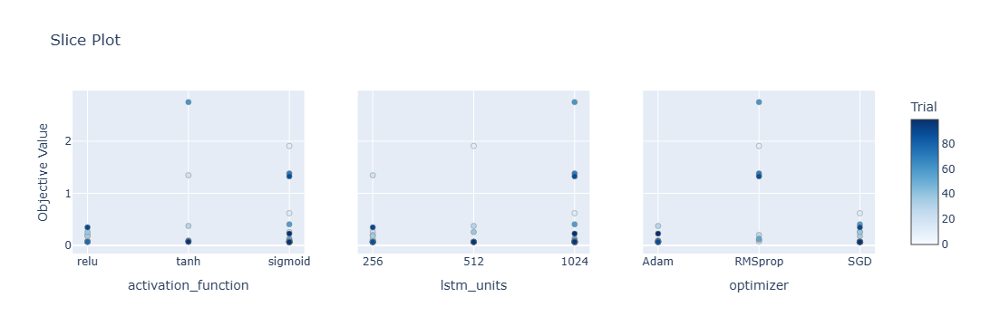

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

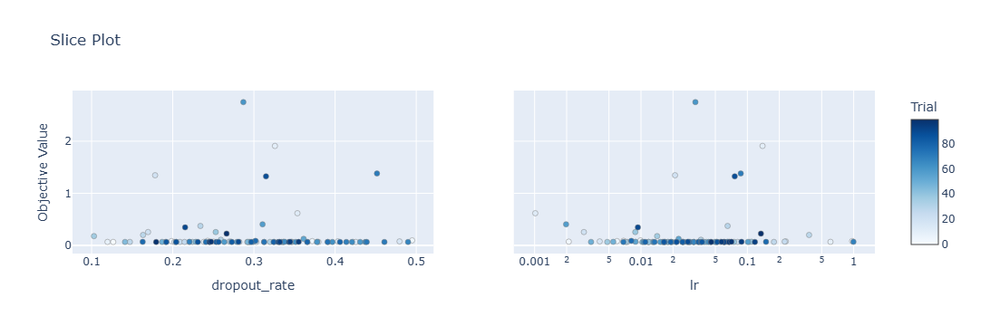

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 29s 134ms/step - loss: 0.1755 - accuracy: 0.2738 - mae: 0.1399 - rmse: 0.1755 - mape: 30.0672 - pearson: 0.5885 - val_loss: 0.0670 - val_accuracy: 0.3000 - val_mae: 0.0514 - val_rmse: 0.0670 - val_mape: 11.6170 - val_pearson: 0.7651
Epoch 2/100
84/84 [==============================] - 6s 72ms/step - loss: 0.0682 - accuracy: 0.4524 - mae: 0.0534 - rmse: 0.0682 - mape: 12.0413 - pearson: 0.7599 - val_loss: 0.0730 - val_accuracy: 0.3000 - val_mae: 0.0559 - val_rmse: 0.0730 - val_mape: 12.7373 - val_pearson: 0.7089
Epoch 3/100
84/84 [==============================] - 6s 73ms/step - loss: 0.0674 - accuracy: 0.3690 - mae: 0.0527 - rmse: 0.0674 - mape: 11.9528 - pearson: 0.7653 - val_loss: 0.0723 - val_accuracy: 0.7000 - val_mae: 0.0574 - val_rmse: 0.0723 - val_mape: 12.3418 - val_pearson: 0.7501
Epoch 4/100
84/84 [==============================] - 6s 69ms/step - loss: 0.0681 - accuracy: 0.4286 - mae: 0.0536 - rmse: 0.0681 - mape: 12.0677 -

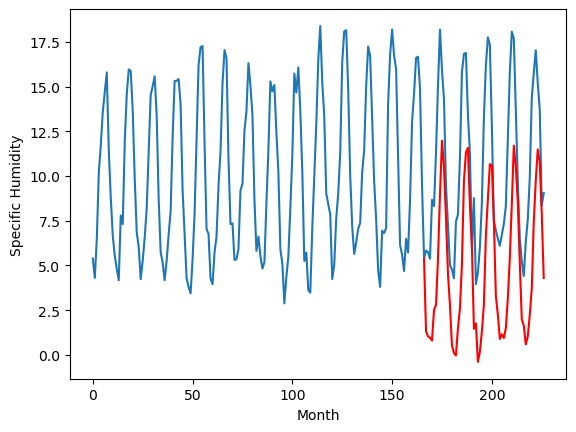

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		1.01		2.71
-1.37		0.73		2.10
-1.81		0.65		2.46
-1.08		0.49		1.57
2.80		2.21		-0.59
1.01		2.49		1.48
3.33		5.08		1.75
7.01		8.67		1.66
8.67		11.67		3.00
8.61		10.21		1.60
6.51		7.37		0.86
3.95		4.22		0.27
0.62		2.44		1.82
-2.90		0.21		3.11
-2.55		-0.21		2.34
-1.84		-0.34		1.50
0.37		1.19		0.82
0.59		2.29		1.70
3.08		4.77		1.69
7.83		9.42		1.59
8.63		11.02		2.39
8.79		11.28		2.49
6.63		8.03		1.40
3.55		5.78		2.23
-2.11		1.16		3.27
1.53		1.46		-0.07
-3.23		-0.70		2.53
-2.01		-0.13		1.88
-0.10		1.02		1.12
1.20		2.49		1.29
5.44		6.37		0.93
8.05		8.41		0.36
8.95		10.37		1.42
8.38		10.29		1.91
5.32		7.25		1.93
0.18		3.02		2.84
-0.02		1.95		1.97
-1.22		0.60		1.82
-1.13		0.86		1.99
0.56		0.65		0.09
0.94		1.20		0.26
1.73		2.86		1.13
3.92		5.13		1.21
7.25		8.14		0.89
8.92		11.41		2.49
9.70		10.24		0.54
5.68		8.24		2.56
0.98		4.83		3.85
-1.20		1.69		2.89
-2.64		1.35		3.99
-3.42		0.29		3.71
-2.20		

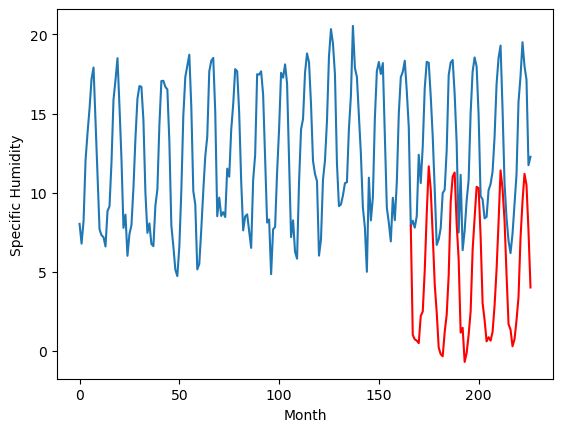

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		0.90		2.26
-1.11		0.62		1.73
-1.28		0.54		1.82
-0.73		0.38		1.11
1.87		2.10		0.23
0.62		2.38		1.76
3.48		4.97		1.49
7.39		8.57		1.18
9.79		11.56		1.77
9.88		10.10		0.22
6.79		7.26		0.47
4.04		4.11		0.07
0.71		2.33		1.62
-2.45		0.10		2.55
-2.07		-0.32		1.75
-1.92		-0.45		1.47
-0.07		1.08		1.15
0.17		2.18		2.01
2.93		4.66		1.73
7.55		9.31		1.76
9.46		10.91		1.45
9.66		11.17		1.51
6.66		7.92		1.26
3.94		5.67		1.73
-1.93		1.04		2.97
0.47		1.35		0.88
-2.94		-0.81		2.13
-1.73		-0.24		1.49
-1.02		0.90		1.92
0.43		2.37		1.94
4.57		6.25		1.68
7.35		8.28		0.93
9.55		10.25		0.70
8.85		10.17		1.32
5.12		7.13		2.01
0.12		2.90		2.78
-0.20		1.83		2.03
-1.53		0.48		2.01
-1.16		0.75		1.91
-0.05		0.53		0.58
-0.69		1.08		1.77
0.75		2.74		1.99
3.53		5.02		1.49
6.11		8.02		1.91
8.97		11.29		2.32
9.06		10.12		1.06
5.48		8.12		2.64
1.57		4.71		3.14
-0.96		1.57		2.53
-1.77		1.22		2.99
-2.57		0.17		2.74
-1.93	

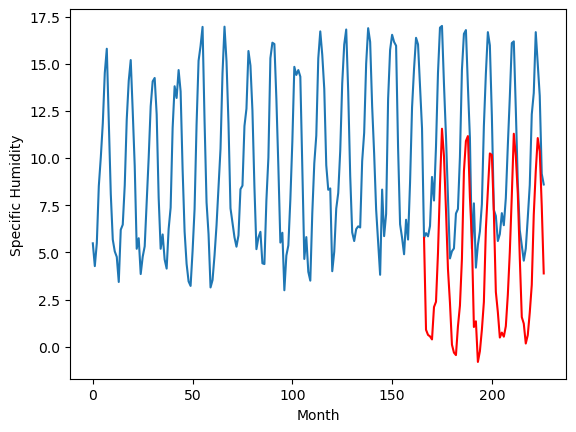

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		0.60		2.42
-1.28		0.32		1.60
-1.04		0.24		1.28
-0.90		0.08		0.98
3.41		1.80		-1.61
2.26		2.08		-0.18
4.41		4.67		0.26
6.90		8.27		1.37
9.65		11.26		1.61
8.40		9.80		1.40
7.05		6.96		-0.09
3.24		3.81		0.57
0.19		2.03		1.84
-2.88		-0.20		2.68
-2.81		-0.62		2.19
-2.90		-0.75		2.15
0.55		0.78		0.23
1.12		1.88		0.76
4.63		4.37		-0.26
8.53		9.01		0.48
9.37		10.61		1.24
8.99		10.87		1.88
6.68		7.63		0.95
4.25		5.38		1.13
-1.96		0.75		2.71
1.09		1.05		-0.04
-4.03		-1.10		2.93
-2.82		-0.53		2.29
-1.73		0.60		2.33
1.19		2.08		0.89
5.43		5.96		0.53
7.44		7.99		0.55
8.65		9.96		1.31
7.93		9.88		1.95
4.55		6.84		2.29
-0.55		2.61		3.16
-1.07		1.54		2.61
-1.57		0.19		1.76
-1.38		0.45		1.83
-0.71		0.24		0.95
0.37		0.79		0.42
0.77		2.45		1.68
3.62		4.73		1.11
7.77		7.73		-0.04
8.80		11.00		2.20
8.55		9.83		1.28
6.37		7.83		1.46
1.80		4.42		2.62
-1.19		1.27		2.46
-2.59		0.92		3.51
-3.51		-0.13		3.38
-1.

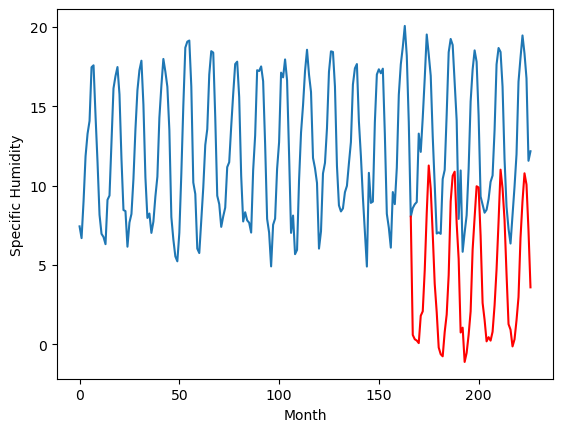

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		1.85		-0.40
1.00		1.57		0.57
1.79		1.49		-0.30
1.18		1.33		0.15
5.63		3.05		-2.58
5.35		3.33		-2.02
7.93		5.92		-2.01
10.29		9.51		-0.78
13.15		12.51		-0.64
10.88		11.04		0.16
9.57		8.21		-1.36
5.29		5.06		-0.23
3.44		3.27		-0.17
0.66		1.05		0.39
0.59		0.63		0.04
0.19		0.50		0.31
3.03		2.02		-1.01
4.43		3.12		-1.31
8.44		5.61		-2.83
12.13		10.26		-1.87
12.84		11.86		-0.98
12.76		12.12		-0.64
8.53		8.87		0.34
6.44		6.62		0.18
2.22		1.99		-0.23
4.98		2.30		-2.68
-0.52		0.14		0.66
-0.26		0.71		0.97
1.29		1.85		0.56
5.21		3.32		-1.89
8.91		7.21		-1.70
9.88		9.24		-0.64
9.64		11.20		1.56
10.73		11.12		0.39
7.90		8.08		0.18
3.10		3.85		0.75
3.09		2.78		-0.31
2.01		1.43		-0.58
1.25		1.70		0.45
1.59		1.48		-0.11
3.78		2.04		-1.74
4.54		3.70		-0.84
8.48		5.97		-2.51
12.60		8.97		-3.63
11.18		12.24		1.06
9.36		11.07		1.71
9.32		9.07		-0.25
5.57		5.66		0.09
2.77		2.52		-0.25
0.91		2.17		1.26
-0.27

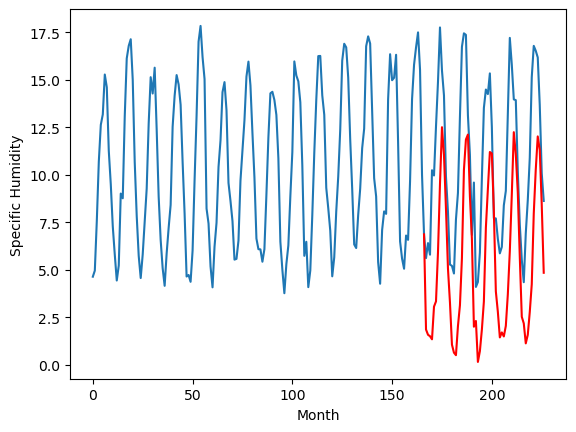

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		4.49		1.90
2.55		4.21		1.66
2.07		4.13		2.06
1.96		3.97		2.01
3.72		5.69		1.97
4.06		5.96		1.90
7.19		8.56		1.37
10.92		12.15		1.23
14.40		15.15		0.75
14.43		13.69		-0.74
11.53		10.84		-0.69
7.83		7.70		-0.13
4.88		5.91		1.03
1.12		3.68		2.56
0.51		3.27		2.76
1.10		3.13		2.03
2.67		4.66		1.99
3.68		5.76		2.08
6.18		8.25		2.07
11.44		12.89		1.45
12.56		14.49		1.93
13.72		14.75		1.03
9.63		11.50		1.87
7.31		9.26		1.95
2.05		4.62		2.57
3.47		4.93		1.46
0.36		2.78		2.42
1.74		3.34		1.60
3.07		4.48		1.41
4.20		5.96		1.76
8.98		9.84		0.86
10.07		11.87		1.80
14.40		13.83		-0.57
12.61		13.75		1.14
9.91		10.72		0.81
5.27		6.49		1.22
4.61		5.42		0.81
1.26		4.07		2.81
2.01		4.34		2.33
2.94		4.12		1.18
2.72		4.68		1.96
5.40		6.34		0.94
6.16		8.61		2.45
10.06		11.61		1.55
14.41		14.89		0.48
13.52		13.71		0.19
10.40		11.72		1.32
6.00		8.31		2.31
2.98		5.17		2.19
2.16		4.82		2.66
1.37		3.76		2.39
1.27

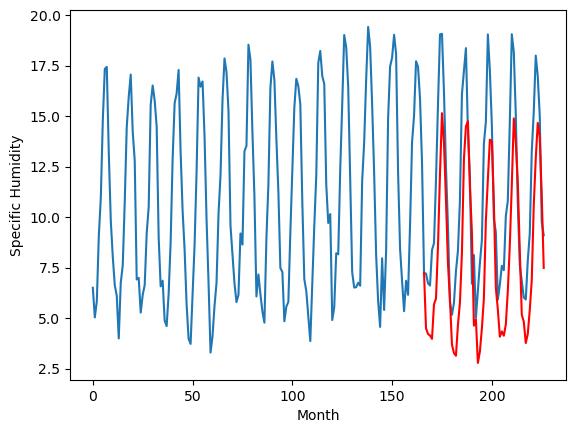

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		1.94		1.58
0.48		1.66		1.18
0.40		1.58		1.18
0.76		1.42		0.66
2.39		3.14		0.75
2.17		3.42		1.25
5.27		6.01		0.74
8.99		9.61		0.62
11.78		12.60		0.82
11.72		11.14		-0.58
8.19		8.29		0.10
5.47		5.15		-0.32
2.62		3.37		0.75
-0.25		1.14		1.39
-0.40		0.72		1.12
-0.35		0.59		0.94
1.24		2.11		0.87
1.84		3.22		1.38
4.84		5.70		0.86
9.22		10.35		1.13
10.66		11.95		1.29
11.19		12.21		1.02
7.87		8.96		1.09
5.76		6.71		0.95
0.01		2.08		2.07
1.85		2.38		0.53
-0.93		0.23		1.16
0.35		0.80		0.45
1.36		1.94		0.58
2.36		3.42		1.06
6.72		7.30		0.58
8.60		9.33		0.73
12.22		11.29		-0.93
10.87		11.22		0.35
7.43		8.18		0.75
2.87		3.95		1.08
2.27		2.88		0.61
0.09		1.53		1.44
0.95		1.80		0.85
1.63		1.58		-0.05
1.22		2.14		0.92
3.43		3.80		0.37
5.02		6.07		1.05
7.75		9.07		1.32
11.49		12.34		0.85
11.12		11.16		0.04
8.18		9.17		0.99
3.92		5.76		1.84
0.59		2.61		2.02
0.52		2.26		1.74
-0.15		1.21		1.36
0.01		1.66		

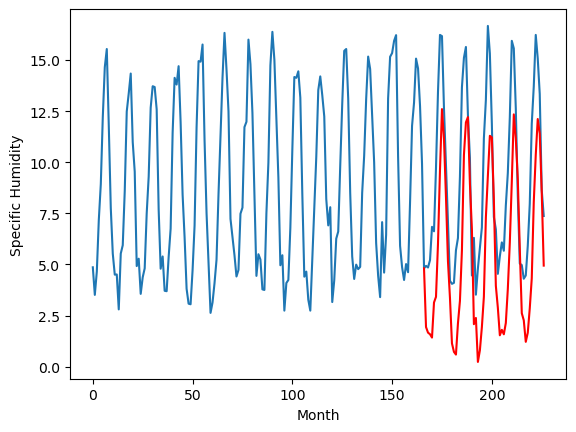

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		3.89		1.37
2.77		3.62		0.85
2.80		3.54		0.74
3.02		3.37		0.35
4.32		5.09		0.77
4.26		5.37		1.11
6.25		7.96		1.71
10.92		11.56		0.64
13.73		14.55		0.82
13.97		13.09		-0.88
10.07		10.24		0.17
7.36		7.10		-0.26
4.82		5.32		0.50
1.95		3.09		1.14
1.64		2.67		1.03
1.67		2.54		0.87
3.29		4.06		0.77
3.99		5.16		1.17
7.01		7.65		0.64
11.28		12.29		1.01
12.78		13.89		1.11
13.06		14.16		1.10
9.57		10.90		1.33
7.69		8.65		0.96
1.90		4.01		2.11
3.67		4.32		0.65
1.16		2.17		1.01
2.39		2.74		0.35
3.38		3.87		0.49
4.28		5.36		1.08
8.57		9.23		0.66
10.02		11.26		1.24
13.39		13.23		-0.16
12.32		13.15		0.83
9.53		10.12		0.59
5.11		5.89		0.78
4.41		4.82		0.41
2.07		3.47		1.40
3.00		3.73		0.73
3.36		3.51		0.15
3.28		4.07		0.79
5.56		5.73		0.17
6.88		8.00		1.12
9.50		11.00		1.50
13.85		14.27		0.42
12.79		13.09		0.30
9.99		11.09		1.10
6.24		7.68		1.44
2.72		4.54		1.82
2.92		4.19		1.27
2.23		3.13		0.90
2.26		3

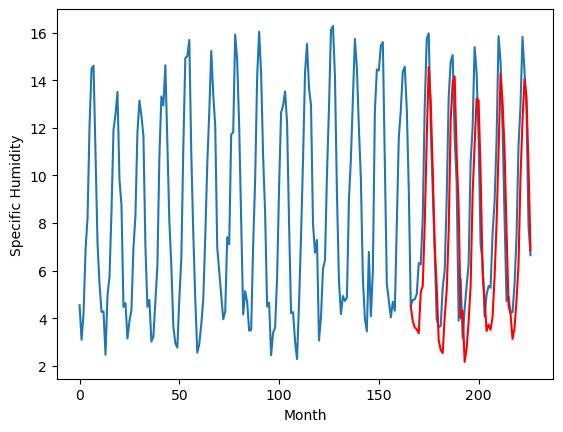

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.09		-0.26
1.44		0.82		-0.62
1.04		0.74		-0.30
1.03		0.57		-0.46
3.29		2.29		-1.00
3.53		2.57		-0.96
6.75		5.16		-1.59
10.40		8.76		-1.64
13.49		11.76		-1.73
11.46		10.30		-1.16
8.74		7.45		-1.29
4.29		4.30		0.01
2.53		2.52		-0.01
0.62		0.30		-0.32
0.39		-0.12		-0.51
-0.29		-0.25		0.04
2.77		1.27		-1.50
3.50		2.37		-1.13
6.41		4.86		-1.55
11.39		9.50		-1.89
12.89		11.11		-1.78
13.08		11.37		-1.71
9.27		8.11		-1.16
6.85		5.86		-0.99
1.56		1.23		-0.33
3.15		1.53		-1.62
-0.13		-0.62		-0.49
0.46		-0.05		-0.51
2.14		1.08		-1.06
3.72		2.56		-1.16
7.91		6.45		-1.46
10.09		8.48		-1.61
13.75		10.44		-3.31
12.78		10.36		-2.42
8.33		7.33		-1.00
3.10		3.10		-0.00
2.10		2.03		-0.07
1.17		0.67		-0.50
1.77		0.94		-0.83
1.84		0.72		-1.12
2.28		1.27		-1.01
3.50		2.93		-0.57
6.99		5.20		-1.79
9.27		8.20		-1.07
12.82		11.47		-1.35
12.82		10.29		-2.53
8.75		8.30		-0.45
4.69		4.89		0.20
2.03		1.74		-0.29
1

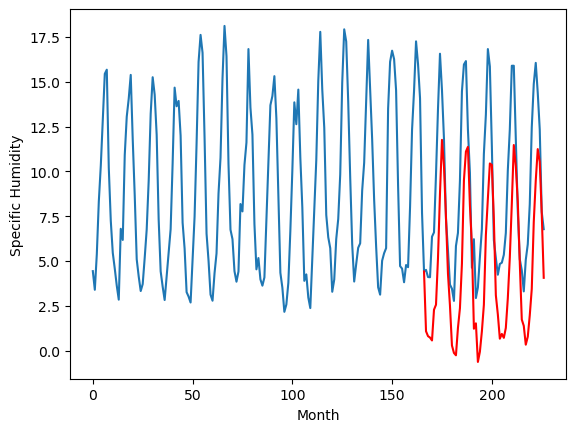

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		2.96		0.12
3.25		2.68		-0.57
2.75		2.60		-0.15
2.43		2.44		0.01
4.39		4.15		-0.24
4.45		4.44		-0.01
7.59		7.03		-0.56
10.28		10.63		0.35
13.42		13.63		0.21
12.20		12.17		-0.03
9.41		9.32		-0.09
6.07		6.17		0.10
4.02		4.39		0.37
2.36		2.16		-0.20
2.03		1.75		-0.28
1.58		1.62		0.04
3.38		3.14		-0.24
4.70		4.24		-0.46
6.79		6.72		-0.07
11.56		11.37		-0.19
12.49		12.97		0.48
12.91		13.23		0.32
9.74		9.98		0.24
8.43		7.73		-0.70
2.91		3.09		0.18
3.75		3.40		-0.35
1.46		1.24		-0.22
2.20		1.81		-0.39
3.48		2.95		-0.53
5.10		4.43		-0.67
9.71		8.31		-1.40
11.39		10.34		-1.05
14.97		12.31		-2.66
13.43		12.23		-1.20
10.37		9.19		-1.18
4.58		4.96		0.38
3.86		3.89		0.03
2.93		2.54		-0.39
3.54		2.80		-0.74
3.31		2.58		-0.73
3.41		3.13		-0.28
5.14		4.79		-0.35
7.58		7.06		-0.52
10.20		10.06		-0.14
14.02		13.33		-0.69
12.72		12.15		-0.57
10.00		10.16		0.16
6.76		6.75		-0.01
3.41		3.60		0.19
3.60		3.25

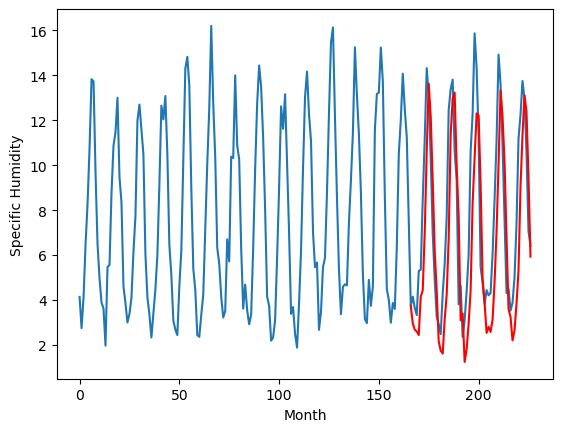

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		1.31		0.10
1.33		1.04		-0.29
0.95		0.96		0.01
0.44		0.80		0.36
2.04		2.51		0.47
2.40		2.79		0.39
5.30		5.39		0.09
8.40		8.99		0.59
11.45		11.99		0.54
9.88		10.52		0.64
7.22		7.67		0.45
3.77		4.52		0.75
2.36		2.74		0.38
0.83		0.51		-0.32
0.45		0.10		-0.35
-0.29		-0.03		0.26
1.33		1.49		0.16
2.93		2.59		-0.34
4.45		5.07		0.62
9.58		9.72		0.14
10.65		11.32		0.67
11.14		11.58		0.44
7.52		8.33		0.81
6.53		6.08		-0.45
1.68		1.44		-0.24
1.68		1.75		0.07
-0.39		-0.40		-0.01
0.21		0.16		-0.05
1.46		1.30		-0.16
2.40		2.78		0.38
6.12		6.66		0.54
7.39		8.68		1.29
9.88		10.65		0.77
10.87		10.57		-0.30
8.27		7.54		-0.73
3.25		3.30		0.05
2.11		2.23		0.12
0.94		0.88		-0.06
1.34		1.14		-0.20
0.78		0.92		0.14
1.24		1.47		0.23
2.88		3.13		0.25
4.09		5.40		1.31
7.10		8.40		1.30
10.93		11.67		0.74
10.18		10.49		0.31
8.87		8.50		-0.37
5.11		5.09		-0.02
1.70		1.95		0.25
2.23		1.60		-0.63
0.71		0.55		-0.16
1.

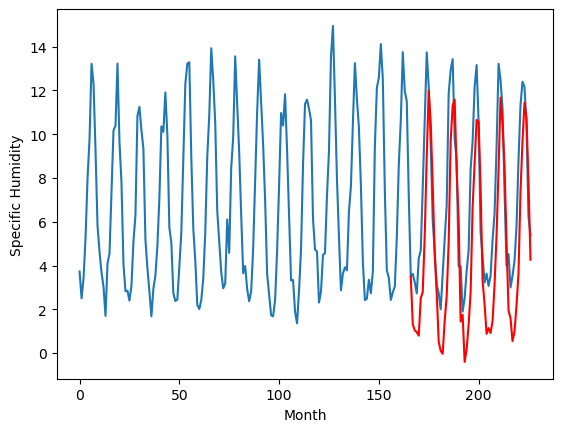

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[1.315619812011719, 1.00554780960083, 0.895016136169434, 0.5958017253875729, 1.8468829536437985, 4.486405401229858, 1.9365517902374272, 3.886297159194946, 1.088902597427368, 2.9565179347991943, 1.3147781944274906]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   1.315620
1                 1   -1.70   1.005548
2                 2   -1.36   0.895016
3                 3   -1.82   0.595802
4                 4    2.25   1.846883
5                 5    2.59   4.486405
6                 6    0.36   1.936552
7                 7    2.52   3.886297
8                 8    1.35   1.088903
9                 9    2.84   2.956518
10               10    1.21   1.314778


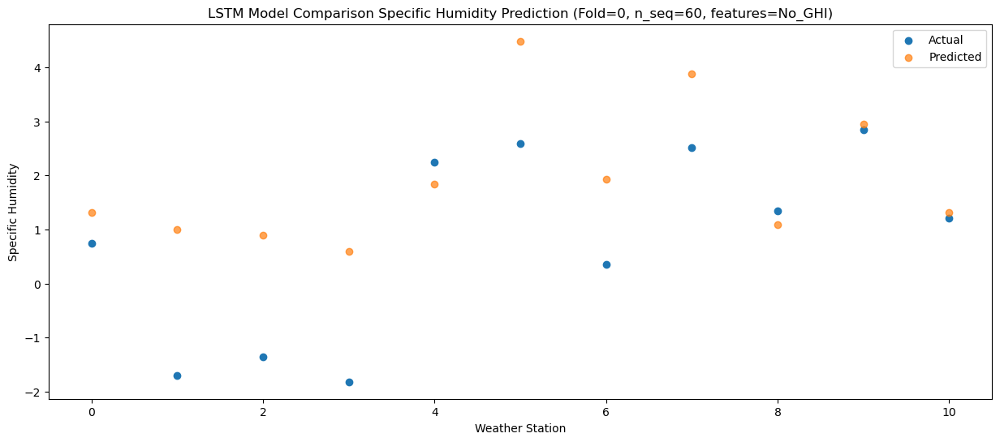

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18   1.040187
1                 1   -1.37   0.731673
2                 2   -1.11   0.623881
3                 3   -1.28   0.323559
4                 4    1.00   1.572010
5                 5    2.55   4.213836
6                 6    0.48   1.663521
7                 7    2.77   3.615010
8                 8    1.44   0.815400
9                 9    3.25   2.682101
10               10    1.33   1.039943


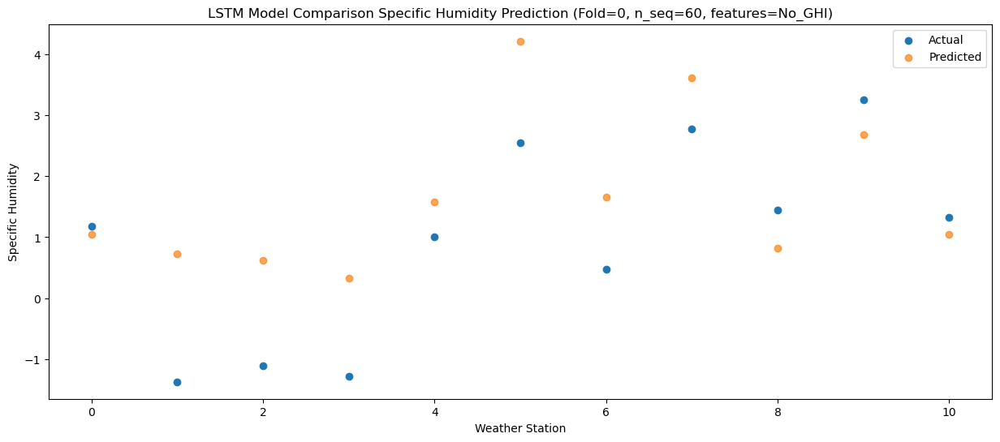

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09   0.958987
1                 1   -1.81   0.649862
2                 2   -1.28   0.543492
3                 3   -1.04   0.242640
4                 4    1.79   1.494453
5                 5    2.07   4.134793
6                 6    0.40   1.584383
7                 7    2.80   3.536383
8                 8    1.04   0.736381
9                 9    2.75   2.601578
10               10    0.95   0.958607


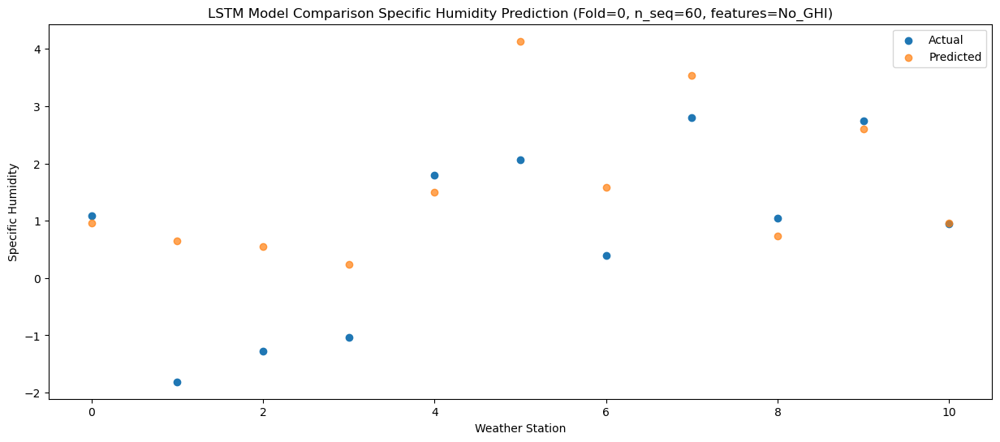

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73   0.800869
1                 1   -1.08   0.490804
2                 2   -0.73   0.382588
3                 3   -0.90   0.081234
4                 4    1.18   1.331920
5                 5    1.96   3.970678
6                 6    0.76   1.421296
7                 7    3.02   3.373265
8                 8    1.03   0.574784
9                 9    2.43   2.440763
10               10    0.44   0.797162


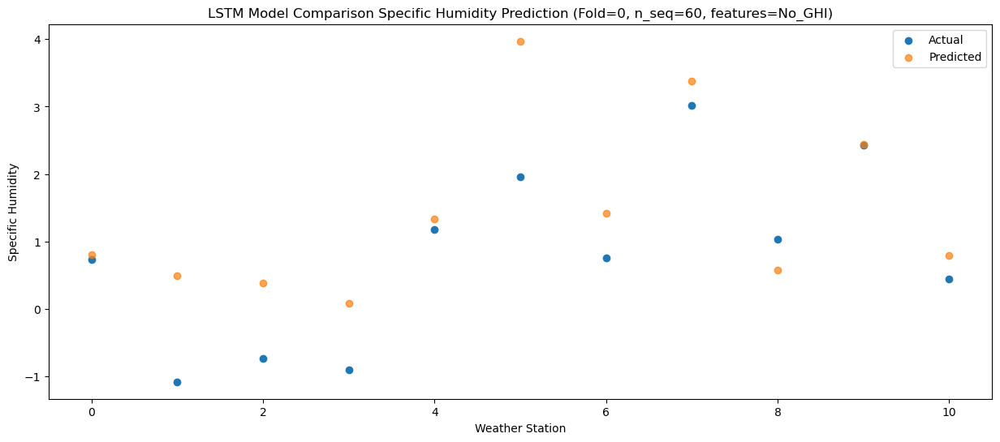

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   2.514313
1                 1    2.80   2.208857
2                 2    1.87   2.101155
3                 3    3.41   1.802969
4                 4    5.63   3.051820
5                 5    3.72   5.686487
6                 6    2.39   3.136990
7                 7    4.32   5.087449
8                 8    3.29   2.289035
9                 9    4.39   4.154015
10               10    2.04   2.509770


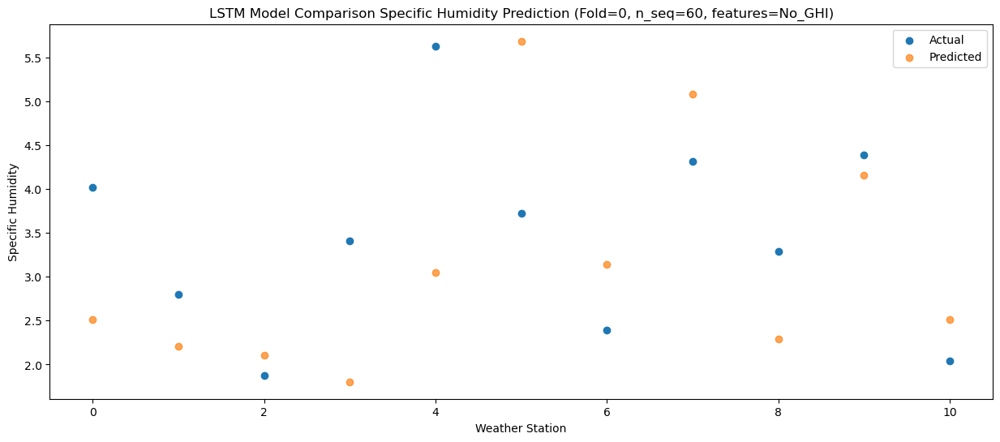

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67   2.791731
1                 1    1.01   2.486828
2                 2    0.62   2.378916
3                 3    2.26   2.081929
4                 4    5.35   3.329791
5                 5    4.06   5.964200
6                 6    2.17   3.415445
7                 7    4.26   5.365371
8                 8    3.53   2.567640
9                 9    4.45   4.436775
10               10    2.40   2.792334


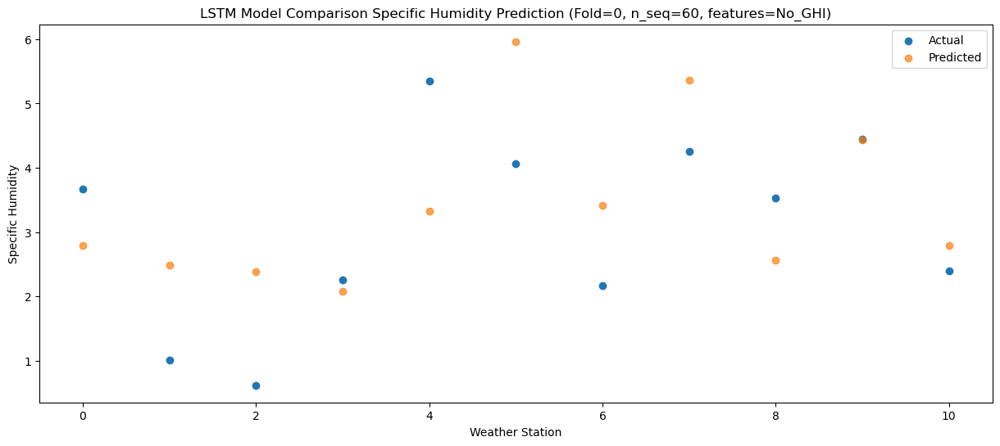

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   5.386358
1                 1    3.33   5.079731
2                 2    3.48   4.970677
3                 3    4.41   4.673466
4                 4    7.93   5.920051
5                 5    7.19   8.558173
6                 6    5.27   6.009446
7                 7    6.25   7.960259
8                 8    6.75   5.164394
9                 9    7.59   7.033535
10               10    5.30   5.389260


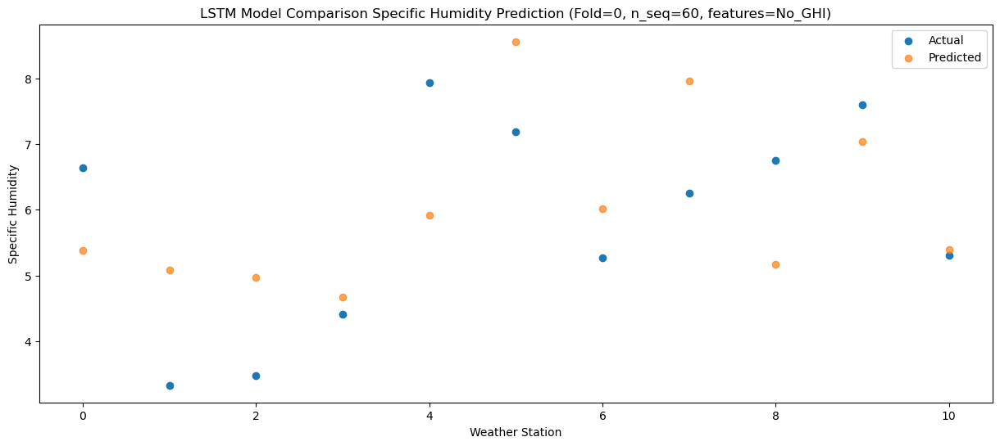

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40   8.982576
1                 1    7.01   8.674844
2                 2    7.39   8.566656
3                 3    6.90   8.269865
4                 4   10.29   9.513203
5                 5   10.92  12.153400
6                 6    8.99   9.605444
7                 7   10.92  11.556872
8                 8   10.40   8.761624
9                 9   10.28  10.632767
10               10    8.40   8.990547


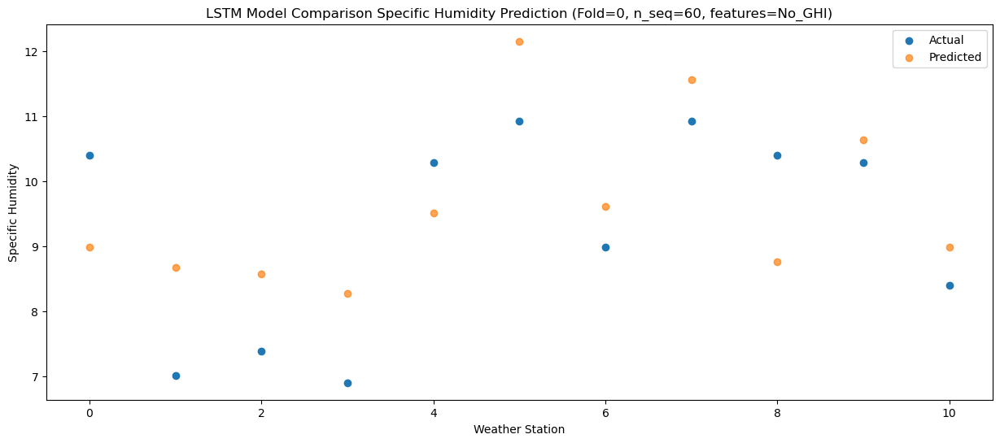

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  11.974713
1                 1    8.67  11.665446
2                 2    9.79  11.557904
3                 3    9.65  11.261935
4                 4   13.15  12.505134
5                 5   14.40  15.147084
6                 6   11.78  12.600685
7                 7   13.73  14.553237
8                 8   13.49  11.758359
9                 9   13.42  13.629753
10               10   11.45  11.987950


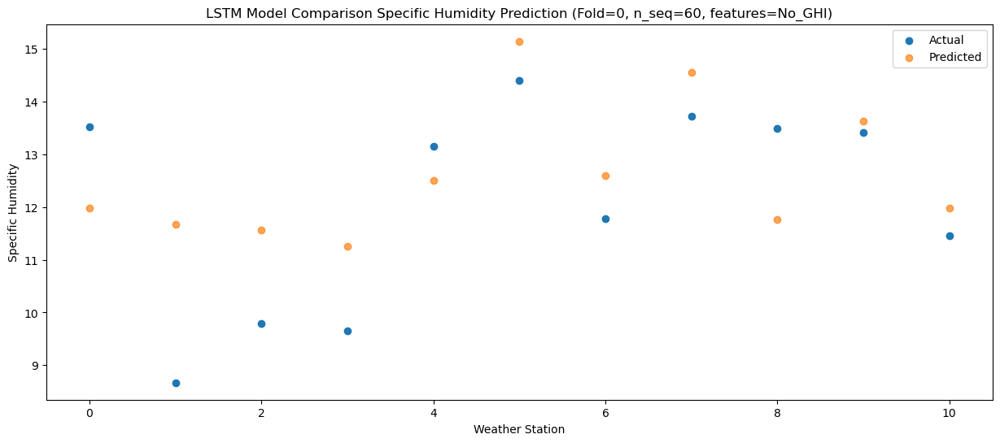

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28  10.515186
1                 1    8.61  10.206961
2                 2    9.88  10.100637
3                 3    8.40   9.803357
4                 4   10.88  11.043993
5                 5   14.43  13.687128
6                 6   11.72  11.142741
7                 7   13.97  13.094919
8                 8   11.46  10.297962
9                 9   12.20  12.167752
10               10    9.88  10.524173


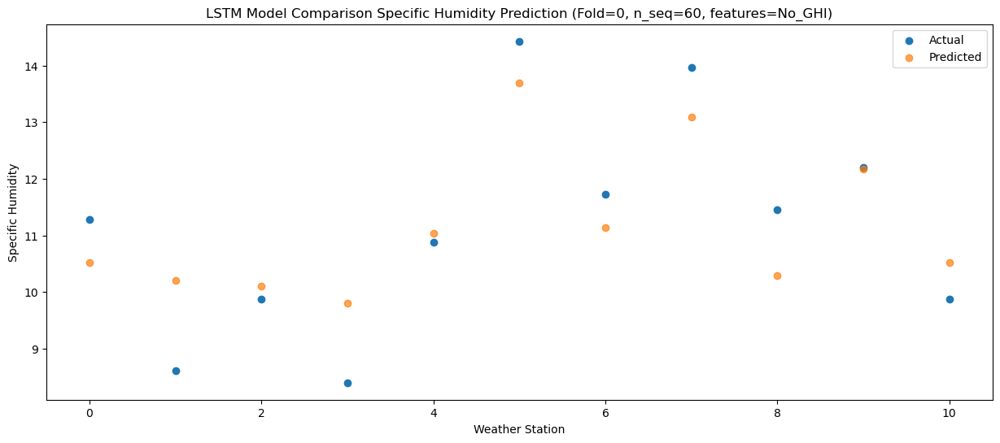

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   7.678900
1                 1    6.51   7.367824
2                 2    6.79   7.257658
3                 3    7.05   6.960657
4                 4    9.57   8.205162
5                 5   11.53  10.840290
6                 6    8.19   8.293467
7                 7   10.07  10.243066
8                 8    8.74   7.449554
9                 9    9.41   9.316895
10               10    7.22   7.672061


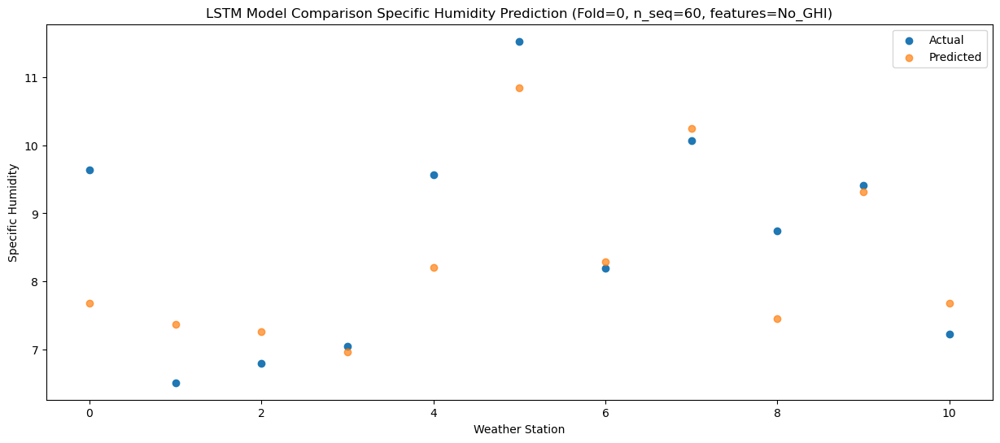

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   4.535570
1                 1    3.95   4.222262
2                 2    4.04   4.113646
3                 3    3.24   3.813254
4                 4    5.29   5.060118
5                 5    7.83   7.695216
6                 6    5.47   5.149827
7                 7    7.36   7.099140
8                 8    4.29   4.303418
9                 9    6.07   6.169749
10               10    3.77   4.522687


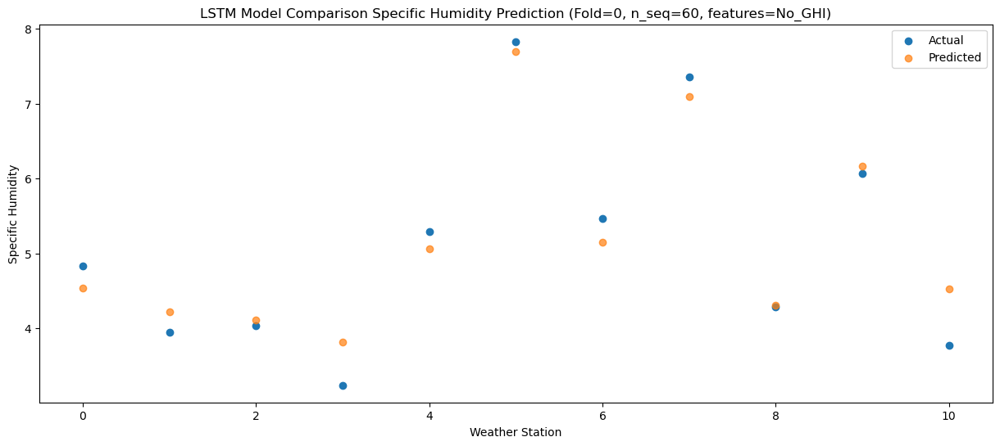

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   2.747205
1                 1    0.62   2.436315
2                 2    0.71   2.329155
3                 3    0.19   2.028899
4                 4    3.44   3.274868
5                 5    4.88   5.911647
6                 6    2.62   3.366181
7                 7    4.82   5.315329
8                 8    2.53   2.520260
9                 9    4.02   4.387345
10               10    2.36   2.739881


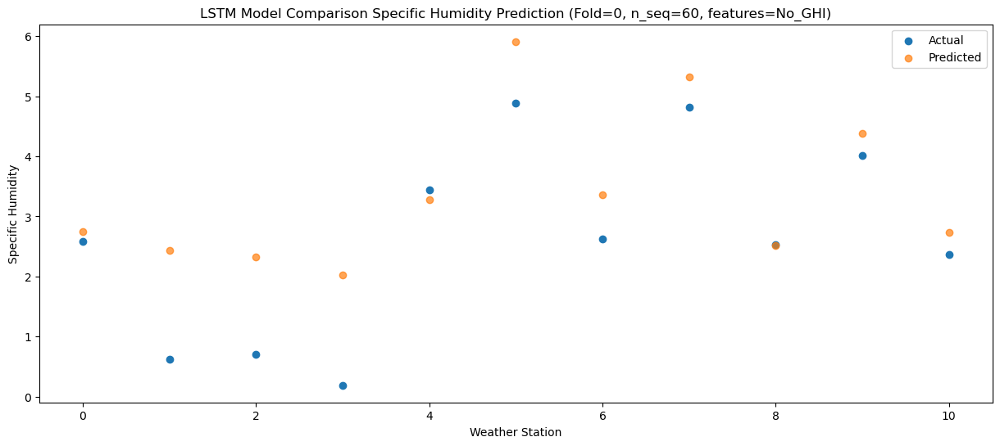

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36   0.525086
1                 1   -2.90   0.214117
2                 2   -2.45   0.104164
3                 3   -2.88  -0.197290
4                 4    0.66   1.051248
5                 5    1.12   3.684923
6                 6   -0.25   1.138666
7                 7    1.95   3.086891
8                 8    0.62   0.295569
9                 9    2.36   2.162391
10               10    0.83   0.514489


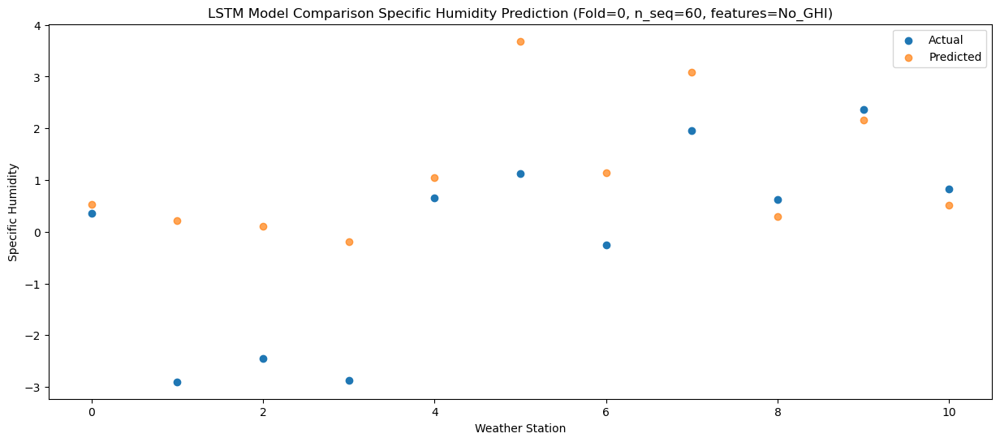

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12   0.102207
1                 1   -2.55  -0.208198
2                 2   -2.07  -0.317323
3                 3   -2.81  -0.619266
4                 4    0.59   0.629847
5                 5    0.51   3.267008
6                 6   -0.40   0.722342
7                 7    1.64   2.671447
8                 8    0.39  -0.121366
9                 9    2.03   1.746360
10               10    0.45   0.098220


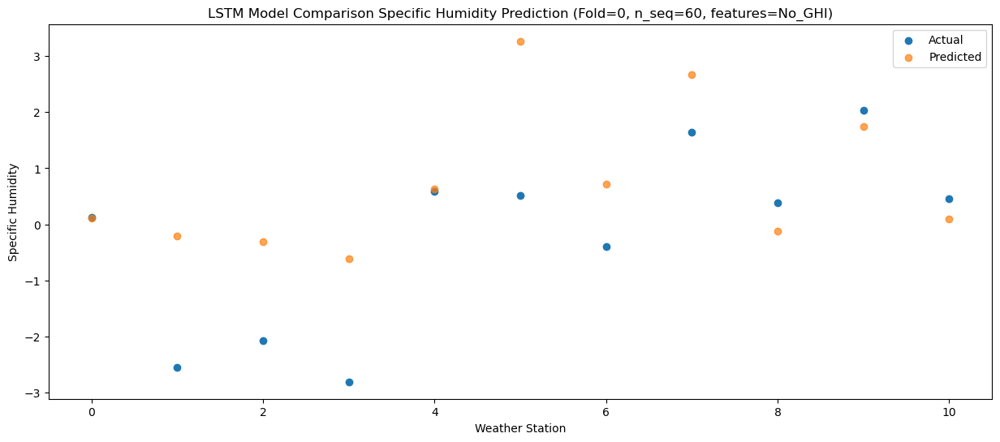

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37  -0.031659
1                 1   -1.84  -0.339833
2                 2   -1.92  -0.448787
3                 3   -2.90  -0.751281
4                 4    0.19   0.495734
5                 5    1.10   3.133051
6                 6   -0.35   0.589221
7                 7    1.67   2.539984
8                 8   -0.29  -0.252396
9                 9    1.58   1.615985
10               10   -0.29  -0.031302


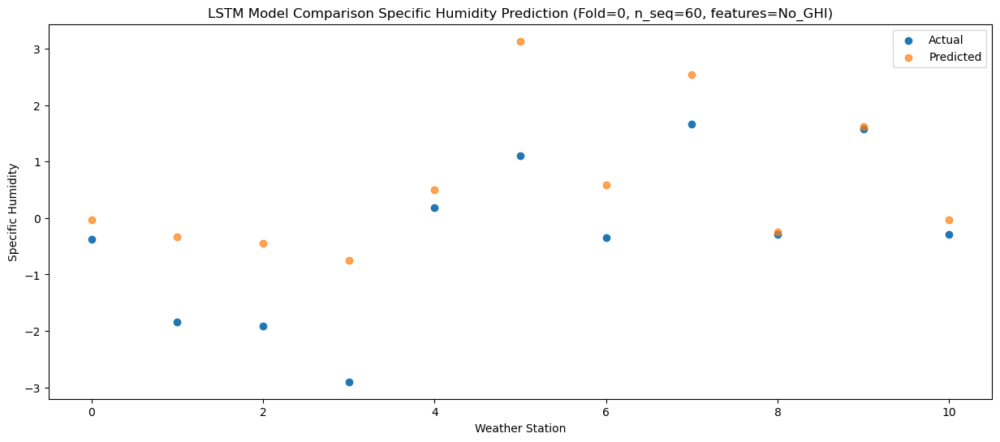

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   1.495125
1                 1    0.37   1.186568
2                 2   -0.07   1.076542
3                 3    0.55   0.775545
4                 4    3.03   2.023785
5                 5    2.67   4.658298
6                 6    1.24   2.114368
7                 7    3.29   4.063298
8                 8    2.77   1.271573
9                 9    3.38   3.140233
10               10    1.33   1.492860


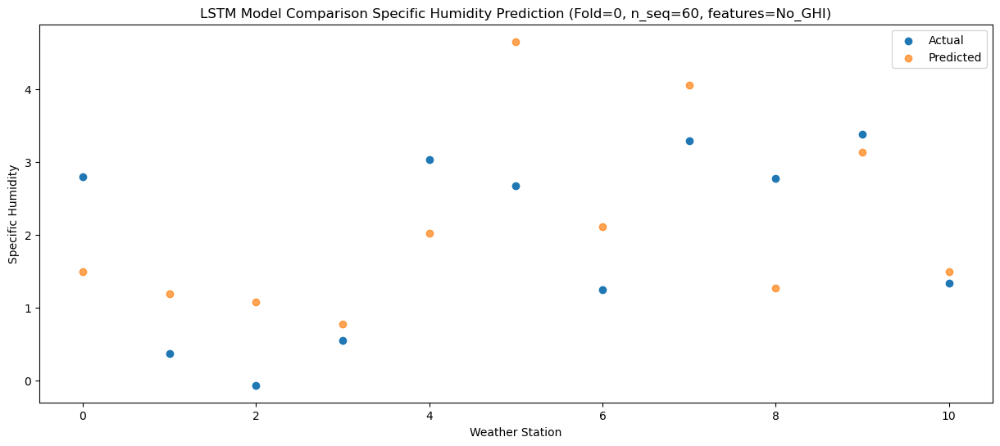

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19   2.590615
1                 1    0.59   2.285704
2                 2    0.17   2.175563
3                 3    1.12   1.876568
4                 4    4.43   3.123791
5                 5    3.68   5.759668
6                 6    1.84   3.215472
7                 7    3.99   5.162861
8                 8    3.50   2.370927
9                 9    4.70   4.239910
10               10    2.93   2.592633


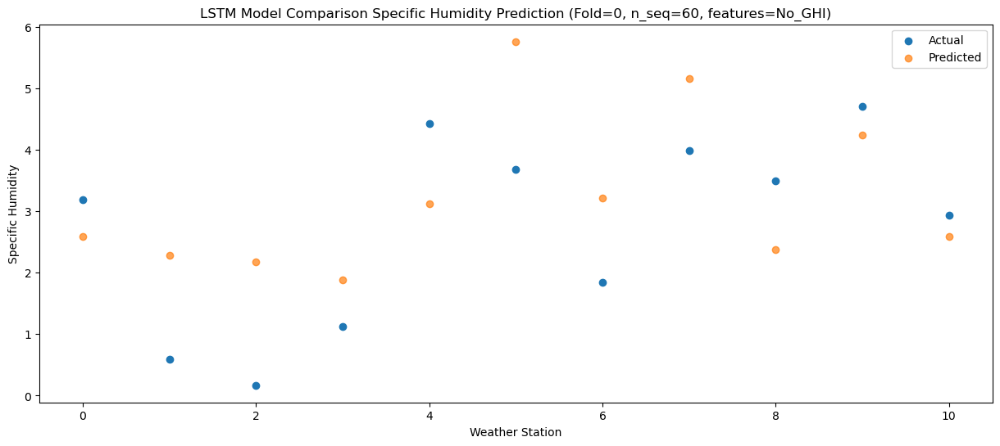

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   5.076099
1                 1    3.08   4.774590
2                 2    2.93   4.662878
3                 3    4.63   4.365726
4                 4    8.44   5.613846
5                 5    6.18   8.246399
6                 6    4.84   5.700695
7                 7    7.01   7.645440
8                 8    6.41   4.856672
9                 9    6.79   6.722999
10               10    4.45   5.072664


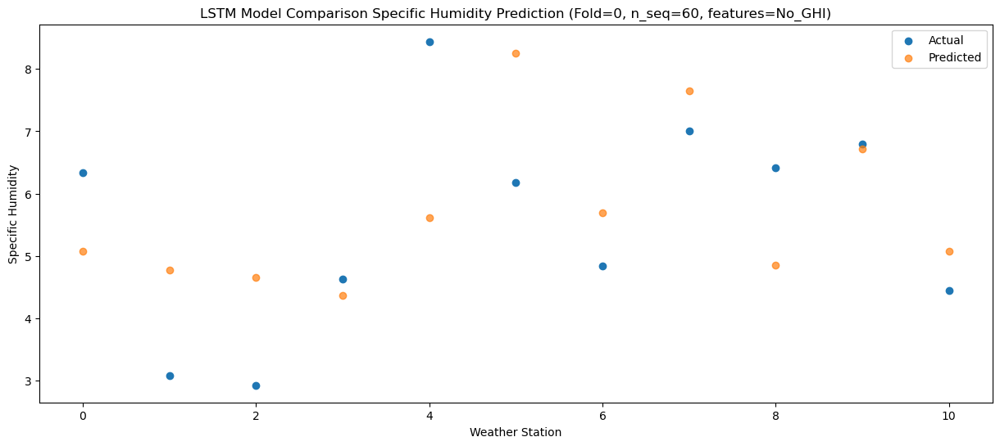

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15   9.713437
1                 1    7.83   9.416040
2                 2    7.55   9.307331
3                 3    8.53   9.011430
4                 4   12.13  10.257273
5                 5   11.44  12.891971
6                 6    9.22  10.347691
7                 7   11.28  12.292868
8                 8   11.39   9.503282
9                 9   11.56  11.370244
10               10    9.58   9.719380


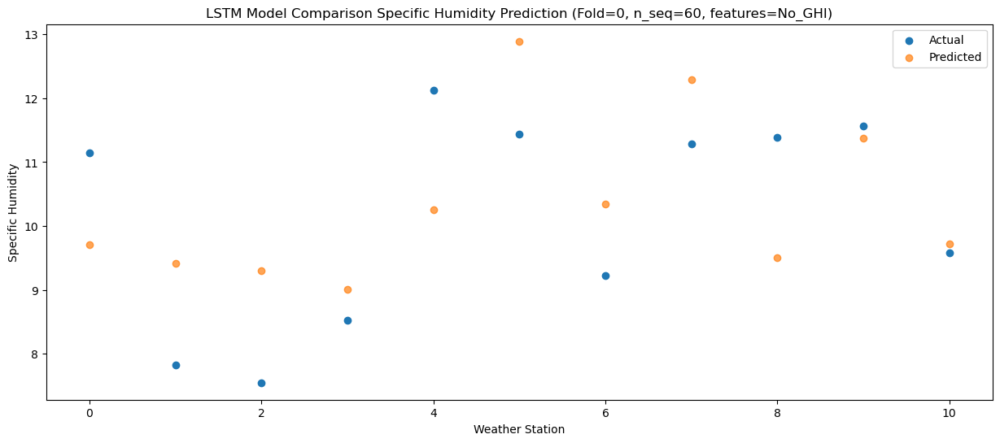

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18  11.317468
1                 1    8.63  11.018355
2                 2    9.46  10.908098
3                 3    9.37  10.611432
4                 4   12.84  11.856392
5                 5   12.56  14.493585
6                 6   10.66  11.950056
7                 7   12.78  13.894211
8                 8   12.89  11.105384
9                 9   12.49  12.971080
10               10   10.65  11.321116


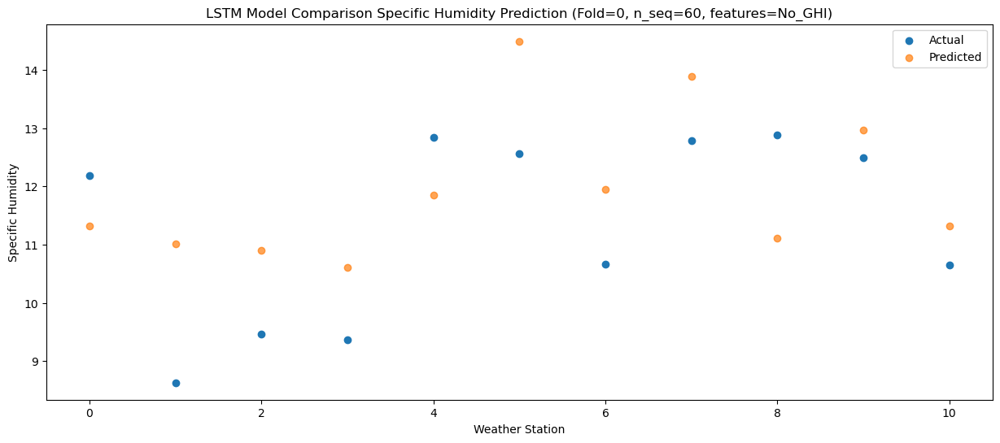

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23  11.575836
1                 1    8.79  11.276724
2                 2    9.66  11.168512
3                 3    8.99  10.873433
4                 4   12.76  12.116954
5                 5   13.72  14.754232
6                 6   11.19  12.210432
7                 7   13.06  14.155068
8                 8   13.08  11.366482
9                 9   12.91  13.233907
10               10   11.14  11.584153


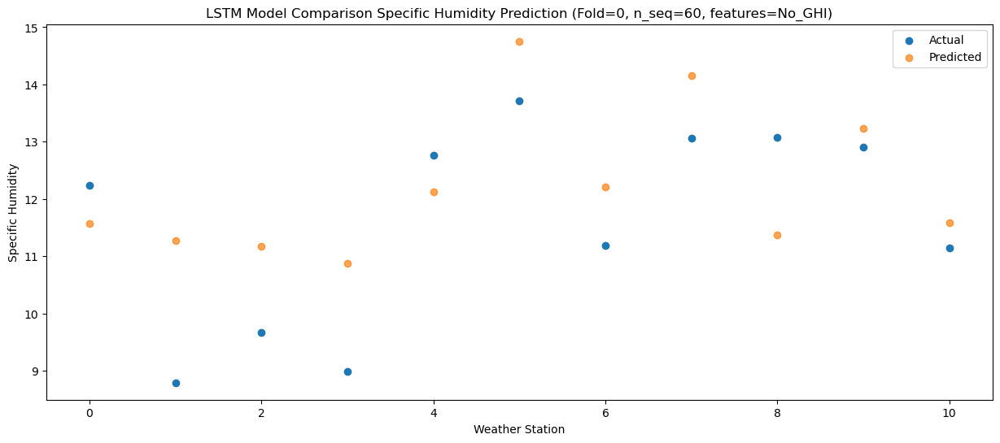

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81   8.328451
1                 1    6.63   8.027839
2                 2    6.66   7.917467
3                 3    6.68   7.625877
4                 4    8.53   8.869107
5                 5    9.63  11.502092
6                 6    7.87   8.957834
7                 7    9.57  10.898829
8                 8    9.27   8.112917
9                 9    9.74   9.978948
10               10    7.52   8.327969


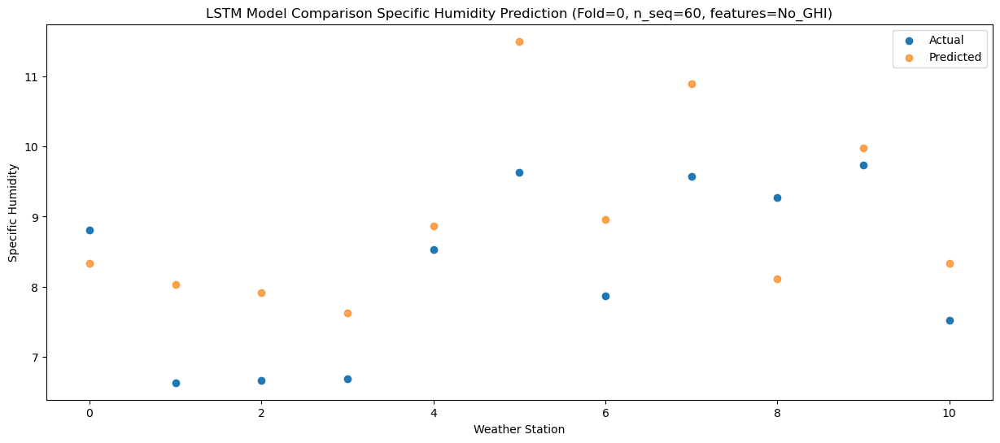

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   6.080605
1                 1    3.55   5.783819
2                 2    3.94   5.671079
3                 3    4.25   5.380337
4                 4    6.44   6.623288
5                 5    7.31   9.257308
6                 6    5.76   6.711557
7                 7    7.69   8.651908
8                 8    6.85   5.864776
9                 9    8.43   7.733058
10               10    6.53   6.083822


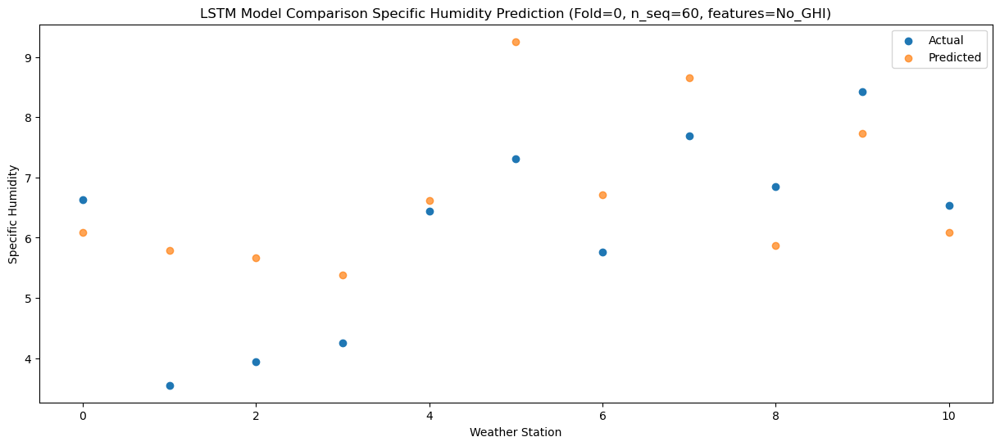

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33   1.457412
1                 1   -2.11   1.155936
2                 2   -1.93   1.040353
3                 3   -1.96   0.747985
4                 4    2.22   1.994377
5                 5    2.05   4.624102
6                 6    0.01   2.076555
7                 7    1.90   4.014623
8                 8    1.56   1.227424
9                 9    2.91   3.093496
10               10    1.68   1.443973


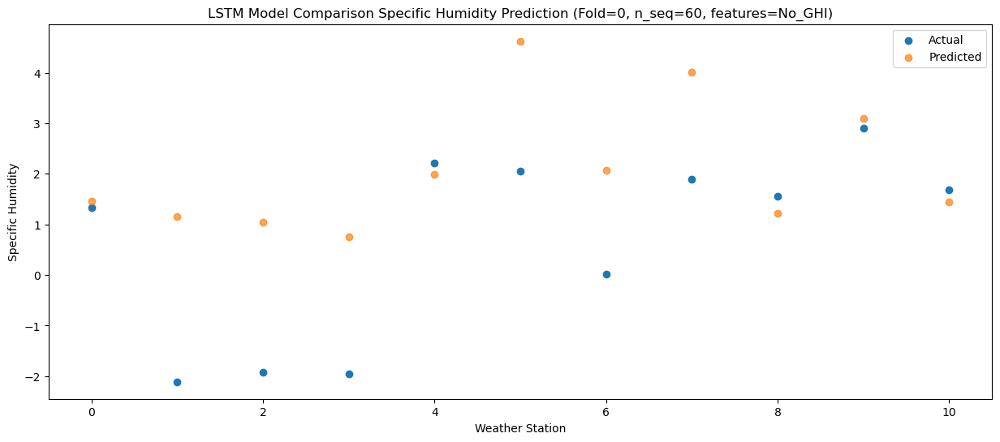

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   1.762809
1                 1    1.53   1.462265
2                 2    0.47   1.346467
3                 3    1.09   1.054694
4                 4    4.98   2.298968
5                 5    3.47   4.930202
6                 6    1.85   2.382800
7                 7    3.67   4.320533
8                 8    3.15   1.531635
9                 9    3.75   3.396870
10               10    1.68   1.747936


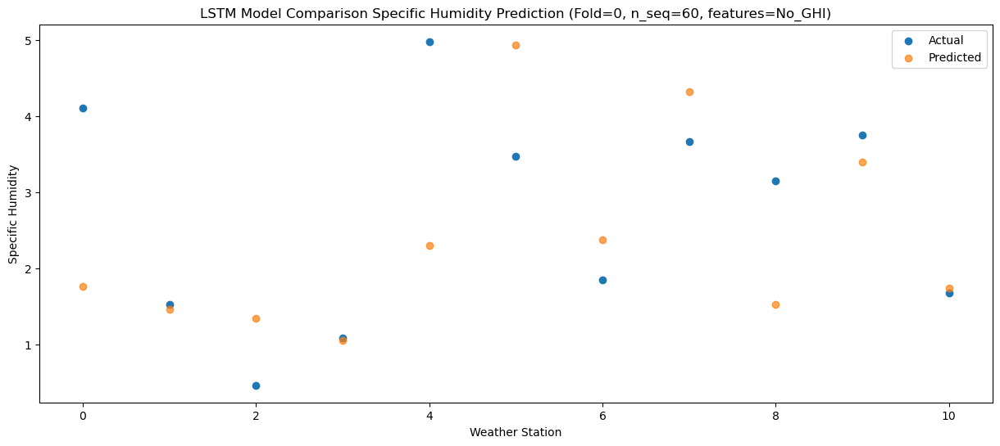

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -0.393683
1                 1   -3.23  -0.695783
2                 2   -2.94  -0.810733
3                 3   -4.03  -1.103975
4                 4   -0.52   0.141186
5                 5    0.36   2.777355
6                 6   -0.93   0.230094
7                 7    1.16   2.169063
8                 8   -0.13  -0.621545
9                 9    1.46   1.244947
10               10   -0.39  -0.402655


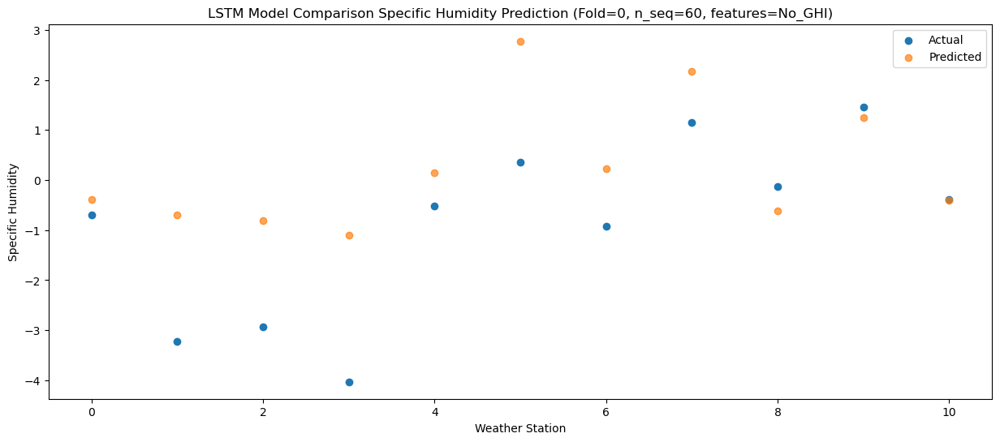

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04   0.175295
1                 1   -2.01  -0.125798
2                 2   -1.73  -0.242563
3                 3   -2.82  -0.534654
4                 4   -0.26   0.709797
5                 5    1.74   3.344486
6                 6    0.35   0.798937
7                 7    2.39   2.736397
8                 8    0.46  -0.053599
9                 9    2.20   1.812566
10               10    0.21   0.164014


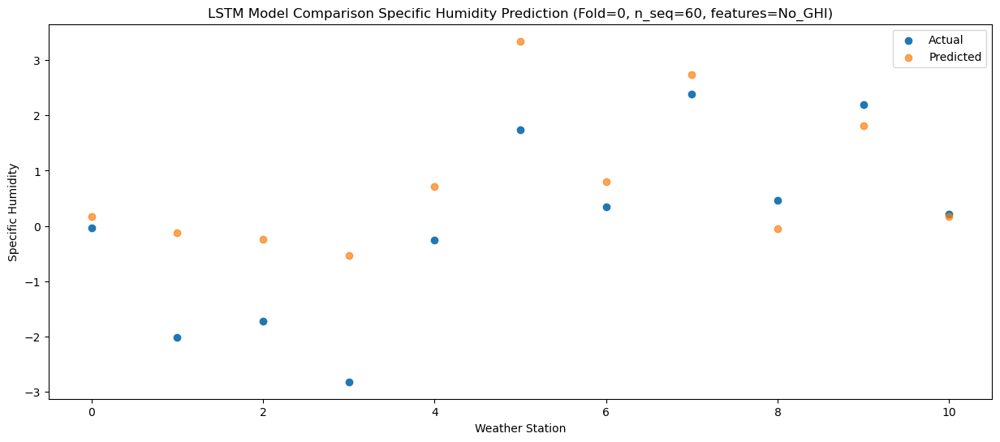

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36   1.318108
1                 1   -0.10   1.016305
2                 2   -1.02   0.895422
3                 3   -1.73   0.603366
4                 4    1.29   1.848286
5                 5    3.07   4.483746
6                 6    1.36   1.936782
7                 7    3.38   3.872921
8                 8    2.14   1.083151
9                 9    3.48   2.947870
10               10    1.46   1.299380


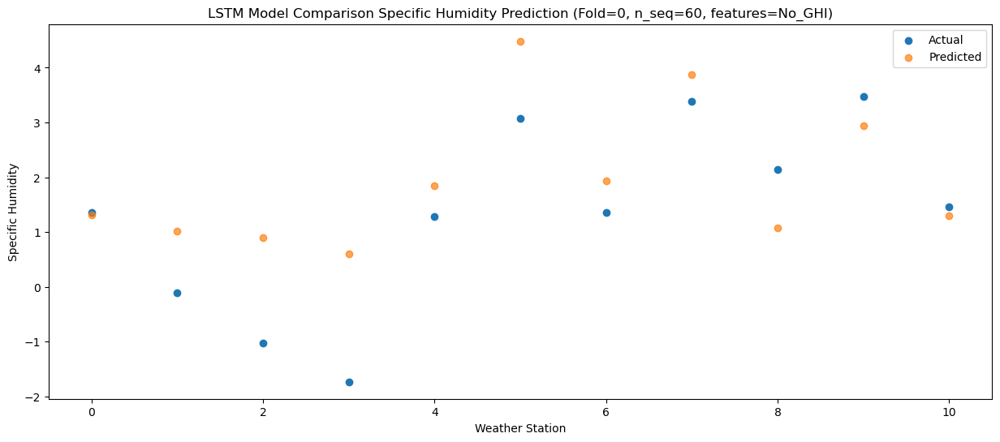

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   2.791025
1                 1    1.20   2.490143
2                 2    0.43   2.369857
3                 3    1.19   2.078062
4                 4    5.21   3.324227
5                 5    4.20   5.961410
6                 6    2.36   3.417815
7                 7    4.28   5.355122
8                 8    3.72   2.564992
9                 9    5.10   4.430139
10               10    2.40   2.781838


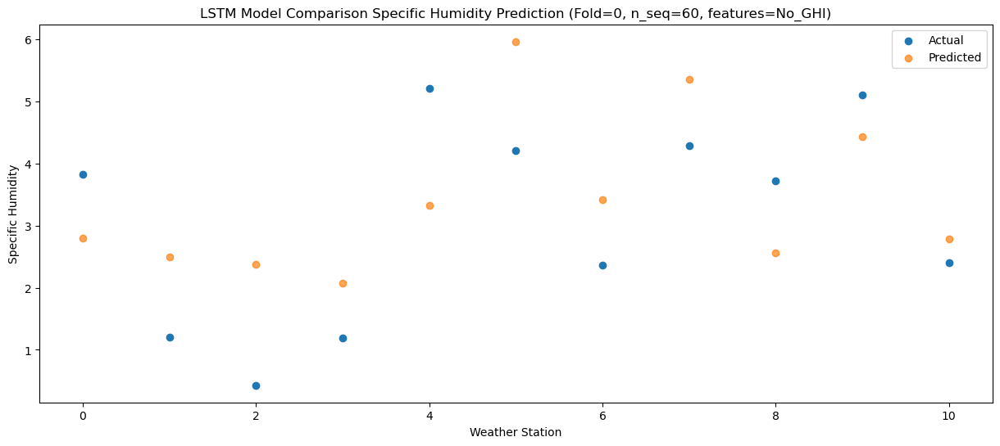

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   6.670874
1                 1    5.44   6.372588
2                 2    4.57   6.252615
3                 3    5.43   5.962269
4                 4    8.91   7.208027
5                 5    8.98   9.839712
6                 6    6.72   7.298794
7                 7    8.57   9.234665
8                 8    7.91   6.447772
9                 9    9.71   8.311161
10               10    6.12   6.658701


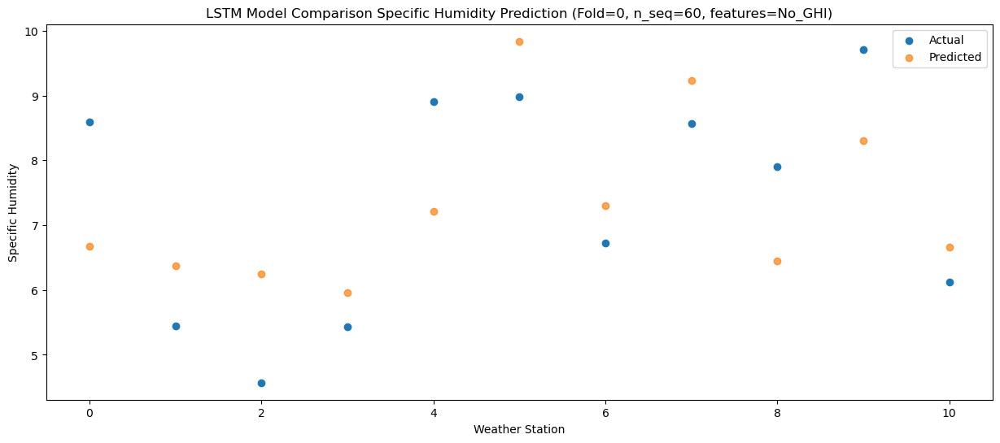

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52   8.705762
1                 1    8.05   8.406630
2                 2    7.35   8.283541
3                 3    7.44   7.993062
4                 4    9.88   9.239160
5                 5   10.07  11.870184
6                 6    8.60   9.328387
7                 7   10.02  11.262153
8                 8   10.09   8.478335
9                 9   11.39  10.338377
10               10    7.39   8.683019


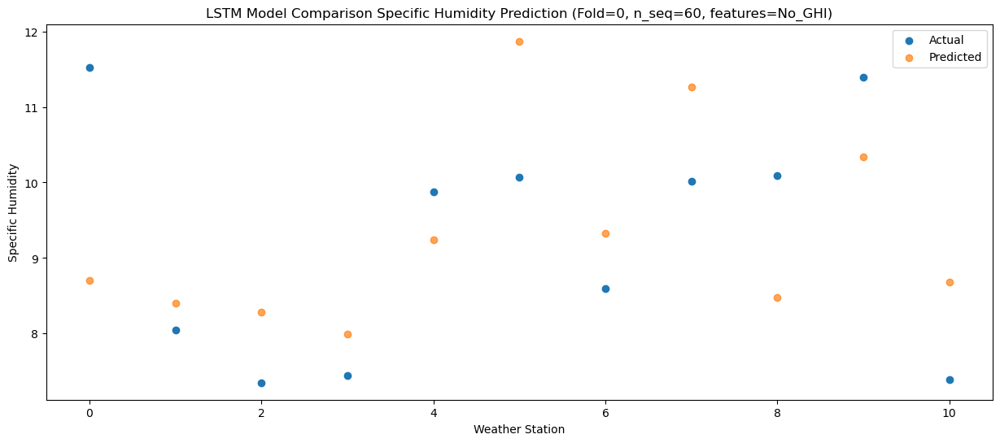

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10  10.665263
1                 1    8.95  10.369406
2                 2    9.55  10.245898
3                 3    8.65   9.956001
4                 4    9.64  11.198204
5                 5   14.40  13.833200
6                 6   12.22  11.293559
7                 7   13.39  13.228763
8                 8   13.75  10.442267
9                 9   14.97  12.305339
10               10    9.88  10.651918


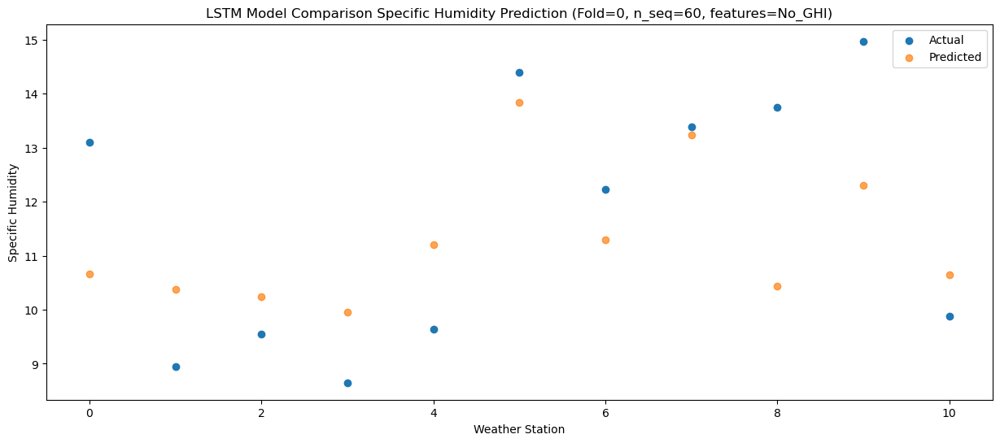

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68  10.587915
1                 1    8.38  10.292496
2                 2    8.85  10.166736
3                 3    7.93   9.877084
4                 4   10.73  11.120610
5                 5   12.61  13.754651
6                 6   10.87  11.215589
7                 7   12.32  13.150737
8                 8   12.78  10.363090
9                 9   13.43  12.226687
10               10   10.87  10.573127


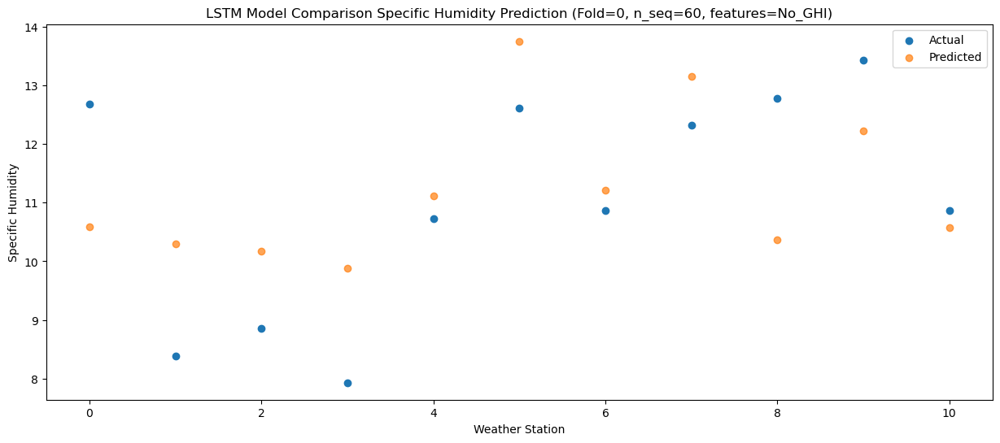

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   7.545451
1                 1    5.32   7.252808
2                 2    5.12   7.128334
3                 3    4.55   6.838993
4                 4    7.90   8.083206
5                 5    9.91  10.721612
6                 6    7.43   8.180343
7                 7    9.53  10.116593
8                 8    8.33   7.326831
9                 9   10.37   9.189705
10               10    8.27   7.535664


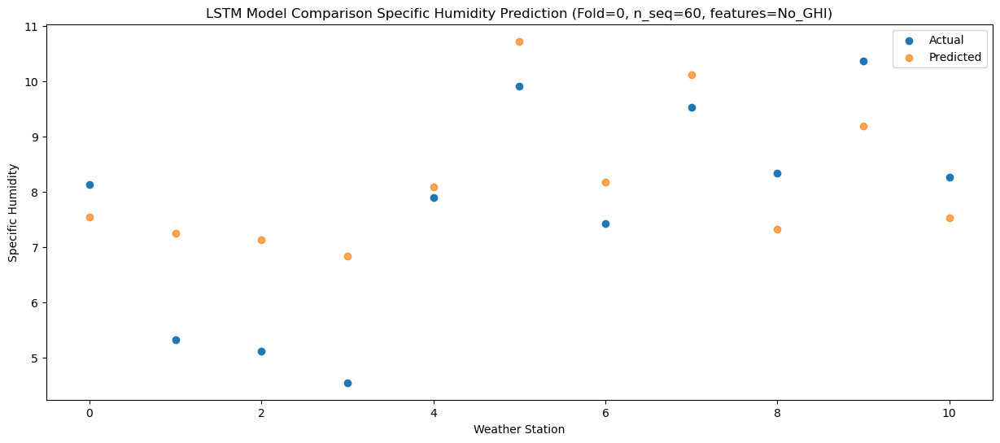

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   3.314603
1                 1    0.18   3.023878
2                 2    0.12   2.901833
3                 3   -0.55   2.611775
4                 4    3.10   3.854379
5                 5    5.27   6.493369
6                 6    2.87   3.953744
7                 7    5.11   5.889406
8                 8    3.10   3.096435
9                 9    4.58   4.958009
10               10    3.25   3.302743


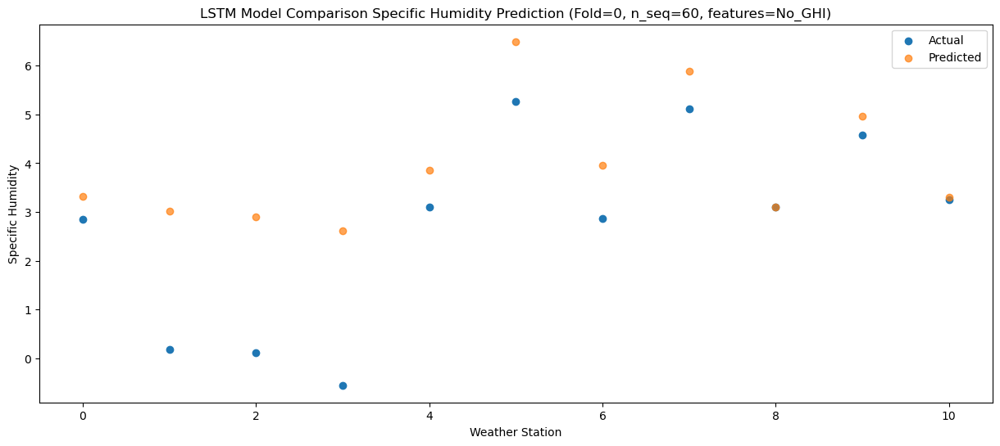

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   2.240563
1                 1   -0.02   1.951426
2                 2   -0.20   1.831746
3                 3   -1.07   1.541550
4                 4    3.09   2.782222
5                 5    4.61   5.423930
6                 6    2.27   2.882554
7                 7    4.41   4.817331
8                 8    2.10   2.025721
9                 9    3.86   3.887363
10               10    2.11   2.231608


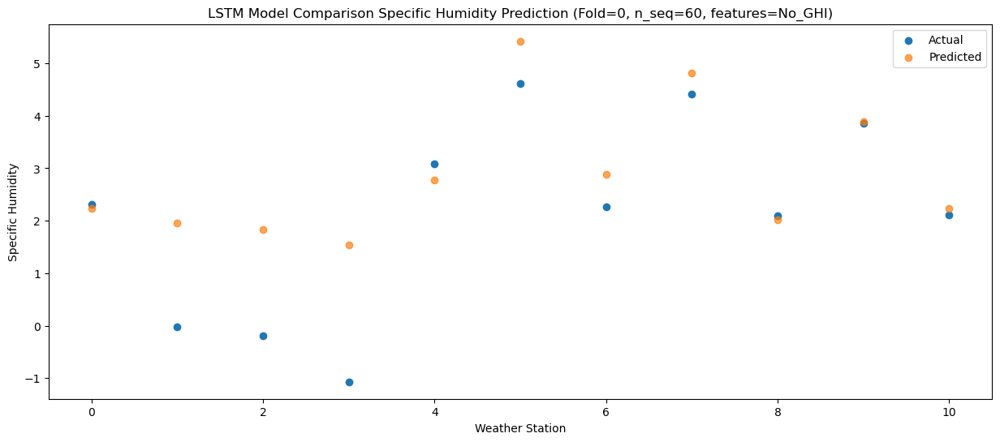

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85   0.891202
1                 1   -1.22   0.601781
2                 2   -1.53   0.481880
3                 3   -1.57   0.190573
4                 4    2.01   1.431503
5                 5    1.26   4.073416
6                 6    0.09   1.532240
7                 7    2.07   3.466193
8                 8    1.17   0.673344
9                 9    2.93   2.536060
10               10    0.94   0.880343


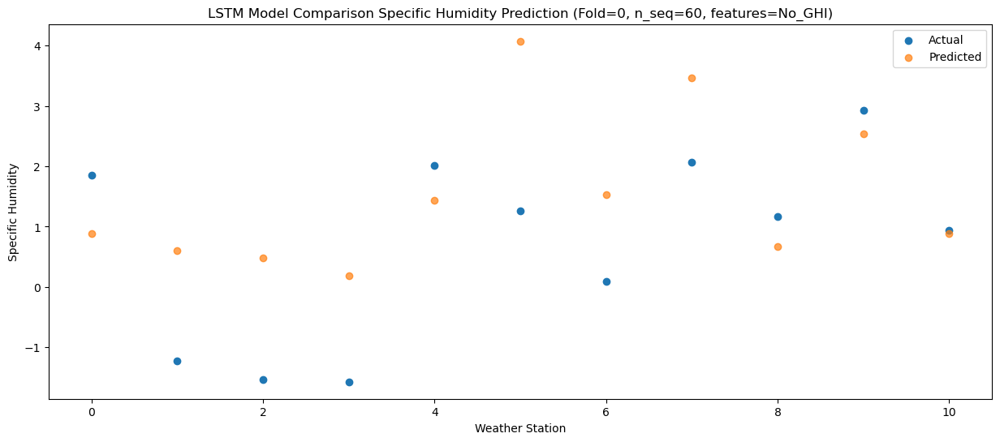

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45   1.156615
1                 1   -1.13   0.864490
2                 2   -1.16   0.745499
3                 3   -1.38   0.453589
4                 4    1.25   1.695750
5                 5    2.01   4.339603
6                 6    0.95   1.798996
7                 7    3.00   3.733103
8                 8    1.77   0.939738
9                 9    3.54   2.800777
10               10    1.34   1.143976


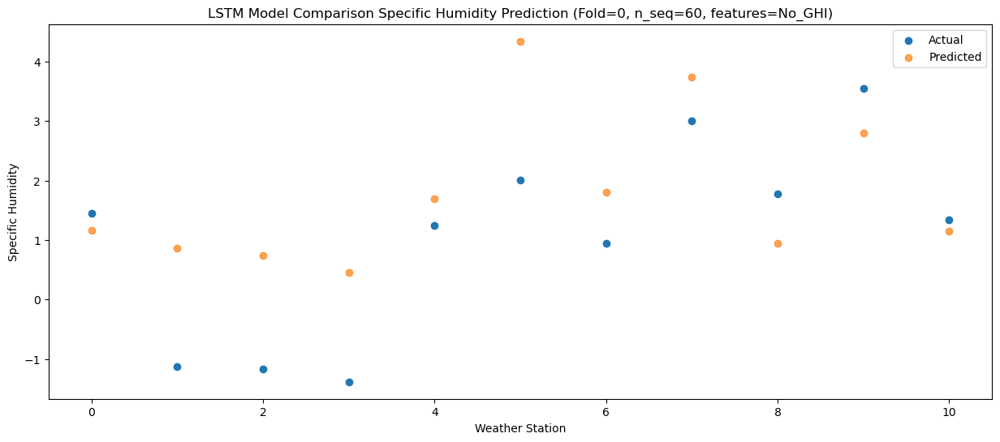

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07   0.939963
1                 1    0.56   0.648290
2                 2   -0.05   0.528845
3                 3   -0.71   0.236837
4                 4    1.59   1.483194
5                 5    2.94   4.124482
6                 6    1.63   1.581581
7                 7    3.36   3.514869
8                 8    1.84   0.721169
9                 9    3.31   2.580338
10               10    0.78   0.920796


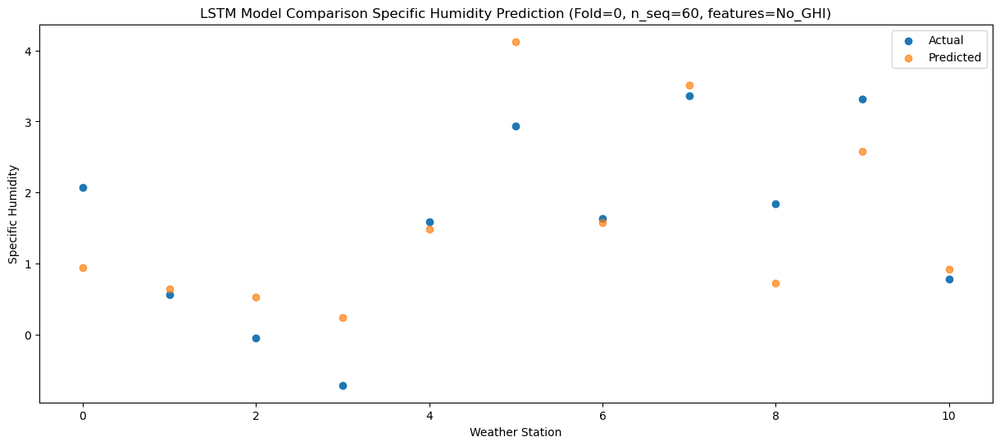

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67   1.492936
1                 1    0.94   1.202173
2                 2   -0.69   1.084049
3                 3    0.37   0.792888
4                 4    3.78   2.038499
5                 5    2.72   4.680409
6                 6    1.22   2.136333
7                 7    3.28   4.067622
8                 8    2.28   1.272657
9                 9    3.41   3.129886
10               10    1.24   1.467936


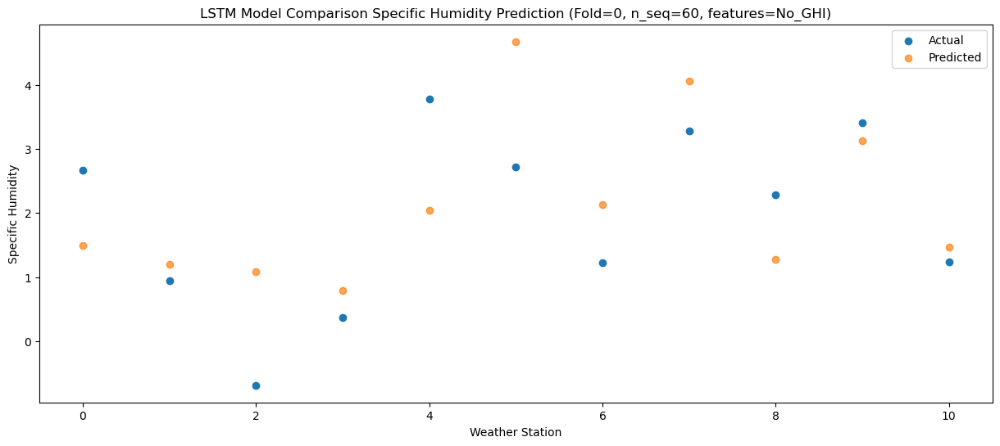

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   3.150666
1                 1    1.73   2.861889
2                 2    0.75   2.744896
3                 3    0.77   2.453085
4                 4    4.54   3.697070
5                 5    5.40   6.341597
6                 6    3.43   3.798026
7                 7    5.56   5.728263
8                 8    3.50   2.931138
9                 9    5.14   4.789437
10               10    2.88   3.128893


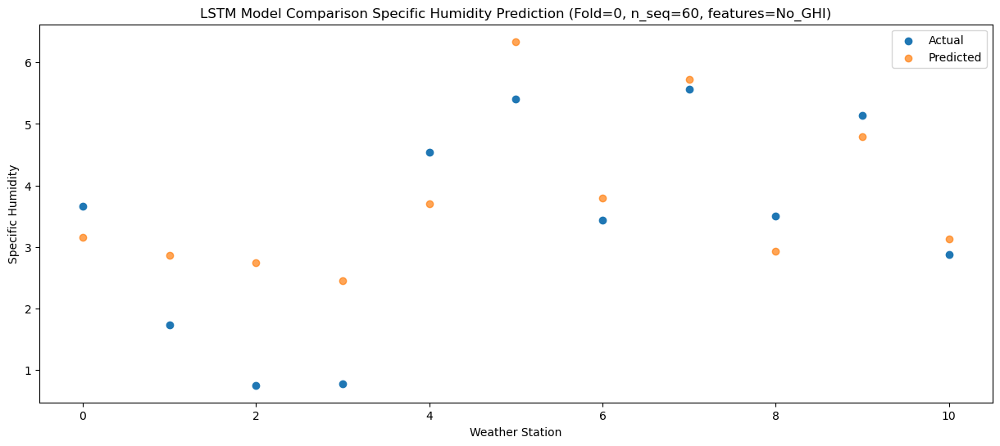

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   5.424287
1                 1    3.92   5.134863
2                 2    3.53   5.018518
3                 3    3.62   4.727525
4                 4    8.48   5.968946
5                 5    6.16   8.614282
6                 6    5.02   6.069573
7                 7    6.88   7.999126
8                 8    6.99   5.201534
9                 9    7.58   7.060398
10               10    4.09   5.399180


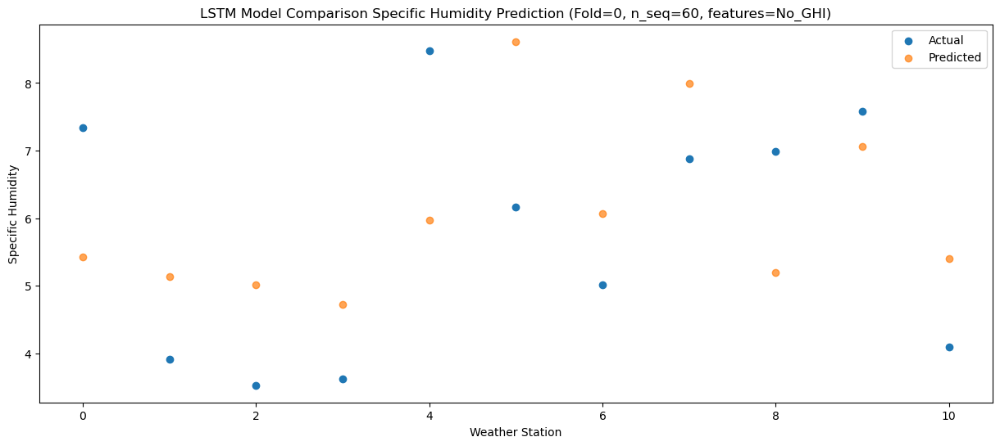

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   8.427909
1                 1    7.25   8.137046
2                 2    6.11   8.019038
3                 3    7.77   7.727872
4                 4   12.60   8.972741
5                 5   10.06  11.614741
6                 6    7.75   9.067706
7                 7    9.50  10.995021
8                 8    9.27   8.199202
9                 9   10.20  10.057079
10               10    7.10   8.396351


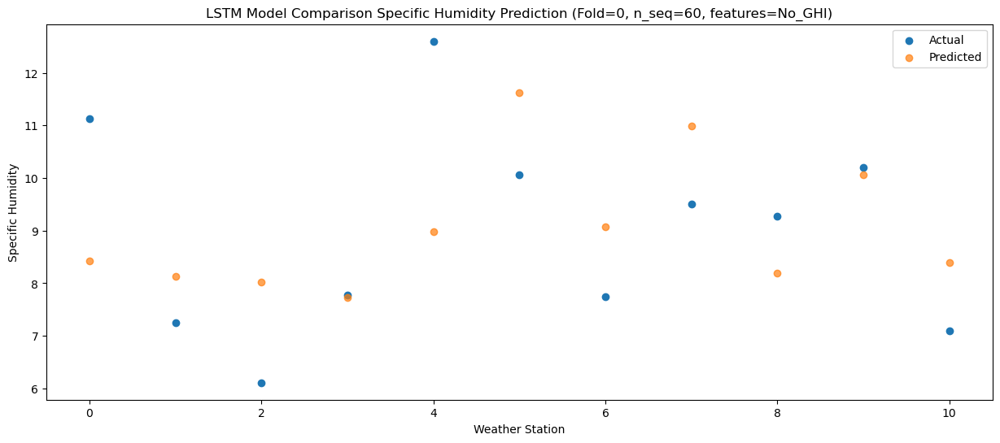

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42  11.699353
1                 1    8.92  11.409809
2                 2    8.97  11.291977
3                 3    8.80  10.999715
4                 4   11.18  12.243540
5                 5   14.41  14.888137
6                 6   11.49  12.341453
7                 7   13.85  14.268204
8                 8   12.82  11.470869
9                 9   14.02  13.331884
10               10   10.93  11.673363


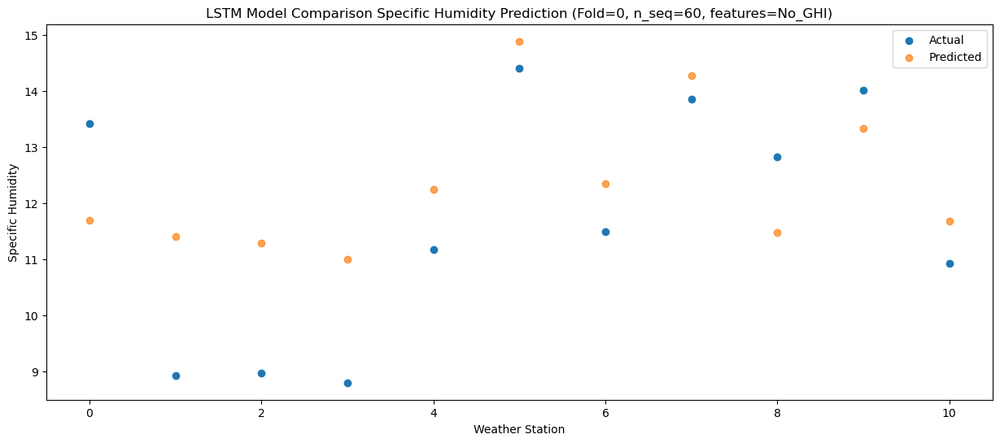

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04  10.529409
1                 1    9.70  10.236568
2                 2    9.06  10.116243
3                 3    8.55   9.825077
4                 4    9.36  11.068989
5                 5   13.52  13.711826
6                 6   11.12  11.163451
7                 7   12.79  13.087752
8                 8   12.82  10.293097
9                 9   12.72  12.153432
10               10   10.18  10.493516


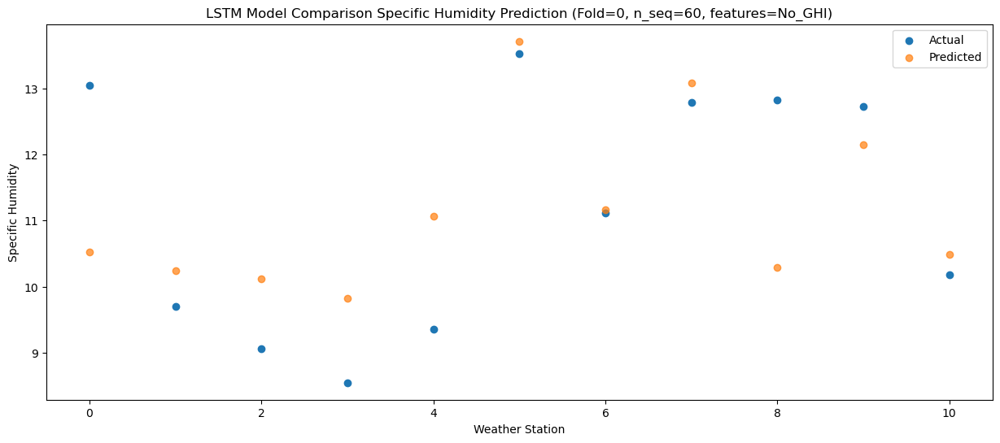

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.530626
1                 1    5.68   8.239930
2                 2    5.48   8.119585
3                 3    6.37   7.828507
4                 4    9.32   9.071303
5                 5   10.40  11.718142
6                 6    8.18   9.168669
7                 7    9.99  11.092355
8                 8    8.75   8.295343
9                 9   10.00  10.157007
10               10    8.87   8.498435


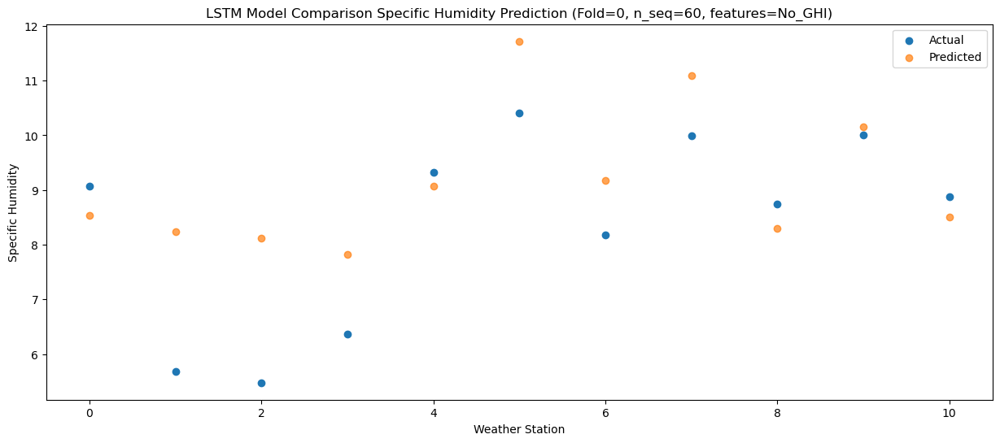

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   5.126465
1                 1    0.98   4.834925
2                 2    1.57   4.713476
3                 3    1.80   4.420349
4                 4    5.57   5.663226
5                 5    6.00   8.310689
6                 6    3.92   5.760583
7                 7    6.24   7.684753
8                 8    4.69   4.886766
9                 9    6.76   6.750151
10               10    5.11   5.090564


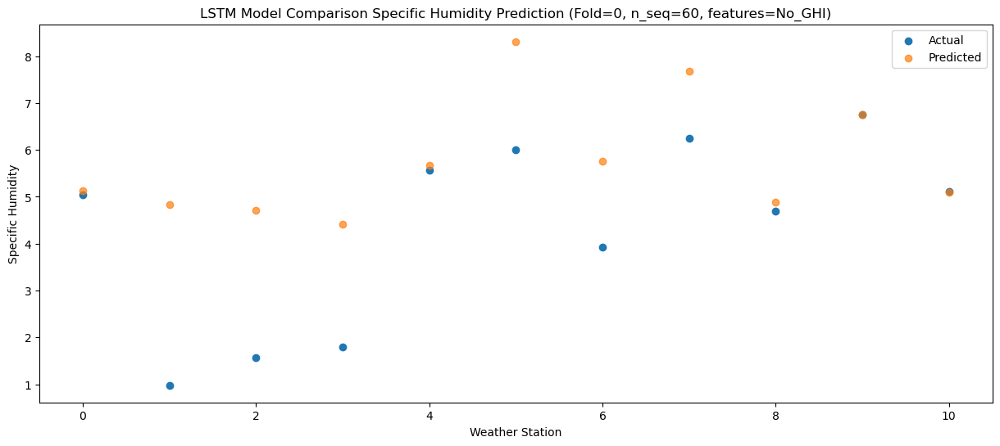

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86   1.984121
1                 1   -1.20   1.691427
2                 2   -0.96   1.566903
3                 3   -1.19   1.273915
4                 4    2.77   2.518597
5                 5    2.98   5.165396
6                 6    0.59   2.614492
7                 7    2.72   4.536382
8                 8    2.03   1.739716
9                 9    3.41   3.603822
10               10    1.70   1.946087


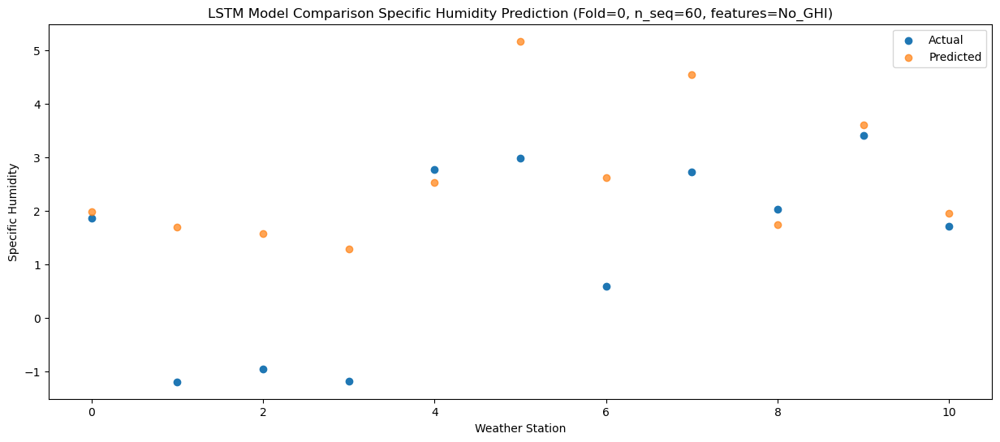

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58   1.641102
1                 1   -2.64   1.345676
2                 2   -1.77   1.219814
3                 3   -2.59   0.924823
4                 4    0.91   2.169661
5                 5    2.16   4.815432
6                 6    0.52   2.263964
7                 7    2.92   4.185874
8                 8    1.42   1.390109
9                 9    3.60   3.252807
10               10    2.23   1.596310


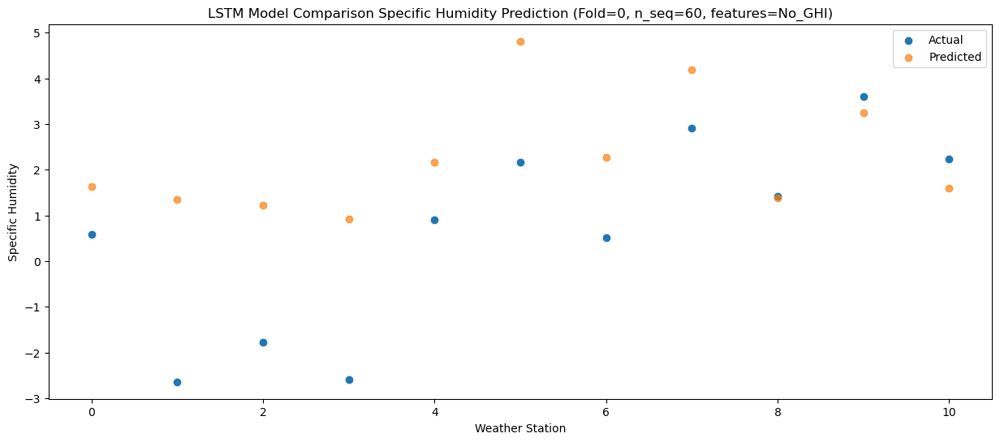

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24   0.589709
1                 1   -3.42   0.293472
2                 2   -2.57   0.166781
3                 3   -3.51  -0.128429
4                 4   -0.27   1.118868
5                 5    1.37   3.764197
6                 6   -0.15   1.213470
7                 7    2.23   3.133712
8                 8    0.24   0.338392
9                 9    2.63   2.202517
10               10    0.71   0.547726


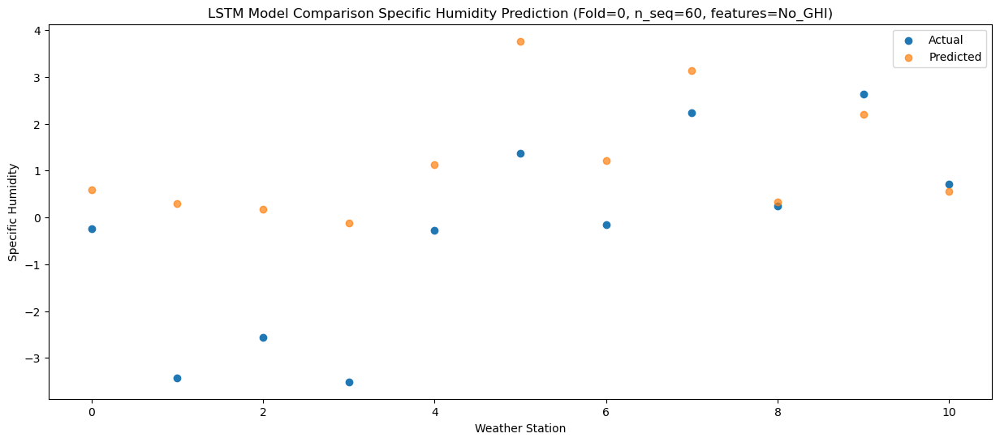

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66   1.033769
1                 1   -2.20   0.738275
2                 2   -1.93   0.610493
3                 3   -1.73   0.317658
4                 4    2.30   1.566022
5                 5    1.27   4.207920
6                 6    0.01   1.657746
7                 7    2.26   3.577957
8                 8    2.00   0.782833
9                 9    2.98   2.646483
10               10    1.24   0.991022


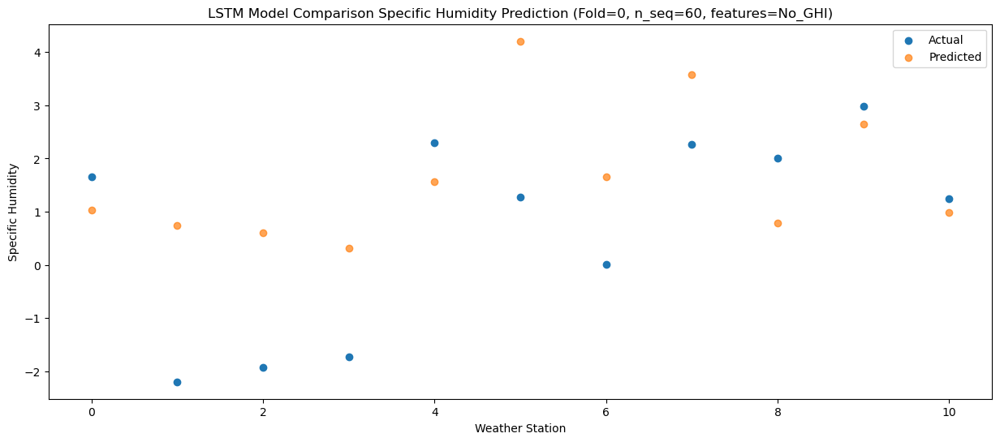

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92   2.233263
1                 1   -0.35   1.936593
2                 2   -0.30   1.807977
3                 3    0.06   1.516739
4                 4    4.04   2.765647
5                 5    3.19   5.403999
6                 6    1.46   2.852338
7                 7    3.40   4.772110
8                 8    2.87   1.976313
9                 9    4.11   3.838363
10               10    1.93   2.182991


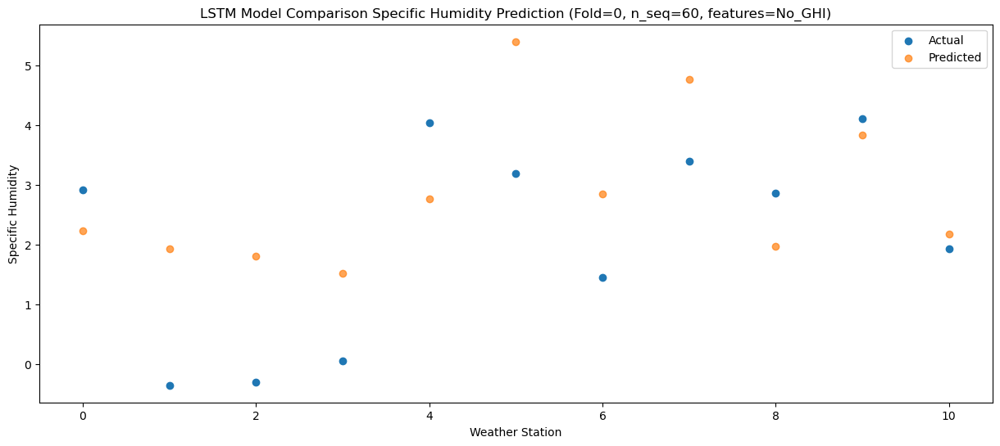

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23   3.700981
1                 1    1.56   3.403280
2                 2    1.44   3.272265
3                 3    2.11   2.980933
4                 4    6.28   4.233113
5                 5    4.53   6.870835
6                 6    3.52   4.320711
7                 7    5.42   6.240753
8                 8    5.10   3.448334
9                 9    6.48   5.310596
10               10    3.49   3.654212


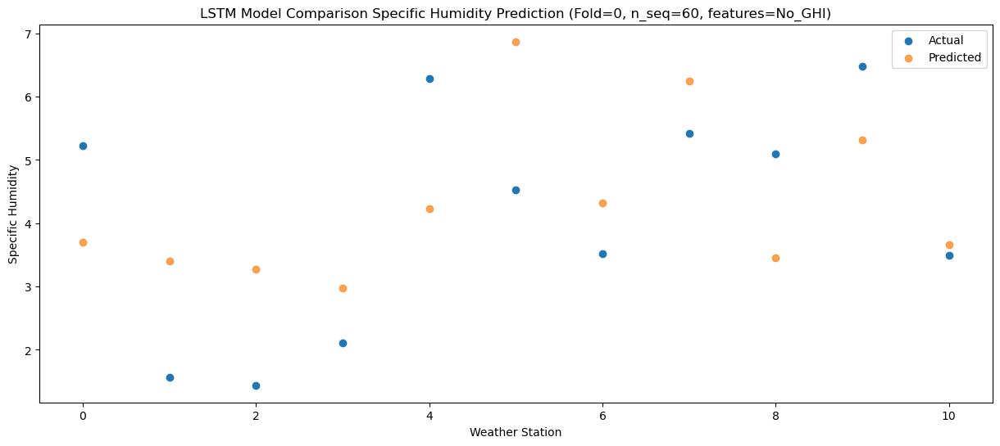

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70   7.418926
1                 1    6.14   7.123037
2                 2    5.19   6.991328
3                 3    6.68   6.702122
4                 4   10.53   7.952322
5                 5    8.59  10.588381
6                 6    7.43   8.040120
7                 7    9.24   9.960033
8                 8    9.38   7.170434
9                 9   10.28   9.032732
10               10    6.54   7.376056


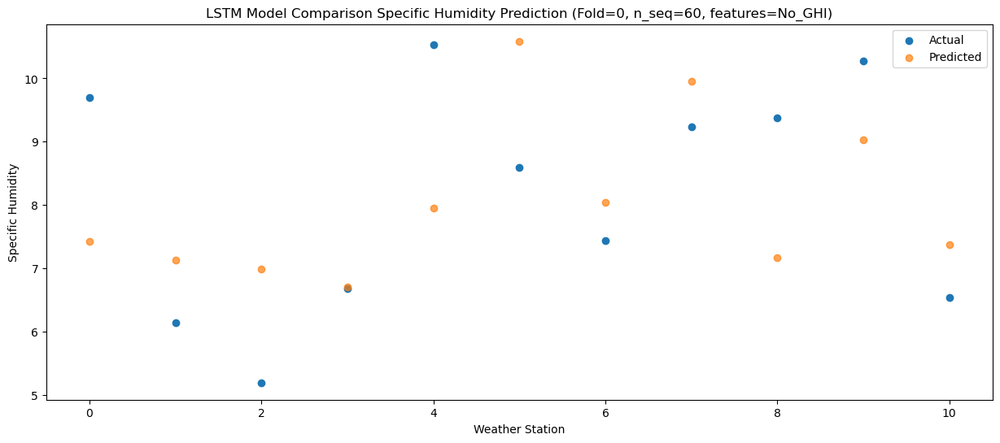

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09   9.736492
1                 1    7.74   9.439339
2                 2    6.32   9.306595
3                 3    8.19   9.014874
4                 4   12.18  10.264836
5                 5   10.56  12.902707
6                 6    9.25  10.355956
7                 7   10.93  12.274748
8                 8   11.80   9.485223
9                 9   11.35  11.346367
10               10    9.04   9.689657


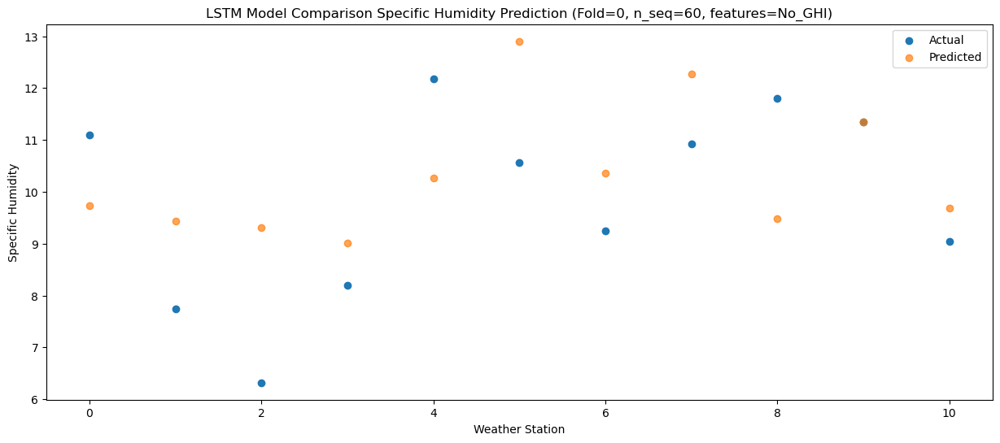

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38  11.486906
1                 1    9.91  11.192107
2                 2    9.55  11.062117
3                 3    9.59  10.771041
4                 4   11.92  12.019700
5                 5   13.35  14.661580
6                 6   11.78  12.114793
7                 7   13.82  14.034507
8                 8   12.98  11.242595
9                 9   12.85  13.104201
10               10   10.11  11.444788


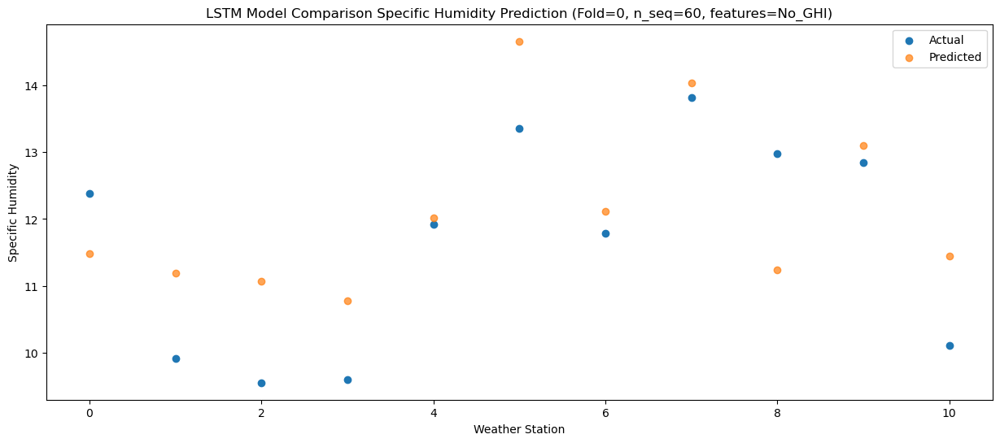

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55  10.779054
1                 1    8.41  10.482149
2                 2    7.86  10.351781
3                 3    8.45  10.061099
4                 4   11.57  11.310935
5                 5   12.34  13.950379
6                 6   10.62  11.404275
7                 7   12.39  13.322859
8                 8   11.31  10.532728
9                 9   12.05  12.395847
10               10    9.87  10.737053


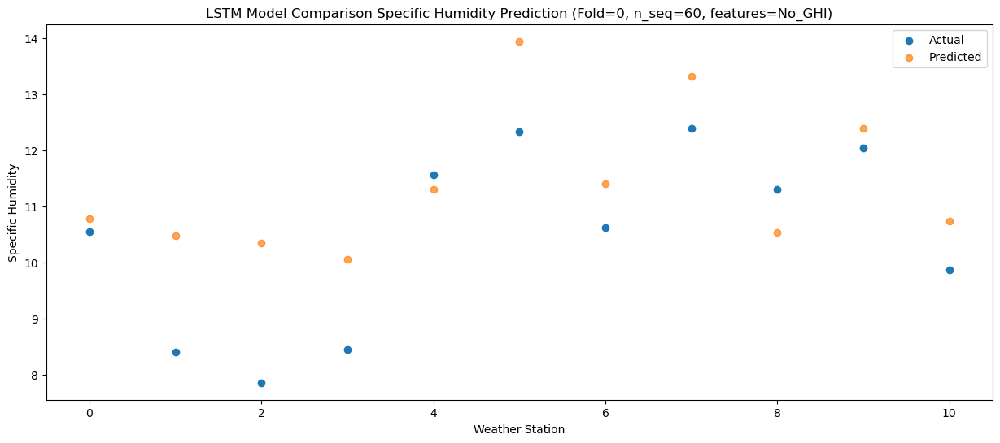

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08   7.890424
1                 1    7.54   7.598636
2                 2    6.17   7.471843
3                 3    6.89   7.183115
4                 4    9.08   8.429248
5                 5   10.39  11.070143
6                 6    8.89   8.528699
7                 7   10.80  10.448328
8                 8    9.27   7.655257
9                 9    9.70   9.518892
10               10    8.16   7.859687


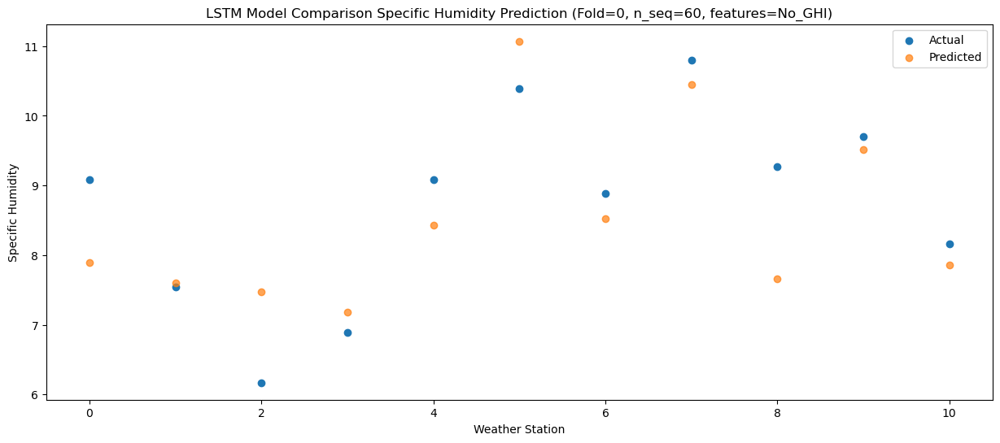

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.300480
1                 1    2.14   4.009646
2                 2    2.04   3.882656
3                 3    1.70   3.592029
4                 4    5.47   4.836963
5                 5    5.10   7.482689
6                 6    4.19   4.942431
7                 7    5.91   6.862058
8                 8    4.67   4.067303
9                 9    6.17   5.929484
10               10    3.96   4.267834


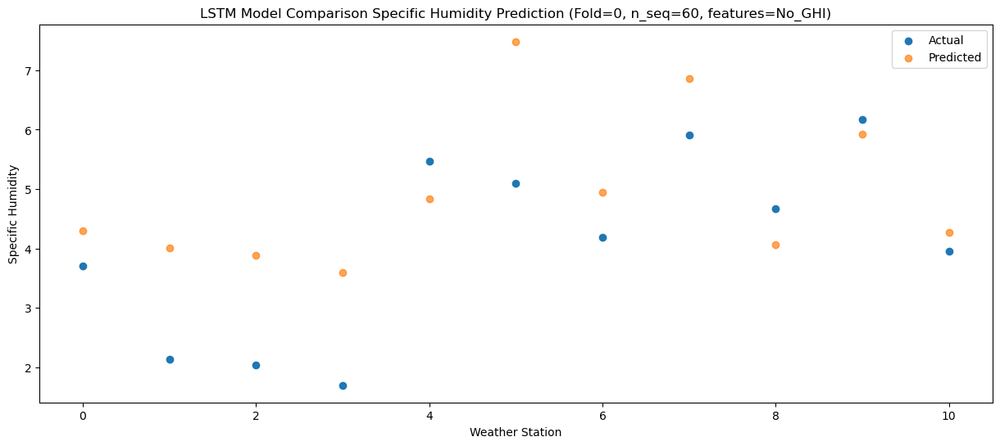

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (1, 1, 1024)              11632640  
                                                                 
 dropout (Dropout)           (1, 1, 1024)              0         
                                                                 
 lstm_1 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_1 (Dropout)         (1, 1024)                 0         
                                                                 
 dense (Dense)               (1, 256)                  262400    
                                                                 
 dense_1 (Dense)             (1, 128)                  32896     
                                                                 
 dense_2 (Dense)             (1, 60)                   7

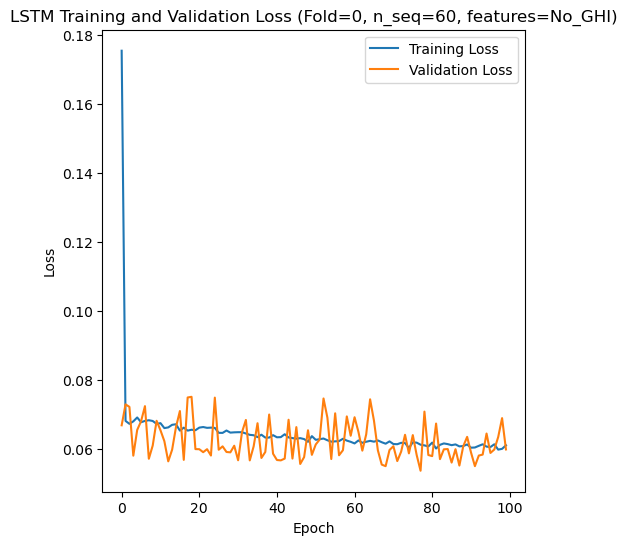

Epoch 1/100
84/84 [==============================] - 9s 58ms/step - loss: 0.1297 - accuracy: 0.4881 - mae: 0.1061 - rmse: 0.1297 - mape: 23.2652 - pearson: 0.6479 - val_loss: 0.0637 - val_accuracy: 0.5000 - val_mae: 0.0494 - val_rmse: 0.0637 - val_mape: 10.9429 - val_pearson: 0.7717
Epoch 2/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0678 - accuracy: 0.4524 - mae: 0.0533 - rmse: 0.0678 - mape: 12.1518 - pearson: 0.7677 - val_loss: 0.0646 - val_accuracy: 0.5000 - val_mae: 0.0497 - val_rmse: 0.0646 - val_mape: 10.9803 - val_pearson: 0.7794
Epoch 3/100
84/84 [==============================] - 4s 43ms/step - loss: 0.0681 - accuracy: 0.4643 - mae: 0.0536 - rmse: 0.0681 - mape: 12.2433 - pearson: 0.7675 - val_loss: 0.0745 - val_accuracy: 0.5000 - val_mae: 0.0594 - val_rmse: 0.0745 - val_mape: 13.2079 - val_pearson: 0.7166
Epoch 4/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0688 - accuracy: 0.5357 - mae: 0.0540 - rmse: 0.0688 - mape: 12.1807 - p

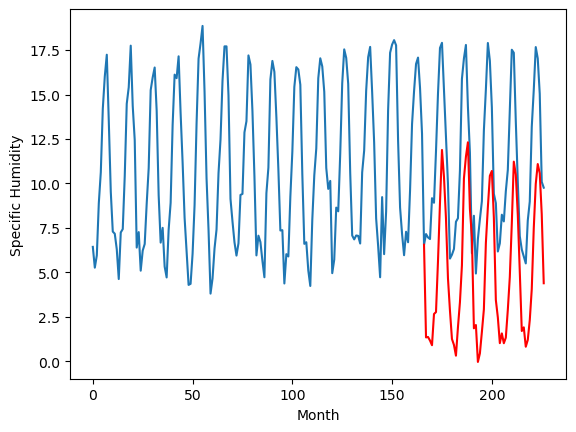

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		0.84		1.84
-0.95		0.87		1.82
-1.20		0.67		1.87
-0.68		0.40		1.08
1.55		2.16		0.61
-0.04		2.27		2.31
2.97		5.13		2.16
6.77		8.42		1.65
8.81		11.39		2.58
8.86		9.87		1.01
5.96		7.54		1.58
3.29		4.17		0.88
0.23		2.34		2.11
-2.36		0.75		3.11
-2.34		0.42		2.76
-2.15		-0.19		1.96
-0.62		1.41		2.03
-0.26		2.82		3.08
2.66		4.90		2.24
6.64		9.78		3.14
8.51		11.01		2.50
8.72		11.82		3.10
5.77		8.06		2.29
3.73		6.48		2.75
-1.86		1.35		3.21
0.31		1.54		1.23
-2.69		-0.54		2.15
-1.74		-0.06		1.68
-1.06		1.14		2.20
0.00		2.42		2.42
4.17		6.15		1.98
6.57		8.16		1.59
9.24		9.93		0.69
8.83		10.20		1.37
5.47		7.59		2.12
0.58		2.94		2.36
0.10		1.96		1.86
-1.49		0.51		2.00
-1.08		1.06		2.14
0.04		0.50		0.46
-0.83		0.82		1.65
0.77		2.39		1.62
3.51		4.23		0.72
5.86		7.25		1.39
8.82		10.71		1.89
8.95		9.99		1.04
5.84		7.72		1.88
1.99		4.51		2.52
-1.02		1.18		2.20
-1.60		1.39		2.99
-2.37		0.30		2.67
-2.03		0.6

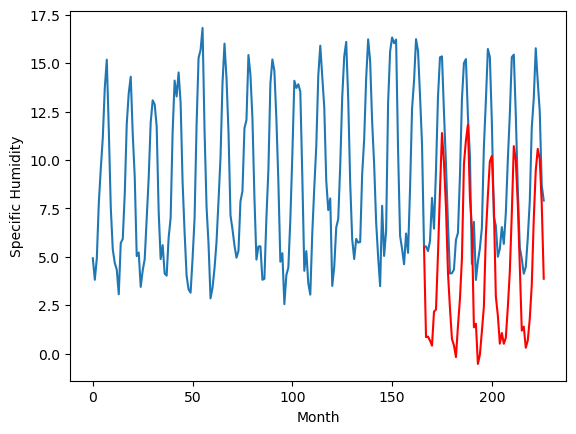

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		-0.41		1.49
-0.99		-0.38		0.61
-1.50		-0.58		0.92
-1.11		-0.84		0.27
2.05		0.91		-1.14
0.43		1.02		0.59
3.20		3.88		0.68
7.05		7.17		0.12
9.60		10.14		0.54
9.12		8.63		-0.49
6.17		6.29		0.12
3.41		2.92		-0.49
0.23		1.09		0.86
-2.54		-0.50		2.04
-2.39		-0.83		1.56
-2.39		-1.44		0.95
0.23		0.16		-0.07
-0.06		1.57		1.63
2.78		3.65		0.87
7.30		8.53		1.23
8.89		9.75		0.86
9.11		10.56		1.45
6.35		6.81		0.46
3.60		5.23		1.63
-1.90		0.10		2.00
0.74		0.29		-0.45
-3.14		-1.79		1.35
-2.11		-1.32		0.79
-1.32		-0.11		1.21
0.44		1.16		0.72
4.80		4.90		0.10
7.89		6.91		-0.98
9.52		8.67		-0.85
8.65		8.95		0.30
5.14		6.33		1.19
0.03		1.68		1.65
-0.34		0.70		1.04
-1.03		-0.75		0.28
-1.06		-0.20		0.86
-0.01		-0.76		-0.75
-0.48		-0.44		0.04
0.88		1.13		0.25
4.18		2.97		-1.21
6.83		5.99		-0.84
9.97		9.46		-0.51
9.90		8.73		-1.17
6.09		6.46		0.37
1.58		3.25		1.67
-0.97		-0.08		0.89
-1.99		0.13		2.12
-2.62		

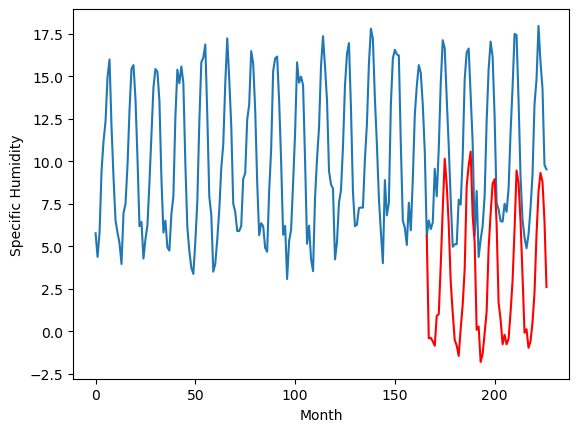

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-1.10		0.41
-2.71		-1.08		1.63
-1.81		-1.28		0.53
-2.51		-1.55		0.96
1.85		0.21		-1.64
1.51		0.32		-1.19
3.49		3.18		-0.31
5.61		6.46		0.85
8.12		9.43		1.31
7.01		7.91		0.90
5.43		5.58		0.15
2.03		2.21		0.18
-0.07		0.38		0.45
-2.62		-1.21		1.41
-2.96		-1.54		1.42
-2.89		-2.15		0.74
-0.25		-0.56		-0.31
1.09		0.85		-0.24
4.98		2.93		-2.05
8.17		7.81		-0.36
8.65		9.03		0.38
8.99		9.84		0.85
5.90		6.09		0.19
3.65		4.51		0.86
-0.80		-0.62		0.18
2.12		-0.43		-2.55
-3.53		-2.51		1.02
-3.36		-2.03		1.33
-1.68		-0.83		0.85
2.48		0.45		-2.03
6.29		4.18		-2.11
7.34		6.19		-1.15
8.26		7.96		-0.30
8.51		8.23		-0.28
5.22		5.62		0.40
0.26		0.97		0.71
-0.24		-0.01		0.23
-1.05		-1.46		-0.41
-1.47		-0.91		0.56
-0.69		-1.46		-0.77
0.86		-1.15		-2.01
1.23		0.41		-0.82
5.01		2.26		-2.75
8.41		5.28		-3.13
8.97		8.74		-0.23
7.30		8.02		0.72
6.10		5.75		-0.35
2.68		2.54		-0.14
-0.65		-0.79		-0.14
-2.29		-0.58

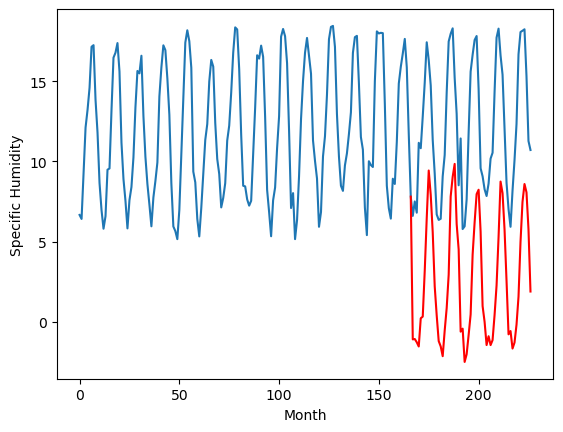

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		2.96		0.75
0.97		2.98		2.01
1.88		2.78		0.90
1.20		2.51		1.31
5.93		4.27		-1.66
5.62		4.37		-1.25
7.74		7.23		-0.51
10.03		10.52		0.49
12.63		13.49		0.86
11.18		11.97		0.79
9.69		9.64		-0.05
5.84		6.26		0.42
3.36		4.44		1.08
0.54		2.85		2.31
0.29		2.51		2.22
0.33		1.90		1.57
3.05		3.50		0.45
4.31		4.90		0.59
8.34		6.98		-1.36
11.75		11.86		0.11
11.93		13.08		1.15
11.97		13.89		1.92
8.87		10.14		1.27
6.92		8.56		1.64
2.33		3.43		1.10
5.26		3.62		-1.64
-0.28		1.55		1.83
-0.08		2.02		2.10
1.62		3.23		1.61
5.72		4.51		-1.21
9.60		8.24		-1.36
10.72		10.25		-0.47
11.47		12.02		0.55
11.85		12.29		0.44
8.50		9.68		1.18
3.60		5.03		1.43
3.22		4.05		0.83
2.40		2.61		0.21
1.92		3.16		1.24
2.52		2.61		0.09
4.22		2.92		-1.30
4.67		4.48		-0.19
8.34		6.32		-2.02
11.60		9.34		-2.26
11.68		12.80		1.12
10.28		12.08		1.80
9.53		9.81		0.28
6.14		6.60		0.46
2.80		3.27		0.47
1.08		3.48		2.40
-0.09		2.39		2.4

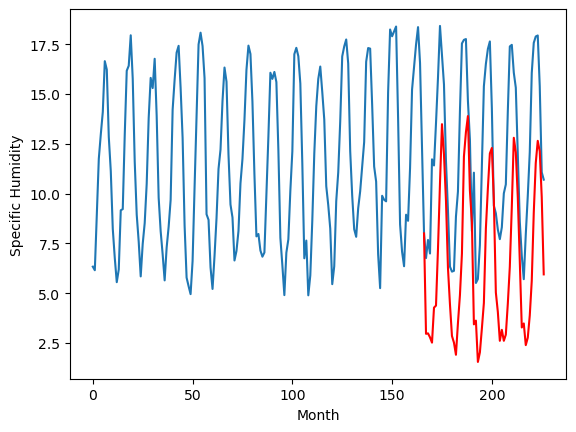

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		1.45		-1.90
1.87		1.47		-0.40
1.59		1.27		-0.32
1.77		1.00		-0.77
4.44		2.76		-1.68
3.43		2.86		-0.57
6.11		5.71		-0.40
7.93		9.00		1.07
8.92		11.96		3.04
7.69		10.45		2.76
7.26		8.12		0.86
3.75		4.75		1.00
3.19		2.93		-0.26
0.75		1.34		0.59
1.58		1.00		-0.58
0.95		0.39		-0.56
1.74		1.98		0.24
3.04		3.39		0.35
7.35		5.47		-1.88
9.52		10.35		0.83
10.85		11.57		0.72
11.07		12.38		1.31
7.53		8.63		1.10
4.42		7.05		2.63
2.58		1.93		-0.65
1.53		2.11		0.58
0.26		0.04		-0.22
0.14		0.52		0.38
0.69		1.72		1.03
2.96		3.00		0.04
4.73		6.73		2.00
7.33		8.75		1.42
8.28		10.51		2.23
10.39		10.78		0.39
9.12		8.17		-0.95
5.93		3.53		-2.40
3.06		2.56		-0.50
2.39		1.11		-1.28
0.84		1.66		0.82
0.87		1.11		0.24
1.92		1.42		-0.50
2.18		2.98		0.80
6.55		4.83		-1.72
6.50		7.84		1.34
8.67		11.30		2.63
8.82		10.57		1.75
8.46		8.31		-0.15
6.48		5.10		-1.38
3.85		1.77		-2.08
1.98		1.97		-0.01
0.83		0.89		0.06
1.2

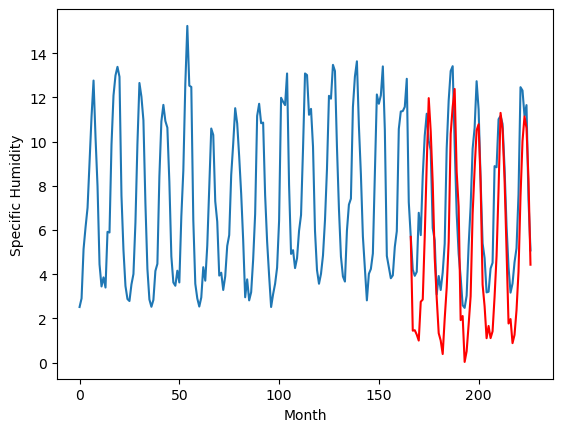

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		2.30		1.60
0.73		2.32		1.59
0.31		2.12		1.81
0.79		1.85		1.06
2.76		3.61		0.85
2.11		3.71		1.60
5.31		6.57		1.26
8.95		9.86		0.91
11.39		12.82		1.43
11.41		11.31		-0.10
8.10		8.98		0.88
5.61		5.60		-0.01
2.50		3.78		1.28
-0.22		2.19		2.41
-0.33		1.85		2.18
-0.21		1.25		1.46
1.35		2.84		1.49
1.97		4.25		2.28
4.90		6.33		1.43
9.25		11.21		1.96
11.75		12.43		0.68
12.04		13.24		1.20
8.69		9.49		0.80
6.56		7.91		1.35
0.63		2.78		2.15
2.50		2.97		0.47
-0.50		0.89		1.39
0.63		1.37		0.74
1.38		2.57		1.19
2.57		3.85		1.28
6.83		7.58		0.75
9.55		9.60		0.05
12.54		11.36		-1.18
11.45		11.64		0.19
7.97		9.03		1.06
2.91		4.38		1.47
2.42		3.40		0.98
0.52		1.95		1.43
0.88		2.50		1.62
2.08		1.95		-0.13
1.32		2.26		0.94
3.13		3.82		0.69
5.69		5.66		-0.03
8.27		8.68		0.41
11.89		12.14		0.25
11.78		11.41		-0.37
8.81		9.15		0.34
4.56		5.94		1.38
1.21		2.61		1.40
0.71		2.81		2.10
-0.11		1.72		1.83
0.37		2.10

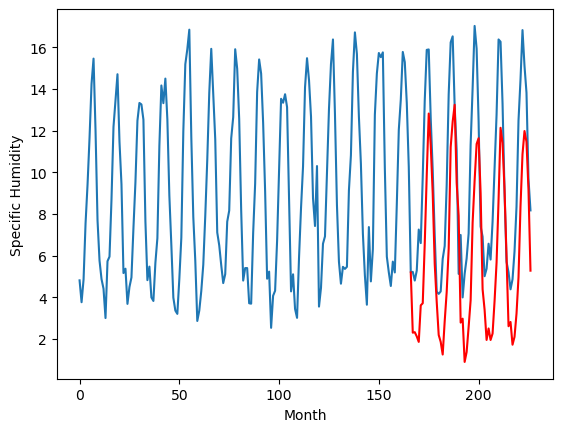

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		3.19		0.08
2.78		3.21		0.43
2.70		3.01		0.31
2.58		2.74		0.16
5.24		4.49		-0.75
5.50		4.60		-0.90
8.40		7.45		-0.95
12.23		10.74		-1.49
15.31		13.70		-1.61
13.14		12.19		-0.95
11.34		9.85		-1.49
6.52		6.48		-0.04
4.50		4.65		0.15
2.18		3.06		0.88
2.05		2.73		0.68
1.53		2.12		0.59
4.26		3.71		-0.55
5.49		5.12		-0.37
8.70		7.20		-1.50
13.46		12.07		-1.39
14.09		13.30		-0.79
13.94		14.11		0.17
10.69		10.35		-0.34
7.96		8.77		0.81
3.40		3.64		0.24
5.04		3.83		-1.21
1.29		1.75		0.46
1.97		2.23		0.26
3.50		3.43		-0.07
5.69		4.71		-0.98
10.14		8.44		-1.70
12.90		10.46		-2.44
13.87		12.22		-1.65
13.78		12.49		-1.29
9.82		9.89		0.07
5.28		5.24		-0.04
4.03		4.26		0.23
3.12		2.81		-0.31
3.24		3.36		0.12
3.34		2.80		-0.54
4.10		3.12		-0.98
5.30		4.68		-0.62
9.34		6.52		-2.82
12.26		9.54		-2.72
14.83		13.00		-1.83
14.41		12.28		-2.13
9.92		10.01		0.09
6.67		6.80		0.13
3.96		3.47		-0.49
2.57		3.67		1

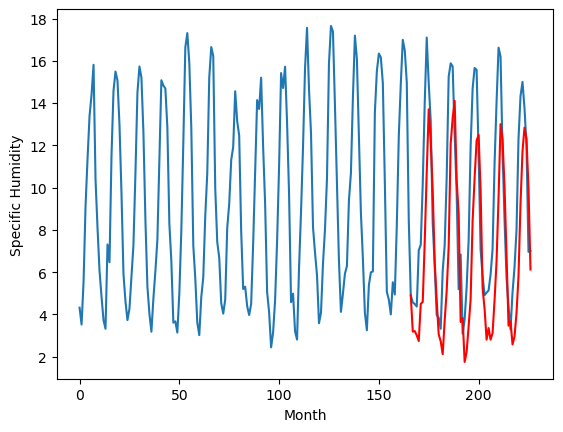

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		2.86		-1.17
3.19		2.88		-0.31
3.64		2.68		-0.96
3.02		2.41		-0.61
6.04		4.17		-1.87
6.23		4.27		-1.96
9.56		7.12		-2.44
11.70		10.40		-1.30
15.06		13.37		-1.69
12.16		11.86		-0.30
10.68		9.52		-1.16
6.01		6.14		0.13
4.90		4.32		-0.58
2.62		2.73		0.11
2.78		2.40		-0.38
1.97		1.79		-0.18
4.58		3.39		-1.19
5.74		4.79		-0.95
9.96		6.87		-3.09
13.10		11.74		-1.36
14.15		12.96		-1.19
13.73		13.77		0.04
10.16		10.02		-0.14
7.72		8.43		0.71
4.19		3.31		-0.88
3.58		3.49		-0.09
1.60		1.42		-0.18
2.13		1.90		-0.23
3.22		3.10		-0.12
6.34		4.38		-1.96
10.58		8.11		-2.47
12.48		10.12		-2.36
11.84		11.88		0.04
12.58		12.15		-0.43
9.84		9.54		-0.30
5.89		4.90		-0.99
4.91		3.92		-0.99
3.17		2.47		-0.70
2.69		3.02		0.33
3.02		2.47		-0.55
4.44		2.79		-1.65
5.66		4.34		-1.32
10.71		6.19		-4.52
13.29		9.21		-4.08
13.52		12.67		-0.85
11.69		11.94		0.25
10.74		9.68		-1.06
7.31		6.47		-0.84
4.64		3.14		-1.50
3

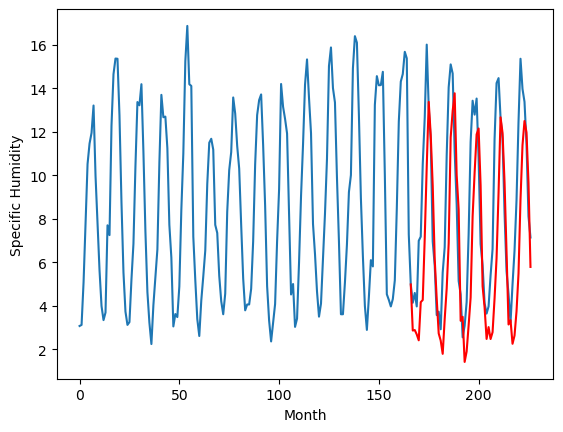

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		-0.95		-1.75
0.15		-0.92		-1.07
-0.00		-1.13		-1.13
0.01		-1.40		-1.41
1.90		0.36		-1.54
2.06		0.45		-1.61
4.88		3.31		-1.57
6.59		6.59		0.00
9.48		9.56		0.08
8.16		8.04		-0.12
5.37		5.71		0.34
1.85		2.33		0.48
1.53		0.51		-1.02
-0.33		-1.09		-0.76
-0.14		-1.42		-1.28
-0.88		-2.03		-1.15
0.94		-0.43		-1.37
1.11		0.98		-0.13
6.26		3.06		-3.20
9.25		7.93		-1.32
10.49		9.15		-1.34
9.46		9.96		0.50
6.50		6.21		-0.29
3.06		4.63		1.57
0.70		-0.49		-1.19
-0.28		-0.31		-0.03
-0.92		-2.39		-1.47
-1.00		-1.90		-0.90
-0.04		-0.70		-0.66
0.93		0.58		-0.35
3.49		4.32		0.83
7.67		6.33		-1.34
8.32		8.08		-0.24
8.73		8.35		-0.38
6.73		5.75		-0.98
3.34		1.10		-2.24
1.36		0.13		-1.23
0.15		-1.32		-1.47
-0.16		-0.77		-0.61
-0.30		-1.32		-1.02
0.49		-1.00		-1.49
1.01		0.55		-0.46
6.74		2.41		-4.33
8.35		5.42		-2.93
10.28		8.88		-1.40
8.37		8.15		-0.22
6.72		5.89		-0.83
3.61		2.68		-0.93
1.29		-0.65		-1.94

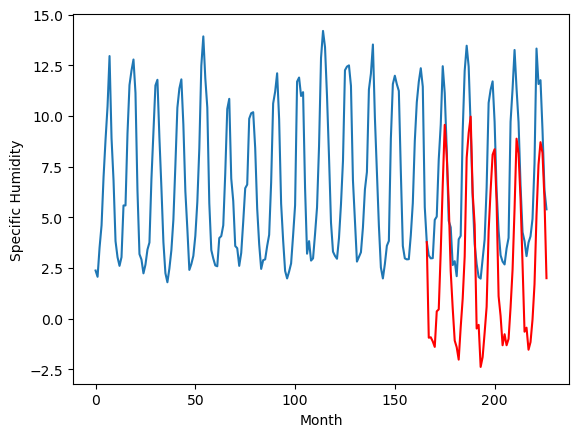

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		1.34		0.72
0.61		1.36		0.75
0.46		1.16		0.70
0.53		0.89		0.36
1.48		2.65		1.17
1.77		2.75		0.98
4.34		5.61		1.27
7.98		8.89		0.91
11.62		11.86		0.24
11.53		10.35		-1.18
8.05		8.01		-0.04
5.13		4.63		-0.50
2.75		2.81		0.06
0.59		1.21		0.62
-0.14		0.88		1.02
-0.10		0.28		0.38
1.14		1.87		0.73
2.51		3.28		0.77
4.04		5.36		1.32
9.36		10.24		0.88
11.22		11.46		0.24
11.56		12.27		0.71
8.37		8.51		0.14
6.51		6.93		0.42
1.32		1.80		0.48
1.20		1.99		0.79
-0.41		-0.09		0.32
0.33		0.39		0.06
1.35		1.60		0.25
2.01		2.87		0.86
6.14		6.61		0.47
7.73		8.62		0.89
11.36		10.38		-0.98
10.93		10.65		-0.28
7.68		8.04		0.36
4.24		3.39		-0.85
2.74		2.42		-0.32
0.61		0.97		0.36
1.47		1.51		0.04
0.67		0.96		0.29
0.70		1.27		0.57
3.31		2.83		-0.48
3.61		4.68		1.07
6.90		7.69		0.79
11.61		11.15		-0.46
9.32		10.43		1.11
8.06		8.16		0.10
5.01		4.96		-0.05
1.35		1.62		0.27
1.59		1.83		0.24
0.54		0.74		0.20
0.41		1

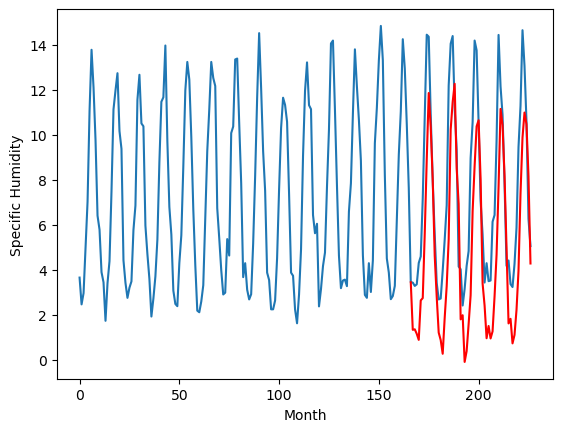

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[1.3348954296112057, 0.8448925685882571, -0.4053756523132326, -1.104159002304077, 2.956037216186523, 1.4490541648864745, 2.296288032531738, 3.186639461517334, 2.860505657196045, -0.9453863906860351, 1.3387244319915768]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44   1.334895
1                 1   -1.00   0.844893
2                 2   -1.90  -0.405376
3                 3   -1.51  -1.104159
4                 4    2.21   2.956037
5                 5    3.35   1.449054
6                 6    0.70   2.296288
7                 7    3.11   3.186639
8                 8    4.03   2.860506
9                 9    0.80  -0.945386
10               10    0.62   1.338724


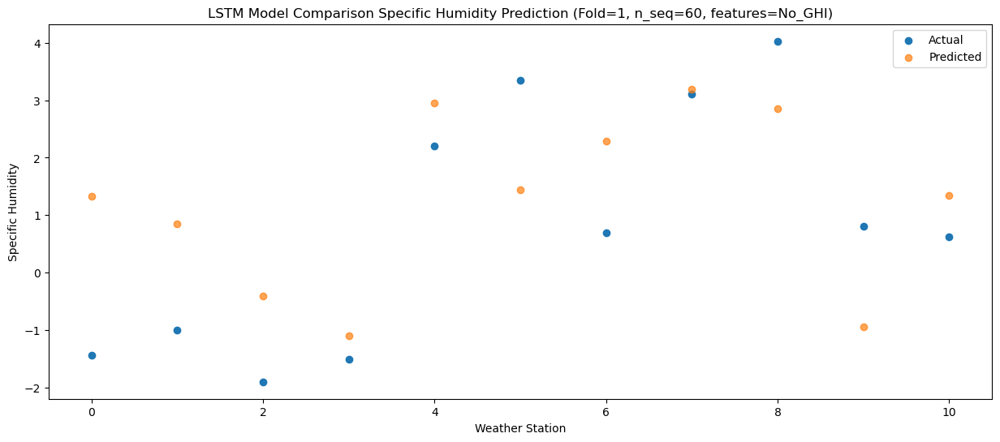

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84   1.361578
1                 1   -0.95   0.871798
2                 2   -0.99  -0.378675
3                 3   -2.71  -1.080128
4                 4    0.97   2.979742
5                 5    1.87   1.470499
6                 6    0.73   2.321362
7                 7    2.78   3.211131
8                 8    3.19   2.883847
9                 9    0.15  -0.923588
10               10    0.61   1.362941


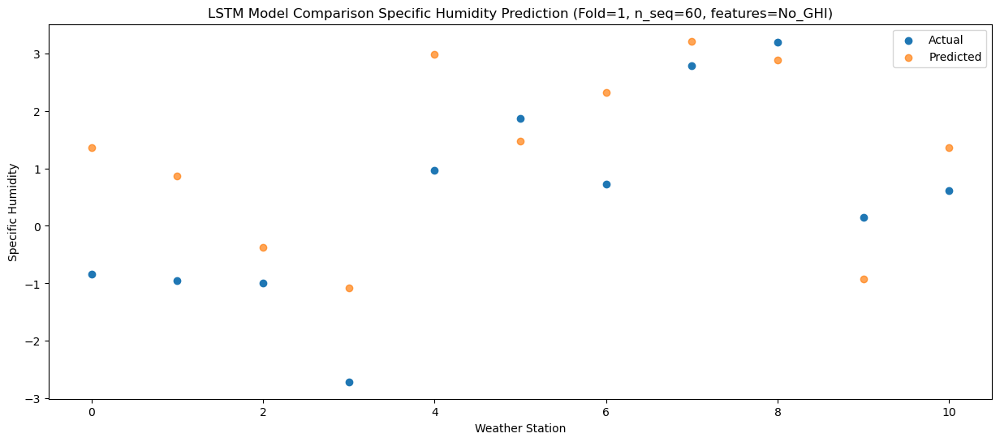

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00   1.158397
1                 1 -1.200000e+00   0.668077
2                 2 -1.500000e+00  -0.580583
3                 3 -1.810000e+00  -1.281347
4                 4  1.880000e+00   2.777744
5                 5  1.590000e+00   1.269124
6                 6  3.100000e-01   2.118514
7                 7  2.700000e+00   3.007327
8                 8  3.640000e+00   2.680969
9                 9 -2.775558e-16  -1.126854
10               10  4.600000e-01   1.160286


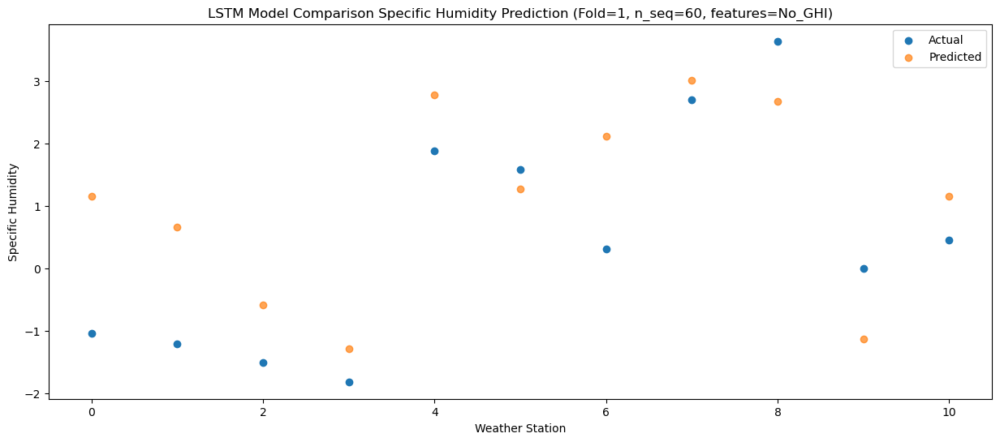

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12   0.896794
1                 1   -0.68   0.404656
2                 2   -1.11  -0.844655
3                 3   -2.51  -1.546348
4                 4    1.20   2.513308
5                 5    1.77   1.001632
6                 6    0.79   1.853746
7                 7    2.58   2.739572
8                 8    3.02   2.411044
9                 9    0.01  -1.398178
10               10    0.53   0.892887


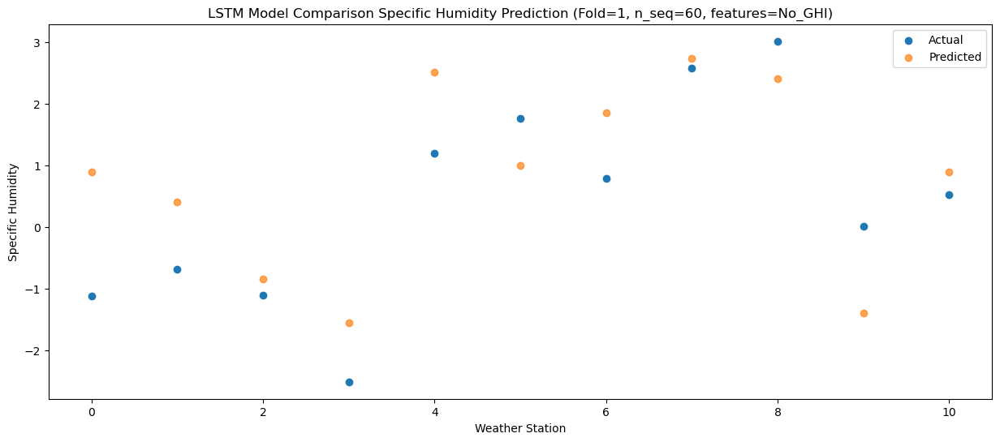

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.18   2.653322
1                 1    1.55   2.162833
2                 2    2.05   0.913777
3                 3    1.85   0.213064
4                 4    5.93   4.271728
5                 5    4.44   2.757530
6                 6    2.76   3.609637
7                 7    5.24   4.494316
8                 8    6.04   4.166174
9                 9    1.90   0.355734
10               10    1.48   2.646692


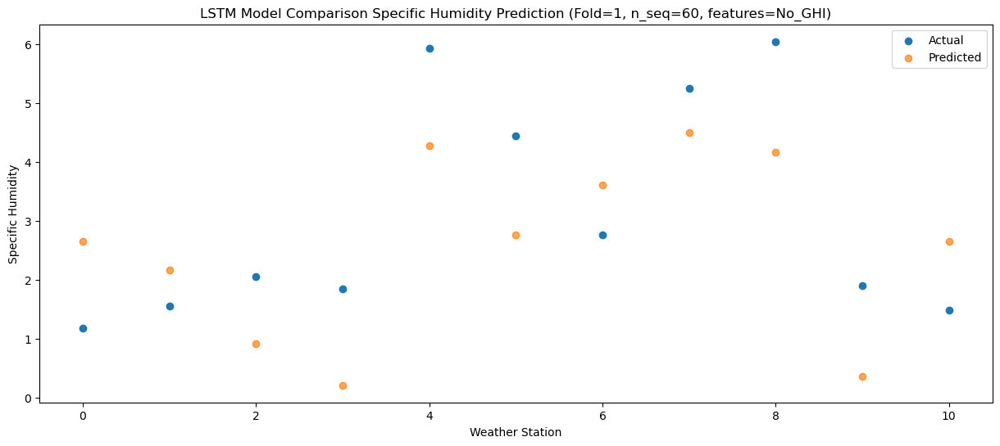

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.92   2.760227
1                 1   -0.04   2.269956
2                 2    0.43   1.019063
3                 3    1.51   0.317135
4                 4    5.62   4.374323
5                 5    3.43   2.857923
6                 6    2.11   3.711812
7                 7    5.50   4.595677
8                 8    6.23   4.267059
9                 9    2.06   0.454156
10               10    1.77   2.748567


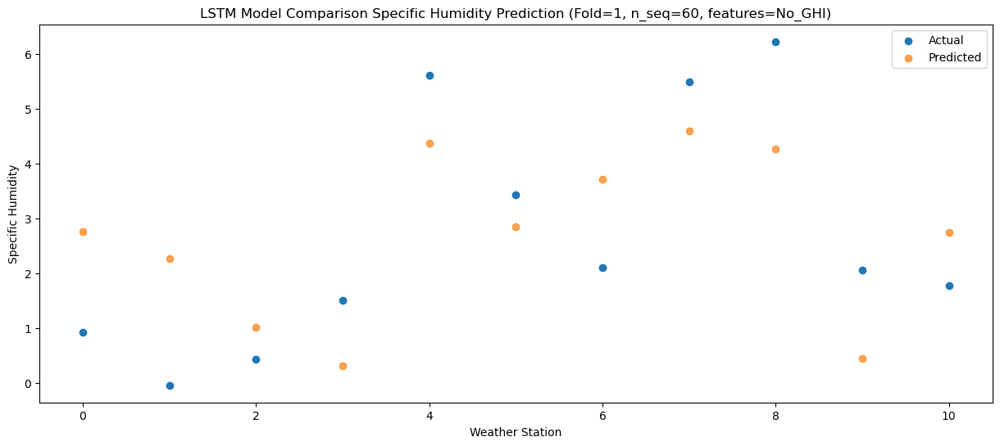

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    3.82   5.621866
1                 1    2.97   5.132258
2                 2    3.20   3.881758
3                 3    3.49   3.176089
4                 4    7.74   7.231338
5                 5    6.11   5.714292
6                 6    5.31   6.570083
7                 7    8.40   7.451594
8                 8    9.56   7.122765
9                 9    4.88   3.309693
10               10    4.34   5.606725


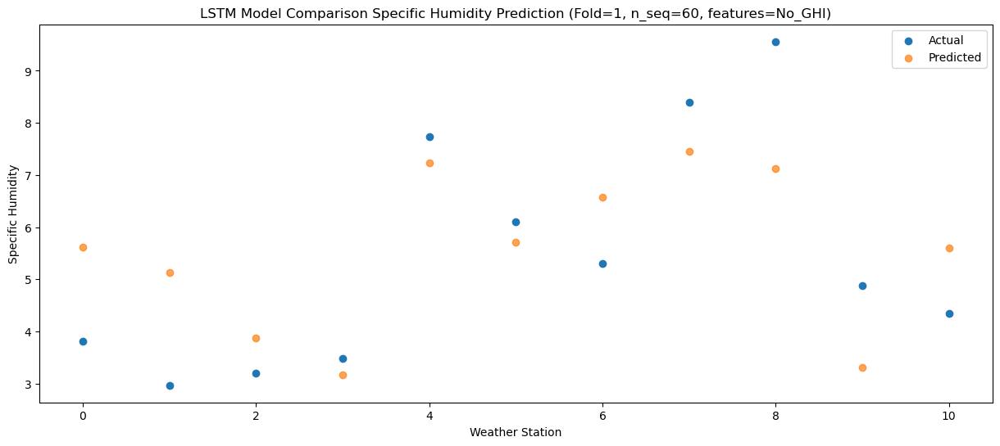

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.06   8.907847
1                 1    6.77   8.417467
2                 2    7.05   7.168480
3                 3    5.61   6.461630
4                 4   10.03  10.517490
5                 5    7.93   8.998736
6                 6    8.95   9.855211
7                 7   12.23  10.737208
8                 8   11.70  10.404771
9                 9    6.59   6.590173
10               10    7.98   8.890453


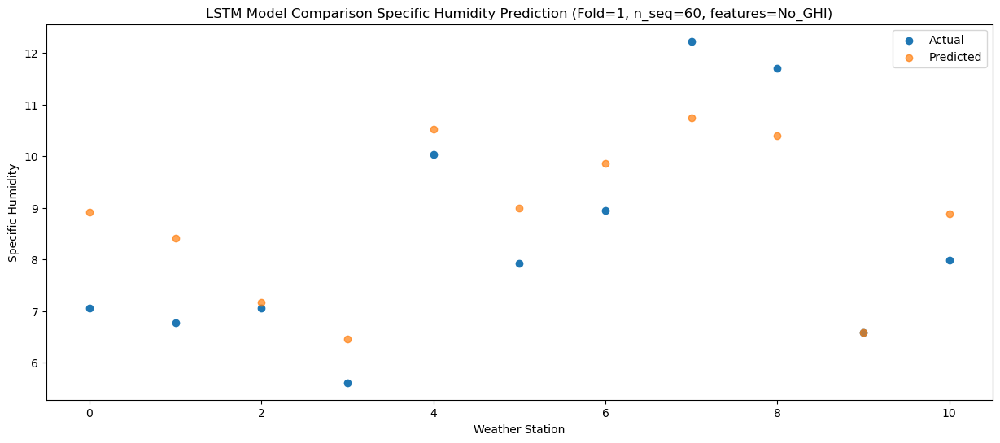

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    9.63  11.882374
1                 1    8.81  11.388744
2                 2    9.60  10.140240
3                 3    8.12   9.430701
4                 4   12.63  13.485960
5                 5    8.92  11.964852
6                 6   11.39  12.821297
7                 7   15.31  13.704592
8                 8   15.06  13.373972
9                 9    9.48   9.556380
10               10   11.62  11.859167


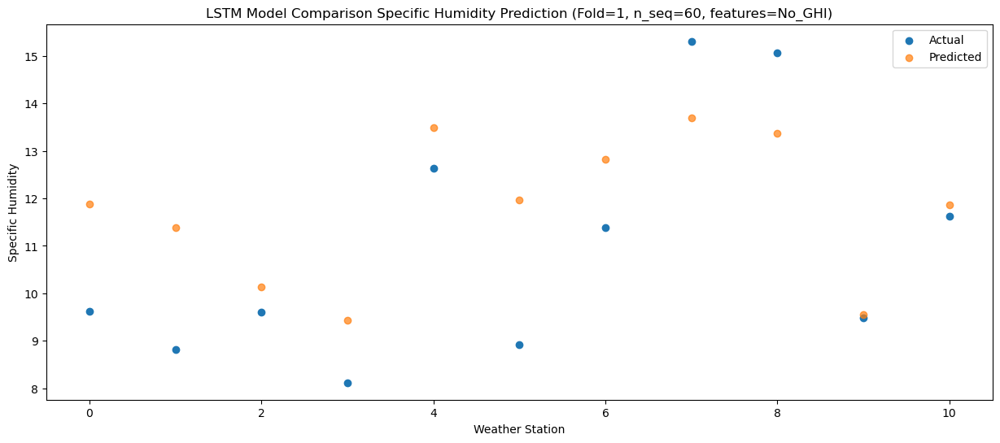

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.92  10.368011
1                 1    8.86   9.873779
2                 2    9.12   8.625510
3                 3    7.01   7.913810
4                 4   11.18  11.969291
5                 5    7.69  10.451894
6                 6   11.41  11.308030
7                 7   13.14  12.187564
8                 8   12.16  11.857812
9                 9    8.16   8.041935
10               10   11.53  10.345324


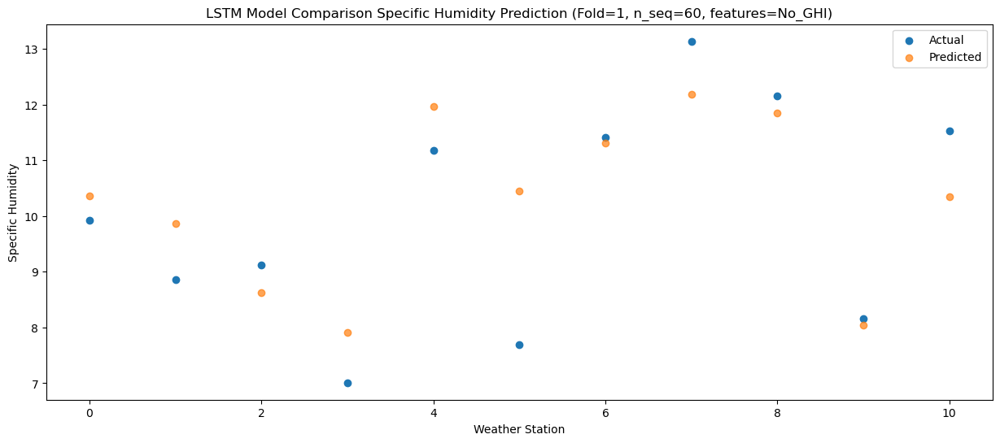

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.30   8.037362
1                 1    5.96   7.541031
2                 2    6.17   6.293658
3                 3    5.43   5.581435
4                 4    9.69   9.638676
5                 5    7.26   8.123251
6                 6    8.10   8.976360
7                 7   11.34   9.851609
8                 8   10.68   9.522652
9                 9    5.37   5.708352
10               10    8.05   8.009738


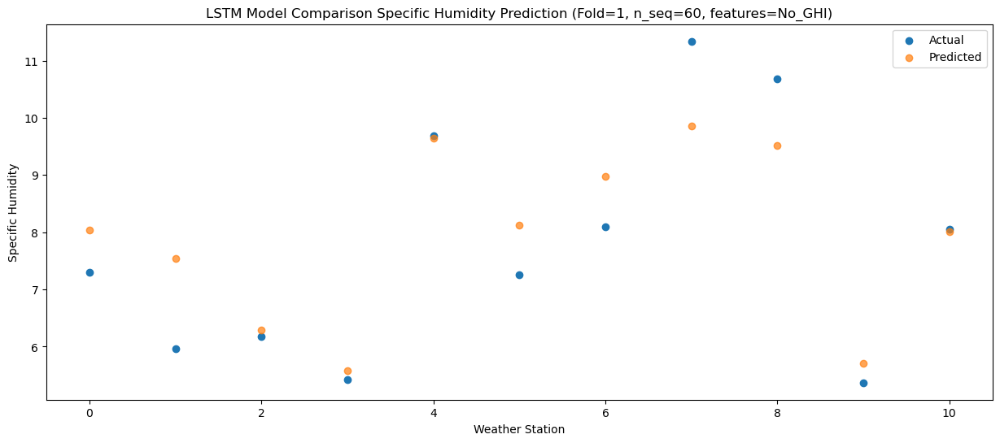

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.62   4.664113
1                 1    3.29   4.169050
2                 2    3.41   2.920881
3                 3    2.03   2.206646
4                 4    5.84   6.262459
5                 5    3.75   4.749447
6                 6    5.61   5.604508
7                 7    6.52   6.477311
8                 8    6.01   6.144970
9                 9    1.85   2.330757
10               10    5.13   4.634056


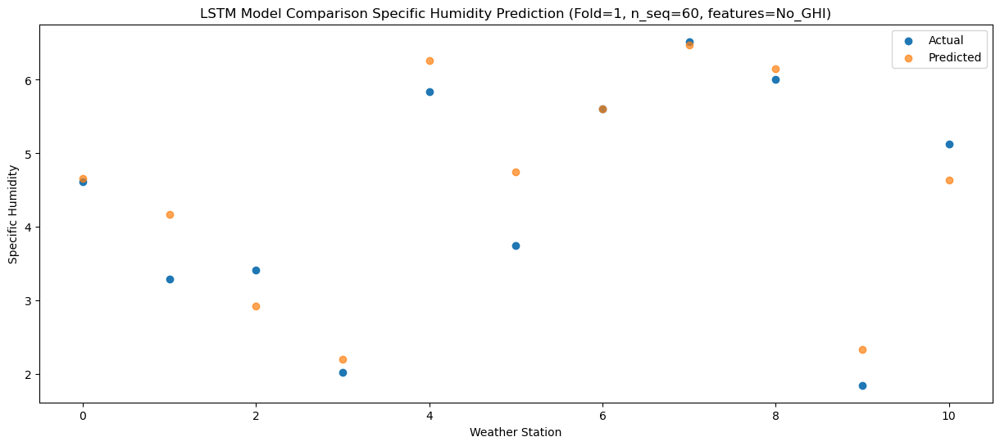

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.99   2.841248
1                 1    0.23   2.344196
2                 2    0.23   1.093753
3                 3   -0.07   0.382454
4                 4    3.36   4.439473
5                 5    3.19   2.928393
6                 6    2.50   3.777785
7                 7    4.50   4.648808
8                 8    4.90   4.320076
9                 9    1.53   0.507604
10               10    2.75   2.807775


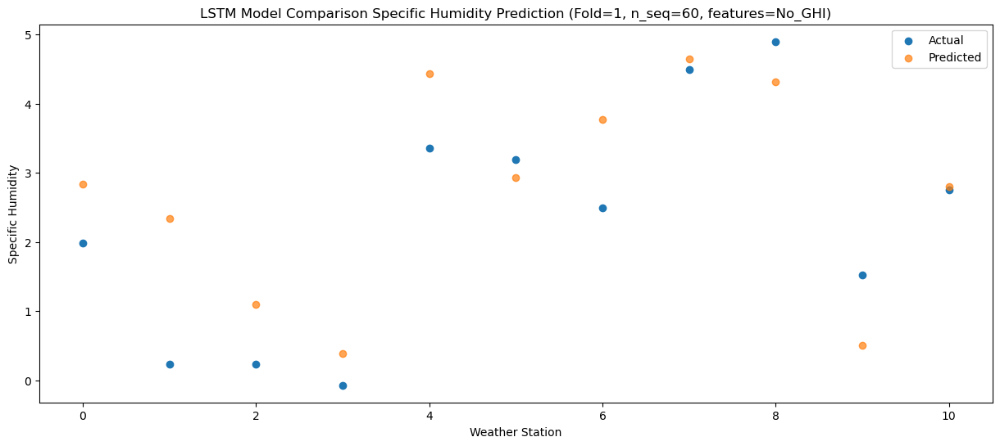

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.22   1.246596
1                 1   -2.36   0.749232
2                 2   -2.54  -0.500794
3                 3   -2.62  -1.210006
4                 4    0.54   2.848531
5                 5    0.75   1.336152
6                 6   -0.22   2.185704
7                 7    2.18   3.056685
8                 8    2.62   2.727218
9                 9   -0.33  -1.085591
10               10    0.59   1.214432


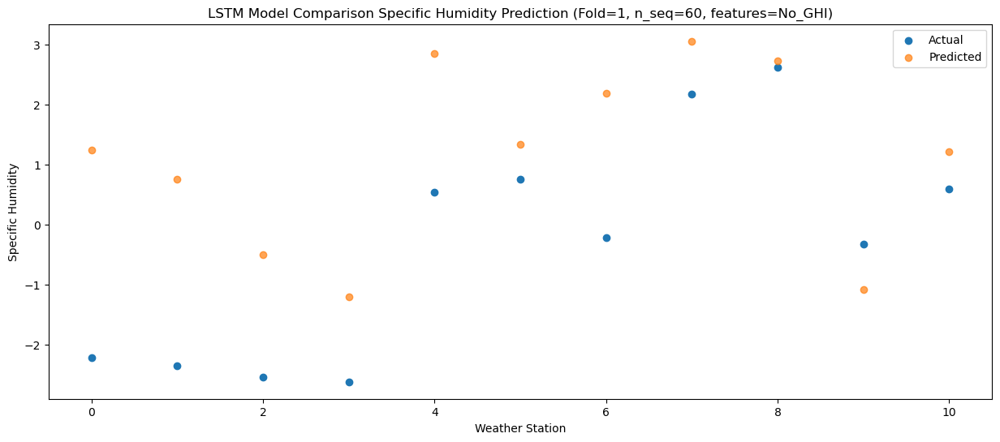

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.00   0.914699
1                 1   -2.34   0.419607
2                 2   -2.39  -0.830176
3                 3   -2.96  -1.541249
4                 4    0.29   2.514821
5                 5    1.58   1.002507
6                 6   -0.33   1.854873
7                 7    2.05   2.726837
8                 8    2.78   2.398245
9                 9   -0.14  -1.415158
10               10   -0.14   0.883780


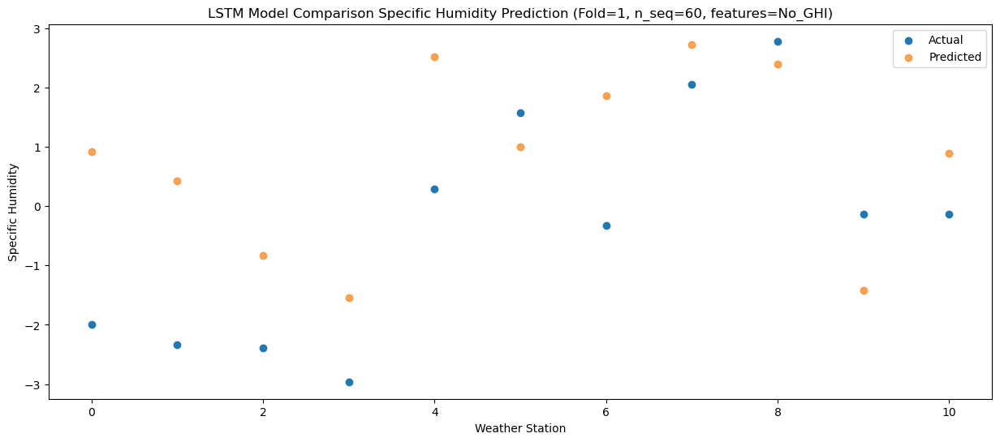

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.68   0.309166
1                 1   -2.15  -0.186416
2                 2   -2.39  -1.437449
3                 3   -2.89  -2.150801
4                 4    0.33   1.904071
5                 5    0.95   0.393174
6                 6   -0.21   1.248096
7                 7    1.53   2.117027
8                 8    1.97   1.789620
9                 9   -0.88  -2.025357
10               10   -0.10   0.275946


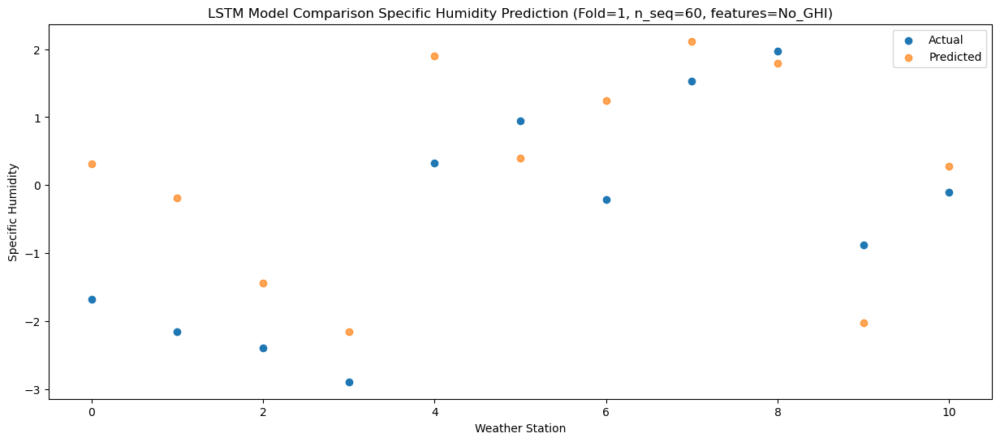

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.15   1.903687
1                 1   -0.62   1.409964
2                 2    0.23   0.158766
3                 3   -0.25  -0.556813
4                 4    3.05   3.495795
5                 5    1.74   1.983982
6                 6    1.35   2.842025
7                 7    4.26   3.710356
8                 8    4.58   3.385498
9                 9    0.94  -0.427517
10               10    1.14   1.870342


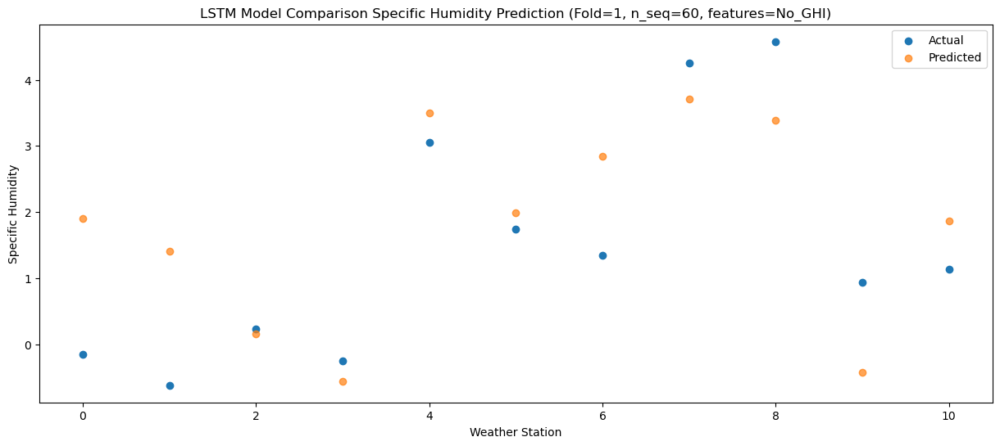

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.05   3.316998
1                 1   -0.26   2.822039
2                 2   -0.06   1.568042
3                 3    1.09   0.850192
4                 4    4.31   4.901197
5                 5    3.04   3.389137
6                 6    1.97   4.248384
7                 7    5.49   5.115910
8                 8    5.74   4.790278
9                 9    1.11   0.977411
10               10    2.51   3.278474


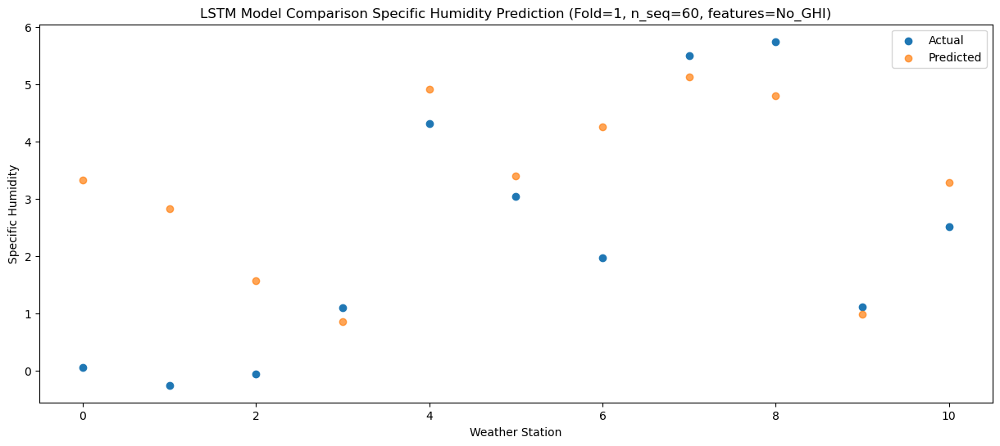

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    2.73   5.397134
1                 1    2.66   4.903593
2                 2    2.78   3.651189
3                 3    4.98   2.932599
4                 4    8.34   6.983956
5                 5    7.35   5.473594
6                 6    4.90   6.334452
7                 7    8.70   7.200192
8                 8    9.96   6.872847
9                 9    6.26   3.060217
10               10    4.04   5.362514


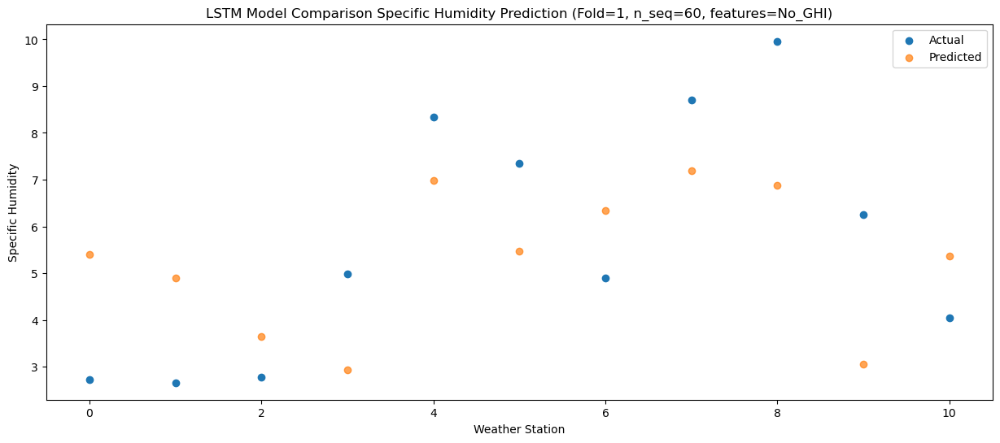

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.89  10.279436
1                 1    6.64   9.784605
2                 2    7.30   8.528507
3                 3    8.17   7.807993
4                 4   11.75  11.858689
5                 5    9.52  10.346464
6                 6    9.25  11.209091
7                 7   13.46  12.073990
8                 8   13.10  11.743401
9                 9    9.25   7.931370
10               10    9.36  10.238926


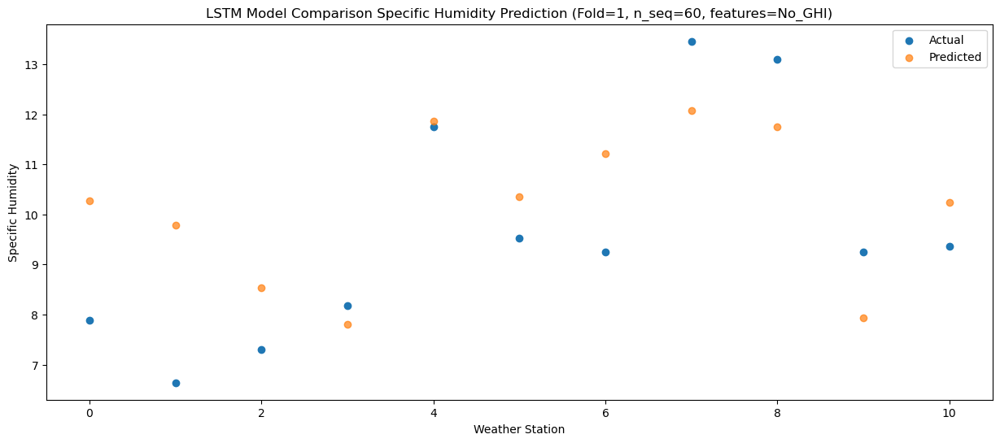

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.04  11.500515
1                 1    8.51  11.006811
2                 2    8.89   9.752264
3                 3    8.65   9.032373
4                 4   11.93  13.082266
5                 5   10.85  11.567302
6                 6   11.75  12.431354
7                 7   14.09  13.296971
8                 8   14.15  12.963446
9                 9   10.49   9.153469
10               10   11.22  11.461122


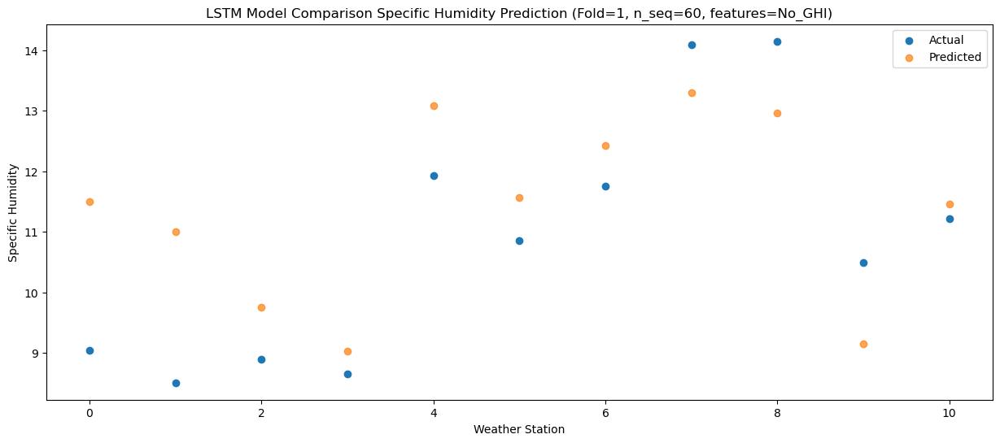

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.80  12.312663
1                 1    8.72  11.819124
2                 2    9.11  10.564187
3                 3    8.99   9.842798
4                 4   11.97  13.891536
5                 5   11.07  12.378621
6                 6   12.04  13.242841
7                 7   13.94  14.106782
8                 8   13.73  13.771748
9                 9    9.46   9.961772
10               10   11.56  12.270219


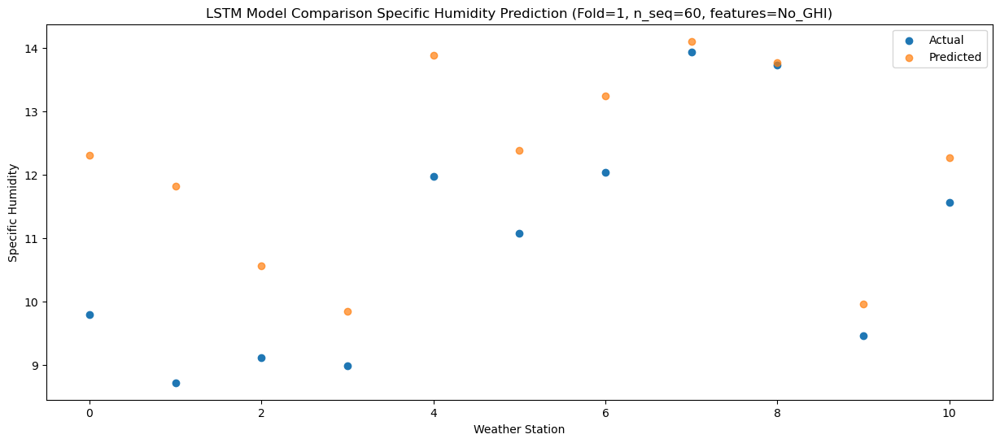

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    6.32   8.557499
1                 1    5.77   8.064266
2                 2    6.35   6.809809
3                 3    5.90   6.090102
4                 4    8.87  10.141718
5                 5    7.53   8.631798
6                 6    8.69   9.492889
7                 7   10.69  10.352431
8                 8   10.16  10.015269
9                 9    6.50   6.207450
10               10    8.37   8.513349


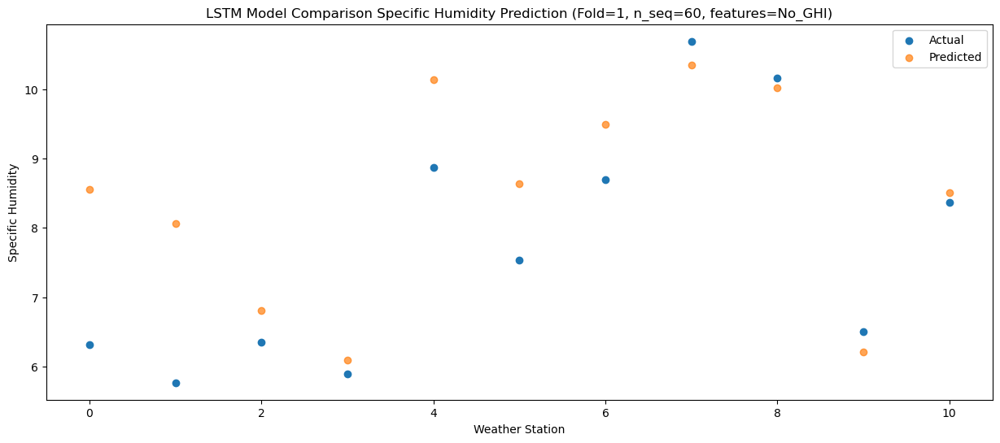

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.74   6.977183
1                 1    3.73   6.482897
2                 2    3.60   5.227495
3                 3    3.65   4.508105
4                 4    6.92   8.560076
5                 5    4.42   7.051373
6                 6    6.56   7.911163
7                 7    7.96   8.767942
8                 8    7.72   8.431310
9                 9    3.06   4.626418
10               10    6.51   6.928689


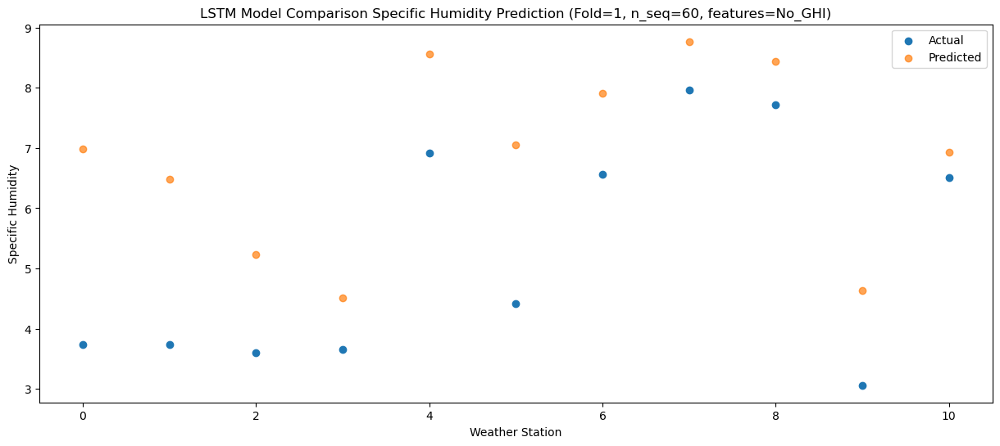

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.92   1.847208
1                 1   -1.86   1.352039
2                 2   -1.90   0.096271
3                 3   -0.80  -0.621962
4                 4    2.33   3.430710
5                 5    2.58   1.926410
6                 6    0.63   2.780941
7                 7    3.40   3.640316
8                 8    4.19   3.308838
9                 9    0.70  -0.492502
10               10    1.32   1.803823


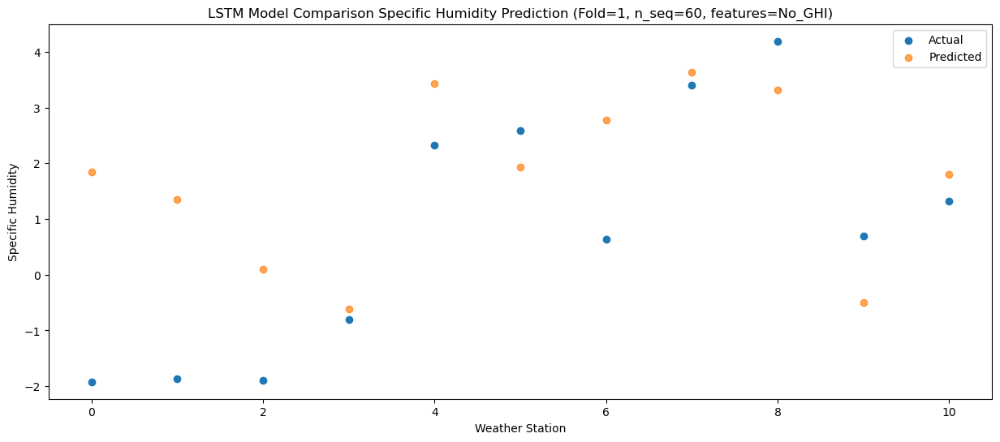

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.19   2.033879
1                 1    0.31   1.540278
2                 2    0.74   0.285812
3                 3    2.12  -0.433042
4                 4    5.26   3.620609
5                 5    1.53   2.112414
6                 6    2.50   2.971004
7                 7    5.04   3.828838
8                 8    3.58   3.493741
9                 9   -0.28  -0.310200
10               10    1.20   1.988810


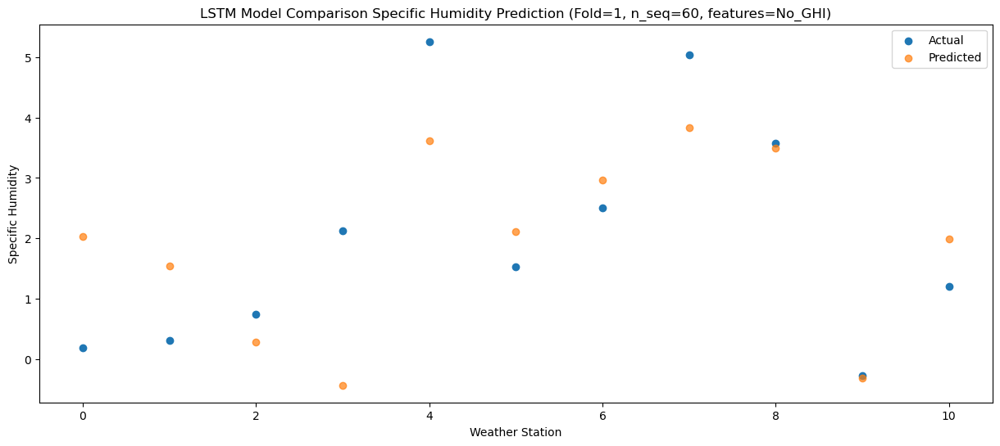

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.06  -0.042991
1                 1   -2.69  -0.538223
2                 2   -3.14  -1.792501
3                 3   -3.53  -2.509319
4                 4   -0.28   1.545085
5                 5    0.26   0.036424
6                 6   -0.50   0.892674
7                 7    1.29   1.751541
8                 8    1.60   1.417704
9                 9   -0.92  -2.385652
10               10   -0.41  -0.086523


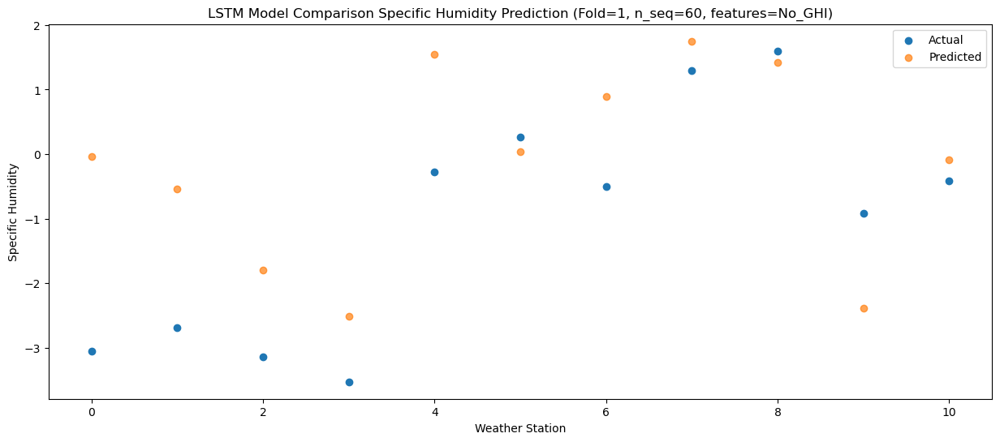

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.12   0.435171
1                 1   -1.74  -0.061620
2                 2   -2.11  -1.316967
3                 3   -3.36  -2.031133
4                 4   -0.08   2.024055
5                 5    0.14   0.518883
6                 6    0.63   1.370229
7                 7    1.97   2.229937
8                 8    2.13   1.898362
9                 9   -1.00  -1.901628
10               10    0.33   0.394957


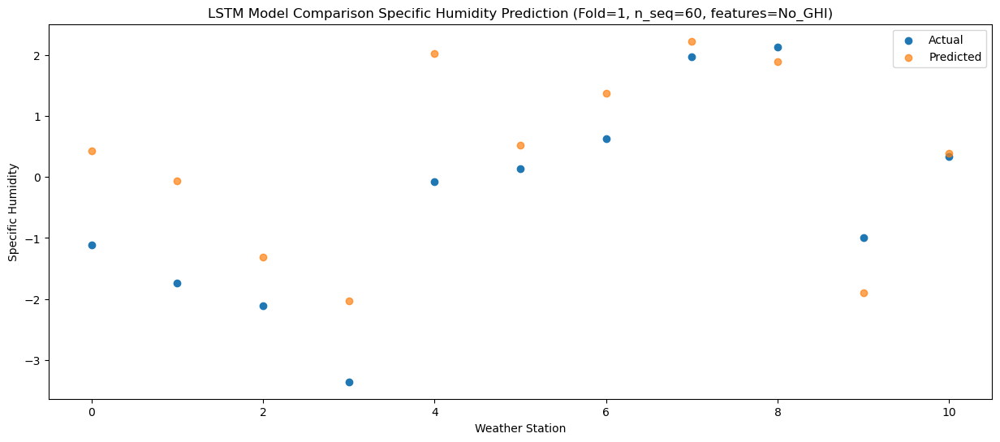

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.01   1.642077
1                 1   -1.06   1.143952
2                 2   -1.32  -0.112852
3                 3   -1.68  -0.827438
4                 4    1.62   3.228115
5                 5    0.69   1.723844
6                 6    1.38   2.574505
7                 7    3.50   3.433969
8                 8    3.22   3.102491
9                 9   -0.04  -0.697878
10               10    1.35   1.600011


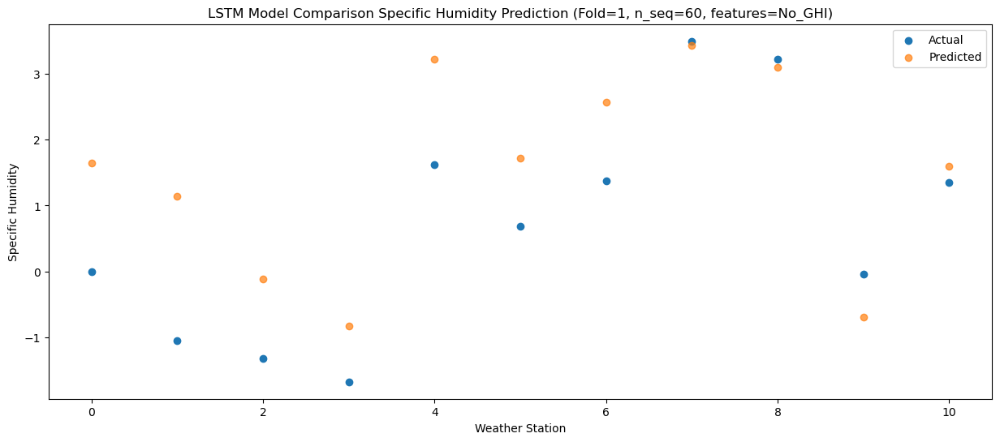

Predictions for (t+29):
    Weather_Station        Actual  Predicted
0                 0  1.010000e+00   2.914334
1                 1  1.332268e-15   2.416016
2                 2  4.400000e-01   1.161795
3                 3  2.480000e+00   0.449373
4                 4  5.720000e+00   4.506672
5                 5  2.960000e+00   3.002513
6                 6  2.570000e+00   3.851063
7                 7  5.690000e+00   4.711401
8                 8  6.340000e+00   4.378522
9                 9  9.300000e-01   0.580617
10               10  2.010000e+00   2.874969


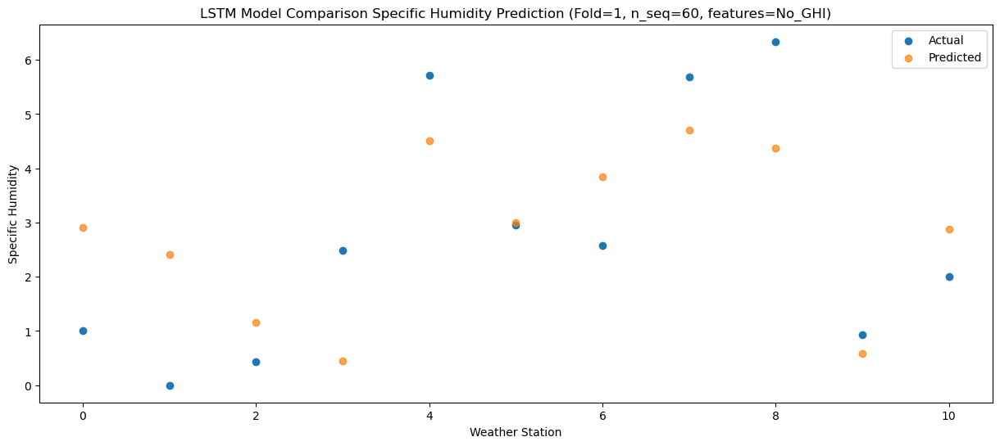

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    4.99   6.649405
1                 1    4.17   6.149501
2                 2    4.80   4.896631
3                 3    6.29   4.181801
4                 4    9.60   8.238179
5                 5    4.73   6.734027
6                 6    6.83   7.582258
7                 7   10.14   8.443996
8                 8   10.58   8.113230
9                 9    3.49   4.315636
10               10    6.14   6.608774


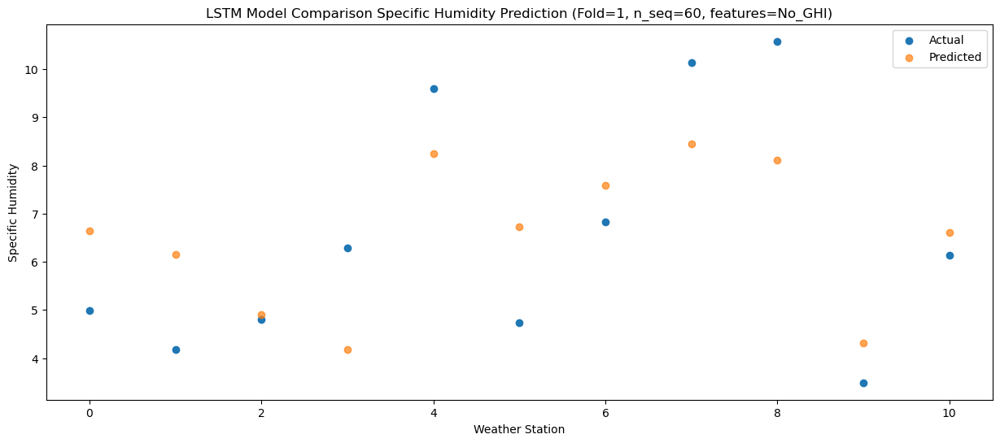

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    7.29   8.662055
1                 1    6.57   8.162363
2                 2    7.89   6.907253
3                 3    7.34   6.194156
4                 4   10.72  10.252013
5                 5    7.33   8.748454
6                 6    9.55   9.596713
7                 7   12.90  10.456606
8                 8   12.48  10.120894
9                 9    7.67   6.325702
10               10    7.73   8.616249


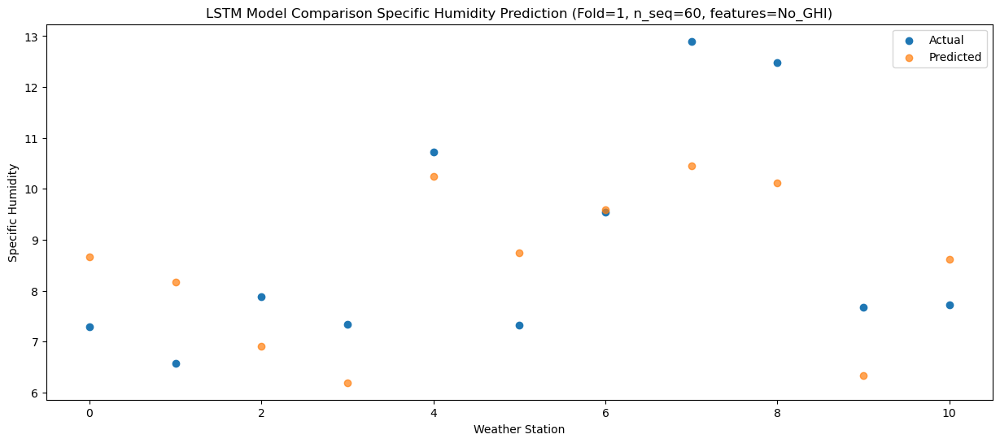

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    9.91  10.427122
1                 1    9.24   9.928292
2                 2    9.52   8.672784
3                 3    8.26   7.958156
4                 4   11.47  12.015309
5                 5    8.28  10.509247
6                 6   12.54  11.360097
7                 7   13.87  12.219921
8                 8   11.84  11.882618
9                 9    8.32   8.083745
10               10   11.36  10.377407


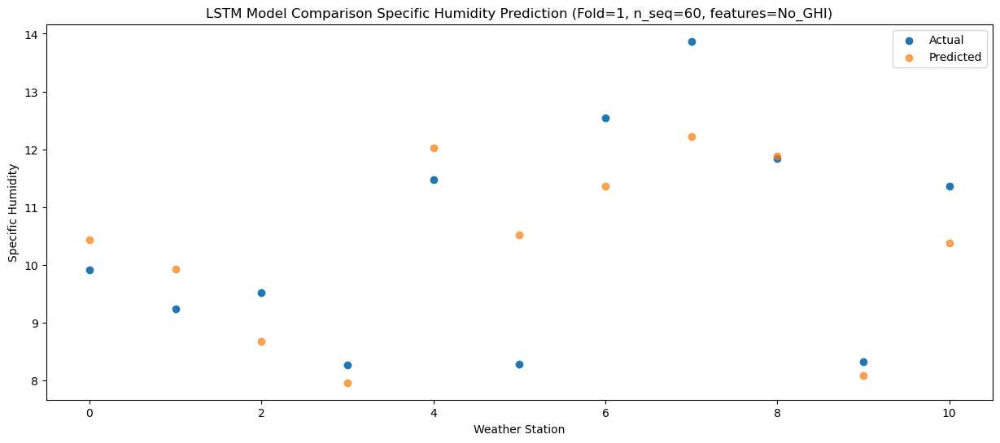

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.91  10.700216
1                 1    8.83  10.203565
2                 2    8.65   8.946836
3                 3    8.51   8.231968
4                 4   11.85  12.289833
5                 5   10.39  10.784349
6                 6   11.45  11.637392
7                 7   13.78  12.494160
8                 8   12.58  12.153895
9                 9    8.73   8.354595
10               10   10.93  10.650628


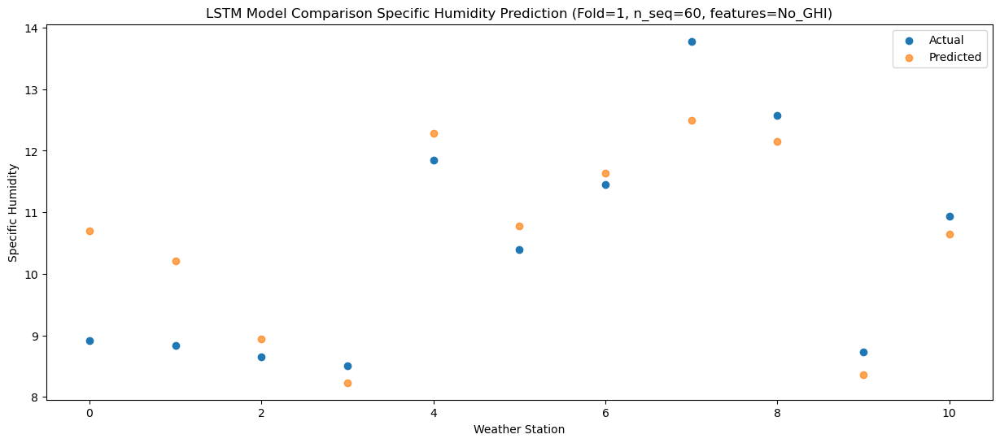

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.29   8.087652
1                 1    5.47   7.589142
2                 2    5.14   6.333785
3                 3    5.22   5.622673
4                 4    8.50   9.681280
5                 5    9.12   8.174450
6                 6    7.97   9.026193
7                 7    9.82   9.885206
8                 8    9.84   9.544952
9                 9    6.73   5.746573
10               10    7.68   8.041284


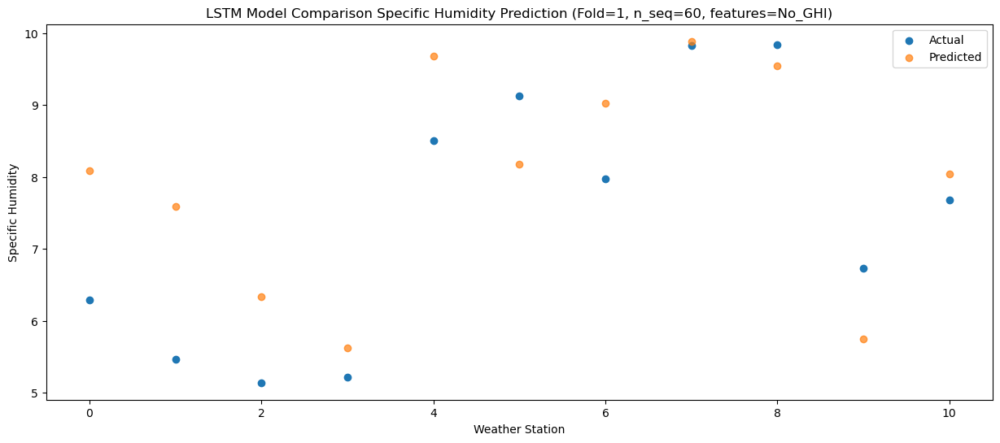

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    1.43   3.441216
1                 1    0.58   2.941446
2                 2    0.03   1.684298
3                 3    0.26   0.973360
4                 4    3.60   5.033006
5                 5    5.93   3.529663
6                 6    2.91   4.379458
7                 7    5.28   5.238018
8                 8    5.89   4.899653
9                 9    3.34   1.104232
10               10    4.24   3.394549


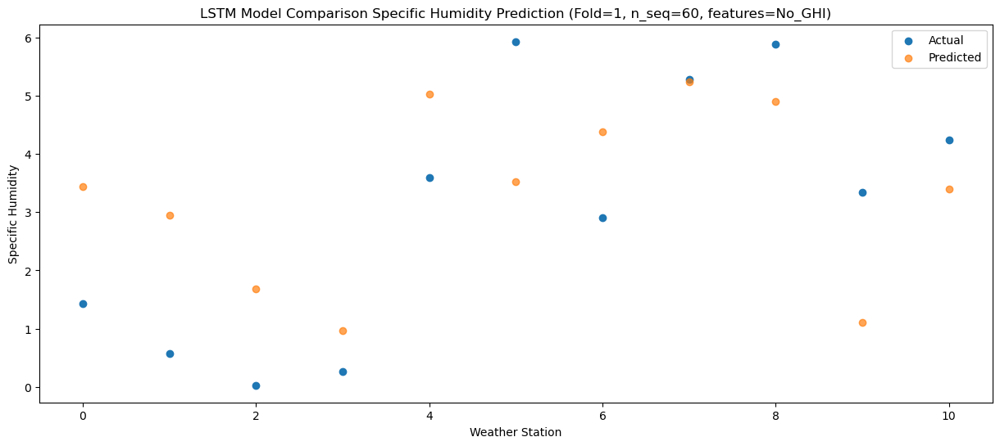

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.90   2.460564
1                 1    0.10   1.959398
2                 2   -0.34   0.702053
3                 3   -0.24  -0.008576
4                 4    3.22   4.051940
5                 5    3.06   2.555171
6                 6    2.42   3.399490
7                 7    4.03   4.255914
8                 8    4.91   3.920625
9                 9    1.36   0.129298
10               10    2.74   2.415110


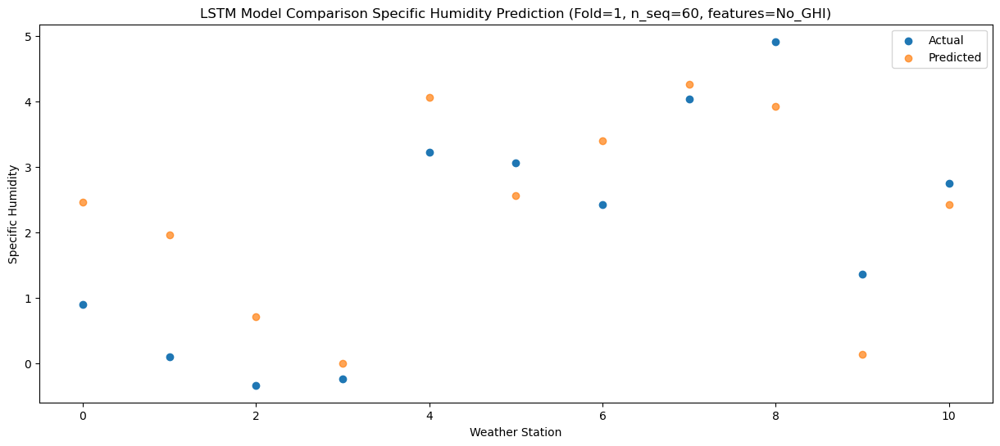

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.82   1.013420
1                 1   -1.49   0.509075
2                 2   -1.03  -0.748172
3                 3   -1.05  -1.455843
4                 4    2.40   2.605813
5                 5    2.39   1.109201
6                 6    0.52   1.948976
7                 7    3.12   2.807237
8                 8    3.17   2.474875
9                 9    0.15  -1.316671
10               10    0.61   0.965918


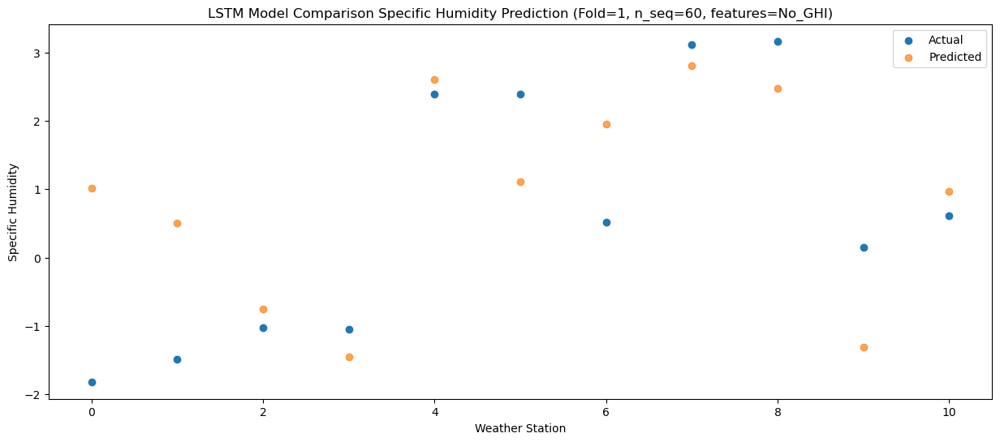

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -1.36   1.562520
1                 1   -1.08   1.057874
2                 2   -1.06  -0.199893
3                 3   -1.47  -0.905946
4                 4    1.92   3.157026
5                 5    0.84   1.661862
6                 6    0.88   2.500790
7                 7    3.24   3.355051
8                 8    2.69   3.019124
9                 9   -0.16  -0.771403
10               10    1.47   1.509415


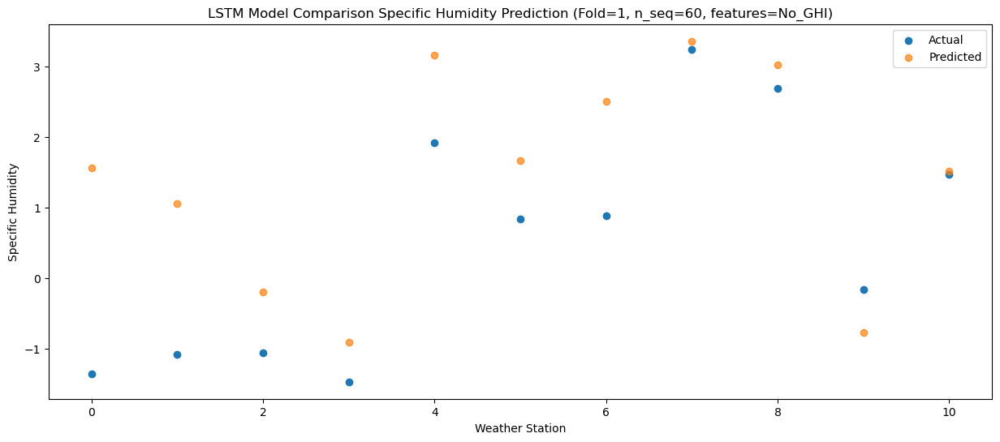

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.25   1.008027
1                 1    0.04   0.502920
2                 2   -0.01  -0.755309
3                 3   -0.69  -1.459471
4                 4    2.52   2.605507
5                 5    0.87   1.112761
6                 6    2.08   1.946854
7                 7    3.34   2.802887
8                 8    3.02   2.470396
9                 9   -0.30  -1.316403
10               10    0.67   0.955709


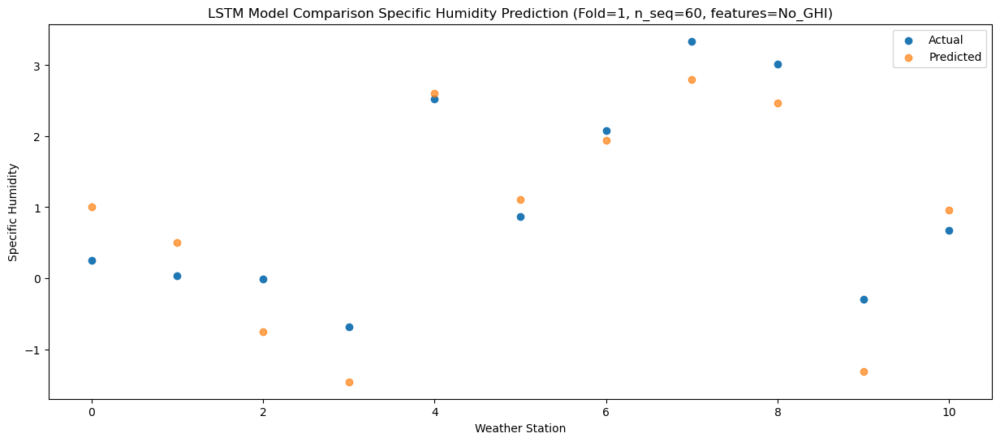

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.13   1.323900
1                 1   -0.83   0.817265
2                 2   -0.48  -0.442188
3                 3    0.86  -1.148147
4                 4    4.22   2.916188
5                 5    1.92   1.421330
6                 6    1.32   2.256091
7                 7    4.10   3.115453
8                 8    4.44   2.785660
9                 9    0.49  -1.001787
10               10    0.70   1.271389


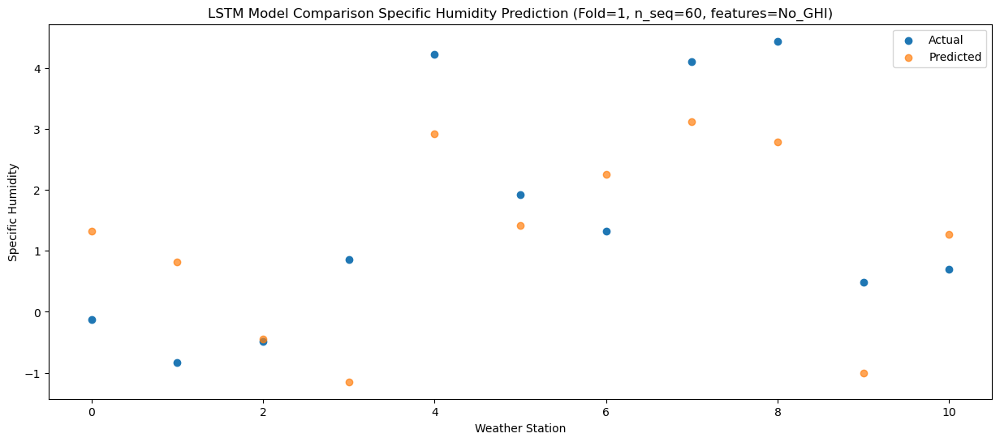

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.57   2.894151
1                 1    0.77   2.386301
2                 2    0.88   1.125554
3                 3    1.23   0.413997
4                 4    4.67   4.476243
5                 5    2.18   2.977301
6                 6    3.13   3.817399
7                 7    5.30   4.675631
8                 8    5.66   4.343612
9                 9    1.01   0.553110
10               10    3.31   2.832019


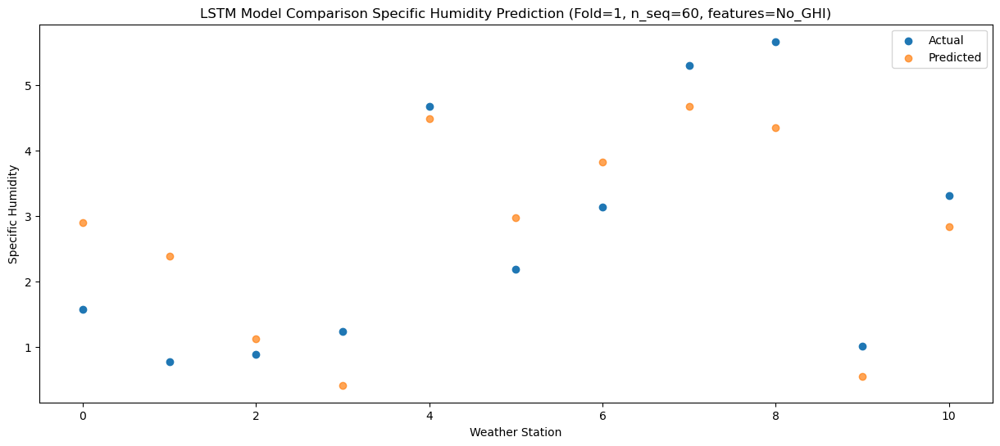

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.77   4.737214
1                 1    3.51   4.226961
2                 2    4.18   2.968321
3                 3    5.01   2.260720
4                 4    8.34   6.324584
5                 5    6.55   4.826566
6                 6    5.69   5.659756
7                 7    9.34   6.522988
8                 8   10.71   6.194335
9                 9    6.74   2.405553
10               10    3.61   4.675372


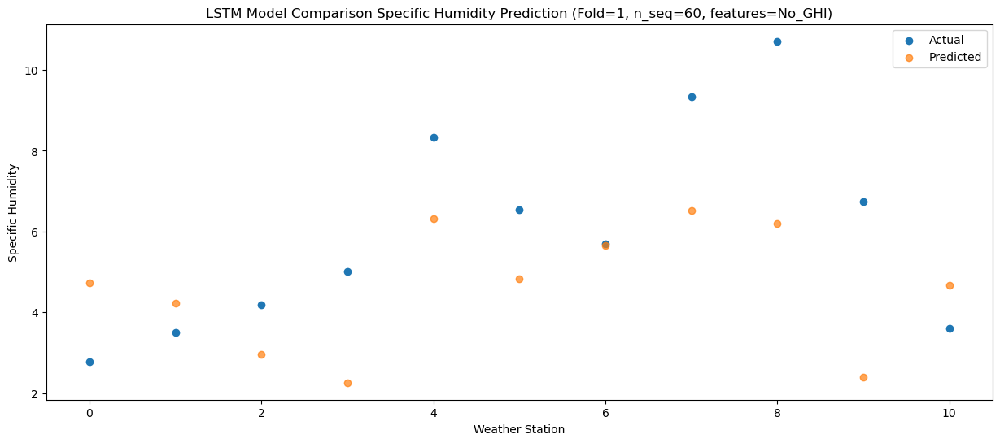

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.12   7.757815
1                 1    5.86   7.247341
2                 2    6.83   5.988722
3                 3    8.41   5.277865
4                 4   11.60   9.340808
5                 5    6.50   7.840109
6                 6    8.27   8.675564
7                 7   12.26   9.539065
8                 8   13.29   9.208030
9                 9    8.35   5.418930
10               10    6.90   7.692145


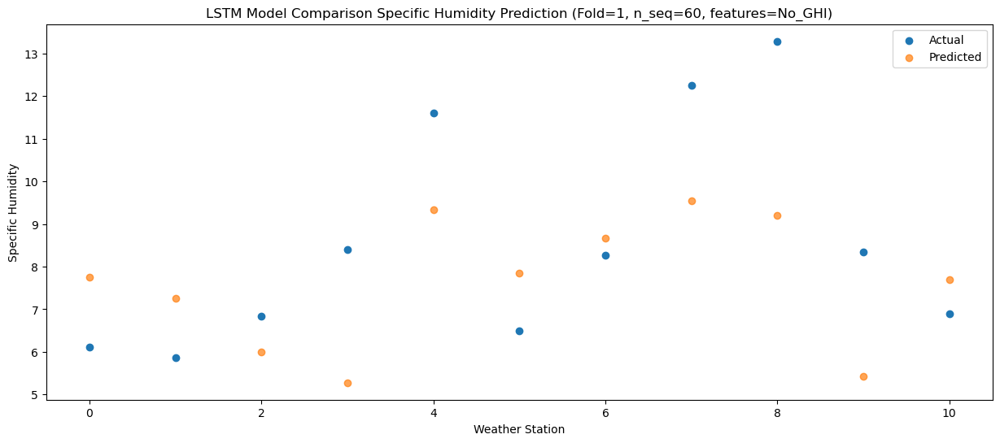

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    9.53  11.224305
1                 1    8.82  10.714264
2                 2    9.97   9.455860
3                 3    8.97   8.741507
4                 4   11.68  12.802292
5                 5    8.67  11.297694
6                 6   11.89  12.137439
7                 7   14.83  12.999735
8                 8   13.52  12.667194
9                 9   10.28   8.875191
10               10   11.61  11.153975


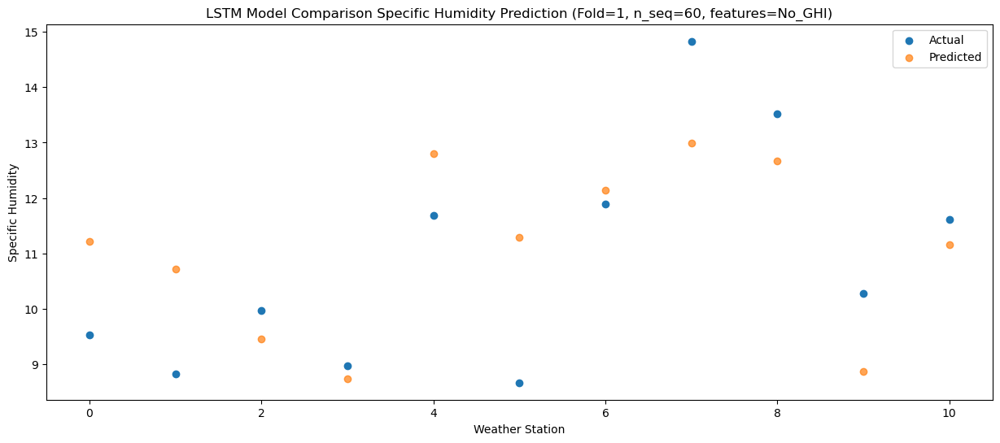

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.36  10.499754
1                 1    8.95   9.990544
2                 2    9.90   8.731334
3                 3    7.30   8.015347
4                 4   10.28  12.075786
5                 5    8.82  10.570717
6                 6   11.78  11.412203
7                 7   14.41  12.275085
8                 8   11.69  11.943975
9                 9    8.37   8.151756
10               10    9.32  10.429887


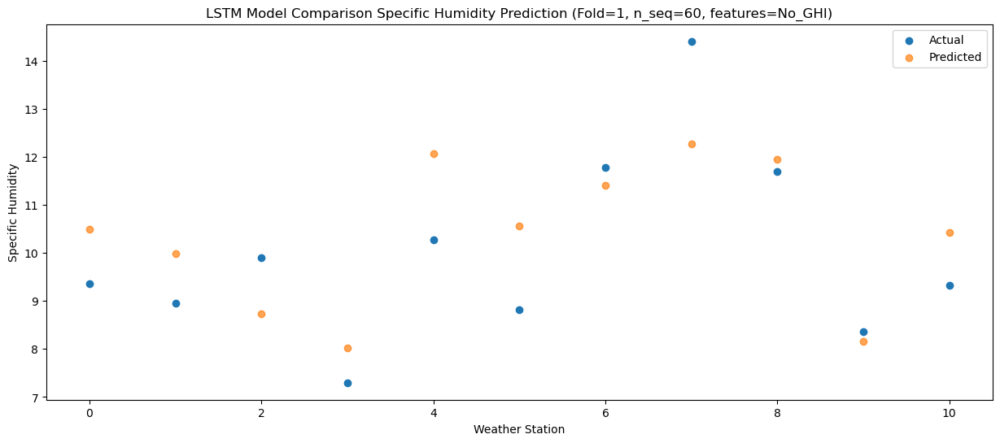

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.50   8.232211
1                 1    5.84   7.723303
2                 2    6.09   6.463940
3                 3    6.10   5.750244
4                 4    9.53   9.810766
5                 5    8.46   8.308593
6                 6    8.81   9.146570
7                 7    9.92  10.008772
8                 8   10.74   9.681252
9                 9    6.72   5.891142
10               10    8.06   8.164861


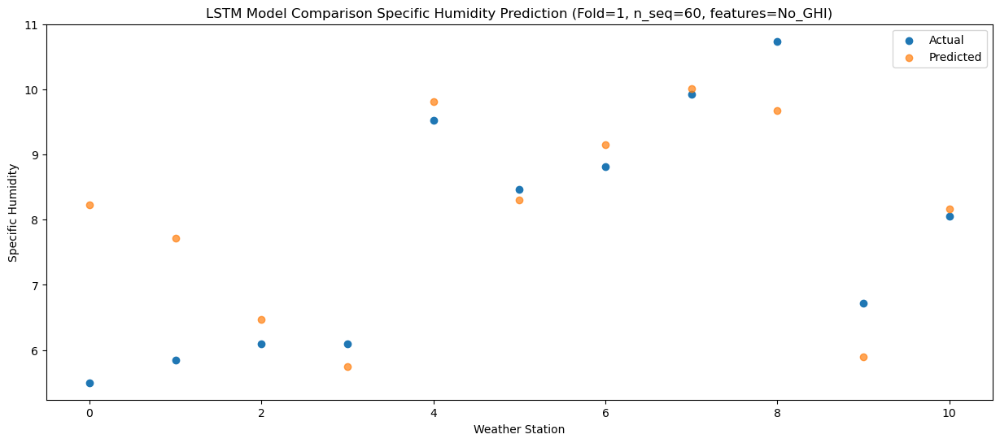

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.10   5.023875
1                 1    1.99   4.512961
2                 2    1.58   3.250406
3                 3    2.68   2.538318
4                 4    6.14   6.599539
5                 5    6.48   5.099105
6                 6    4.56   5.936016
7                 7    6.67   6.796183
8                 8    7.31   6.467940
9                 9    3.61   2.678862
10               10    5.01   4.955641


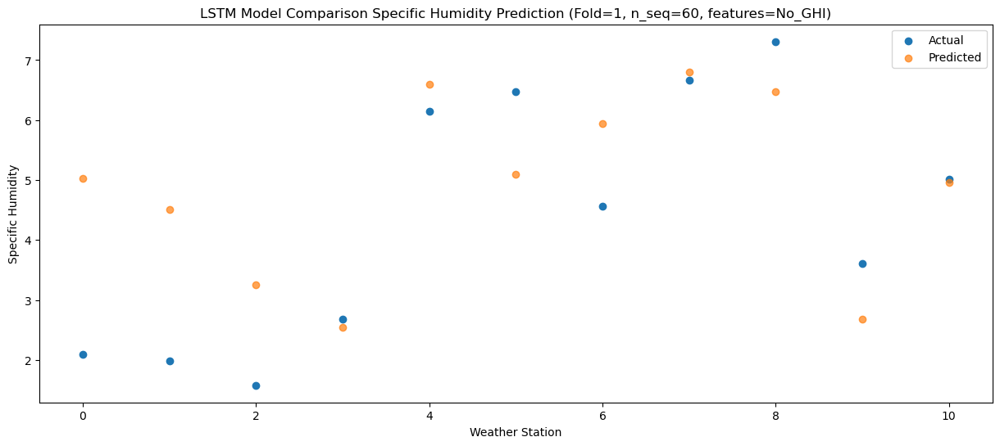

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.96   1.695364
1                 1   -1.02   1.182854
2                 2   -0.97  -0.078306
3                 3   -0.65  -0.788555
4                 4    2.80   3.273711
5                 5    3.85   1.773461
6                 6    1.21   2.606549
7                 7    3.96   3.466070
8                 8    4.64   3.139092
9                 9    1.29  -0.649153
10               10    1.35   1.623649


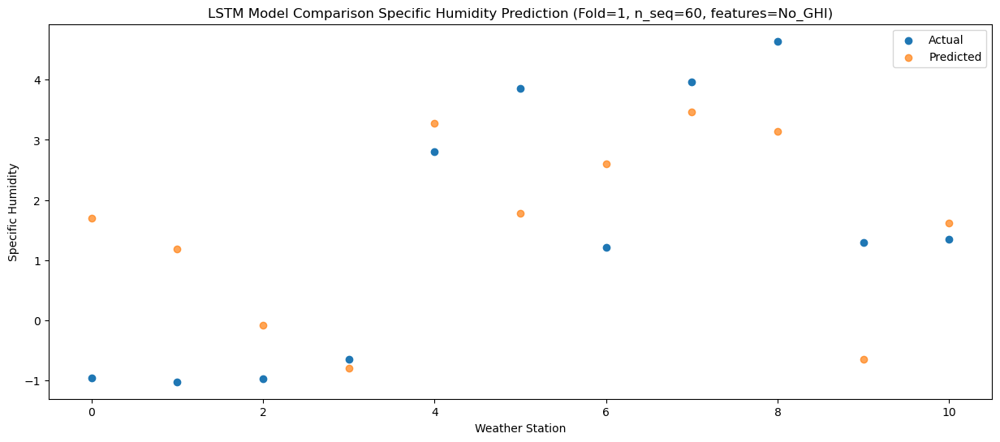

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.71   1.903508
1                 1   -1.60   1.390732
2                 2   -1.99   0.128509
3                 3   -2.29  -0.583866
4                 4    1.08   3.478037
5                 5    1.98   1.974798
6                 6    0.71   2.811918
7                 7    2.57   3.670333
8                 8    3.59   3.340224
9                 9    0.85  -0.449086
10               10    1.59   1.828962


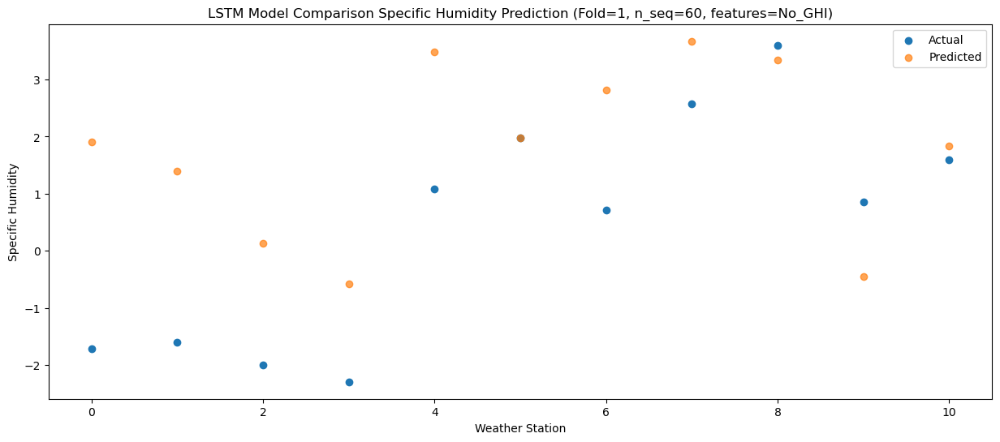

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.10   0.811208
1                 1   -2.37   0.295608
2                 2   -2.62  -0.965450
3                 3   -3.39  -1.675265
4                 4   -0.09   2.387624
5                 5    0.83   0.885916
6                 6   -0.11   1.720011
7                 7    1.50   2.579536
8                 8    2.28   2.252365
9                 9    0.11  -1.537624
10               10    0.54   0.737628


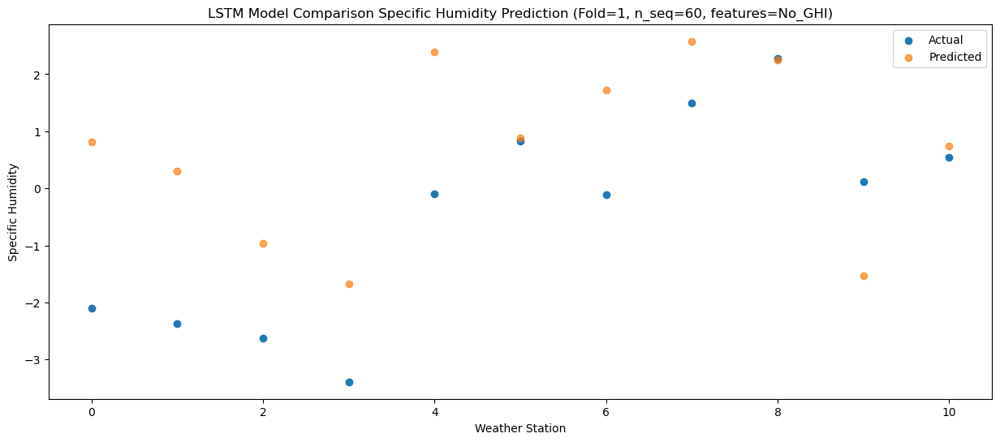

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -2.49   1.193199
1                 1   -2.03   0.678012
2                 2   -1.82  -0.585051
3                 3   -1.14  -1.299977
4                 4    2.16   2.761441
5                 5    1.24   1.260902
6                 6    0.37   2.098302
7                 7    3.25   2.956453
8                 8    4.03   2.629645
9                 9    0.78  -1.159145
10               10    0.41   1.114807


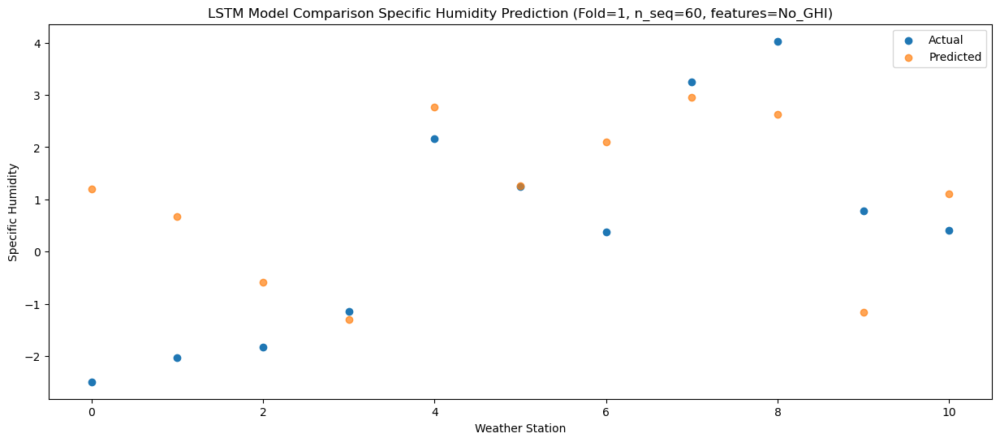

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.08   2.307160
1                 1   -0.52   1.793235
2                 2   -0.28   0.531898
3                 3    0.77  -0.185091
4                 4    4.09   3.876403
5                 5    2.20   2.375365
6                 6    1.71   3.214023
7                 7    4.44   4.069422
8                 8    5.58   3.739717
9                 9    1.09  -0.051837
10               10    1.44   2.227172


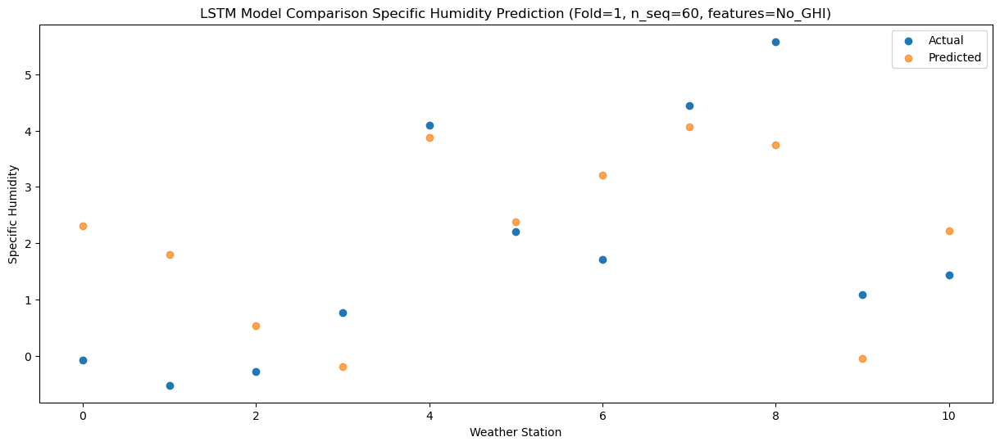

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    0.99   4.055749
1                 1    1.37   3.540779
2                 2    1.71   2.280738
3                 3    3.02   1.560948
4                 4    6.29   5.622181
5                 5    2.84   4.120275
6                 6    3.86   4.959387
7                 7    6.21   5.813638
8                 8    7.90   5.483826
9                 9    1.95   1.692399
10               10    3.05   3.970898


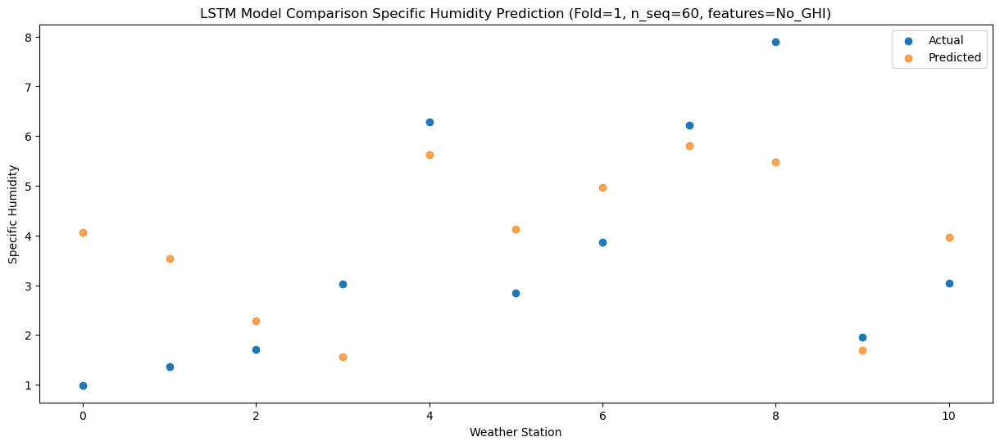

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.19   7.464355
1                 1    5.17   6.947593
2                 2    5.84   5.688284
3                 3    7.37   4.969635
4                 4   10.27   9.031276
5                 5    5.27   7.525427
6                 6    8.00   8.367334
7                 7   10.52   9.220795
8                 8   11.50   8.886394
9                 9    4.68   5.092477
10               10    6.63   7.378574


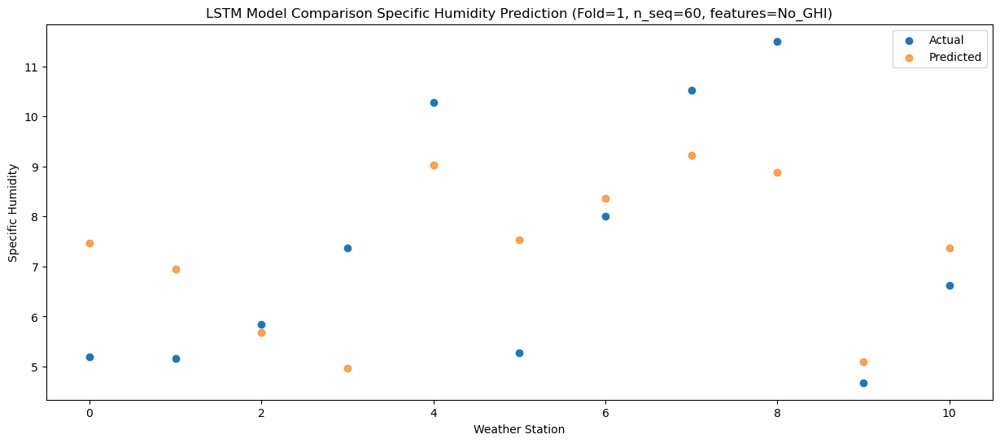

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.26   9.970844
1                 1    6.68   9.451906
2                 2    7.27   8.193083
3                 3    8.76   7.471598
4                 4   11.78  11.531104
5                 5   10.12  10.020727
6                 6    9.96  10.866073
7                 7   12.54  11.718973
8                 8   14.41  11.382377
9                 9   10.35   7.586846
10               10    8.45   9.877535


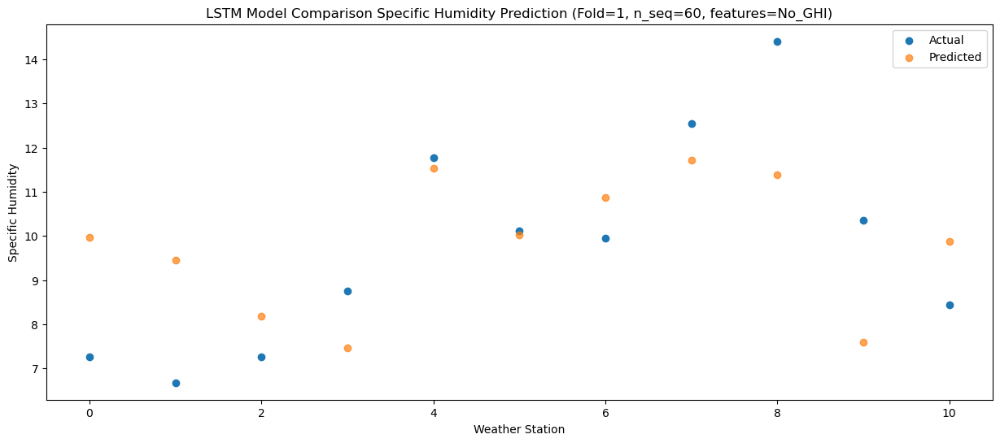

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    9.68  11.088755
1                 1    9.28  10.569802
2                 2   10.44   9.311804
3                 3    8.84   8.588983
4                 4   12.10  12.647958
5                 5    9.97  11.136230
6                 6   12.34  11.981363
7                 7   13.21  12.835197
8                 8   13.02  12.496539
9                 9    8.60   8.700785
10               10   11.82  10.992161


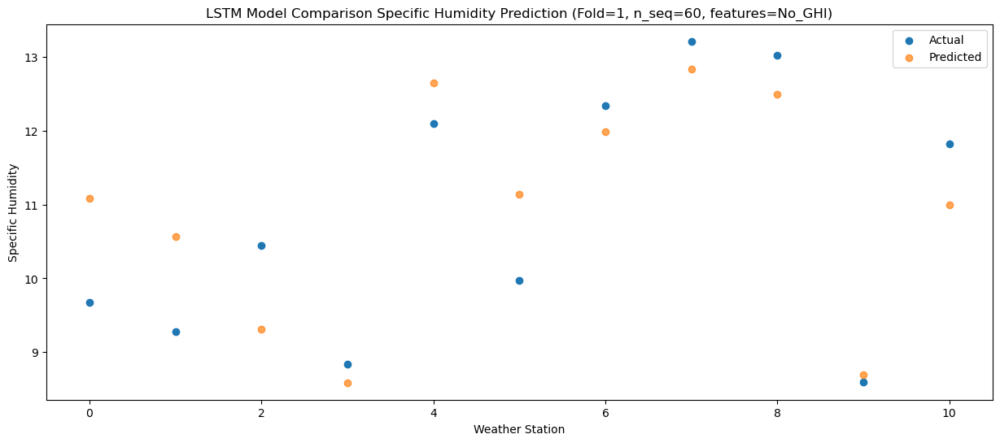

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.04  10.571414
1                 1    7.55  10.050820
2                 2    8.32   8.791623
3                 3    8.93   8.067040
4                 4   12.15  12.125989
5                 5    8.83  10.616701
6                 6   10.62  11.462867
7                 7   11.97  12.314109
8                 8   12.43  11.974234
9                 9    8.79   8.176550
10               10   10.24  10.473156


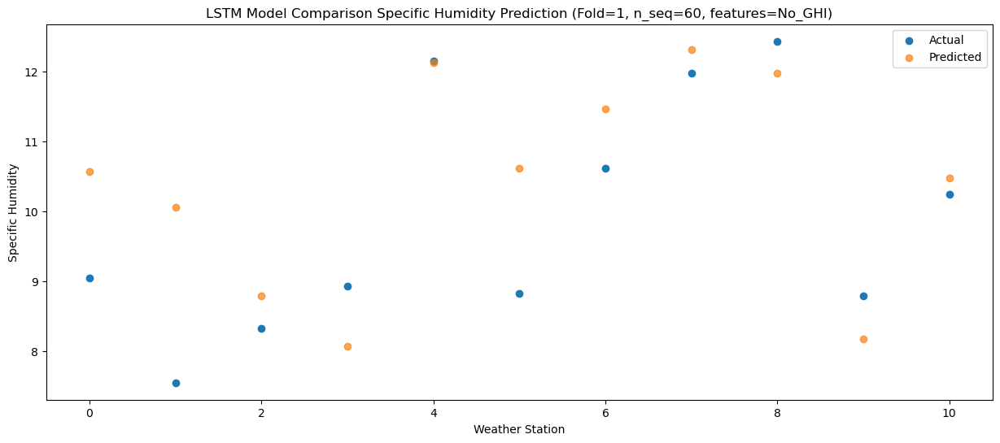

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.05   8.271132
1                 1    6.03   7.751471
2                 2    6.77   6.493161
3                 3    6.01   5.765801
4                 4    9.61   9.824407
5                 5    9.31   8.311099
6                 6    9.33   9.160906
7                 7   10.21  10.009874
8                 8   10.52   9.667242
9                 9    6.35   5.867787
10               10    7.75   8.170098


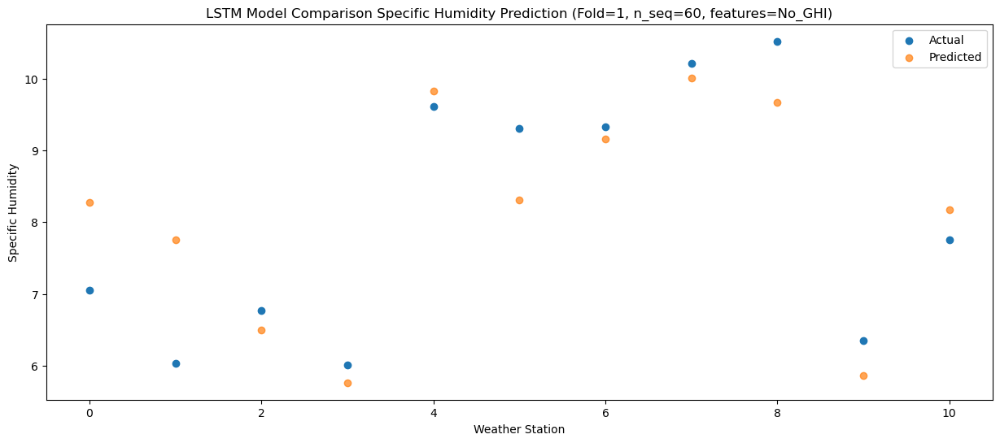

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.10   4.383112
1                 1    2.20   3.863052
2                 2    2.27   2.606044
3                 3    1.96   1.882081
4                 4    5.28   5.941504
5                 5    5.04   4.432778
6                 6    5.19   5.275394
7                 7    5.17   6.124669
8                 8    7.16   5.786522
9                 9    3.36   1.992299
10               10    3.44   4.286226


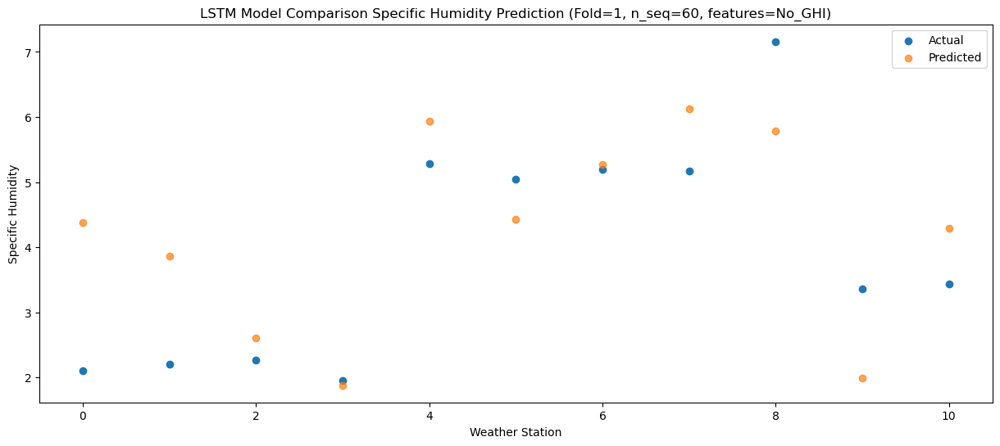

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (1, 1, 1024)              11632640  
                                                                 
 dropout_2 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_3 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_3 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_3 (Dense)             (1, 256)                  262400    
                                                                 
 dense_4 (Dense)             (1, 128)                  32896     
                                                                 
 dense_5 (Dense)             (1, 60)                  

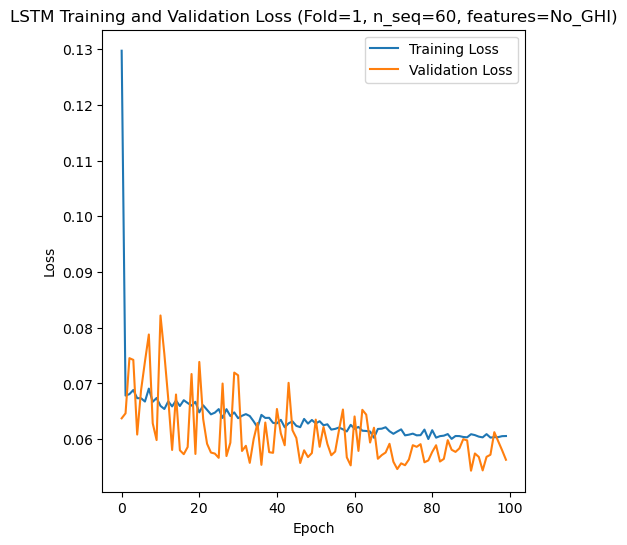

Epoch 1/100
84/84 [==============================] - 8s 50ms/step - loss: 0.1601 - accuracy: 0.3810 - mae: 0.1268 - rmse: 0.1601 - mape: 28.4296 - pearson: 0.6253 - val_loss: 0.0429 - val_accuracy: 0.8000 - val_mae: 0.0331 - val_rmse: 0.0429 - val_mape: 7.4730 - val_pearson: 0.9110
Epoch 2/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0693 - accuracy: 0.4405 - mae: 0.0544 - rmse: 0.0693 - mape: 12.2854 - pearson: 0.7658 - val_loss: 0.0545 - val_accuracy: 0.8000 - val_mae: 0.0434 - val_rmse: 0.0545 - val_mape: 9.6379 - val_pearson: 0.8666
Epoch 3/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0689 - accuracy: 0.4405 - mae: 0.0539 - rmse: 0.0689 - mape: 12.2738 - pearson: 0.7648 - val_loss: 0.0397 - val_accuracy: 0.8000 - val_mae: 0.0309 - val_rmse: 0.0397 - val_mape: 7.0070 - val_pearson: 0.9238
Epoch 4/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0696 - accuracy: 0.5238 - mae: 0.0548 - rmse: 0.0696 - mape: 12.5108 - pear

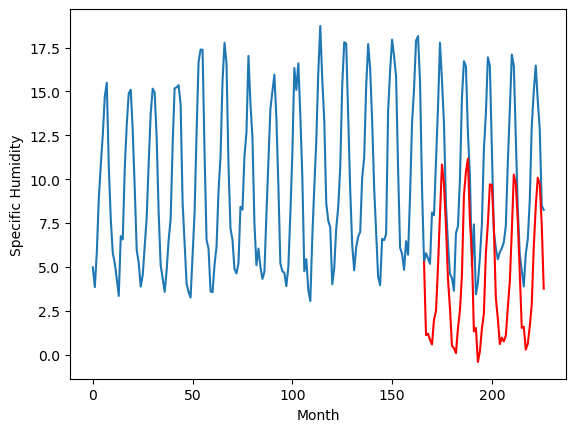

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		-1.63		-1.89
-0.25		-1.55		-1.30
-0.27		-1.90		-1.63
-0.21		-2.16		-1.95
1.58		-0.74		-2.32
1.87		-0.26		-2.13
4.77		2.27		-2.50
6.19		5.28		-0.91
11.00		8.10		-2.90
9.57		7.01		-2.56
5.51		4.58		-0.93
1.78		1.58		-0.20
1.56		-0.09		-1.65
-0.17		-2.24		-2.07
-0.22		-2.38		-2.16
-0.90		-2.66		-1.76
0.95		-1.26		-2.21
1.07		-0.24		-1.31
6.19		1.78		-4.41
9.10		6.32		-2.78
10.71		7.66		-3.05
9.09		8.42		-0.67
6.27		4.88		-1.39
2.88		3.01		0.13
0.45		-1.43		-1.88
-0.61		-1.23		-0.62
-0.94		-3.17		-2.23
-1.03		-2.58		-1.55
-0.15		-1.28		-1.13
1.00		-0.43		-1.43
3.39		3.00		-0.39
7.75		4.71		-3.04
9.09		6.94		-2.15
8.59		6.91		-1.68
6.02		4.49		-1.53
2.34		0.46		-1.88
0.84		-0.72		-1.56
-0.35		-2.17		-1.82
-0.36		-1.81		-1.45
-0.44		-2.02		-1.58
0.25		-1.69		-1.94
0.87		-0.08		-0.95
6.65		1.41		-5.24
9.30		4.26		-5.04
11.36		7.49		-3.87
9.47		6.97		-2.50
6.88		4.86		-2.02
3.42		1.82		-1.60
0.

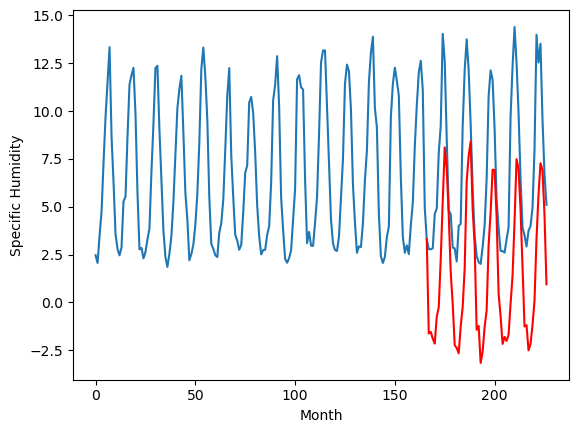

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		1.52		1.40
0.43		1.60		1.17
-1.13		1.25		2.38
-0.25		1.00		1.25
0.92		2.41		1.49
2.40		2.90		0.50
3.51		5.43		1.92
6.85		8.44		1.59
7.87		11.27		3.40
8.57		10.18		1.61
7.87		7.76		-0.11
5.28		4.76		-0.52
2.33		3.09		0.76
-2.34		0.94		3.28
-1.85		0.80		2.65
0.28		0.52		0.24
0.50		1.92		1.42
1.47		2.95		1.48
2.78		4.97		2.19
6.56		9.51		2.95
6.96		10.85		3.89
7.58		11.61		4.03
6.30		8.07		1.77
3.64		6.19		2.55
-0.31		1.75		2.06
1.09		1.96		0.87
-2.56		0.03		2.59
-1.37		0.62		1.99
0.44		1.91		1.47
1.80		2.77		0.97
4.90		6.20		1.30
6.83		7.91		1.08
7.66		10.14		2.48
7.55		10.11		2.56
7.40		7.69		0.29
3.01		3.66		0.65
2.90		2.48		-0.42
-0.76		1.03		1.79
-1.14		1.40		2.54
0.71		1.19		0.48
1.10		1.52		0.42
2.61		3.13		0.52
3.42		4.61		1.19
6.58		7.48		0.90
7.55		10.70		3.15
8.27		10.19		1.92
5.88		8.08		2.20
2.96		5.04		2.08
0.46		1.96		1.50
-0.11		2.02		2.13
-1.18		0.72		1.90
-1.60		1.05		2.6

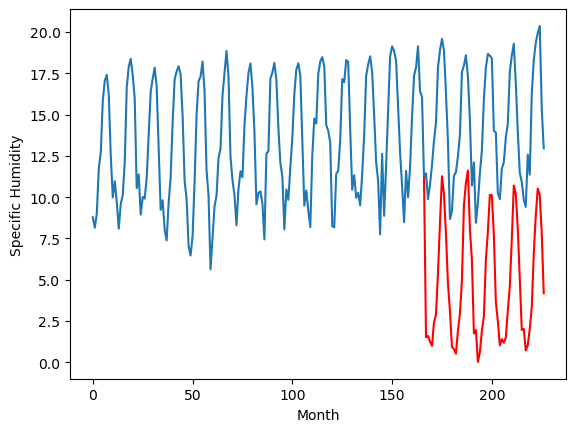

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		1.54		0.77
0.21		1.62		1.41
0.03		1.27		1.24
0.05		1.01		0.96
0.57		2.42		1.85
0.95		2.90		1.95
3.20		5.43		2.23
7.21		8.44		1.23
10.59		11.27		0.68
9.76		10.18		0.42
6.67		7.76		1.09
4.16		4.75		0.59
2.29		3.08		0.79
0.37		0.93		0.56
-0.71		0.79		1.50
-0.54		0.51		1.05
0.10		1.91		1.81
1.45		2.94		1.49
3.13		4.96		1.83
7.73		9.51		1.78
10.33		10.85		0.52
11.07		11.61		0.54
8.41		8.07		-0.34
5.45		6.20		0.75
1.00		1.75		0.75
0.64		1.95		1.31
-0.69		0.02		0.71
-0.12		0.61		0.73
0.64		1.90		1.26
1.34		2.76		1.42
4.64		6.18		1.54
6.90		7.89		0.99
10.26		10.13		-0.13
10.94		10.10		-0.84
7.14		7.67		0.53
4.27		3.64		-0.63
2.45		2.47		0.02
0.36		1.02		0.66
0.87		1.39		0.52
0.11		1.18		1.07
0.36		1.50		1.14
2.44		3.12		0.68
3.25		4.60		1.35
7.15		7.46		0.31
11.41		10.68		-0.73
9.07		10.17		1.10
8.06		8.06		-0.00
4.70		5.02		0.32
0.87		1.94		1.07
1.16		2.01		0.85
-0.17		0.70		0.87
-0.22		1.03		

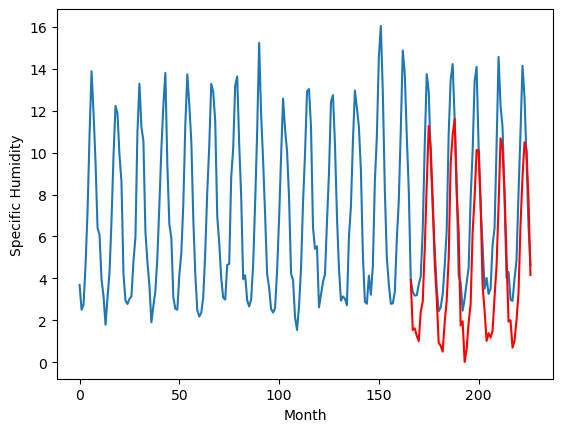

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		1.45		2.24
0.01		1.53		1.52
0.04		1.18		1.14
0.36		0.92		0.56
3.85		2.34		-1.51
2.89		2.82		-0.07
5.01		5.35		0.34
8.35		8.36		0.01
10.48		11.19		0.71
9.75		10.10		0.35
7.95		7.68		-0.27
4.74		4.67		-0.07
2.01		3.00		0.99
-1.27		0.85		2.12
-1.14		0.71		1.85
-1.16		0.43		1.59
2.13		1.83		-0.30
2.15		2.86		0.71
5.35		4.88		-0.47
9.24		9.42		0.18
10.27		10.76		0.49
9.87		11.52		1.65
7.73		7.98		0.25
5.20		6.11		0.91
-0.46		1.67		2.13
2.82		1.87		-0.95
-2.09		-0.06		2.03
-0.63		0.53		1.16
0.22		1.82		1.60
2.65		2.68		0.03
6.68		6.11		-0.57
8.98		7.82		-1.16
10.27		10.06		-0.21
10.67		10.02		-0.65
7.16		7.60		0.44
1.98		3.57		1.59
1.54		2.39		0.85
0.99		0.95		-0.04
0.90		1.31		0.41
2.20		1.10		-1.10
3.08		1.43		-1.65
3.63		3.04		-0.59
6.69		4.52		-2.17
10.00		7.38		-2.62
11.34		10.60		-0.74
11.37		10.09		-1.28
9.02		7.98		-1.04
3.79		4.95		1.16
1.27		1.87		0.60
-0.32		1.93		2.25
-1.19		0.62

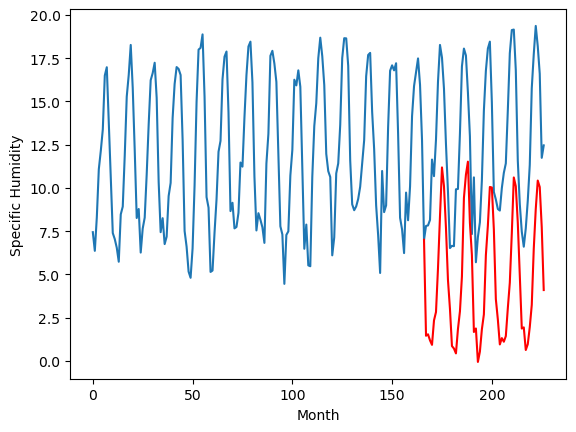

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		-1.06		0.15
-2.40		-0.98		1.42
-1.57		-1.32		0.25
-2.24		-1.58		0.66
2.37		-0.17		-2.54
1.85		0.32		-1.53
3.93		2.84		-1.09
6.05		5.85		-0.20
8.63		8.68		0.05
7.19		7.59		0.40
5.74		5.17		-0.57
1.87		2.16		0.29
-0.19		0.49		0.68
-2.51		-1.66		0.85
-2.64		-1.80		0.84
-2.69		-2.08		0.61
0.30		-0.68		-0.98
1.87		0.35		-1.52
6.70		2.37		-4.33
9.34		6.91		-2.43
8.30		8.25		-0.05
8.43		9.01		0.58
4.87		5.47		0.60
3.28		3.60		0.32
-0.91		-0.84		0.07
1.96		-0.64		-2.60
-3.67		-2.57		1.10
-3.45		-1.98		1.47
-1.83		-0.68		1.15
2.13		0.18		-1.95
5.78		3.60		-2.18
6.81		5.31		-1.50
7.91		7.55		-0.36
8.37		7.52		-0.85
5.01		5.09		0.08
0.19		1.06		0.87
0.05		-0.12		-0.17
-0.86		-1.56		-0.70
-1.24		-1.19		0.05
-0.79		-1.40		-0.61
0.99		-1.08		-2.07
1.54		0.54		-1.00
5.24		2.02		-3.22
8.70		4.88		-3.82
8.41		8.10		-0.31
6.98		7.59		0.61
6.43		5.48		-0.95
2.90		2.44		-0.46
-0.27		-0.64		-0.37
-2.20		-0

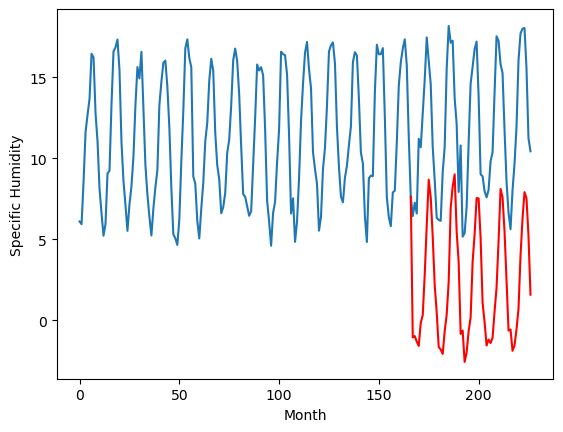

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		5.26		-0.31
4.47		5.35		0.88
5.15		5.00		-0.15
4.59		4.74		0.15
8.81		6.16		-2.65
8.39		6.64		-1.75
11.33		9.17		-2.16
13.61		12.18		-1.43
16.52		15.00		-1.52
13.82		13.91		0.09
12.88		11.49		-1.39
8.39		8.49		0.10
6.80		6.82		0.02
4.09		4.67		0.58
3.99		4.52		0.53
3.66		4.25		0.59
6.52		5.65		-0.87
7.84		6.67		-1.17
12.04		8.69		-3.35
15.79		13.23		-2.56
16.61		14.57		-2.04
16.99		15.33		-1.66
12.54		11.78		-0.76
9.93		9.91		-0.02
5.94		5.48		-0.46
8.44		5.68		-2.76
3.15		3.75		0.60
3.62		4.34		0.72
5.25		5.64		0.39
9.15		6.50		-2.65
13.24		9.92		-3.32
14.04		11.63		-2.41
13.36		13.86		0.50
14.42		13.83		-0.59
11.75		11.41		-0.34
6.97		7.38		0.41
6.52		6.20		-0.32
5.35		4.76		-0.59
4.57		5.12		0.55
4.97		4.91		-0.06
6.88		5.24		-1.64
7.55		6.86		-0.69
11.44		8.34		-3.10
15.34		11.20		-4.14
14.63		14.42		-0.21
12.58		13.92		1.34
11.95		11.80		-0.15
8.80		8.76		-0.04
6.18		5.68		-0.50
4.

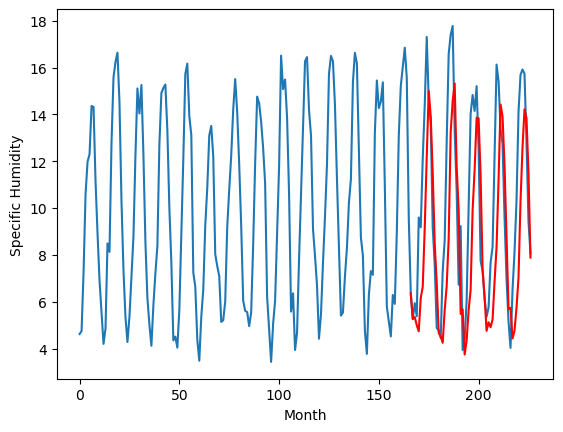

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		0.17		-2.45
2.17		0.26		-1.91
1.22		-0.09		-1.31
1.75		-0.35		-2.10
3.21		1.06		-2.15
1.81		1.55		-0.26
2.05		4.08		2.03
3.73		7.08		3.35
7.17		9.91		2.74
5.44		8.82		3.38
4.79		6.40		1.61
1.72		3.40		1.68
1.77		1.73		-0.04
0.51		-0.41		-0.92
0.79		-0.56		-1.35
0.66		-0.84		-1.50
0.75		0.57		-0.18
1.05		1.59		0.54
1.17		3.61		2.44
3.83		8.15		4.32
9.07		9.48		0.41
9.36		10.24		0.88
6.60		6.70		0.10
2.89		4.83		1.94
1.24		0.40		-0.84
1.37		0.61		-0.76
1.09		-1.33		-2.42
0.10		-0.74		-0.84
0.50		0.56		0.06
0.51		1.41		0.90
0.44		4.83		4.39
5.94		6.54		0.60
8.50		8.77		0.27
10.47		8.74		-1.73
7.43		6.32		-1.11
5.35		2.30		-3.05
1.38		1.11		-0.27
2.20		-0.33		-2.53
1.31		0.03		-1.28
1.19		-0.18		-1.37
1.53		0.15		-1.38
0.69		1.77		1.08
2.69		3.25		0.56
2.49		6.11		3.62
5.84		9.33		3.49
8.03		8.82		0.79
6.22		6.71		0.49
3.77		3.67		-0.10
2.85		0.59		-2.26
1.33		0.65		-0.68
1.75		-0.66		-2.41

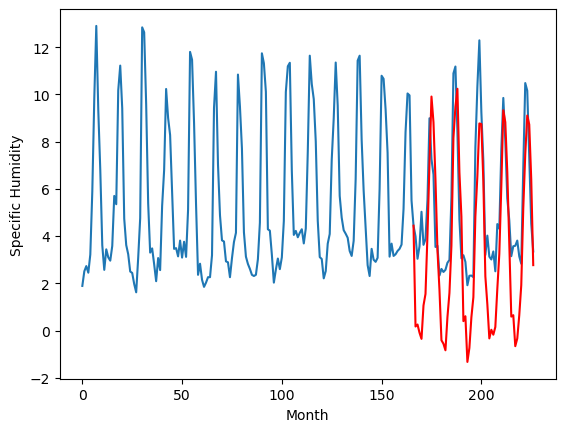

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		3.92		-3.86
7.60		4.01		-3.59
7.39		3.66		-3.73
6.67		3.40		-3.27
8.31		4.81		-3.50
9.72		5.30		-4.42
10.48		7.82		-2.66
10.46		10.83		0.37
11.23		13.65		2.42
12.31		12.56		0.25
10.53		10.15		-0.38
9.40		7.15		-2.25
7.16		5.48		-1.68
5.59		3.33		-2.26
6.44		3.18		-3.26
6.97		2.91		-4.06
7.08		4.32		-2.76
8.40		5.34		-3.06
9.88		7.35		-2.53
11.13		11.89		0.76
12.28		13.23		0.95
11.68		13.98		2.30
11.22		10.44		-0.78
8.42		8.57		0.15
7.88		4.14		-3.74
7.70		4.35		-3.35
6.34		2.42		-3.92
5.60		3.01		-2.59
7.34		4.30		-3.04
8.18		5.15		-3.03
9.44		8.56		-0.88
11.21		10.27		-0.94
12.10		12.50		0.40
12.20		12.47		0.27
13.05		10.05		-3.00
11.28		6.04		-5.24
6.64		4.86		-1.78
7.49		3.41		-4.08
7.58		3.78		-3.80
6.17		3.57		-2.60
8.09		3.90		-4.19
8.79		5.51		-3.28
10.19		7.00		-3.19
10.57		9.85		-0.72
11.91		13.07		1.16
12.52		12.57		0.05
12.27		10.45		-1.82
9.97		7.42		-2.55
6.94		4.34		-2.60


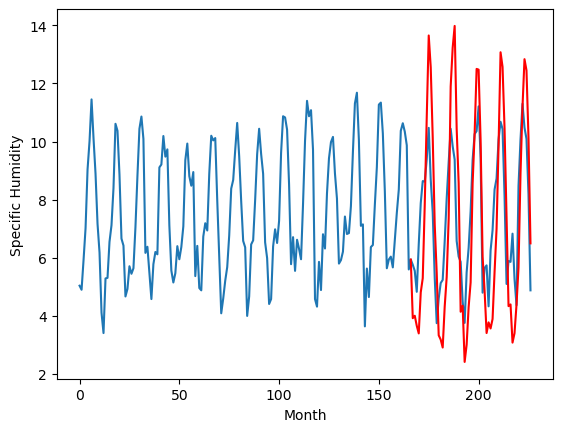

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		2.58		1.69
1.00		2.66		1.66
0.98		2.31		1.33
1.37		2.05		0.68
3.00		3.46		0.46
2.91		3.95		1.04
6.24		6.47		0.23
9.75		9.48		-0.27
12.60		12.30		-0.30
12.59		11.22		-1.37
8.87		8.80		-0.07
6.25		5.80		-0.45
3.60		4.13		0.53
0.38		1.98		1.60
0.26		1.83		1.57
0.33		1.56		1.23
2.06		2.96		0.90
2.59		3.99		1.40
5.30		6.00		0.70
9.80		10.55		0.75
11.32		11.88		0.56
11.90		12.64		0.74
8.30		9.09		0.79
6.14		7.22		1.08
0.58		2.79		2.21
2.43		2.99		0.56
-0.35		1.06		1.41
0.96		1.65		0.69
1.92		2.95		1.03
2.96		3.80		0.84
7.28		7.22		-0.06
9.08		8.93		-0.15
12.66		11.16		-1.50
11.09		11.13		0.04
7.66		8.71		1.05
3.30		4.69		1.39
2.83		3.51		0.68
0.59		2.07		1.48
1.45		2.43		0.98
2.21		2.22		0.01
1.90		2.55		0.65
4.03		4.16		0.13
5.56		5.64		0.08
8.42		8.50		0.08
12.26		11.72		-0.54
11.77		11.22		-0.55
8.63		9.10		0.47
4.44		6.07		1.63
1.33		2.99		1.66
1.24		3.05		1.81
0.55		1.74		1.19
0.69		2.0

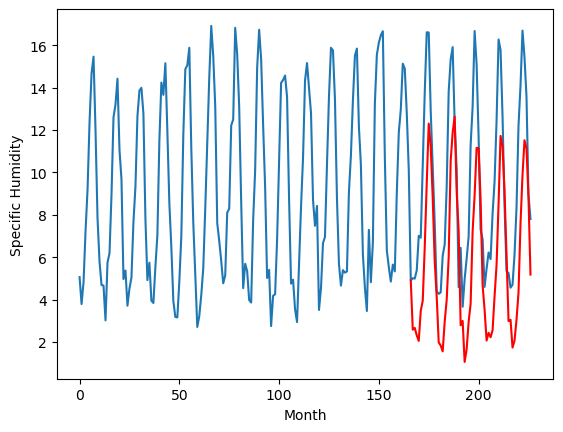

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		1.10		1.02
0.53		1.18		0.65
0.33		0.83		0.50
0.44		0.57		0.13
2.29		1.98		-0.31
1.72		2.46		0.74
4.51		4.99		0.48
7.95		8.00		0.05
10.65		10.82		0.17
10.41		9.74		-0.67
7.80		7.32		-0.48
4.61		4.31		-0.30
1.49		2.64		1.15
-0.30		0.49		0.79
-0.29		0.35		0.64
-0.05		0.07		0.12
0.98		1.47		0.49
1.59		2.50		0.91
4.26		4.51		0.25
8.36		9.06		0.70
9.77		10.39		0.62
10.16		11.15		0.99
6.95		7.61		0.66
5.22		5.73		0.51
-0.14		1.29		1.43
1.42		1.50		0.08
-1.00		-0.44		0.56
-0.10		0.16		0.26
0.52		1.45		0.93
1.79		2.31		0.52
5.95		5.73		-0.22
7.91		7.44		-0.47
11.12		9.68		-1.44
10.13		9.65		-0.48
6.65		7.22		0.57
1.99		3.20		1.21
1.37		2.02		0.65
0.28		0.58		0.30
0.55		0.94		0.39
0.95		0.73		-0.22
0.55		1.06		0.51
2.19		2.67		0.48
4.78		4.15		-0.63
6.62		7.01		0.39
9.93		10.23		0.30
10.04		9.72		-0.32
7.62		7.61		-0.01
3.51		4.57		1.06
0.56		1.49		0.93
0.35		1.55		1.20
-0.27		0.24		0.51
0.13		0

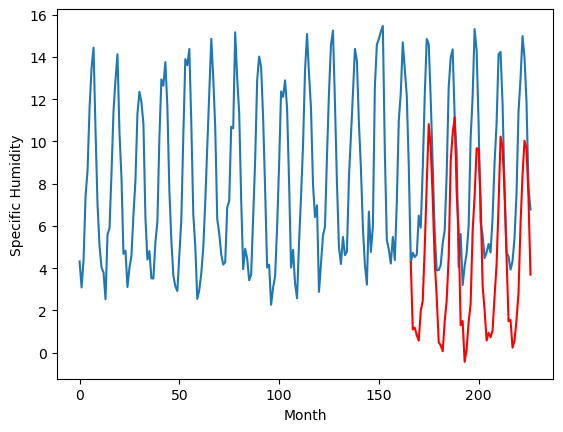

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[1.1022602272033692, -1.6267410373687745, 1.5215726280212403, 1.5401712036132809, 1.4486574840545652, -1.0590997123718262, 5.2622602272033685, 0.1716689491271972, 3.922484817504883, 2.57985029220581, 1.099895830154419]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   1.102260
1                 1    0.26  -1.626741
2                 2    0.12   1.521573
3                 3    0.77   1.540171
4                 4   -0.79   1.448657
5                 5   -1.21  -1.059100
6                 6    5.57   5.262260
7                 7    2.62   0.171669
8                 8    7.78   3.922485
9                 9    0.89   2.579850
10               10    0.08   1.099896


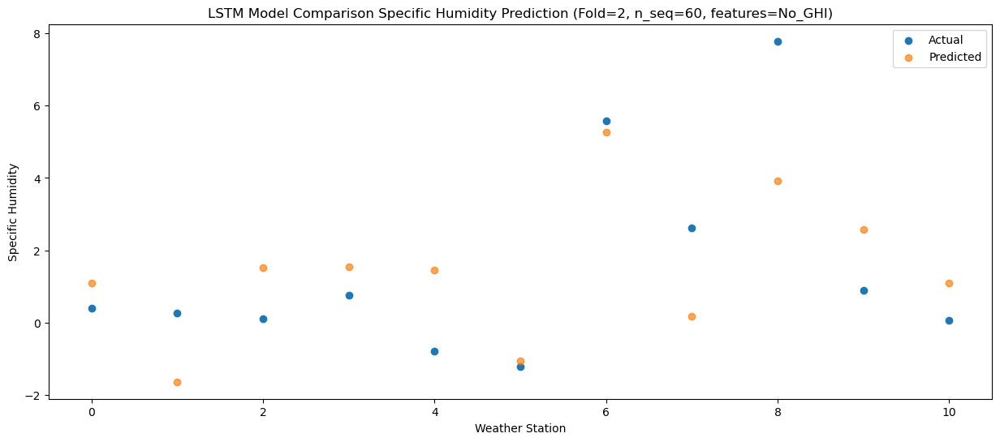

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91   1.182909
1                 1   -0.25  -1.546667
2                 2    0.43   1.603774
3                 3    0.21   1.619439
4                 4    0.01   1.532241
5                 5   -2.40  -0.975477
6                 6    4.47   5.345232
7                 7    2.17   0.255196
8                 8    7.60   4.005848
9                 9    1.00   2.662256
10               10    0.53   1.180648


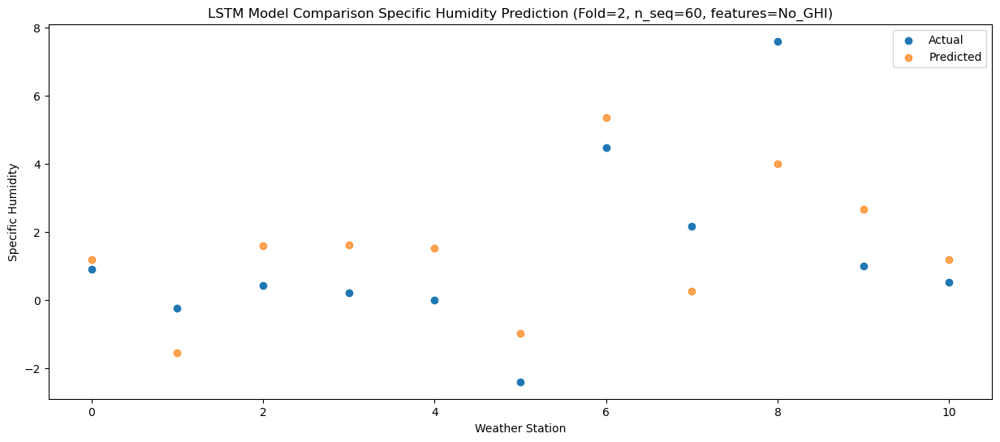

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   0.831483
1                 1   -0.27  -1.898283
2                 2   -1.13   1.254939
3                 3    0.03   1.266361
4                 4    0.04   1.181028
5                 5   -1.57  -1.323843
6                 6    5.15   4.998130
7                 7    1.22  -0.090677
8                 8    7.39   3.661050
9                 9    0.98   2.313432
10               10    0.33   0.829231


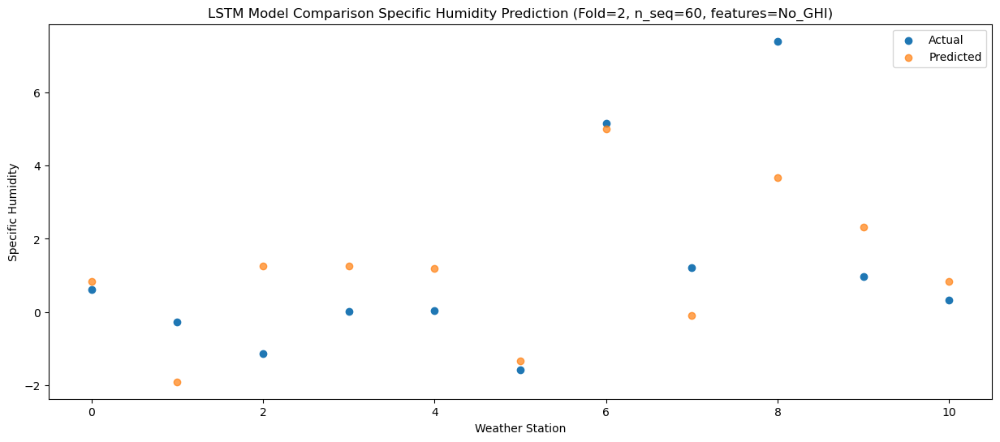

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   0.575741
1                 1   -0.21  -2.156918
2                 2   -0.25   0.999114
3                 3    0.05   1.006501
4                 4    0.36   0.922362
5                 5   -2.24  -1.583493
6                 6    4.59   4.738313
7                 7    1.75  -0.351773
8                 8    6.67   3.398593
9                 9    1.37   2.051343
10               10    0.44   0.571460


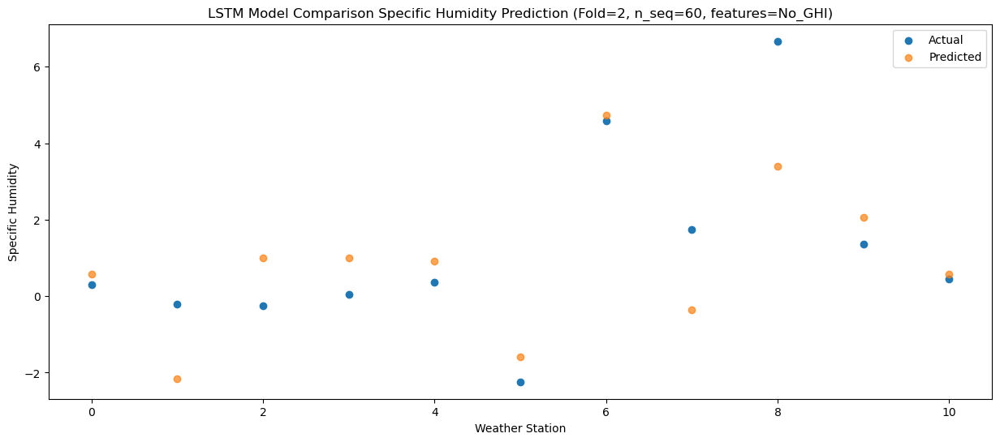

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   1.990533
1                 1    1.58  -0.743498
2                 2    0.92   2.413226
3                 3    0.57   2.418319
4                 4    3.85   2.336403
5                 5    2.37  -0.168279
6                 6    8.81   6.156404
7                 7    3.21   1.063675
8                 8    8.31   4.811049
9                 9    3.00   3.464566
10               10    2.29   1.982982


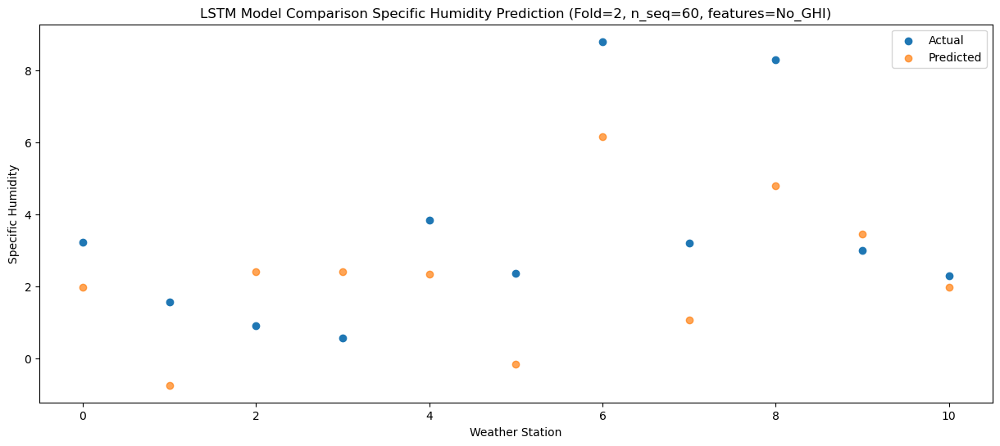

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.476500
1                 1    1.87  -0.257443
2                 2    2.40   2.898234
3                 3    0.95   2.904923
4                 4    2.89   2.821916
5                 5    1.85   0.317900
6                 6    8.39   6.642303
7                 7    1.81   1.549399
8                 8    9.72   5.296054
9                 9    2.91   3.947129
10               10    1.72   2.462621


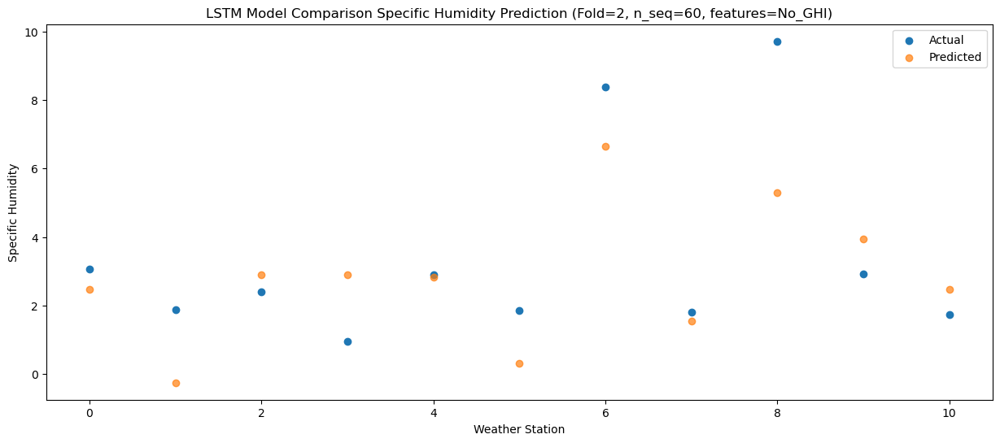

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   5.001629
1                 1    4.77   2.266535
2                 2    3.51   5.425755
3                 3    3.20   5.430879
4                 4    5.01   5.346951
5                 5    3.93   2.842439
6                 6   11.33   9.166390
7                 7    2.05   4.075060
8                 8   10.48   7.821087
9                 9    6.24   6.471650
10               10    4.51   4.987105


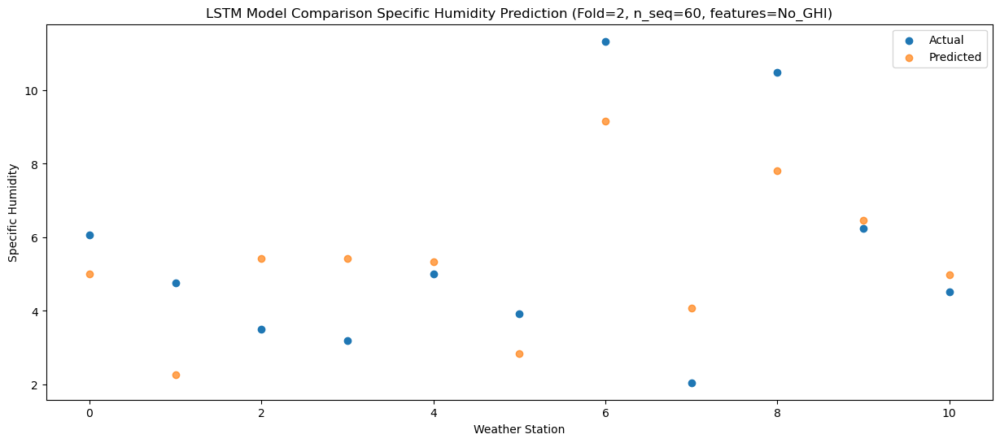

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21   8.014571
1                 1    6.19   5.276779
2                 2    6.85   8.439751
3                 3    7.21   8.441696
4                 4    8.35   8.358332
5                 5    6.05   5.852896
6                 6   13.61  12.177720
7                 7    3.73   7.084571
8                 8   10.46  10.825914
9                 9    9.75   9.479078
10               10    7.95   7.995825


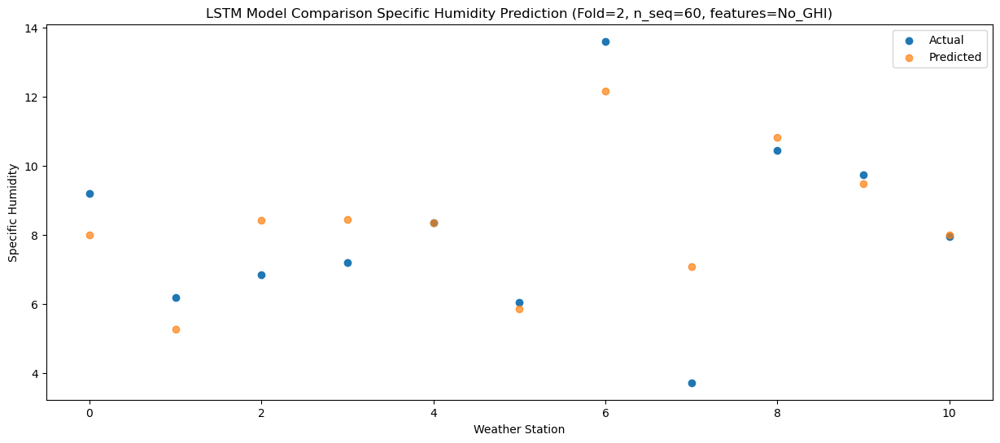

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  10.838698
1                 1   11.00   8.100441
2                 2    7.87  11.266739
3                 3   10.59  11.269381
4                 4   10.48  11.185608
5                 5    8.63   8.677441
6                 6   16.52  15.000980
7                 7    7.17   9.909270
8                 8   11.23  13.649357
9                 9   12.60  12.303035
10               10   10.65  10.821105


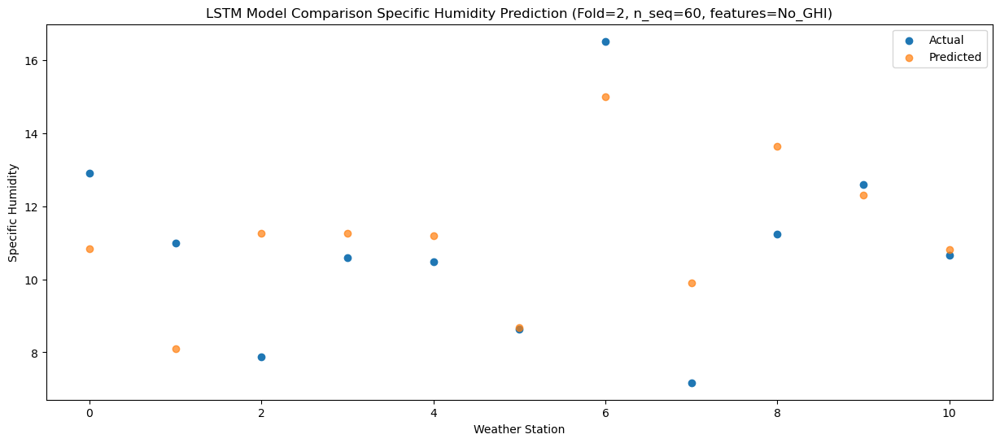

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75   9.749783
1                 1    9.57   7.009168
2                 2    8.57  10.182440
3                 3    9.76  10.182064
4                 4    9.75  10.100436
5                 5    7.19   7.590894
6                 6   13.82  13.913558
7                 7    5.44   8.822150
8                 8   12.31  12.561999
9                 9   12.59  11.217865
10               10   10.41   9.736159


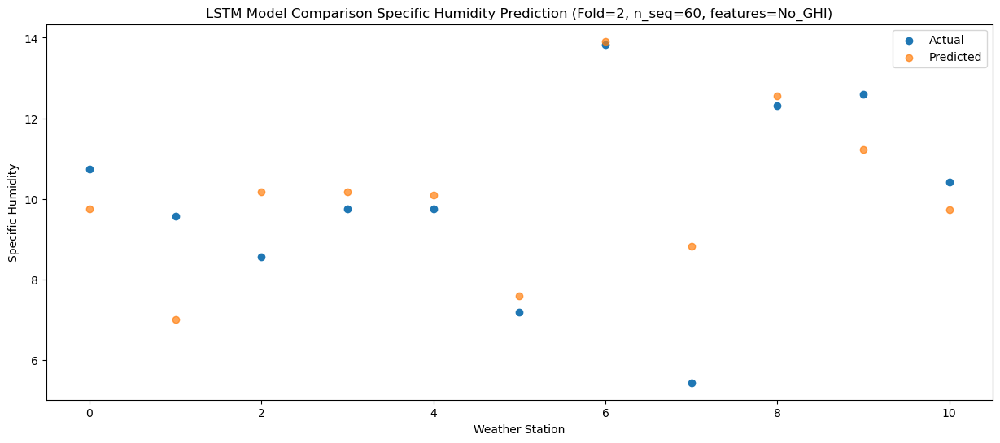

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   7.323125
1                 1    5.51   4.582909
2                 2    7.87   7.761343
3                 3    6.67   7.756259
4                 4    7.95   7.676164
5                 5    5.74   5.166645
6                 6   12.88  11.489324
7                 7    4.79   6.400413
8                 8   10.53  10.145213
9                 9    8.87   8.799577
10               10    7.80   7.315558


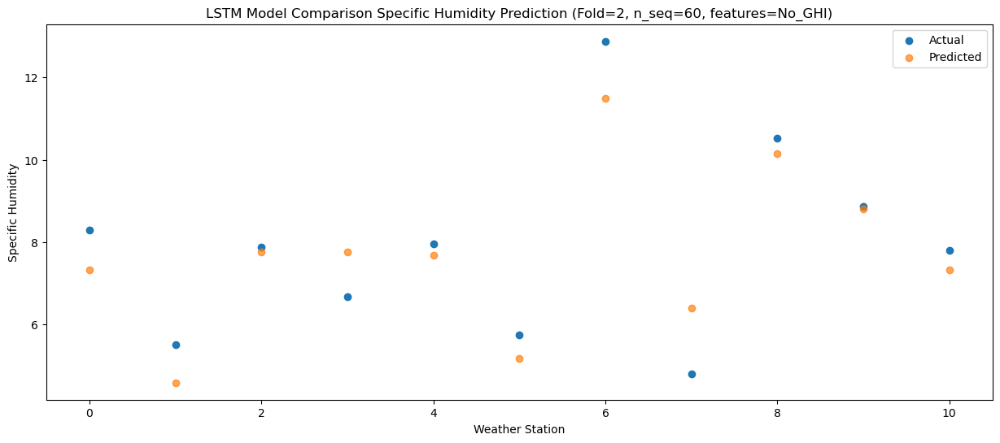

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.319679
1                 1    1.78   1.580983
2                 2    5.28   4.761590
3                 3    4.16   4.753244
4                 4    4.74   4.674007
5                 5    1.87   2.162885
6                 6    8.39   8.486486
7                 7    1.72   3.400634
8                 8    9.40   7.146241
9                 9    6.25   5.798987
10               10    4.61   4.314822


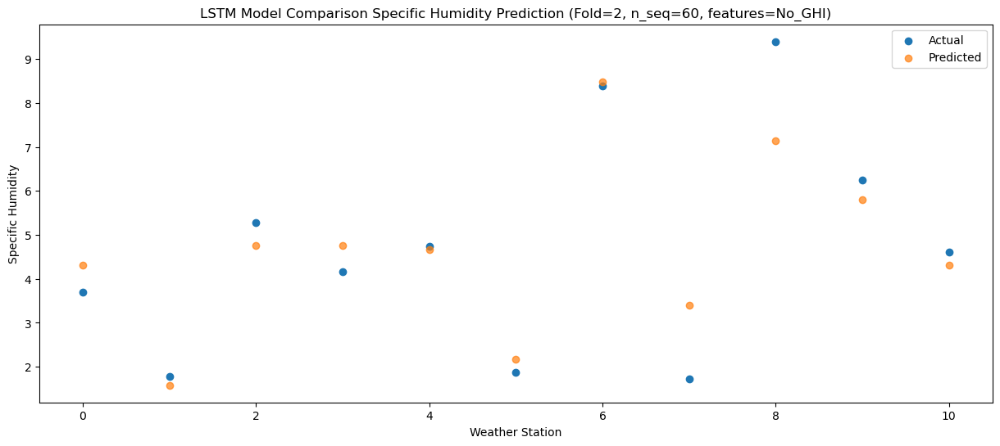

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45   2.649732
1                 1    1.56  -0.086444
2                 2    2.33   3.092153
3                 3    2.29   3.081958
4                 4    2.01   3.002179
5                 5   -0.19   0.492528
6                 6    6.80   6.817839
7                 7    1.77   1.734224
8                 8    7.16   5.479785
9                 9    3.60   4.127360
10               10    1.49   2.640595


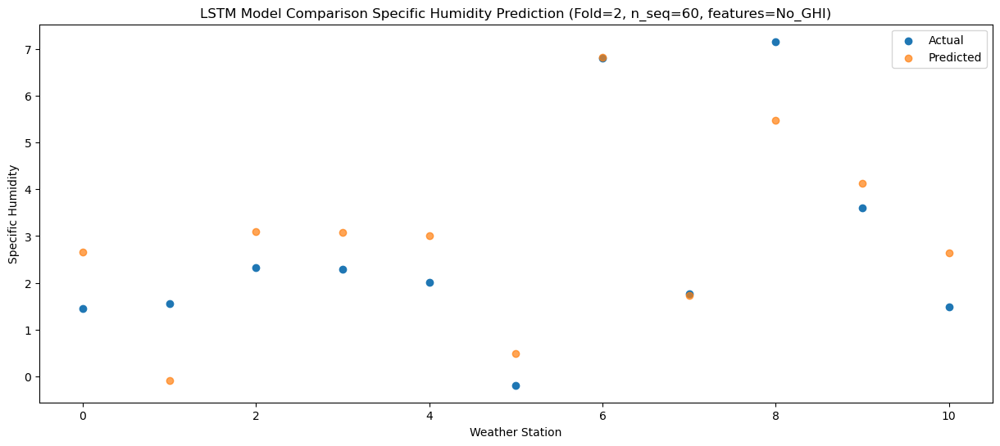

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28   0.501355
1                 1   -0.17  -2.235071
2                 2   -2.34   0.943802
3                 3    0.37   0.933305
4                 4   -1.27   0.853283
5                 5   -2.51  -1.655028
6                 6    4.09   4.671160
7                 7    0.51  -0.411264
8                 8    5.59   3.332920
9                 9    0.38   1.980907
10               10   -0.30   0.494532


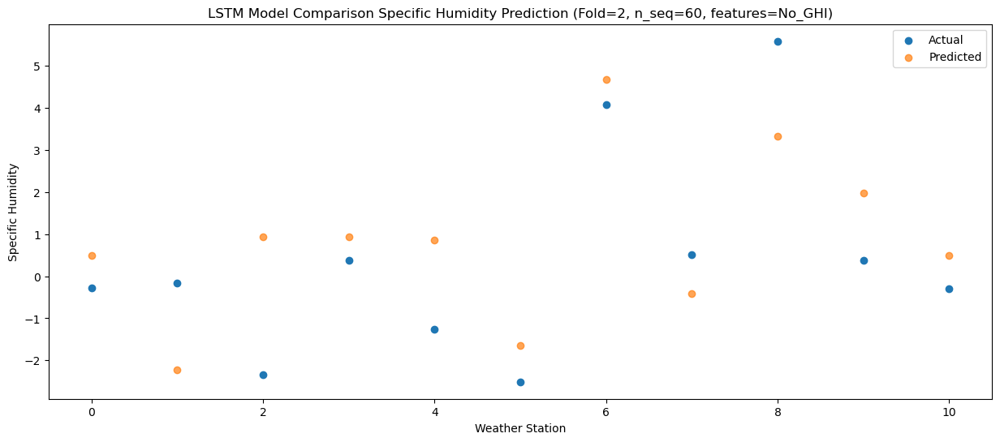

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51   0.356832
1                 1   -0.22  -2.382191
2                 2   -1.85   0.800397
3                 3   -0.71   0.788974
4                 4   -1.14   0.709534
5                 5   -2.64  -1.800334
6                 6    3.99   4.523838
7                 7    0.79  -0.559190
8                 8    6.44   3.184690
9                 9    0.26   1.834106
10               10   -0.29   0.348446


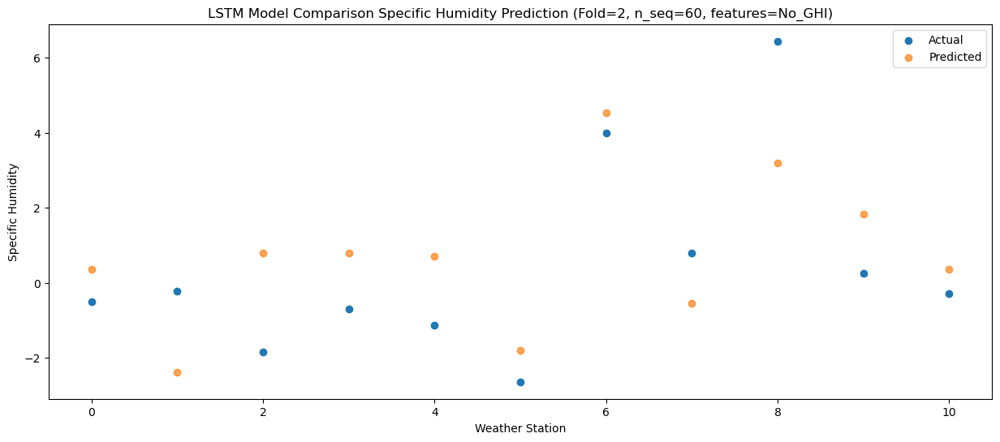

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23   0.075648
1                 1   -0.90  -2.663399
2                 2    0.28   0.520892
3                 3   -0.54   0.507062
4                 4   -1.16   0.428154
5                 5   -2.69  -2.080450
6                 6    3.66   4.245854
7                 7    0.66  -0.835747
8                 8    6.97   2.912572
9                 9    0.33   1.556949
10               10   -0.05   0.069979


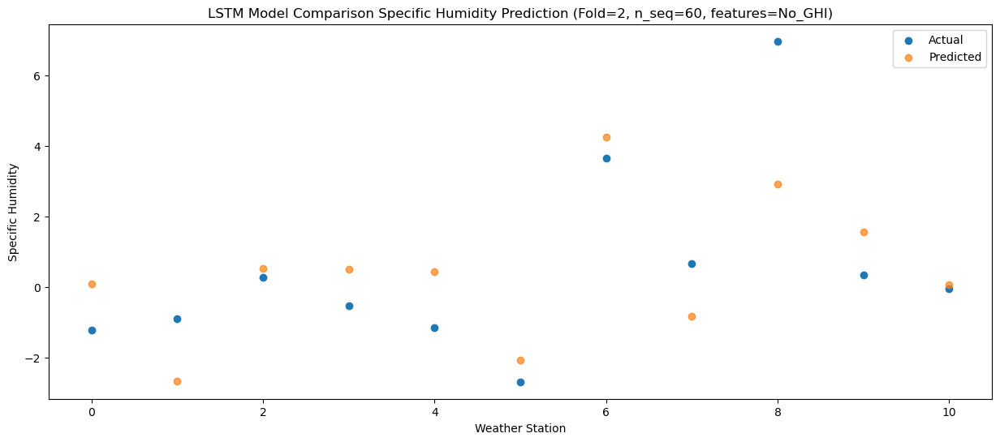

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   1.478283
1                 1    0.95  -1.263955
2                 2    0.50   1.920424
3                 3    0.10   1.906858
4                 4    2.13   1.829460
5                 5    0.30  -0.677545
6                 6    6.52   5.647655
7                 7    0.75   0.567355
8                 8    7.08   4.316107
9                 9    2.06   2.960044
10               10    0.98   1.471212


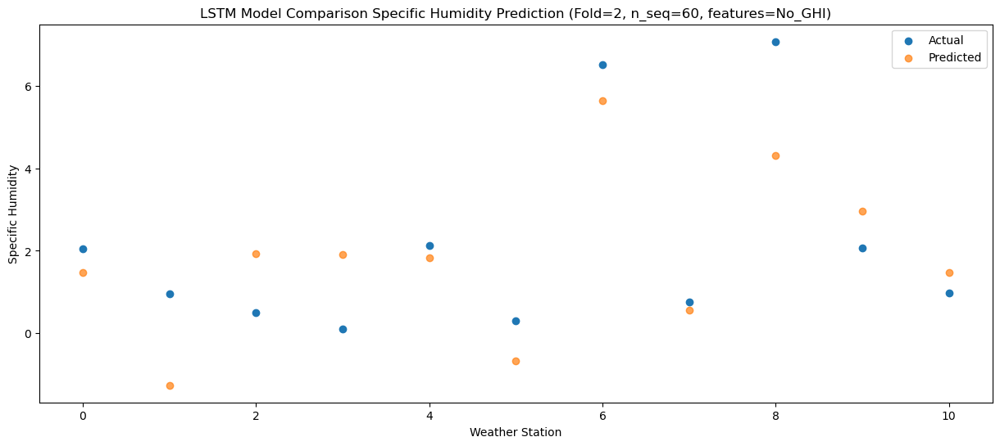

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   2.508673
1                 1    1.07  -0.238813
2                 2    1.47   2.947015
3                 3    1.45   2.935875
4                 4    2.15   2.858817
5                 5    1.87   0.349599
6                 6    7.84   6.674056
7                 7    1.05   1.590610
8                 8    8.40   5.335540
9                 9    2.59   3.985038
10               10    1.59   2.497110


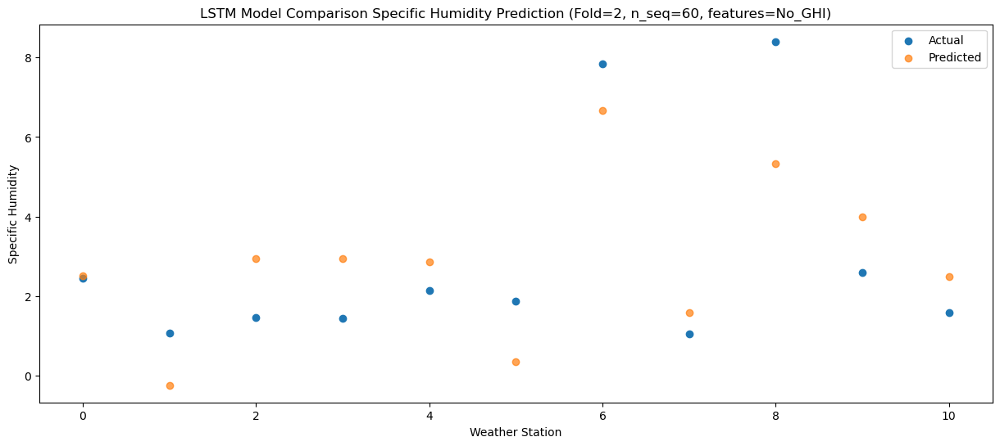

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   4.526288
1                 1    6.19   1.776405
2                 2    2.78   4.965251
3                 3    3.13   4.955231
4                 4    5.35   4.877252
5                 5    6.70   2.366893
6                 6   12.04   8.689778
7                 7    1.17   3.605005
8                 8    9.88   7.348025
9                 9    5.30   5.998741
10               10    4.26   4.511010


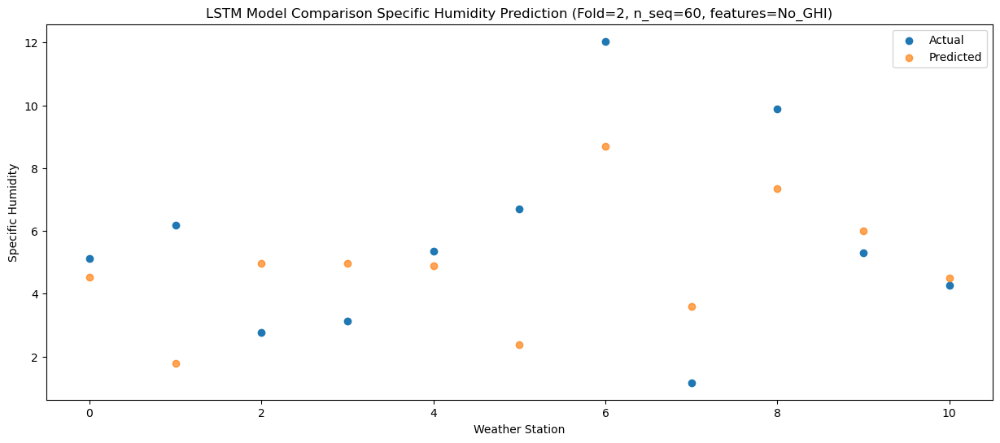

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76   9.074861
1                 1    9.10   6.324872
2                 2    6.56   9.511475
3                 3    7.73   9.506306
4                 4    9.24   9.423699
5                 5    9.34   6.911744
6                 6   15.79  13.233086
7                 7    3.83   8.149089
8                 8   11.13  11.892069
9                 9    9.80  10.545015
10               10    8.36   9.056991


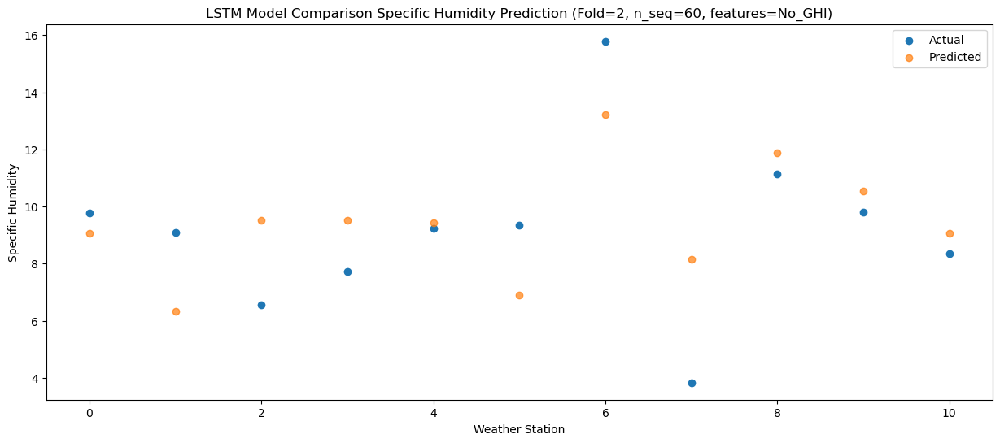

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86  10.414660
1                 1   10.71   7.663557
2                 2    6.96  10.850376
3                 3   10.33  10.847429
4                 4   10.27  10.761438
5                 5    8.30   8.249430
6                 6   16.61  14.572455
7                 7    9.07   9.484366
8                 8   12.28  13.225306
9                 9   11.32  11.881536
10               10    9.77  10.394953


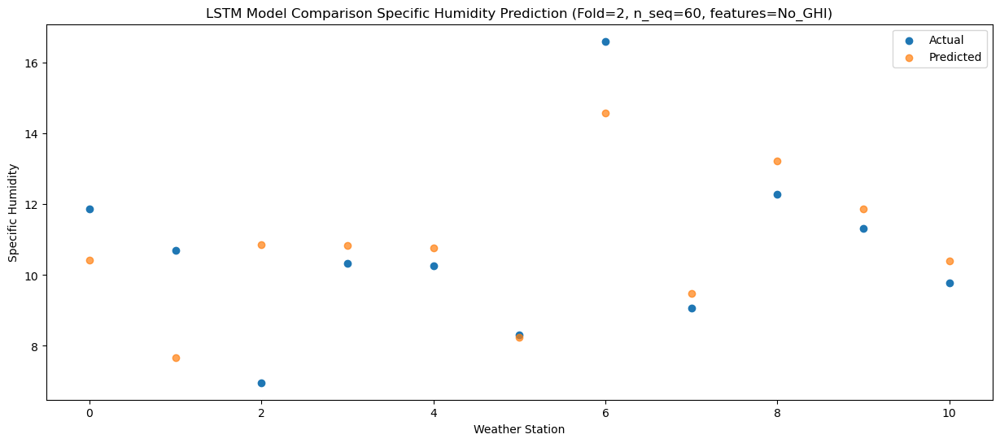

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56  11.174200
1                 1    9.09   8.418926
2                 2    7.58  11.605246
3                 3   11.07  11.605869
4                 4    9.87  11.519545
5                 5    8.43   9.006306
6                 6   16.99  15.326999
7                 7    9.36  10.238092
8                 8   11.68  13.978285
9                 9   11.90  12.635053
10               10   10.16  11.147448


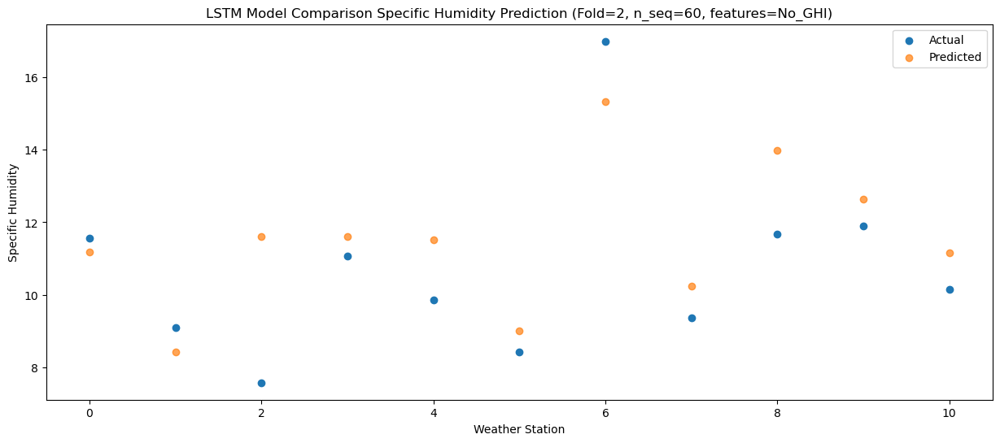

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   7.632515
1                 1    6.27   4.881959
2                 2    6.30   8.065631
3                 3    8.41   8.068593
4                 4    7.73   7.979570
5                 5    4.87   5.465343
6                 6   12.54  11.783960
7                 7    6.60   6.700343
8                 8   11.22  10.441572
9                 9    8.30   9.094662
10               10    6.95   7.605997


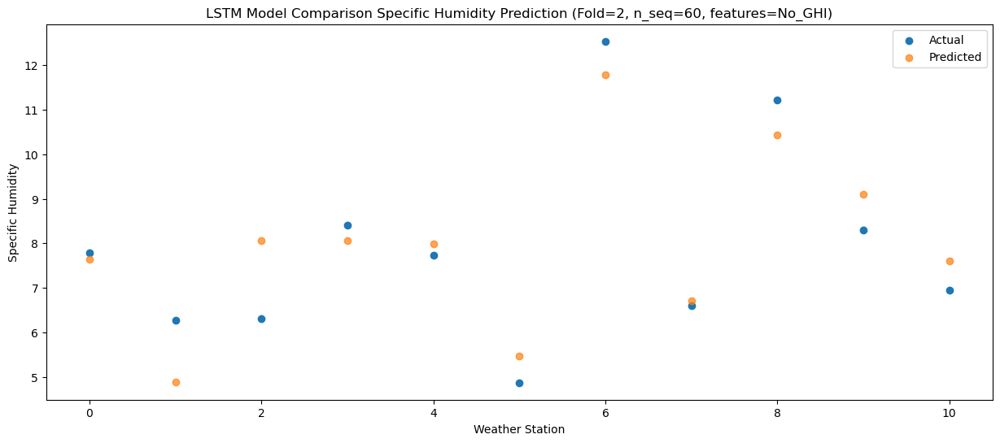

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   5.761791
1                 1    2.88   3.010932
2                 2    3.64   6.194691
3                 3    5.45   6.198105
4                 4    5.20   6.109065
5                 5    3.28   3.595167
6                 6    9.93   9.914133
7                 7    2.89   4.829216
8                 8    8.42   8.568614
9                 9    6.14   7.221981
10               10    5.22   5.733504


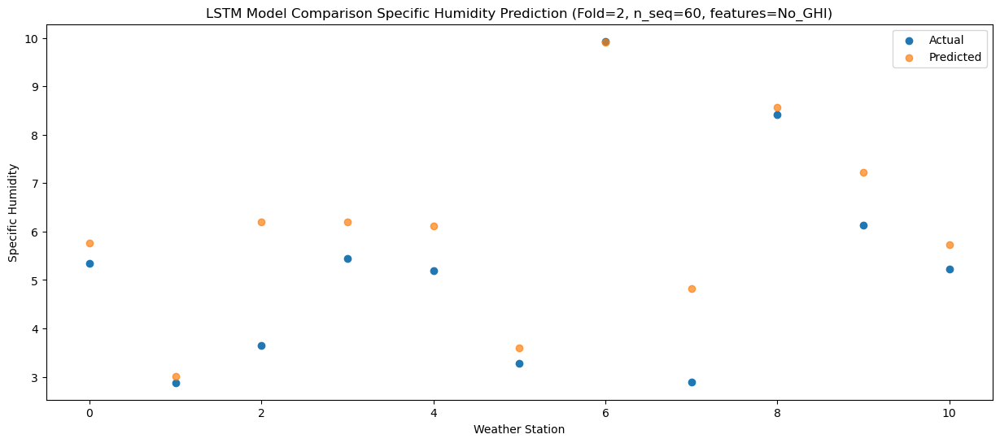

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15   1.314442
1                 1    0.45  -1.432204
2                 2   -0.31   1.753864
3                 3    1.00   1.752064
4                 4   -0.46   1.665650
5                 5   -0.91  -0.843874
6                 6    5.94   5.476702
7                 7    1.24   0.397889
8                 8    7.88   4.143692
9                 9    0.58   2.787495
10               10   -0.14   1.294037


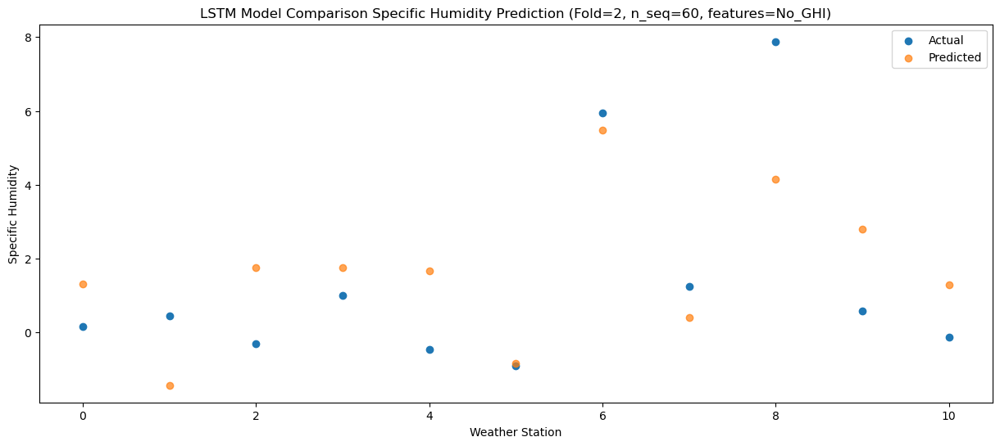

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.515168
1                 1   -0.61  -1.229417
2                 2    1.09   1.963782
3                 3    0.64   1.954743
4                 4    2.82   1.871346
5                 5    1.96  -0.636354
6                 6    8.44   5.684408
7                 7    1.37   0.606525
8                 8    7.70   4.351966
9                 9    2.43   2.994589
10               10    1.42   1.500281


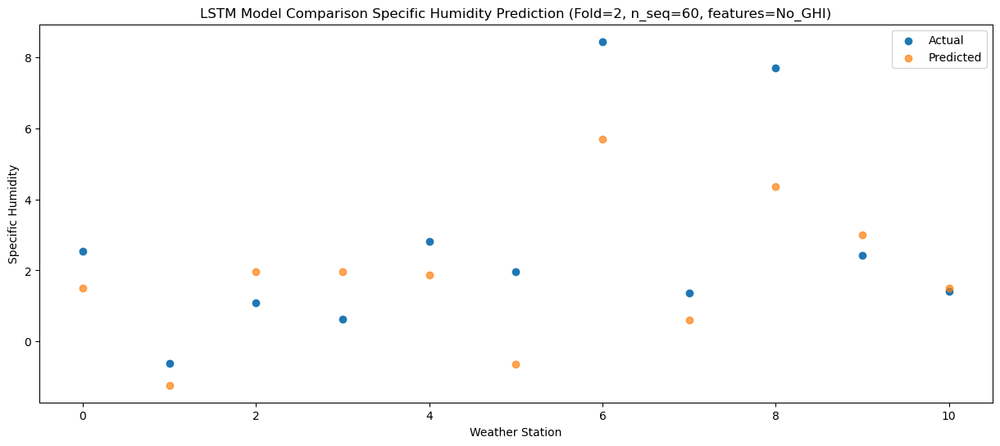

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -0.423233
1                 1   -0.94  -3.166089
2                 2   -2.56   0.028384
3                 3   -0.69   0.017493
4                 4   -2.09  -0.064786
5                 5   -3.67  -2.572752
6                 6    3.15   3.746824
7                 7    1.09  -1.328277
8                 8    6.34   2.417152
9                 9   -0.35   1.059594
10               10   -1.00  -0.436687


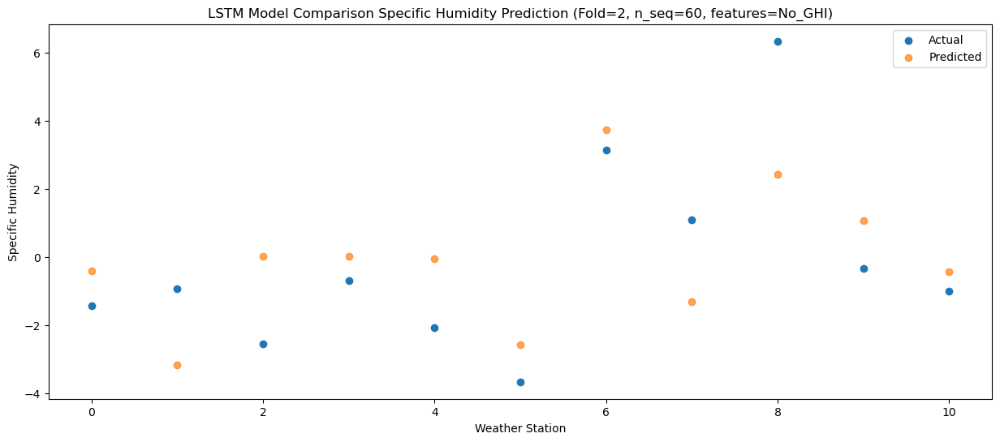

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78   0.171471
1                 1   -1.03  -2.575111
2                 2   -1.37   0.620943
3                 3   -0.12   0.611711
4                 4   -0.63   0.529114
5                 5   -3.45  -1.977309
6                 6    3.62   4.341453
7                 7    0.10  -0.736934
8                 8    5.60   3.008204
9                 9    0.96   1.653263
10               10   -0.10   0.157810


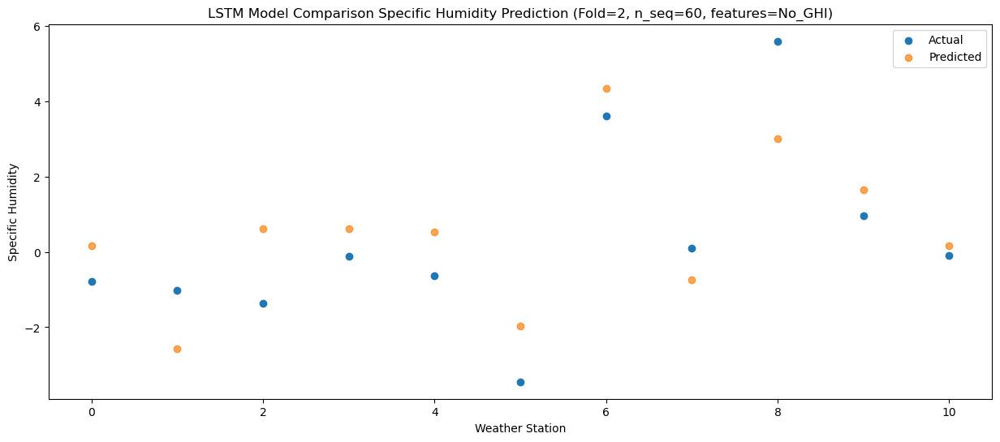

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65   1.464954
1                 1   -0.15  -1.282059
2                 2    0.44   1.913832
3                 3    0.64   1.902913
4                 4    0.22   1.822167
5                 5   -1.83  -0.681089
6                 6    5.25   5.638274
7                 7    0.50   0.560586
8                 8    7.34   4.304789
9                 9    1.92   2.947447
10               10    0.52   1.453182


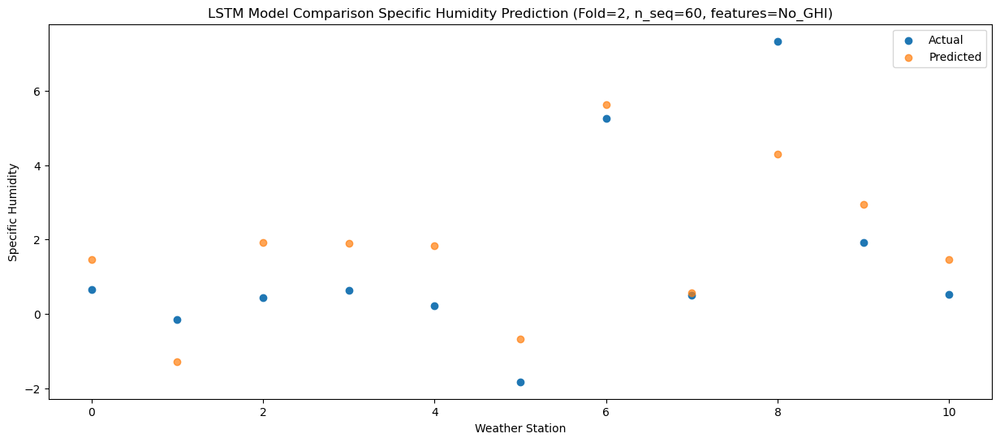

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55   2.326230
1                 1    1.00  -0.426629
2                 2    1.80   2.773662
3                 3    1.34   2.760380
4                 4    2.65   2.682662
5                 5    2.13   0.177411
6                 6    9.15   6.495216
7                 7    0.51   1.413115
8                 8    8.18   5.152826
9                 9    2.96   3.800191
10               10    1.79   2.308961


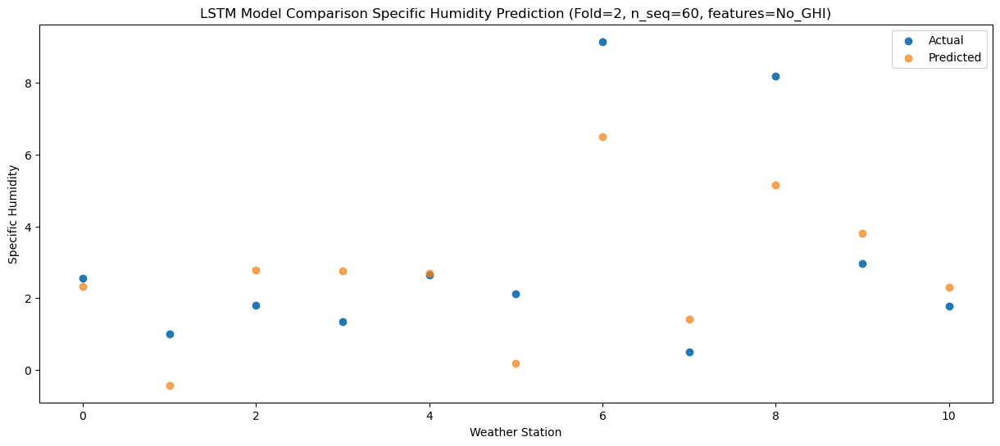

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81   5.757404
1                 1    3.39   2.996946
2                 2    4.90   6.195903
3                 3    4.64   6.184300
4                 4    6.68   6.107992
5                 5    5.78   3.601436
6                 6   13.24   9.919660
7                 7    0.44   4.830848
8                 8    9.44   8.562083
9                 9    7.28   7.217554
10               10    5.95   5.730649


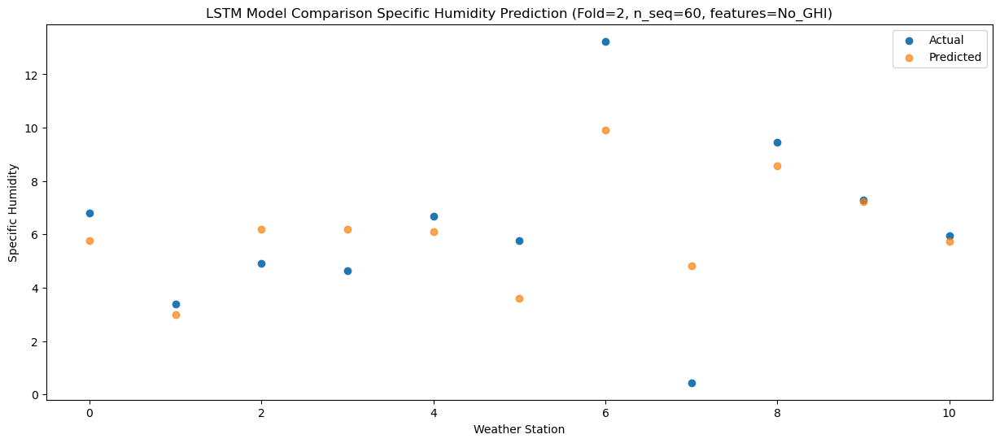

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86   7.465328
1                 1    7.75   4.706452
2                 2    6.83   7.907777
3                 3    6.90   7.890592
4                 4    8.98   7.818840
5                 5    6.81   5.312257
6                 6   14.04  11.629677
7                 7    5.94   6.541558
8                 8   11.21  10.269633
9                 9    9.08   8.927460
10               10    7.91   7.441235


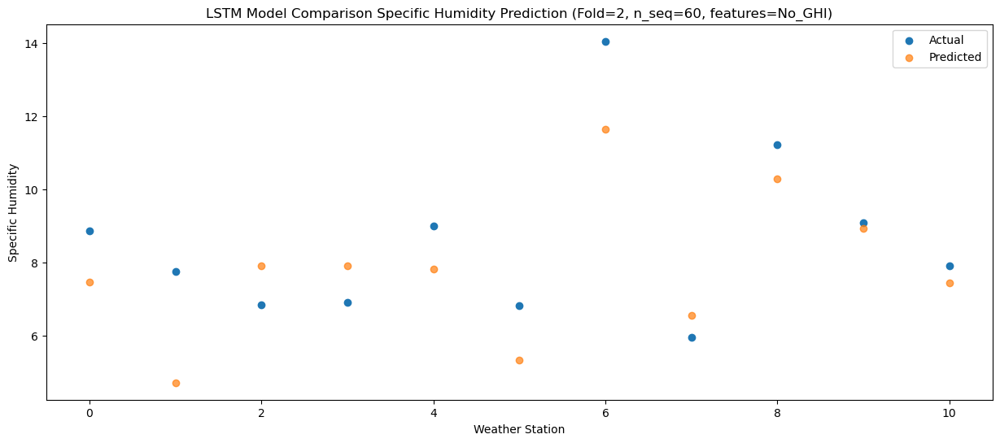

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08   9.702854
1                 1    9.09   6.939118
2                 2    7.66  10.143364
3                 3   10.26  10.128275
4                 4   10.27  10.055749
5                 5    7.91   7.546878
6                 6   13.36  13.862603
7                 7    8.50   8.770609
8                 8   12.10  12.498649
9                 9   12.66  11.161178
10               10   11.12   9.677003


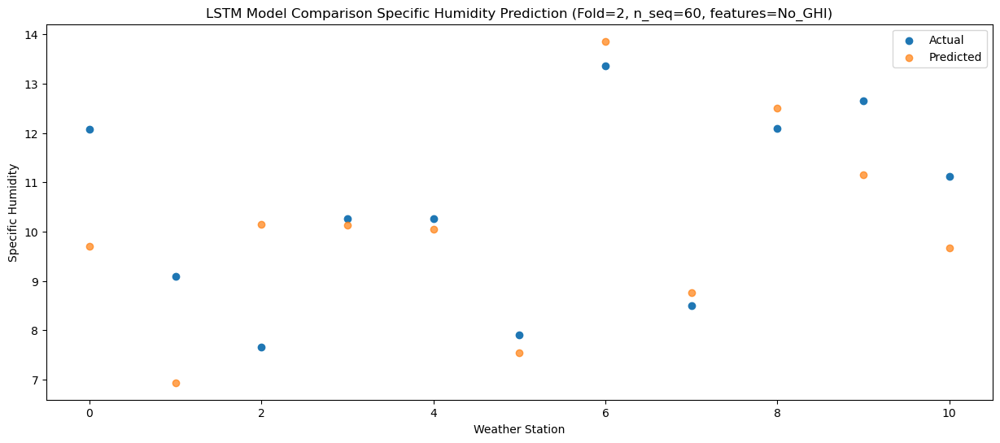

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60   9.674429
1                 1    8.59   6.910622
2                 2    7.55  10.113297
3                 3   10.94  10.097328
4                 4   10.67  10.023320
5                 5    8.37   7.516095
6                 6   14.42  13.833613
7                 7   10.47   8.743836
8                 8   12.20  12.474277
9                 9   11.09  11.131644
10               10   10.13   9.646122


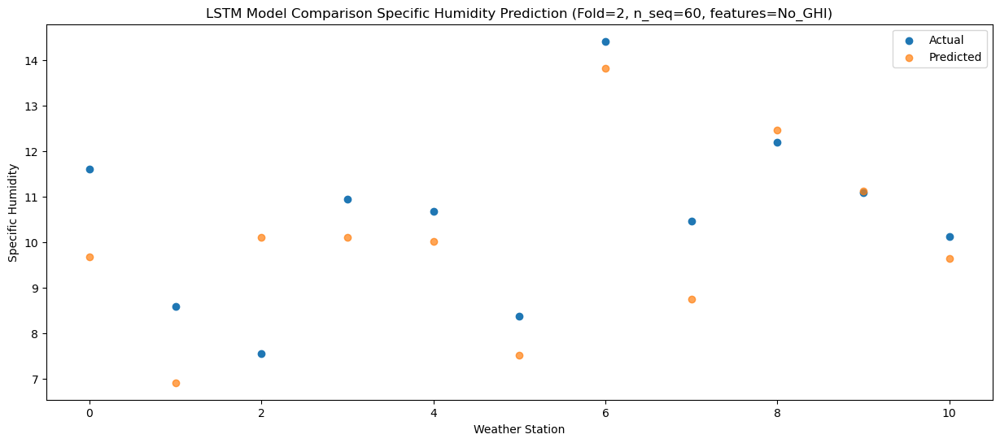

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   7.251826
1                 1    6.02   4.485749
2                 2    7.40   7.688867
3                 3    7.14   7.673489
4                 4    7.16   7.599255
5                 5    5.01   5.093466
6                 6   11.75  11.411841
7                 7    7.43   6.319582
8                 8   13.05  10.052100
9                 9    7.66   8.709112
10               10    6.65   7.224004


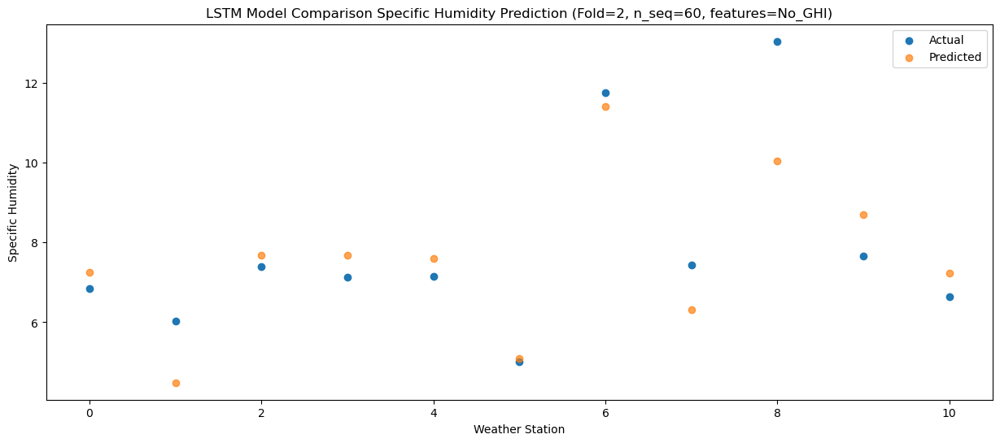

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   3.217645
1                 1    2.34   0.458698
2                 2    3.01   3.659783
3                 3    4.27   3.644403
4                 4    1.98   3.568749
5                 5    0.19   1.063995
6                 6    6.97   7.383155
7                 7    5.35   2.297006
8                 8   11.28   6.038828
9                 9    3.30   4.687719
10               10    1.99   3.195960


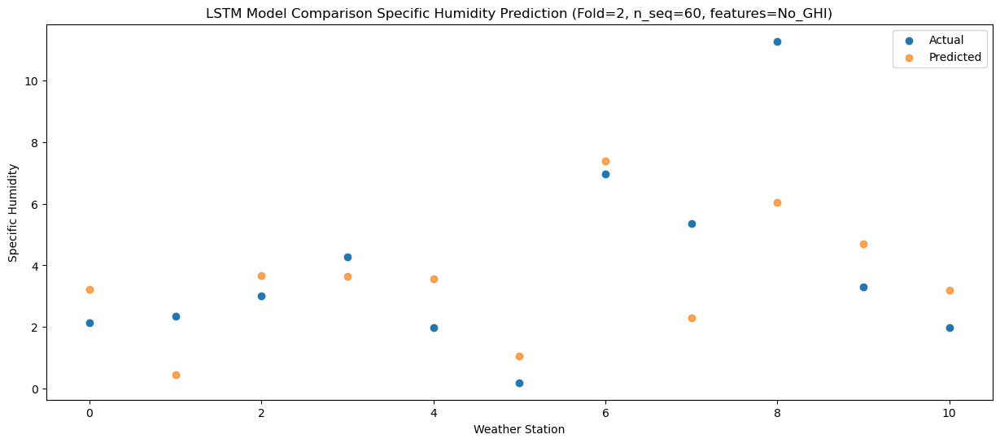

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   2.037437
1                 1    0.84  -0.722175
2                 2    2.90   2.481386
3                 3    2.45   2.467129
4                 4    1.54   2.390858
5                 5    0.05  -0.115456
6                 6    6.52   6.201581
7                 7    1.38   1.113533
8                 8    6.64   4.859213
9                 9    2.83   3.512037
10               10    1.37   2.020732


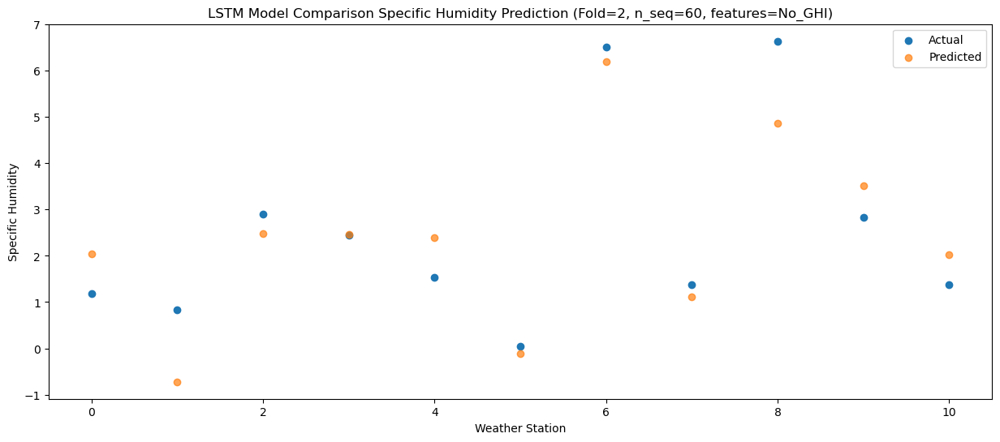

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56   0.592852
1                 1   -0.35  -2.172741
2                 2   -0.76   1.034336
3                 3    0.36   1.020153
4                 4    0.99   0.945695
5                 5   -0.86  -1.561280
6                 6    5.35   4.756527
7                 7    2.20  -0.331963
8                 8    7.49   3.411459
9                 9    0.59   2.067326
10               10    0.28   0.576760


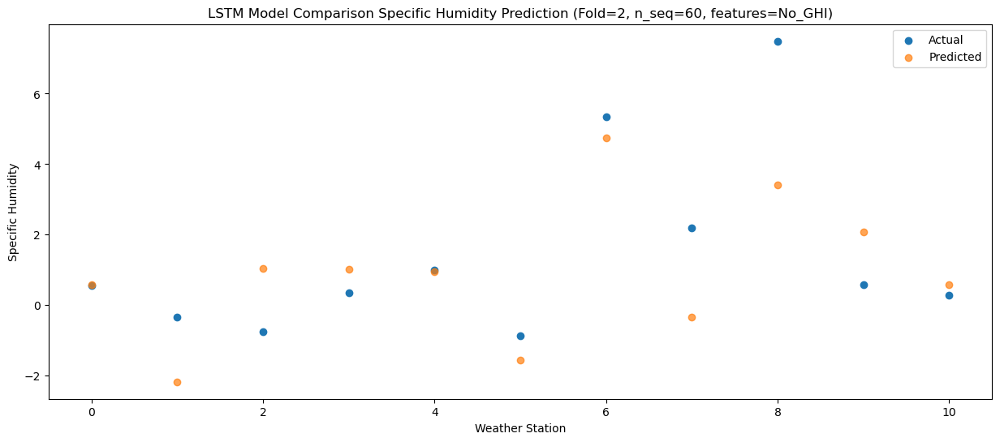

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   0.960942
1                 1   -0.36  -1.805337
2                 2   -1.14   1.402142
3                 3    0.87   1.389943
4                 4    0.90   1.312811
5                 5   -1.24  -1.194524
6                 6    4.57   5.123186
7                 7    1.31   0.033665
8                 8    7.58   3.778471
9                 9    1.45   2.433390
10               10    0.55   0.942358


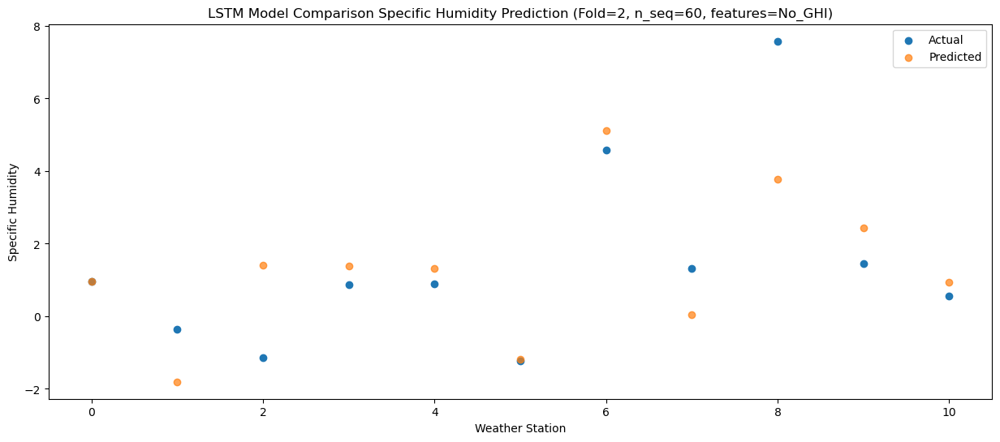

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   0.747279
1                 1   -0.44  -2.018588
2                 2    0.71   1.190067
3                 3    0.11   1.176381
4                 4    2.20   1.102871
5                 5   -0.79  -1.404395
6                 6    4.97   4.912475
7                 7    1.19  -0.175506
8                 8    6.17   3.568329
9                 9    2.21   2.222353
10               10    0.95   0.731225


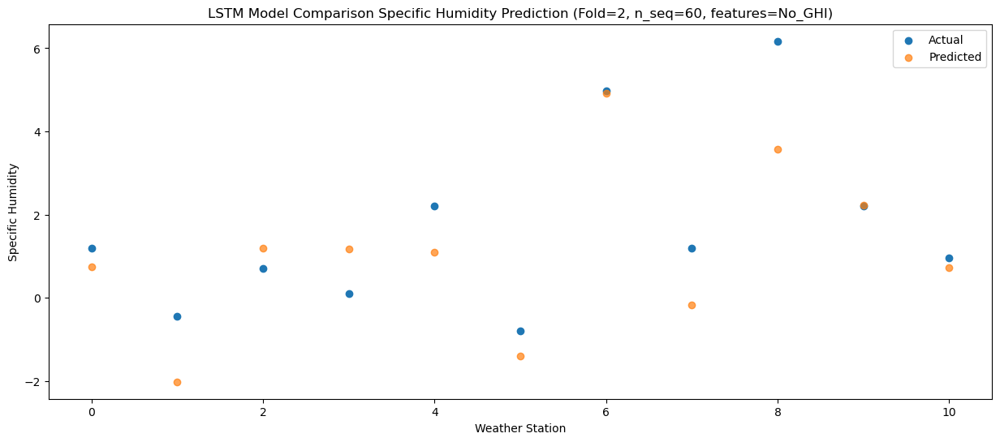

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54   1.073503
1                 1    0.25  -1.692323
2                 2    1.10   1.516310
3                 3    0.36   1.503642
4                 4    3.08   1.427501
5                 5    0.99  -1.077727
6                 6    6.88   5.241177
7                 7    1.53   0.150673
8                 8    8.09   3.895281
9                 9    1.90   2.548160
10               10    0.55   1.056473


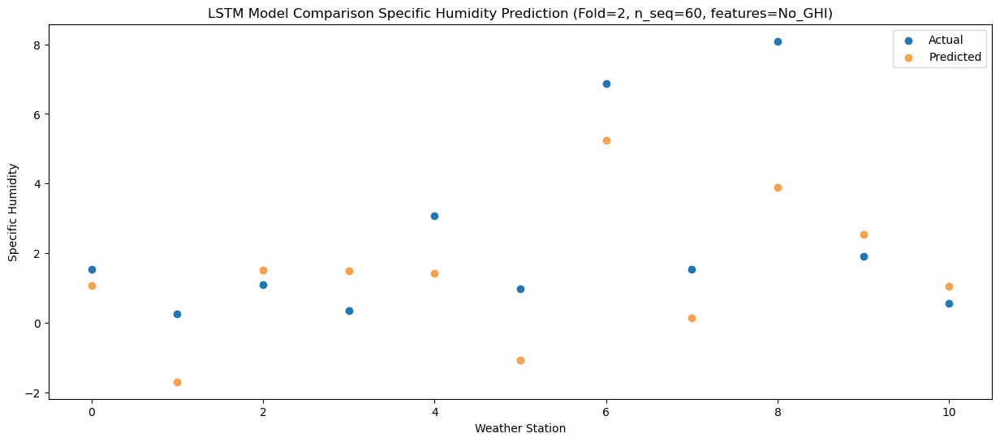

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   2.689072
1                 1    0.87  -0.078519
2                 2    2.61   3.131471
3                 3    2.44   3.118959
4                 4    3.63   3.044849
5                 5    1.54   0.538293
6                 6    7.55   6.856650
7                 7    0.69   1.765342
8                 8    8.79   5.512568
9                 9    4.03   4.163252
10               10    2.19   2.670671


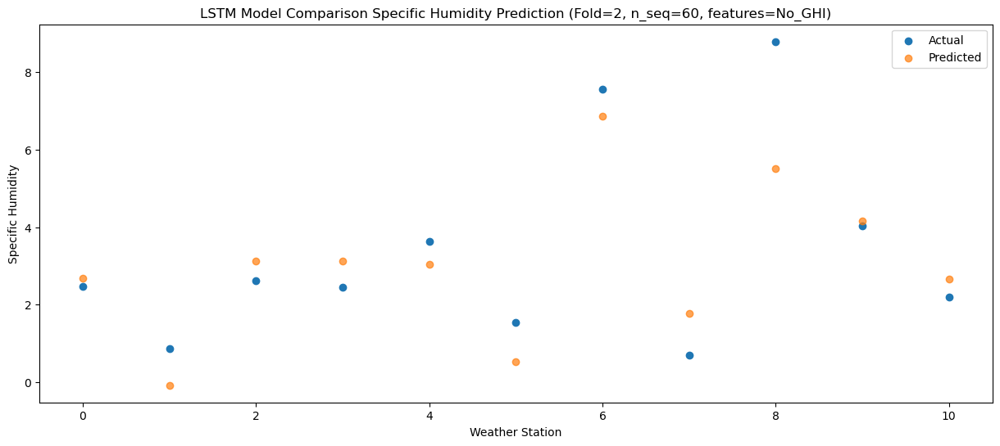

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09   4.172383
1                 1    6.65   1.406842
2                 2    3.42   4.613462
3                 3    3.25   4.597470
4                 4    6.69   4.521682
5                 5    5.24   2.017750
6                 6   11.44   8.339546
7                 7    2.69   3.248262
8                 8   10.19   6.995612
9                 9    5.56   5.639082
10               10    4.78   4.145802


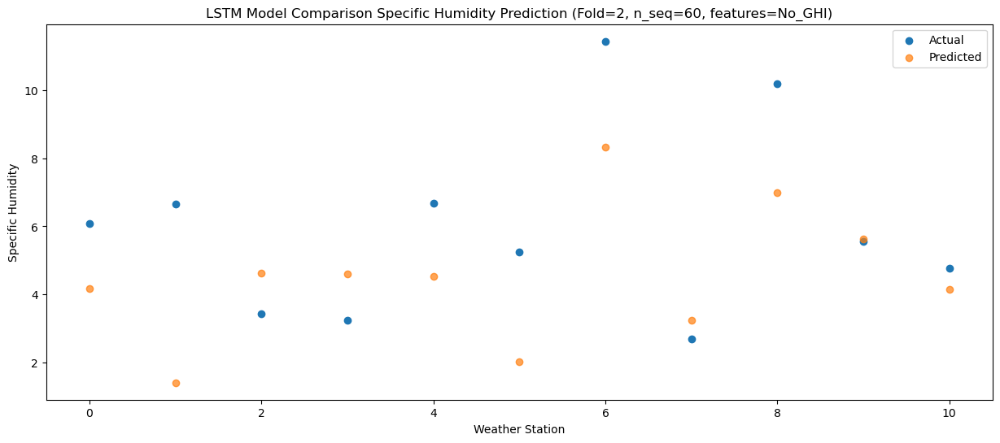

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06   7.031703
1                 1    9.30   4.264431
2                 2    6.58   7.475355
3                 3    7.15   7.456006
4                 4   10.00   7.381274
5                 5    8.70   4.878868
6                 6   15.34  11.200666
7                 7    2.49   6.108118
8                 8   10.57   9.854891
9                 9    8.42   8.499981
10               10    6.62   7.005492


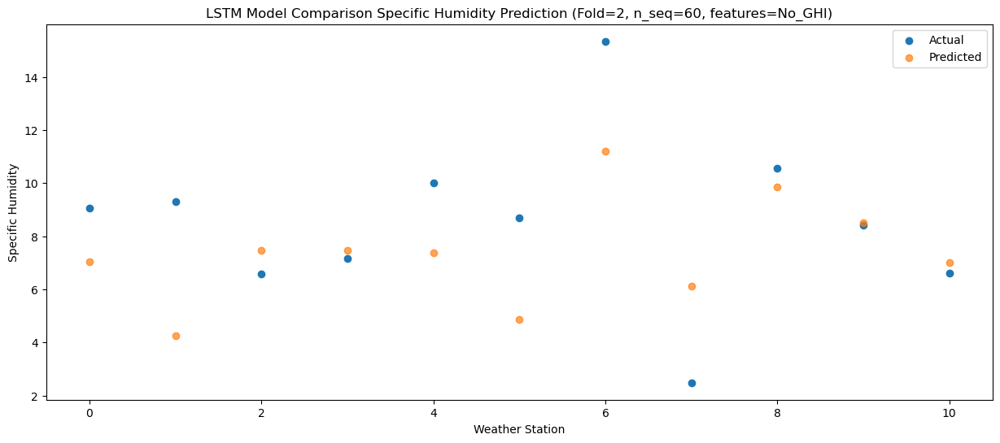

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24  10.261204
1                 1   11.36   7.485507
2                 2    7.55  10.697145
3                 3   11.41  10.678873
4                 4   11.34  10.604622
5                 5    8.41   8.102715
6                 6   14.63  14.424216
7                 7    5.84   9.327599
8                 8   11.91  13.072211
9                 9   12.26  11.721406
10               10    9.93  10.228468


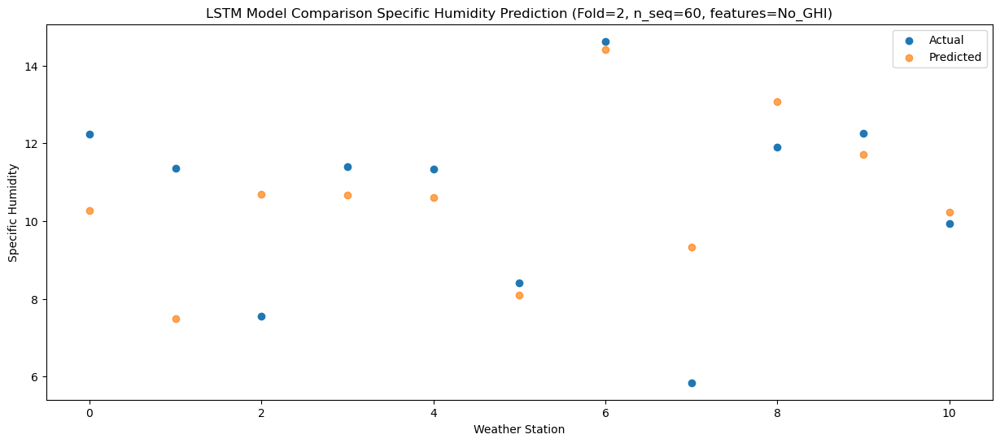

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59   9.751238
1                 1    9.47   6.974980
2                 2    8.27  10.188135
3                 3    9.07  10.169509
4                 4   11.37  10.094855
5                 5    6.98   7.593962
6                 6   12.58  13.915121
7                 7    8.03   8.823322
8                 8   12.52  12.568279
9                 9   11.77  11.215070
10               10   10.04   9.718851


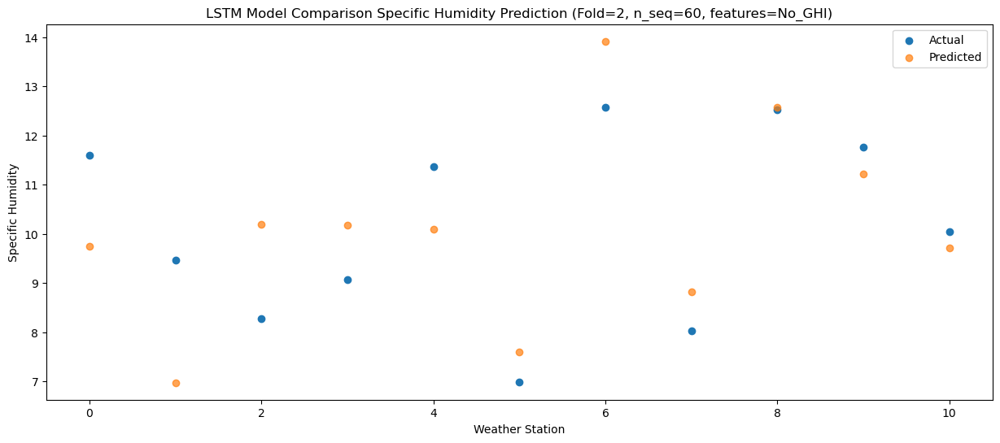

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56   7.638674
1                 1    6.88   4.859127
2                 2    5.88   8.075691
3                 3    8.06   8.058067
4                 4    9.02   7.982265
5                 5    6.43   5.479175
6                 6   11.95  11.799002
7                 7    6.22   6.707217
8                 8   12.27  10.451785
9                 9    8.63   9.100970
10               10    7.62   7.605738


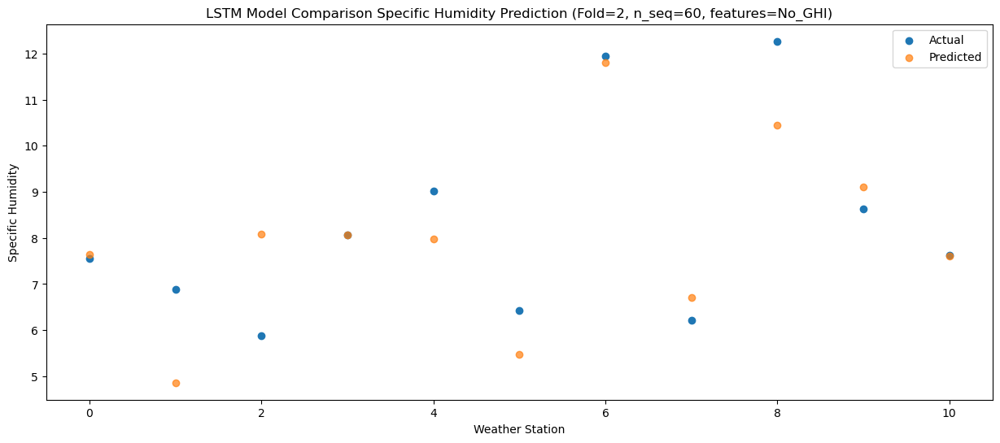

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   4.601579
1                 1    3.42   1.824282
2                 2    2.96   5.041000
3                 3    4.70   5.021355
4                 4    3.79   4.946104
5                 5    2.90   2.442930
6                 6    8.80   8.762647
7                 7    3.77   3.672314
8                 8    9.97   7.416440
9                 9    4.44   6.065842
10               10    3.51   4.569098


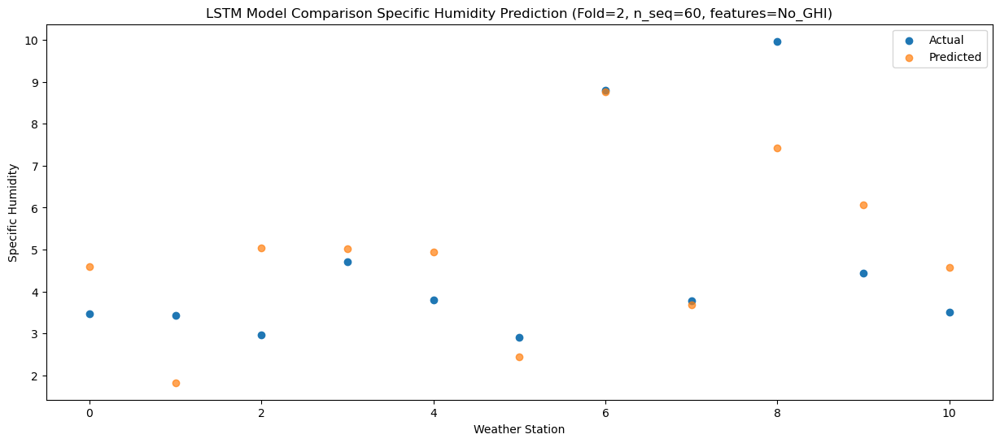

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   1.517007
1                 1    0.86  -1.260076
2                 2    0.46   1.961081
3                 3    0.87   1.939403
4                 4    1.27   1.867084
5                 5   -0.27  -0.637202
6                 6    6.18   5.680263
7                 7    2.85   0.590967
8                 8    6.94   4.336452
9                 9    1.33   2.986157
10               10    0.56   1.487902


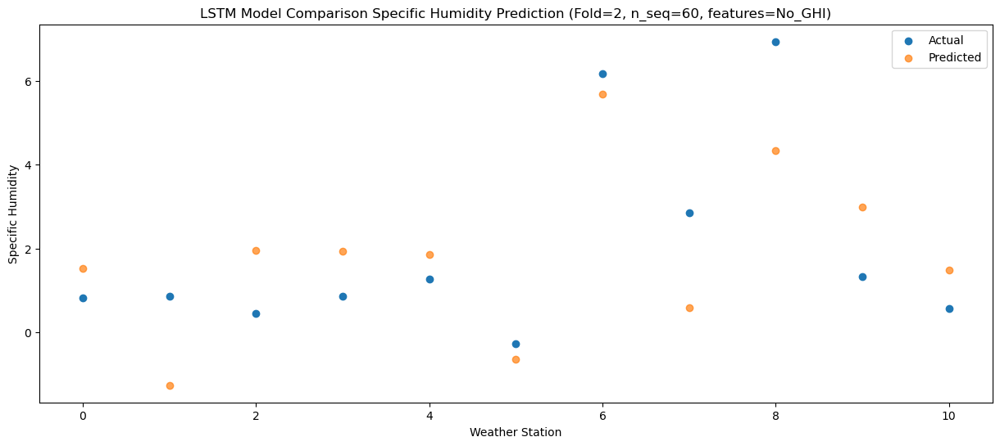

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10   1.584196
1                 1    0.47  -1.196926
2                 2   -0.11   2.023057
3                 3    1.16   2.005125
4                 4   -0.32   1.932546
5                 5   -2.20  -0.574538
6                 6    4.36   5.741694
7                 7    1.33   0.650562
8                 8    7.73   4.395194
9                 9    1.24   3.048340
10               10    0.35   1.551956


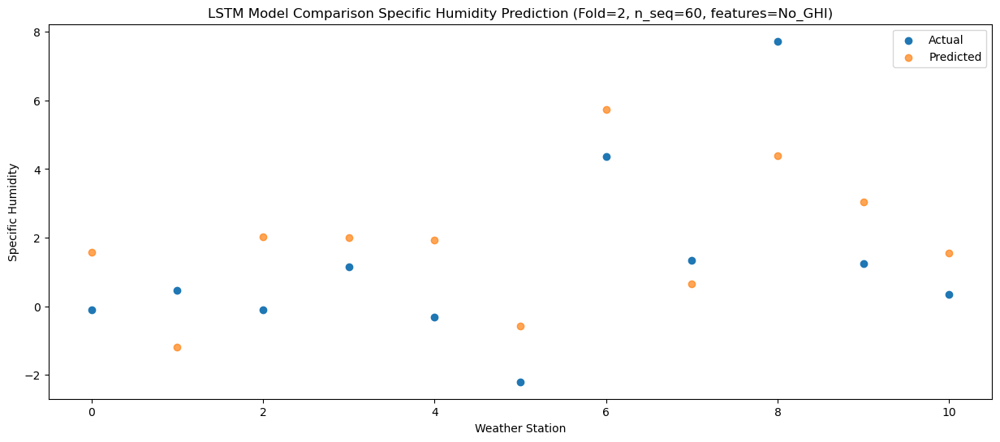

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99   0.276568
1                 1   -0.12  -2.507208
2                 2   -1.18   0.716883
3                 3   -0.17   0.695859
4                 4   -1.19   0.623913
5                 5   -3.21  -1.883653
6                 6    3.24   4.431827
7                 7    1.75  -0.661147
8                 8    7.70   3.081751
9                 9    0.55   1.735629
10               10   -0.27   0.240218


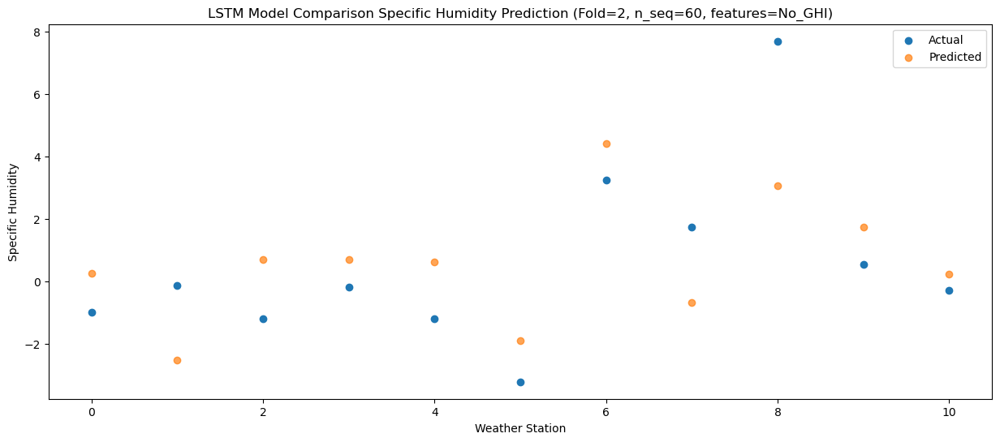

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.611214
1                 1    0.70  -2.174596
2                 2   -1.60   1.051779
3                 3   -0.22   1.028319
4                 4   -0.13   0.959185
5                 5   -0.81  -1.550789
6                 6    5.71   4.762854
7                 7    1.77  -0.334646
8                 8    8.67   3.405274
9                 9    0.69   2.063649
10               10    0.13   0.568877


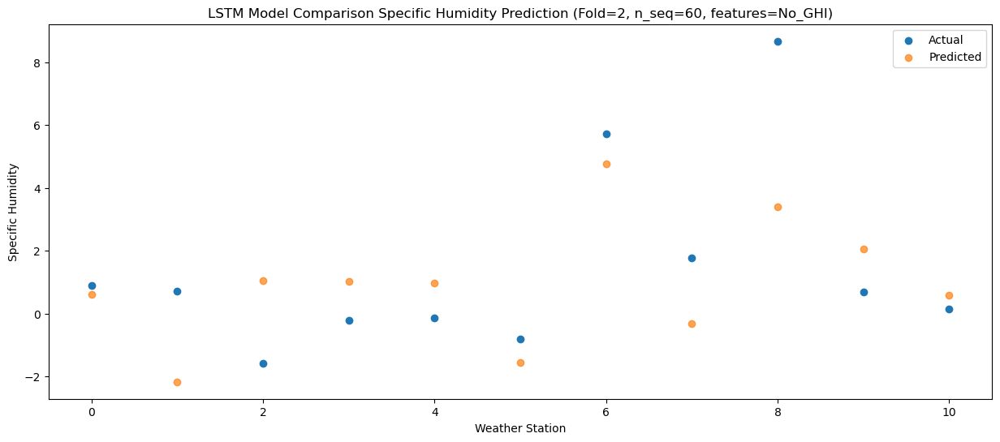

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   1.599357
1                 1    0.95  -1.192670
2                 2    1.56   2.038957
3                 3    0.83   2.013849
4                 4    1.47   1.947681
5                 5    0.83  -0.564288
6                 6    7.33   5.748293
7                 7    1.99   0.649118
8                 8    7.11   4.390397
9                 9    2.10   3.052670
10               10    1.23   1.558217


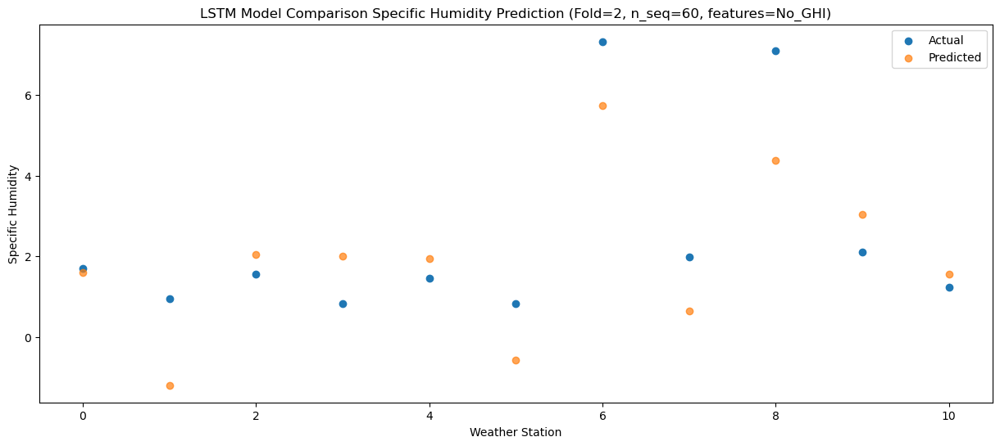

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   2.883613
1                 1    1.91   0.086297
2                 2    0.35   3.319813
3                 3    1.72   3.295879
4                 4    3.54   3.229113
5                 5    3.11   0.716054
6                 6    9.53   7.028397
7                 7    1.32   1.921801
8                 8    6.21   5.657595
9                 9    4.32   4.326867
10               10    3.34   2.836606


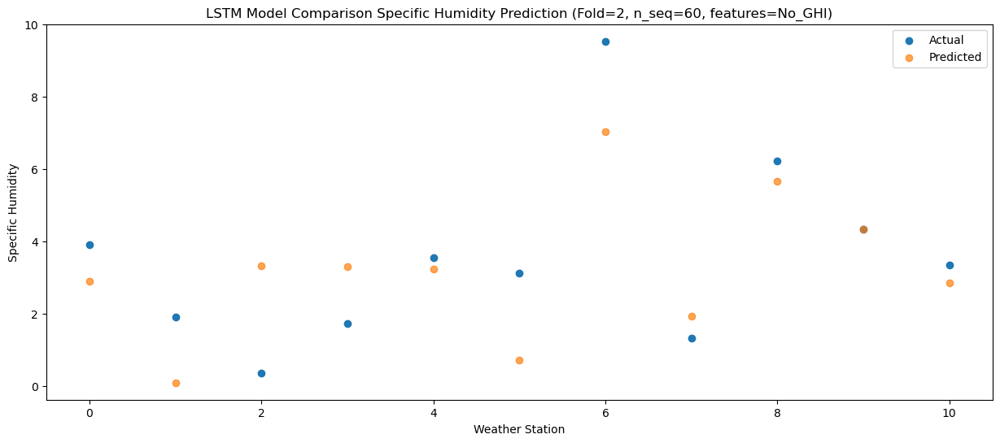

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17   6.125147
1                 1    4.94   3.321934
2                 2    5.21   6.562401
3                 3    4.90   6.536138
4                 4    7.97   6.470960
5                 5    7.21   3.957456
6                 6   13.31  10.269628
7                 7    1.01   5.160933
8                 8   10.31   8.896295
9                 9    8.20   7.569515
10               10    7.20   6.078705


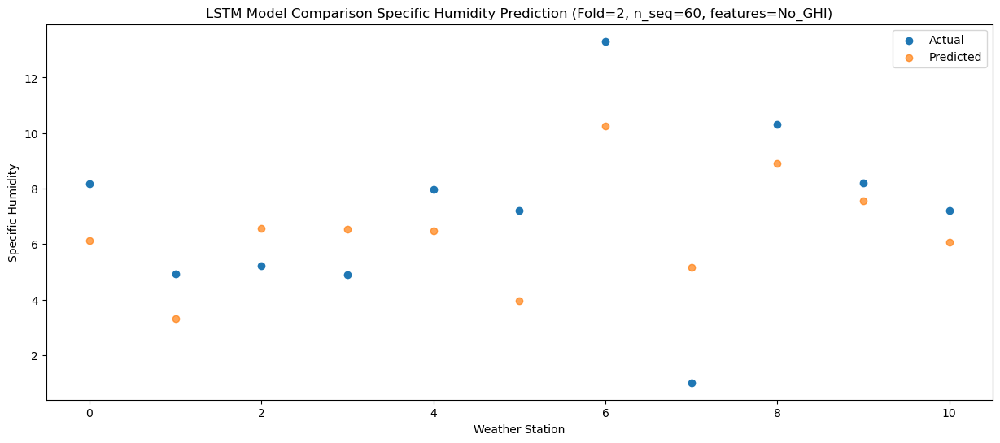

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   8.433351
1                 1   10.95   5.626213
2                 2    7.27   8.867468
3                 3    7.82   8.840616
4                 4    9.94   8.775876
5                 5    8.87   6.261312
6                 6   14.90  12.572434
7                 7    5.06   7.463080
8                 8   11.91  11.195047
9                 9   10.07   9.871209
10               10    8.75   8.382693


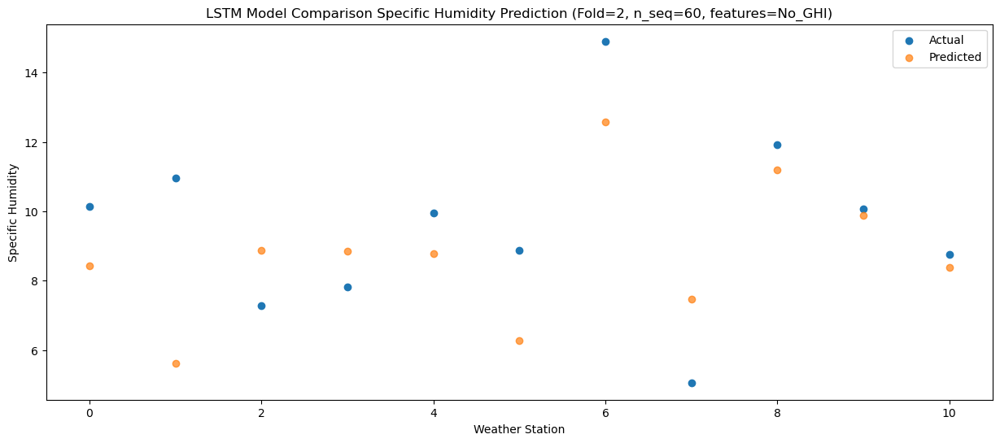

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61  10.086005
1                 1    9.50   7.275156
2                 2    8.32  10.518565
3                 3   10.99  10.493281
4                 4   11.58  10.426625
5                 5    9.17   7.908997
6                 6   15.13  14.217911
7                 7    8.66   9.105429
8                 8   13.14  12.834080
9                 9   12.68  11.516302
10               10   10.79  10.029526


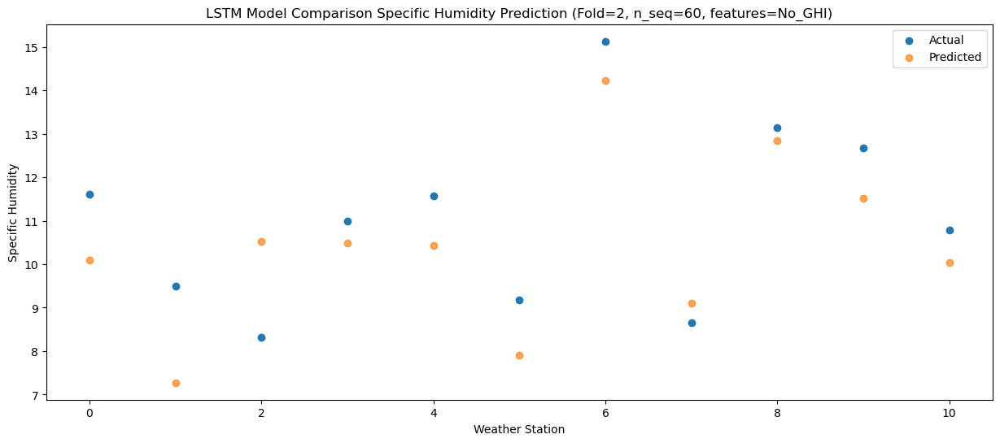

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61   9.718297
1                 1   10.48   6.903442
2                 2    8.92  10.143606
3                 3    9.49  10.119440
4                 4   10.41  10.050570
5                 5    9.21   7.532993
6                 6   14.95  13.843285
7                 7    8.34   8.725615
8                 8   12.32  12.448655
9                 9   11.42  11.135119
10               10    9.78   9.651700


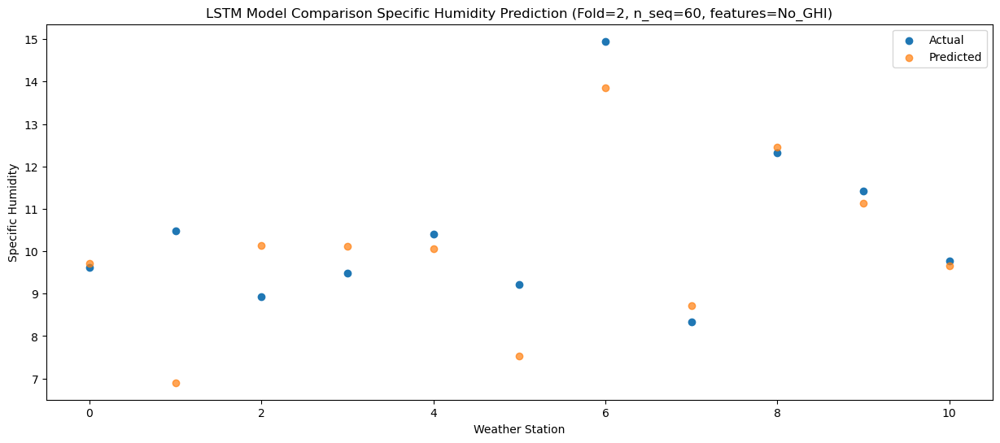

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99   7.400995
1                 1    6.53   4.582976
2                 2    9.35   7.829481
3                 3    6.60   7.802672
4                 4    8.81   7.735739
5                 5    6.72   5.217635
6                 6   12.05  11.527224
7                 7    5.60   6.407005
8                 8   11.93  10.132038
9                 9    9.57   8.818062
10               10    7.68   7.335670


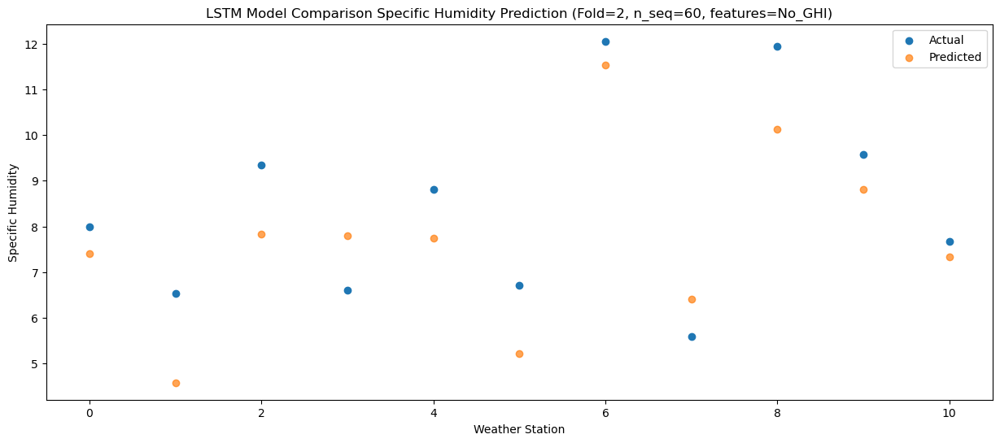

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61   3.756406
1                 1    3.67   0.941783
2                 2    4.37   4.186943
3                 3    3.36   4.159920
4                 4    3.95   4.091796
5                 5    2.40   1.575739
6                 6    8.63   7.887186
7                 7    2.71   2.770260
8                 8   10.03   6.496986
9                 9    4.95   5.178962
10               10    3.61   3.695339


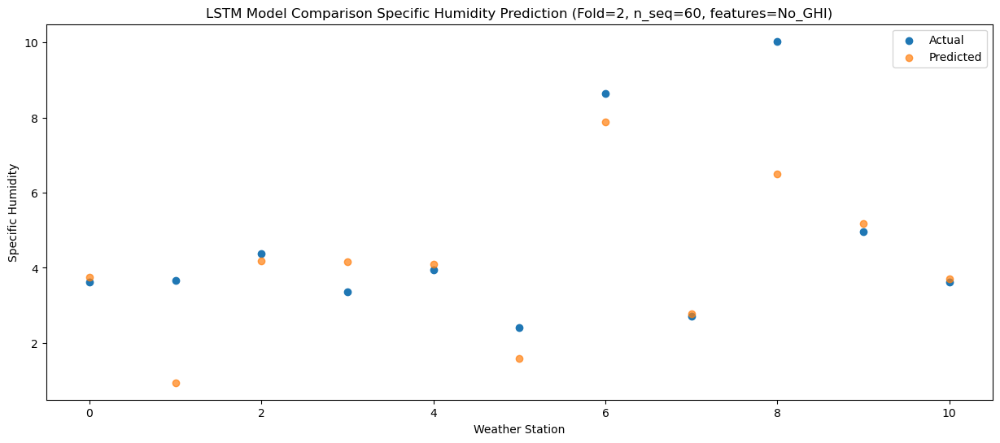

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (1, 1, 1024)              11632640  
                                                                 
 dropout_4 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_5 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_5 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_6 (Dense)             (1, 256)                  262400    
                                                                 
 dense_7 (Dense)             (1, 128)                  32896     
                                                                 
 dense_8 (Dense)             (1, 60)                  

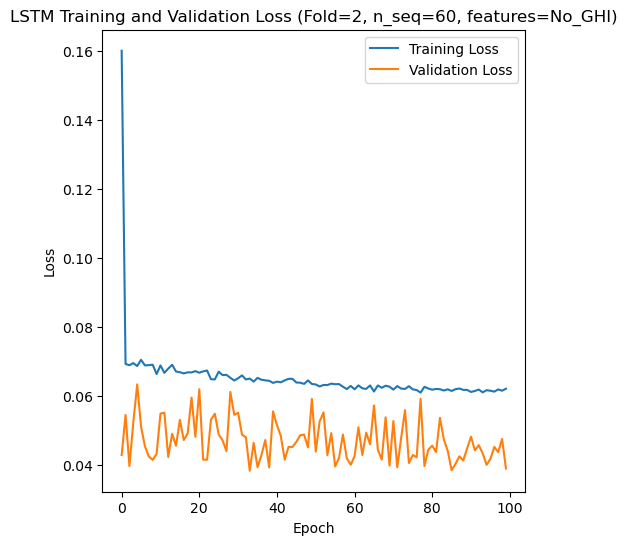

Epoch 1/100
84/84 [==============================] - 9s 62ms/step - loss: 0.1458 - accuracy: 0.2857 - mae: 0.1192 - rmse: 0.1458 - mape: 26.5261 - pearson: 0.6229 - val_loss: 0.0705 - val_accuracy: 0.6000 - val_mae: 0.0553 - val_rmse: 0.0705 - val_mape: 11.7607 - val_pearson: 0.7357
Epoch 2/100
84/84 [==============================] - 4s 43ms/step - loss: 0.0681 - accuracy: 0.3810 - mae: 0.0533 - rmse: 0.0681 - mape: 12.1916 - pearson: 0.7822 - val_loss: 0.0639 - val_accuracy: 0.6000 - val_mae: 0.0496 - val_rmse: 0.0639 - val_mape: 10.6996 - val_pearson: 0.7328
Epoch 3/100
84/84 [==============================] - 4s 44ms/step - loss: 0.0674 - accuracy: 0.3690 - mae: 0.0530 - rmse: 0.0674 - mape: 12.0768 - pearson: 0.7836 - val_loss: 0.0630 - val_accuracy: 0.6000 - val_mae: 0.0485 - val_rmse: 0.0630 - val_mape: 10.3584 - val_pearson: 0.7213
Epoch 4/100
84/84 [==============================] - 3s 40ms/step - loss: 0.0678 - accuracy: 0.4405 - mae: 0.0530 - rmse: 0.0678 - mape: 12.1357 - p

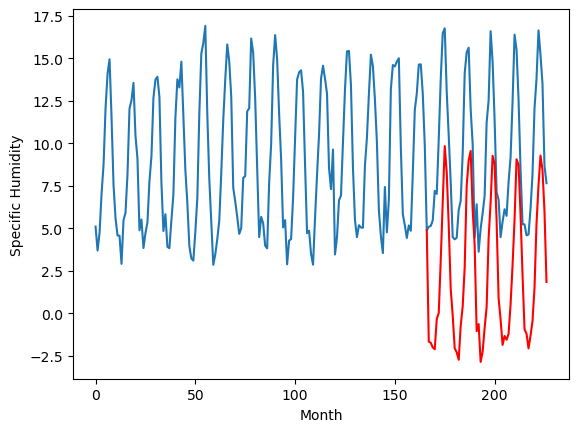

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		-0.61		-0.47
-0.55		-0.69		-0.14
-0.58		-0.96		-0.38
-0.94		-1.07		-0.13
1.66		0.71		-0.95
1.81		1.06		-0.75
4.78		4.18		-0.60
8.31		7.58		-0.73
11.05		10.88		-0.17
8.38		9.34		0.96
6.94		6.24		-0.70
2.37		2.49		0.12
0.87		0.92		0.05
-1.17		-1.01		0.16
-1.26		-1.25		0.01
-1.82		-1.69		0.13
0.69		0.31		-0.38
1.86		1.45		-0.41
5.38		3.74		-1.64
9.91		8.52		-1.39
10.79		10.04		-0.75
10.96		10.59		-0.37
6.99		7.13		0.14
4.80		5.07		0.27
0.37		0.00		-0.37
1.34		0.41		-0.93
-1.85		-1.81		0.04
-1.48		-1.21		0.27
-0.01		0.20		0.21
2.29		1.42		-0.87
6.74		5.49		-1.25
9.36		7.58		-1.78
9.57		10.32		0.75
10.18		9.83		-0.35
6.33		6.50		0.17
1.87		1.95		0.08
0.84		0.69		-0.15
-0.35		-0.80		-0.45
-0.43		-0.27		0.16
-0.27		-0.50		-0.23
0.67		-0.15		-0.82
1.54		1.57		0.03
5.95		3.90		-2.05
8.59		6.58		-2.01
10.86		10.12		-0.74
11.10		9.78		-1.32
7.03		6.86		-0.17
3.59		3.31		-0.28
0.71		0.11		-0.60
-0

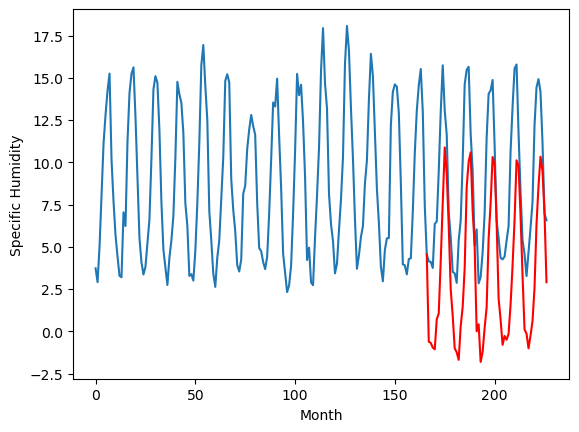

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		2.59		-3.40
6.53		2.51		-4.02
6.15		2.24		-3.91
5.46		2.14		-3.32
6.54		3.92		-2.62
7.91		4.27		-3.64
7.72		7.38		-0.34
9.26		10.78		1.52
9.48		14.07		4.59
11.00		12.53		1.53
10.52		9.43		-1.09
8.64		5.68		-2.96
5.95		4.11		-1.84
5.35		2.18		-3.17
5.79		1.94		-3.85
5.73		1.51		-4.22
5.81		3.50		-2.31
6.43		4.63		-1.80
6.83		6.92		0.09
9.28		11.71		2.43
9.98		13.23		3.25
9.51		13.77		4.26
8.22		10.31		2.09
7.08		8.25		1.17
7.66		3.18		-4.48
6.16		3.59		-2.57
5.88		1.37		-4.51
5.10		1.97		-3.13
6.44		3.38		-3.06
6.11		4.59		-1.52
6.29		8.66		2.37
7.46		10.75		3.29
8.63		13.49		4.86
9.42		13.01		3.59
9.13		9.67		0.54
7.96		5.13		-2.83
5.24		3.86		-1.38
6.08		2.37		-3.71
6.23		2.89		-3.34
5.10		2.67		-2.43
6.62		3.02		-3.60
6.82		4.74		-2.08
7.76		7.07		-0.69
8.53		9.75		1.22
9.63		13.28		3.65
10.70		12.94		2.24
9.16		10.03		0.87
8.00		6.48		-1.52
5.89		3.28		-2.61
6.12		3.03		-3.09
6.66		2

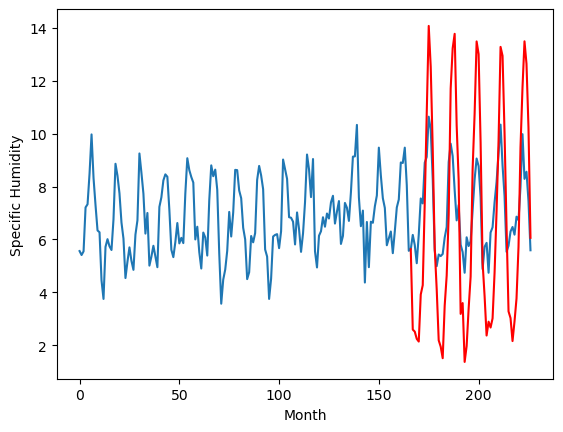

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		0.37		1.20
-0.30		0.29		0.59
-0.70		0.02		0.72
-0.88		-0.08		0.80
0.98		1.69		0.71
0.90		2.05		1.15
4.33		5.16		0.83
7.57		8.57		1.00
10.67		11.87		1.20
9.59		10.33		0.74
7.02		7.22		0.20
3.33		3.48		0.15
0.44		1.90		1.46
-1.17		-0.02		1.15
-1.44		-0.26		1.18
-1.51		-0.70		0.81
-0.21		1.30		1.51
0.98		2.43		1.45
3.51		4.73		1.22
8.93		9.51		0.58
9.56		11.03		1.47
10.44		11.58		1.14
6.97		8.12		1.15
4.91		6.06		1.15
-0.78		0.99		1.77
0.36		1.40		1.04
-1.96		-0.82		1.14
-1.44		-0.22		1.22
-0.46		1.19		1.65
0.81		2.40		1.59
5.23		6.47		1.24
7.49		8.57		1.08
10.53		11.30		0.77
9.40		10.82		1.42
6.15		7.49		1.34
1.00		2.94		1.94
0.19		1.68		1.49
-0.84		0.19		1.03
-0.30		0.71		1.01
-0.48		0.49		0.97
-0.61		0.84		1.45
0.93		2.56		1.63
3.84		4.88		1.04
5.86		7.57		1.71
9.51		11.11		1.60
8.96		10.77		1.81
6.49		7.85		1.36
2.96		4.30		1.34
-0.43		1.10		1.53
-0.41		0.85		1.26
-1.15		-0.02		1.13
-

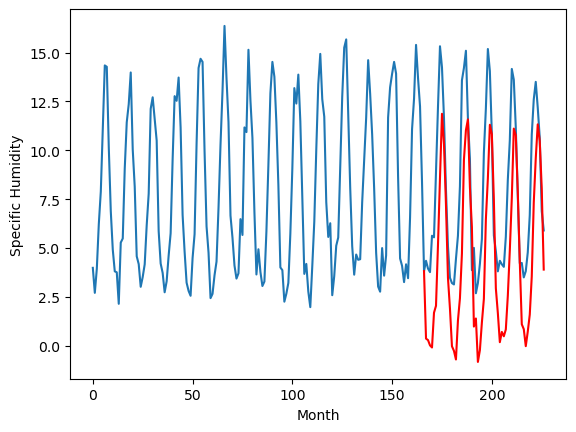

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		1.77		-1.84
2.11		1.69		-0.42
-0.18		1.42		1.60
-0.94		1.31		2.25
1.13		3.09		1.96
1.45		3.44		1.99
5.15		6.56		1.41
8.24		9.97		1.73
12.19		13.27		1.08
9.81		11.72		1.91
6.85		8.62		1.77
2.13		4.87		2.74
1.03		3.30		2.27
-0.90		1.38		2.28
-1.10		1.14		2.24
-1.93		0.70		2.63
0.55		2.69		2.14
1.61		3.83		2.22
4.03		6.12		2.09
8.49		10.91		2.42
10.44		12.43		1.99
10.53		12.98		2.45
6.76		9.51		2.75
4.81		7.45		2.64
-0.31		2.38		2.69
0.39		2.79		2.40
-2.07		0.57		2.64
-1.45		1.17		2.62
0.12		2.58		2.46
1.68		3.80		2.12
5.77		7.87		2.10
7.87		9.96		2.09
10.46		12.70		2.24
9.96		12.22		2.26
6.86		8.88		2.02
1.86		4.34		2.48
0.47		3.08		2.61
-0.65		1.59		2.24
-0.27		2.11		2.38
0.61		1.89		1.28
0.28		2.24		1.96
1.51		3.96		2.45
4.69		6.29		1.60
6.82		8.97		2.15
10.59		12.51		1.92
10.98		12.17		1.19
6.87		9.25		2.38
3.25		5.70		2.45
0.08		2.50		2.42
-0.33		2.25		2.58
-1.20		1.38		2.58
-0.29		2.

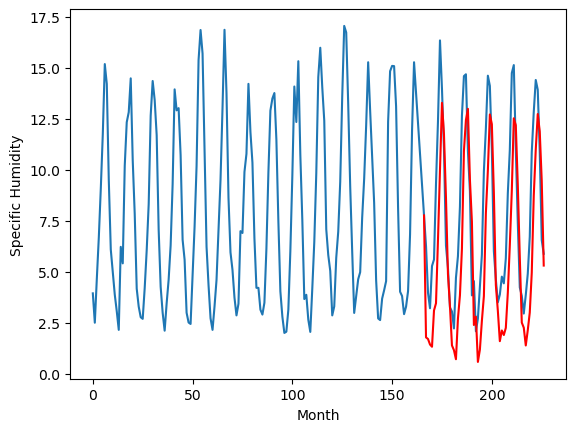

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		0.39		0.15
0.53		0.31		-0.22
0.03		0.04		0.01
-0.22		-0.07		0.15
1.77		1.71		-0.06
1.89		2.06		0.17
5.10		5.18		0.08
7.83		8.59		0.76
10.99		11.89		0.90
9.77		10.35		0.58
6.59		7.25		0.66
3.17		3.49		0.32
1.40		1.92		0.52
-0.26		-0.00		0.26
-0.57		-0.23		0.34
-1.09		-0.68		0.41
0.94		1.32		0.38
2.24		2.46		0.22
4.48		4.75		0.27
9.70		9.53		-0.17
10.95		11.06		0.11
11.12		11.60		0.48
7.82		8.14		0.32
6.20		6.08		-0.12
0.33		1.00		0.67
1.38		1.41		0.03
-1.13		-0.80		0.33
-0.60		-0.21		0.39
0.71		1.21		0.50
2.24		2.42		0.18
6.47		6.50		0.03
8.54		8.59		0.05
11.32		11.33		0.01
10.12		10.85		0.73
7.35		7.51		0.16
2.05		2.97		0.92
0.83		1.70		0.87
0.07		0.21		0.14
0.65		0.74		0.09
0.32		0.52		0.20
0.75		0.87		0.12
2.06		2.59		0.53
4.66		4.92		0.26
6.82		7.60		0.78
11.33		11.14		-0.19
10.45		10.81		0.36
7.22		7.88		0.66
3.84		4.33		0.49
0.65		1.13		0.48
0.61		0.87		0.26
-0.27		0.00		0.27
0.31	

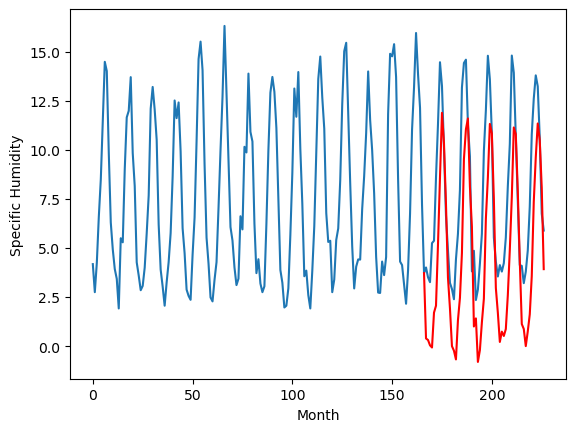

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		2.22		-3.94
5.79		2.14		-3.65
5.75		1.87		-3.88
5.71		1.76		-3.95
6.34		3.54		-2.80
6.69		3.89		-2.80
7.82		7.01		-0.81
8.88		10.41		1.53
10.40		13.71		3.31
9.19		12.16		2.97
8.05		9.06		1.01
6.40		5.31		-1.09
6.34		3.74		-2.60
5.53		1.82		-3.71
5.70		1.58		-4.12
5.76		1.14		-4.62
6.07		3.13		-2.94
6.54		4.27		-2.27
7.94		6.56		-1.38
9.27		11.34		2.07
11.72		12.87		1.15
10.29		13.41		3.12
8.59		9.95		1.36
7.50		7.89		0.39
6.79		2.82		-3.97
6.08		3.24		-2.84
5.60		1.01		-4.59
5.39		1.61		-3.78
6.07		3.03		-3.04
6.57		4.24		-2.33
7.38		8.30		0.92
9.32		10.40		1.08
12.31		13.13		0.82
12.15		12.65		0.50
9.20		9.32		0.12
7.59		4.78		-2.81
5.93		3.51		-2.42
5.96		2.02		-3.94
5.93		2.54		-3.39
5.55		2.32		-3.23
5.85		2.67		-3.18
6.48		4.39		-2.09
8.64		6.72		-1.92
8.87		9.40		0.53
9.71		12.94		3.23
11.36		12.60		1.24
8.74		9.68		0.94
7.49		6.12		-1.37
6.16		2.92		-3.24
6.03		2.67		-3.36
5.97		

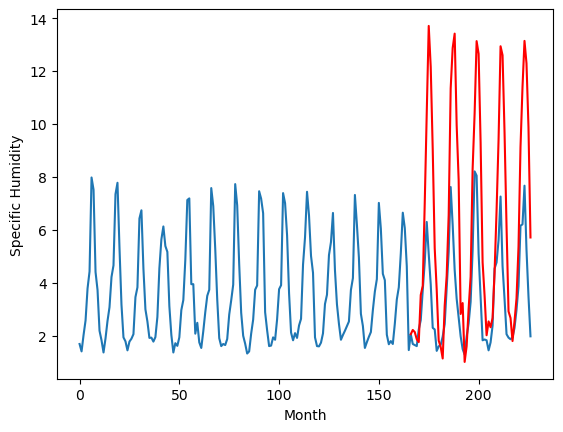

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		0.65		-4.34
5.98		0.57		-5.41
4.86		0.30		-4.56
4.44		0.19		-4.25
6.18		1.97		-4.21
5.99		2.32		-3.67
5.29		5.44		0.15
5.62		8.83		3.21
6.10		12.13		6.03
6.97		10.58		3.61
5.71		7.48		1.77
4.70		3.74		-0.96
4.68		2.16		-2.52
3.85		0.24		-3.61
4.66		0.00		-4.66
4.18		-0.43		-4.61
4.48		1.56		-2.92
4.17		2.70		-1.47
4.73		4.99		0.26
6.15		9.77		3.62
11.51		11.29		-0.22
9.08		11.84		2.76
7.36		8.37		1.01
6.26		6.31		0.05
4.99		1.25		-3.74
5.13		1.66		-3.47
4.14		-0.57		-4.71
3.71		0.03		-3.68
4.33		1.45		-2.88
4.33		2.66		-1.67
4.59		6.72		2.13
6.35		8.82		2.47
9.78		11.55		1.77
12.85		11.08		-1.77
8.94		7.74		-1.20
6.21		3.20		-3.01
4.44		1.93		-2.51
5.19		0.44		-4.75
5.58		0.96		-4.62
4.33		0.74		-3.59
5.37		1.09		-4.28
4.52		2.81		-1.71
6.06		5.15		-0.91
6.56		7.82		1.26
7.53		11.36		3.83
10.11		11.02		0.91
9.17		8.10		-1.07
6.11		4.55		-1.56
5.10		1.35		-3.75
5.02		1.10		-3.92
5.56		0.

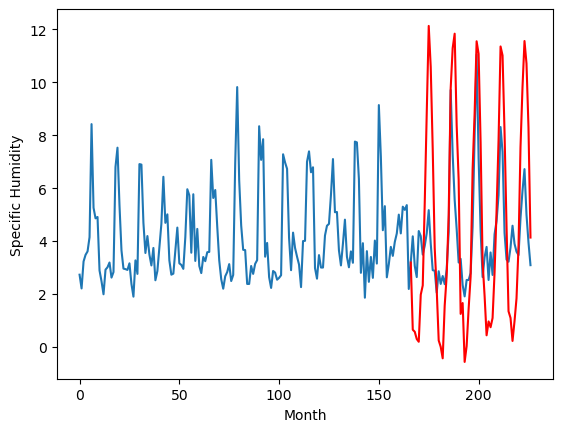

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		0.59		-3.94
5.76		0.51		-5.25
5.08		0.24		-4.84
4.19		0.14		-4.05
4.67		1.92		-2.75
5.73		2.27		-3.46
6.59		5.38		-1.21
6.81		8.77		1.96
7.28		12.07		4.79
8.08		10.52		2.44
7.69		7.42		-0.27
5.49		3.67		-1.82
4.33		2.10		-2.23
3.99		0.17		-3.82
4.66		-0.06		-4.72
4.31		-0.50		-4.81
3.96		1.49		-2.47
4.89		2.63		-2.26
5.33		4.92		-0.41
6.76		9.70		2.94
7.24		11.22		3.98
7.63		11.76		4.13
6.99		8.30		1.31
5.96		6.24		0.28
6.18		1.18		-5.00
4.93		1.59		-3.34
4.60		-0.64		-5.24
3.76		-0.05		-3.81
4.76		1.37		-3.39
4.86		2.57		-2.29
5.23		6.64		1.41
6.72		8.73		2.01
7.55		11.46		3.91
8.01		10.98		2.97
7.41		7.65		0.24
6.10		3.11		-2.99
3.85		1.83		-2.02
4.64		0.34		-4.30
4.47		0.87		-3.60
3.61		0.64		-2.97
4.41		0.99		-3.42
4.79		2.71		-2.08
6.38		5.04		-1.34
6.44		7.72		1.28
7.28		11.25		3.97
8.55		10.91		2.36
8.00		8.00		-0.00
6.57		4.44		-2.13
5.48		1.24		-4.24
5.86		0.99		-4.87
5.87		0.1

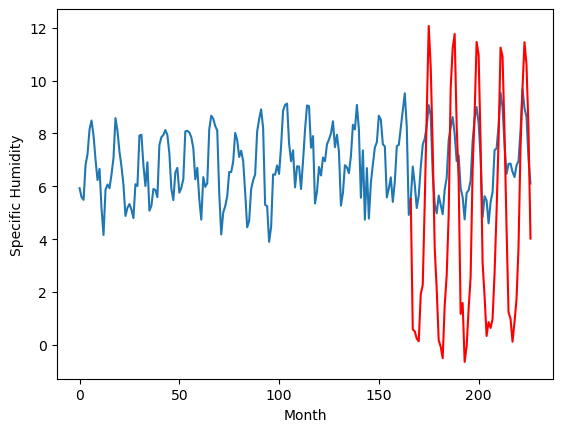

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		0.84		0.34
0.14		0.77		0.63
-0.14		0.50		0.64
-0.06		0.39		0.45
0.43		2.17		1.74
0.93		2.52		1.59
3.16		5.64		2.48
7.27		9.04		1.77
11.25		12.33		1.08
10.18		10.79		0.61
6.81		7.69		0.88
4.28		3.94		-0.34
2.12		2.37		0.25
0.16		0.44		0.28
-0.93		0.21		1.14
-0.78		-0.23		0.55
0.00		1.76		1.76
1.38		2.90		1.52
2.95		5.19		2.24
7.85		9.98		2.13
10.06		11.49		1.43
10.44		12.04		1.60
7.84		8.58		0.74
5.30		6.52		1.22
0.77		1.45		0.68
0.47		1.86		1.39
-1.01		-0.36		0.65
-0.42		0.23		0.65
0.42		1.65		1.23
1.07		2.86		1.79
4.46		6.93		2.47
6.80		9.02		2.22
9.96		11.76		1.80
10.10		11.28		1.18
6.43		7.94		1.51
3.80		3.40		-0.40
1.95		2.13		0.18
-0.02		0.64		0.66
0.55		1.17		0.62
-0.16		0.94		1.10
0.05		1.29		1.24
2.29		3.01		0.72
2.81		5.34		2.53
6.51		8.02		1.51
11.36		11.56		0.20
8.79		11.22		2.43
7.82		8.30		0.48
4.43		4.75		0.32
0.63		1.55		0.92
0.96		1.31		0.35
-0.34		0.44		0.78
-0.44		1.1

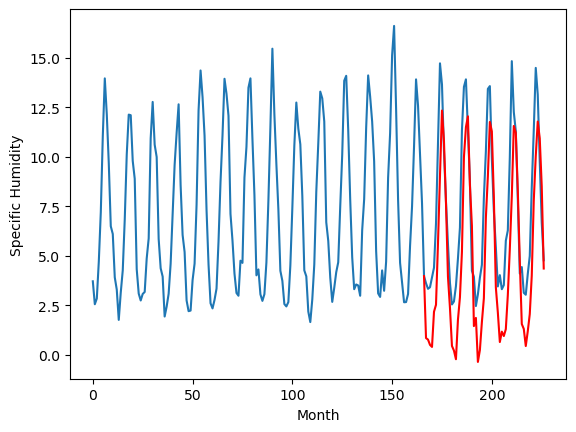

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-1.65		0.91
-2.68		-1.72		0.96
-2.76		-1.99		0.77
-2.77		-2.10		0.67
-1.81		-0.32		1.49
-1.38		0.03		1.41
1.15		3.15		2.00
4.72		6.55		1.83
8.07		9.85		1.78
7.43		8.30		0.87
4.14		5.20		1.06
1.37		1.45		0.08
-0.96		-0.13		0.83
-2.81		-2.05		0.76
-3.50		-2.28		1.22
-3.64		-2.72		0.92
-2.36		-0.73		1.63
-0.95		0.41		1.36
0.64		2.70		2.06
5.51		7.49		1.98
7.20		9.00		1.80
7.52		9.55		2.03
4.60		6.09		1.49
2.70		4.02		1.32
-2.22		-1.05		1.17
-2.32		-0.64		1.68
-3.83		-2.86		0.97
-3.13		-2.26		0.87
-2.19		-0.85		1.34
-1.55		0.36		1.91
2.63		4.43		1.80
4.03		6.52		2.49
7.01		9.26		2.25
6.64		8.78		2.14
3.62		5.45		1.83
0.20		0.91		0.71
-1.02		-0.36		0.66
-2.94		-1.85		1.09
-2.16		-1.32		0.84
-2.91		-1.55		1.36
-2.78		-1.19		1.59
-0.35		0.53		0.88
0.12		2.85		2.73
3.81		5.53		1.72
7.79		9.07		1.28
6.55		8.73		2.18
4.86		5.81		0.95
1.59		2.26		0.67
-2.09		-0.93		1.16
-1.71		-1.18		0.53
-2.84	

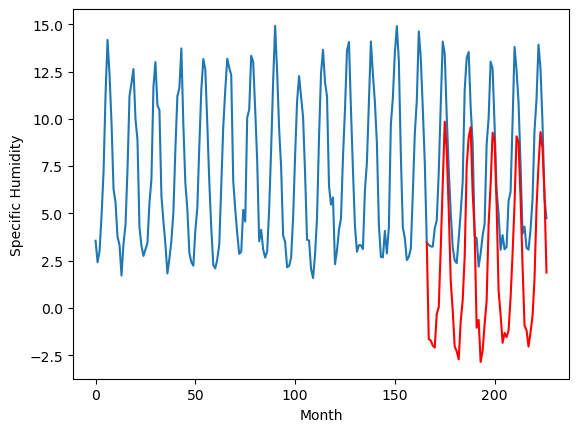

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-1.6514649963378907, -0.6093173217773438, 2.592593603134155, 0.3696593856811523, 1.770239934921265, 0.389245491027832, 2.219816980361938, 0.6517844104766848, 0.590228729248047, 0.840440921783447, -1.6504672145843506]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -1.651465
1                 1   -0.14  -0.609317
2                 2    5.99   2.592594
3                 3   -0.83   0.369659
4                 4    3.61   1.770240
5                 5    0.24   0.389245
6                 6    6.16   2.219817
7                 7    4.99   0.651784
8                 8    4.53   0.590229
9                 9    0.50   0.840441
10               10   -2.56  -1.650467


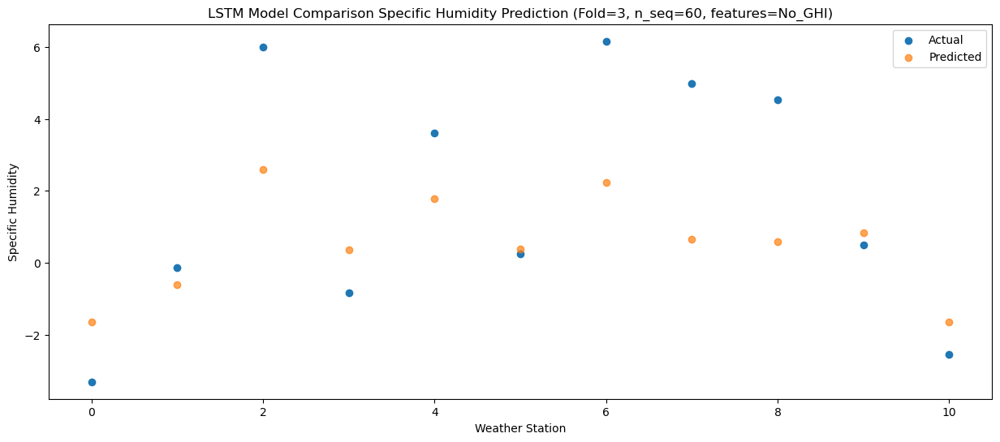

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -1.724776
1                 1   -0.55  -0.686408
2                 2    6.53   2.513475
3                 3   -0.30   0.294906
4                 4    2.11   1.693459
5                 5    0.53   0.313216
6                 6    5.79   2.140363
7                 7    5.98   0.571701
8                 8    5.76   0.512598
9                 9    0.14   0.765215
10               10   -2.68  -1.724698


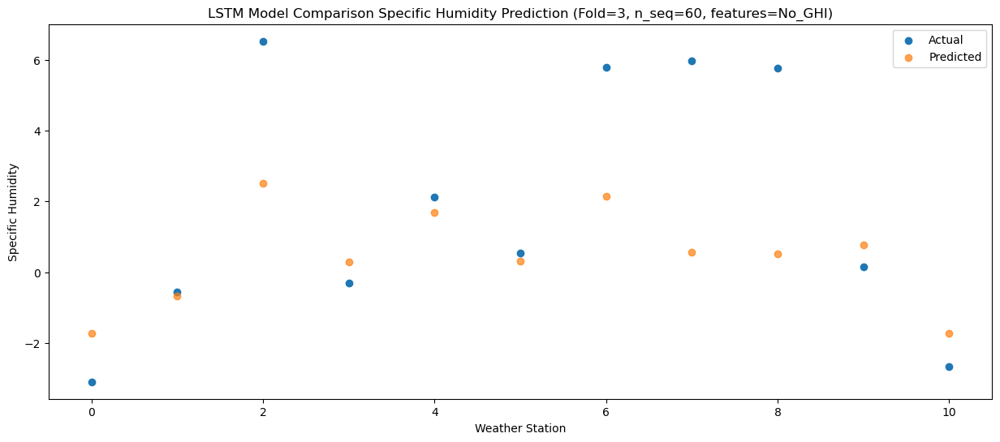

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -1.995897
1                 1   -0.58  -0.958776
2                 2    6.15   2.240904
3                 3   -0.70   0.023719
4                 4   -0.18   1.421776
5                 5    0.03   0.040217
6                 6    5.75   1.869112
7                 7    4.86   0.298369
8                 8    5.08   0.240795
9                 9   -0.14   0.497620
10               10   -2.76  -1.992362


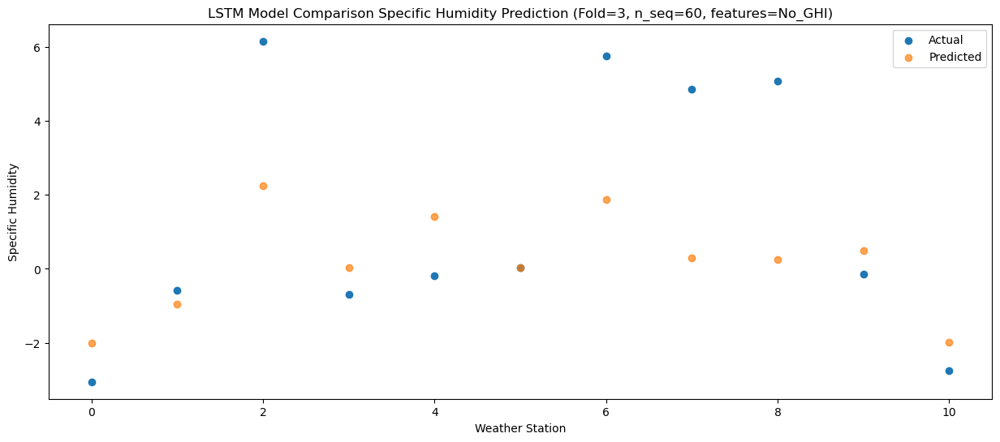

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72  -2.101924
1                 1   -0.94  -1.065545
2                 2    5.46   2.138227
3                 3   -0.88  -0.083504
4                 4   -0.94   1.312313
5                 5   -0.22  -0.069946
6                 6    5.71   1.762721
7                 7    4.44   0.194863
8                 8    4.19   0.140100
9                 9   -0.06   0.394363
10               10   -2.77  -2.096139


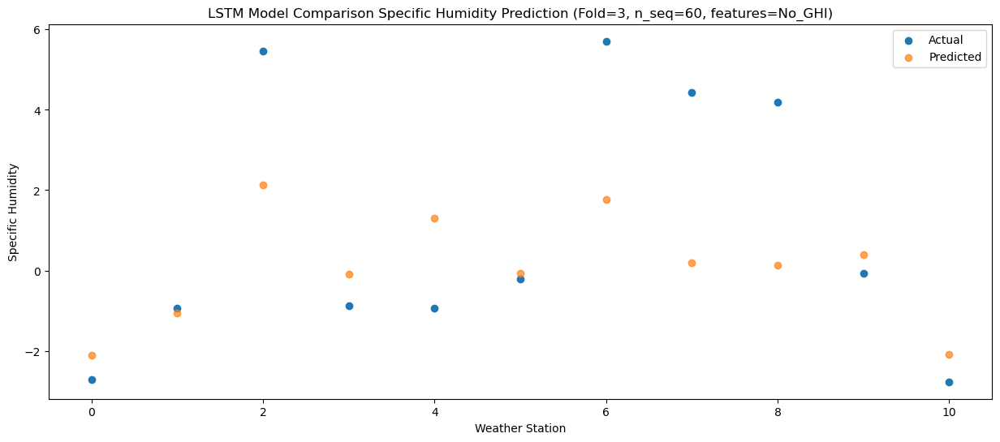

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -0.322804
1                 1    1.66   0.711956
2                 2    6.54   3.917350
3                 3    0.98   1.694409
4                 4    1.13   3.089720
5                 5    1.77   1.707082
6                 6    6.34   3.539891
7                 7    6.18   1.973271
8                 8    4.67   1.919845
9                 9    0.43   2.171278
10               10   -1.81  -0.319431


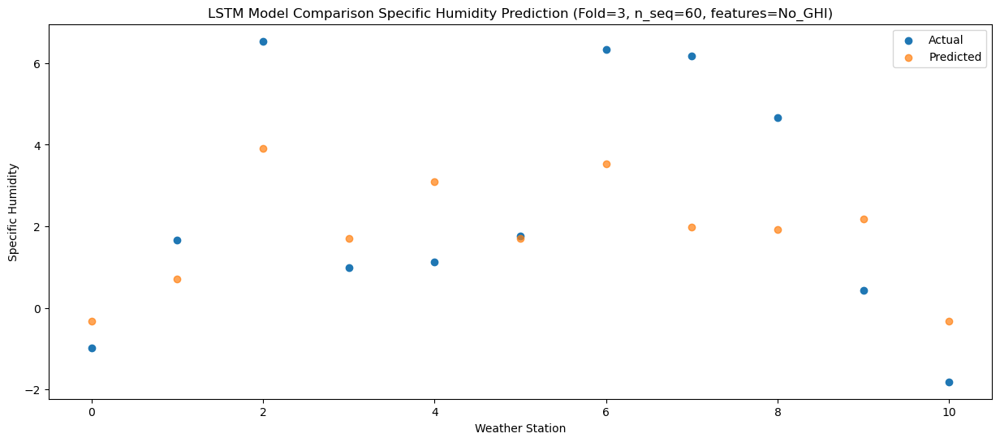

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17   0.027813
1                 1    1.81   1.062081
2                 2    7.91   4.270256
3                 3    0.90   2.047530
4                 4    1.45   3.443912
5                 5    1.89   2.060034
6                 6    6.69   3.888417
7                 7    5.99   2.323395
8                 8    5.73   2.268418
9                 9    0.93   2.523502
10               10   -1.38   0.034131


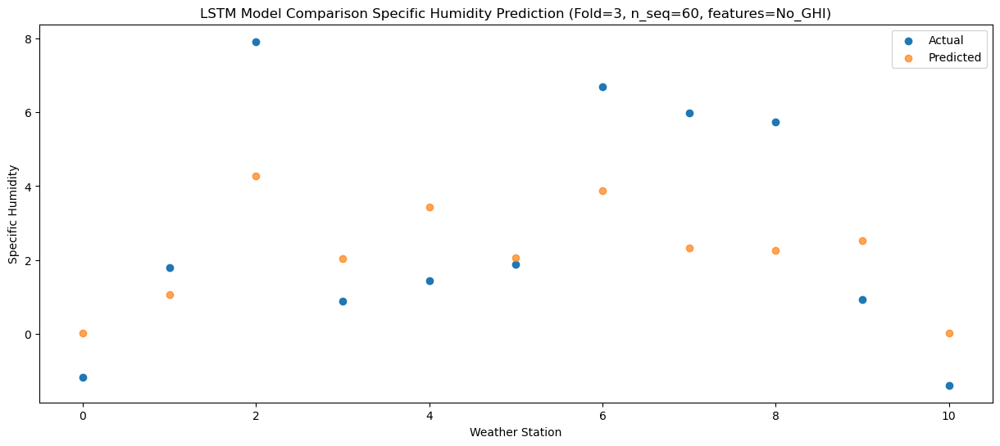

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   3.144390
1                 1    4.78   4.181745
2                 2    7.72   7.384397
3                 3    4.33   5.164168
4                 4    5.15   6.564116
5                 5    5.10   5.181275
6                 6    7.82   7.009242
7                 7    5.29   5.442241
8                 8    6.59   5.383065
9                 9    3.16   5.638444
10               10    1.15   3.148816


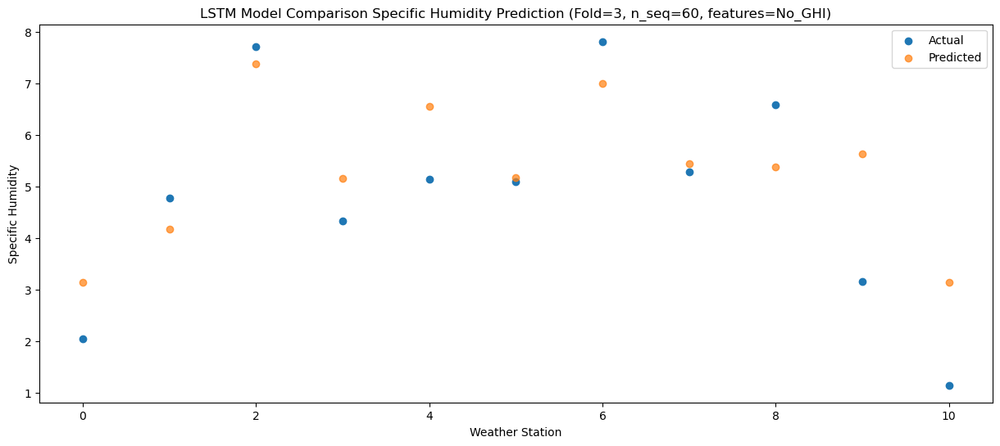

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   6.546085
1                 1    8.31   7.584466
2                 2    9.26  10.775436
3                 3    7.57   8.567628
4                 4    8.24   9.968764
5                 5    7.83   8.589778
6                 6    8.88  10.406149
7                 7    5.62   8.833006
8                 8    6.81   8.769947
9                 9    7.27   9.035235
10               10    4.72   6.547255


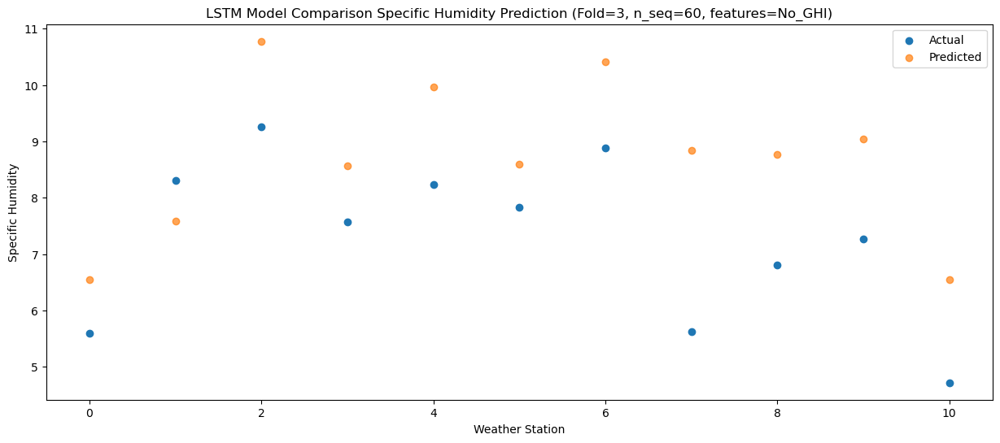

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   9.842399
1                 1   11.05  10.883634
2                 2    9.48  14.072192
3                 3   10.67  11.867051
4                 4   12.19  13.267728
5                 5   10.99  11.890156
6                 6   10.40  13.705484
7                 7    6.10  12.131311
8                 8    7.28  12.066925
9                 9   11.25  12.334183
10               10    8.07   9.845270


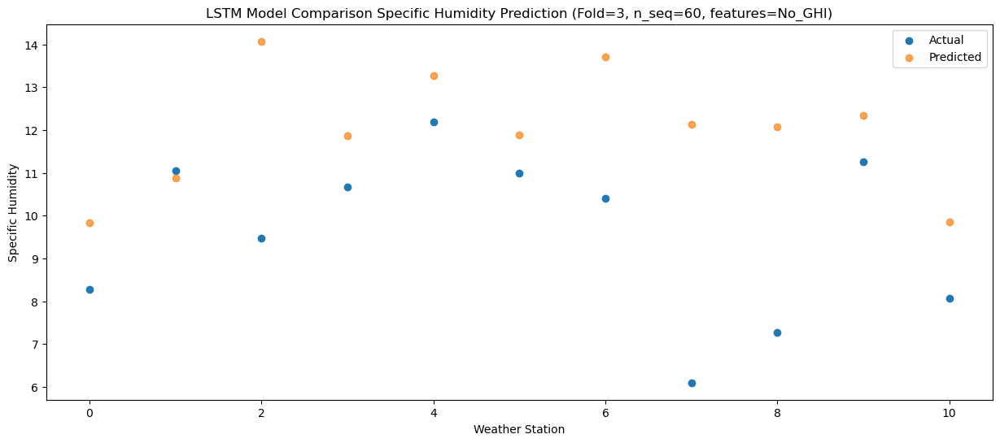

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   8.302849
1                 1    8.38   9.340344
2                 2   11.00  12.527737
3                 3    9.59  10.325140
4                 4    9.81  11.723485
5                 5    9.77  10.345244
6                 6    9.19  12.157403
7                 7    6.97  10.583222
8                 8    8.08  10.519535
9                 9   10.18  10.789810
10               10    7.43   8.301357


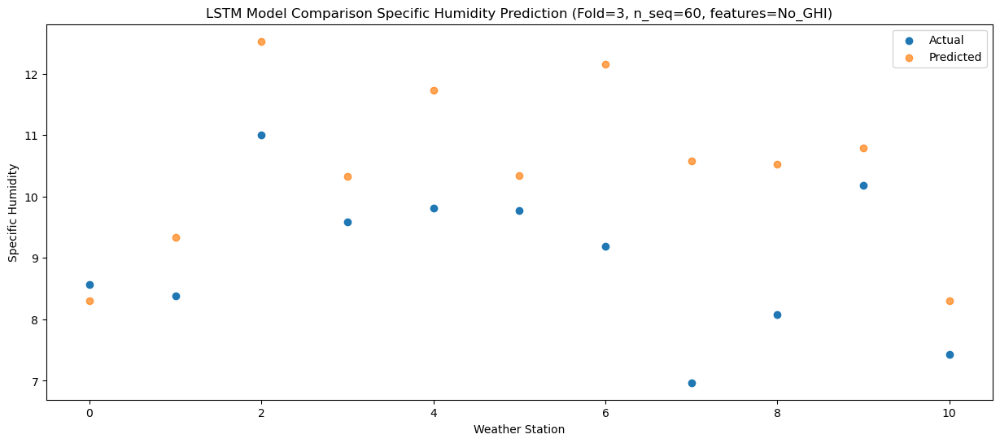

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   5.204085
1                 1    6.94   6.238831
2                 2   10.52   9.427082
3                 3    7.02   7.224852
4                 4    6.85   8.621657
5                 5    6.59   7.245606
6                 6    8.05   9.056525
7                 7    5.71   7.483841
8                 8    7.69   7.418193
9                 9    6.81   7.688196
10               10    4.14   5.199846


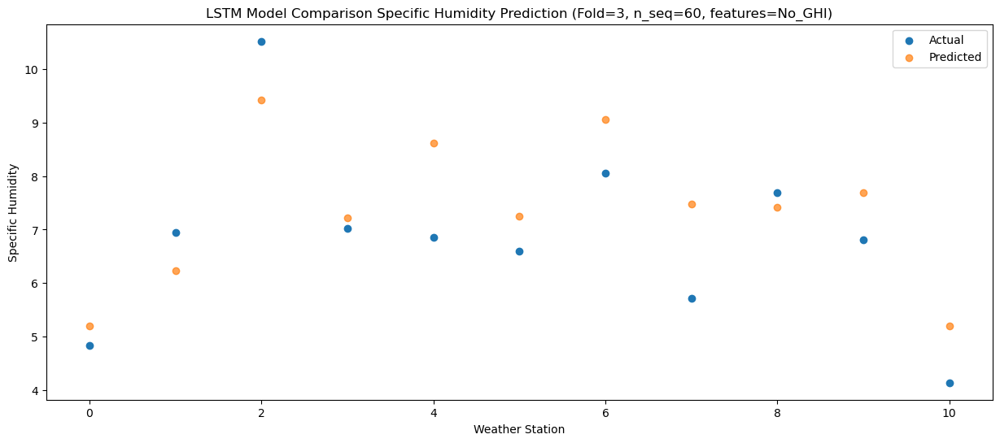

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25   1.454569
1                 1    2.37   2.488642
2                 2    8.64   5.679361
3                 3    3.33   3.475157
4                 4    2.13   4.870670
5                 5    3.17   3.492176
6                 6    6.40   5.307276
7                 7    4.70   3.736194
8                 8    5.49   3.670841
9                 9    4.28   3.938264
10               10    1.37   1.447187


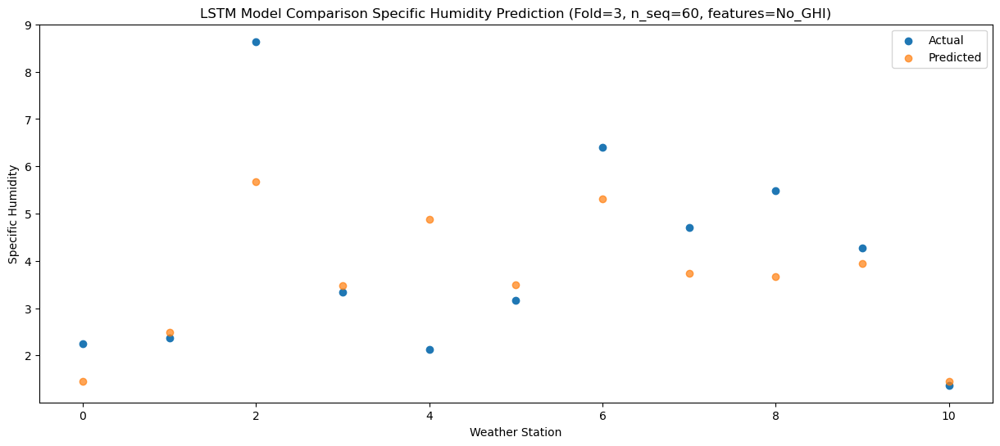

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -0.117050
1                 1    0.87   0.918570
2                 2    5.95   4.109312
3                 3    0.44   1.902505
4                 4    1.03   3.300467
5                 5    1.40   1.919598
6                 6    6.34   3.736706
7                 7    4.68   2.164527
8                 8    4.33   2.099340
9                 9    2.12   2.367146
10               10   -0.96  -0.125333


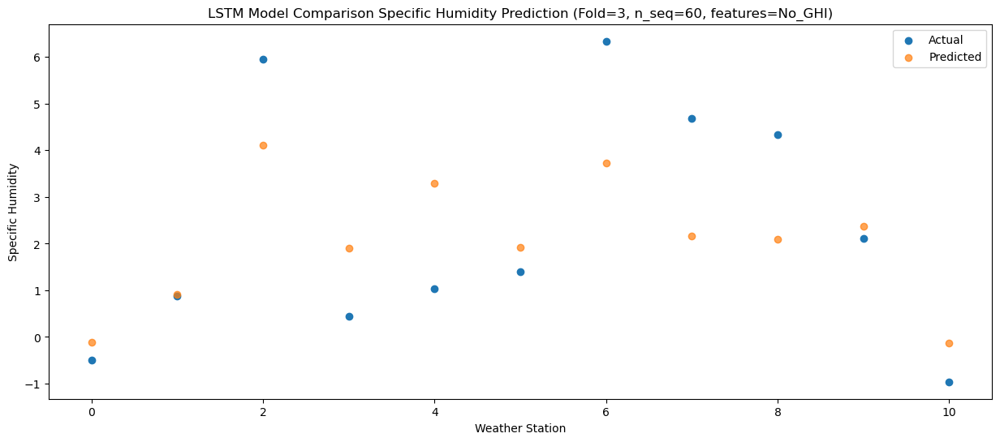

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -2.044054
1                 1   -1.17  -1.006493
2                 2    5.35   2.184395
3                 3   -1.17  -0.020853
4                 4   -0.90   1.378204
5                 5   -0.26  -0.001410
6                 6    5.53   1.815143
7                 7    3.85   0.242952
8                 8    3.99   0.173608
9                 9    0.16   0.443756
10               10   -2.81  -2.049718


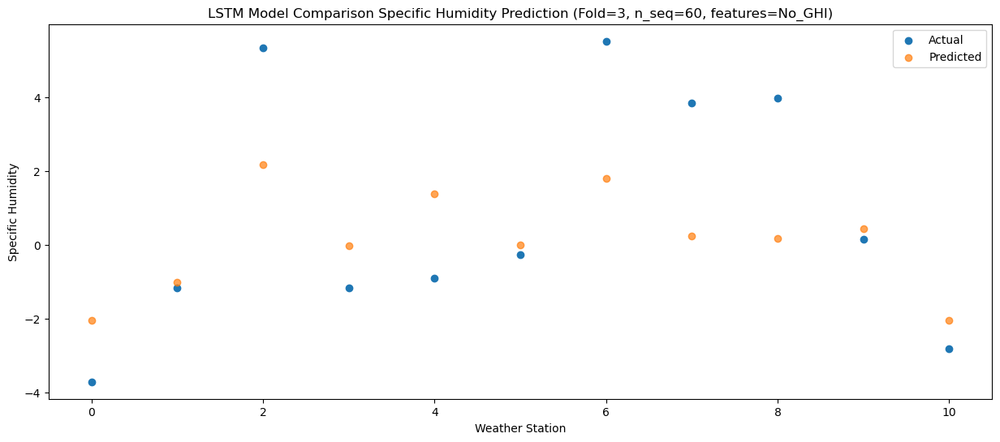

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -2.281224
1                 1   -1.26  -1.245110
2                 2    5.79   1.944638
3                 3   -1.44  -0.256259
4                 4   -1.10   1.142743
5                 5   -0.57  -0.234656
6                 6    5.70   1.578492
7                 7    4.66   0.004539
8                 8    4.66  -0.064078
9                 9   -0.93   0.207785
10               10   -3.50  -2.284614


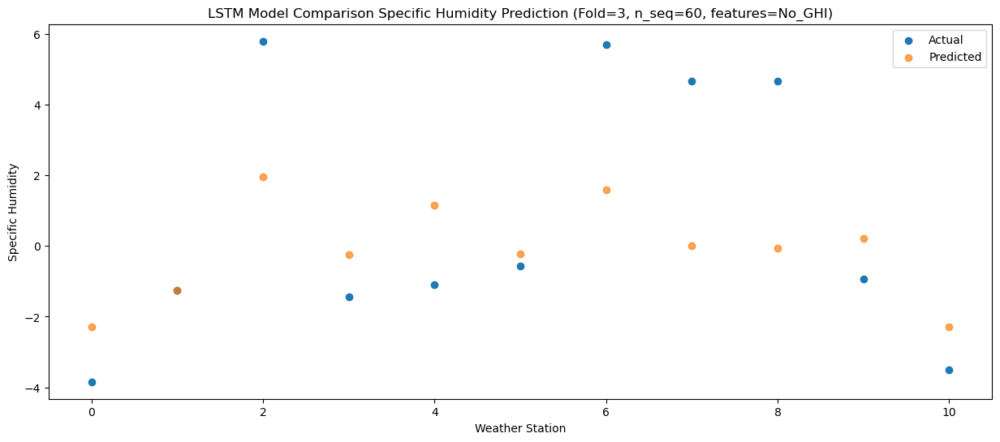

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -2.720455
1                 1   -1.82  -1.685033
2                 2    5.73   1.509058
3                 3   -1.51  -0.696394
4                 4   -1.93   0.701207
5                 5   -1.09  -0.676996
6                 6    5.76   1.142111
7                 7    4.18  -0.430606
8                 8    4.31  -0.497056
9                 9   -0.78  -0.226576
10               10   -3.64  -2.720479


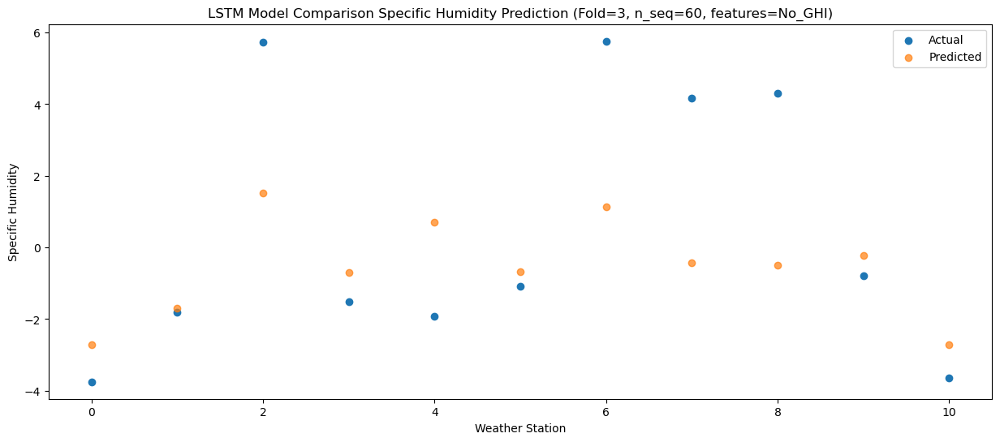

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -0.729362
1                 1  6.900000e-01   0.307292
2                 2  5.810000e+00   3.495975
3                 3 -2.100000e-01   1.296583
4                 4  5.500000e-01   2.692589
5                 5  9.400000e-01   1.316497
6                 6  6.070000e+00   3.132987
7                 7  4.480000e+00   1.557902
8                 8  3.960000e+00   1.491188
9                 9  2.220446e-16   1.763931
10               10 -2.360000e+00  -0.729941


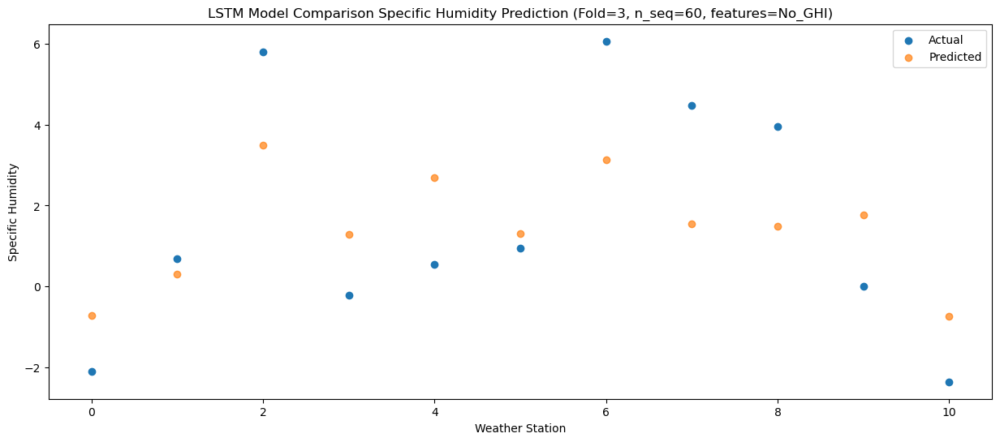

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58   0.408256
1                 1    1.86   1.446314
2                 2    6.43   4.632795
3                 3    0.98   2.434892
4                 4    1.61   3.833249
5                 5    2.24   2.457330
6                 6    6.54   4.273419
7                 7    4.17   2.698650
8                 8    4.89   2.629723
9                 9    1.38   2.902544
10               10   -0.95   0.407603


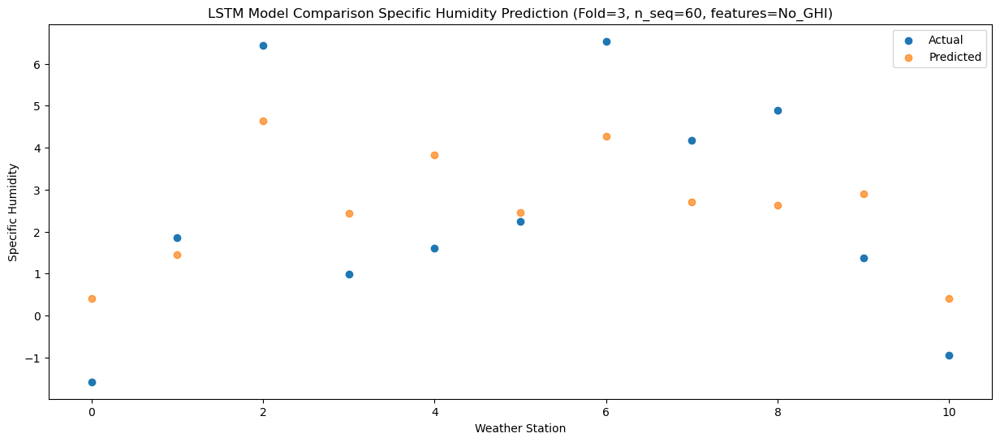

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20   2.700638
1                 1    5.38   3.739522
2                 2    6.83   6.922456
3                 3    3.51   4.726481
4                 4    4.03   6.124049
5                 5    4.48   4.749723
6                 6    7.94   6.564113
7                 7    4.73   4.990214
8                 8    5.33   4.919944
9                 9    2.95   5.192739
10               10    0.64   2.698562


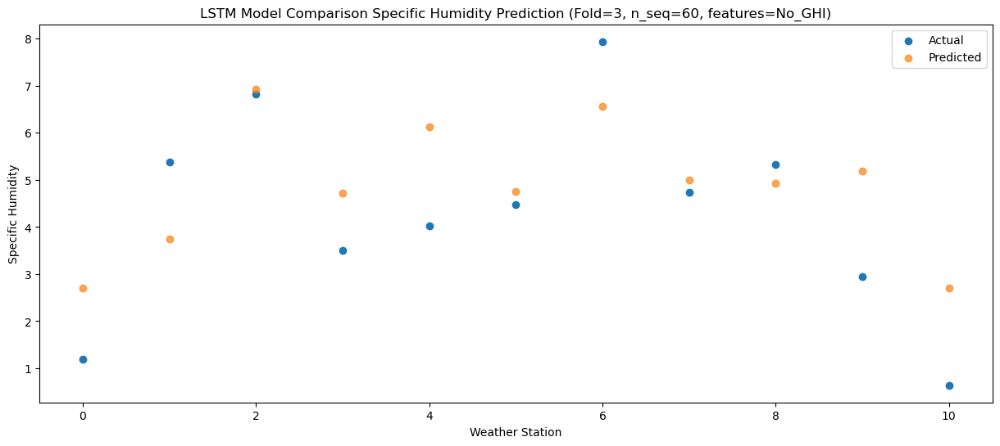

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   7.487877
1                 1    9.91   8.523596
2                 2    9.28  11.705964
3                 3    8.93   9.512624
4                 4    8.49  10.907108
5                 5    9.70   9.532639
6                 6    9.27  11.344440
7                 7    6.15   9.766483
8                 8    6.76   9.696611
9                 9    7.85   9.976122
10               10    5.51   7.487434


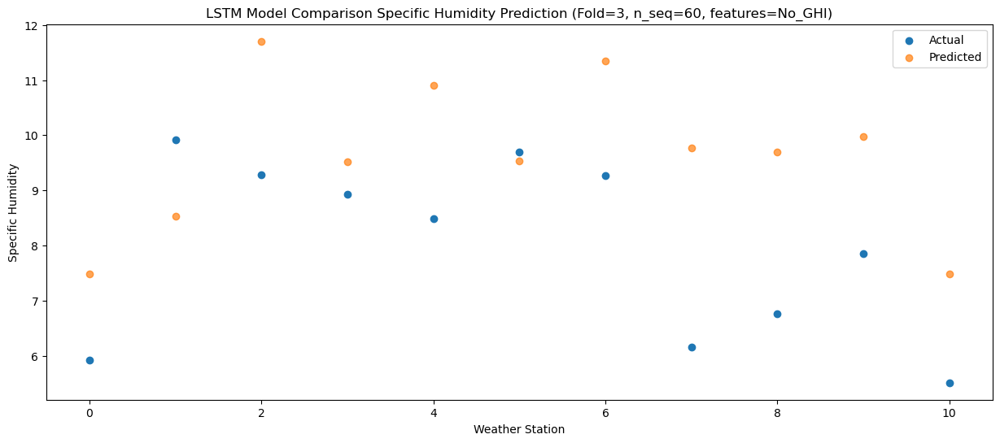

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   9.003038
1                 1   10.79  10.043849
2                 2    9.98  13.226073
3                 3    9.56  11.031725
4                 4   10.44  12.429500
5                 5   10.95  11.055492
6                 6   11.72  12.868477
7                 7   11.51  11.291422
8                 8    7.24  11.216992
9                 9   10.06  11.494699
10               10    7.20   9.003756


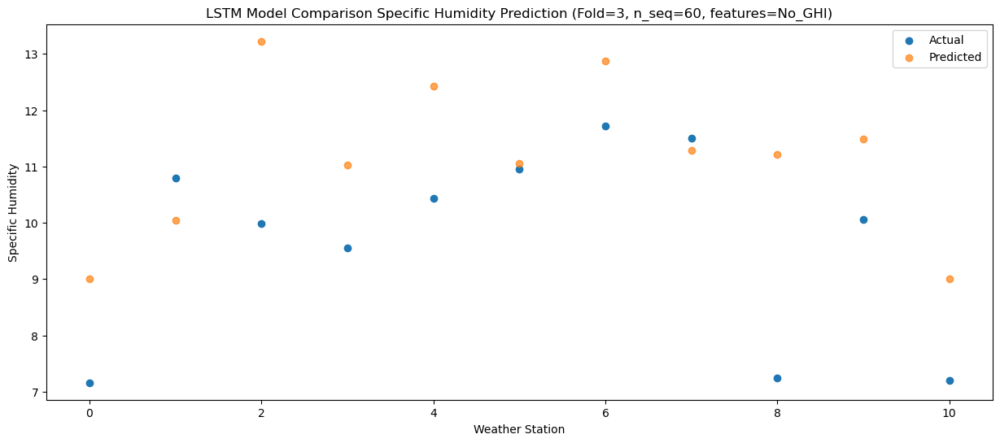

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43   9.554083
1                 1   10.96  10.591271
2                 2    9.51  13.773560
3                 3   10.44  11.580642
4                 4   10.53  12.975975
5                 5   11.12  11.602273
6                 6   10.29  13.414391
7                 7    9.08  11.837982
8                 8    7.63  11.763200
9                 9   10.44  12.042006
10               10    7.52   9.552296


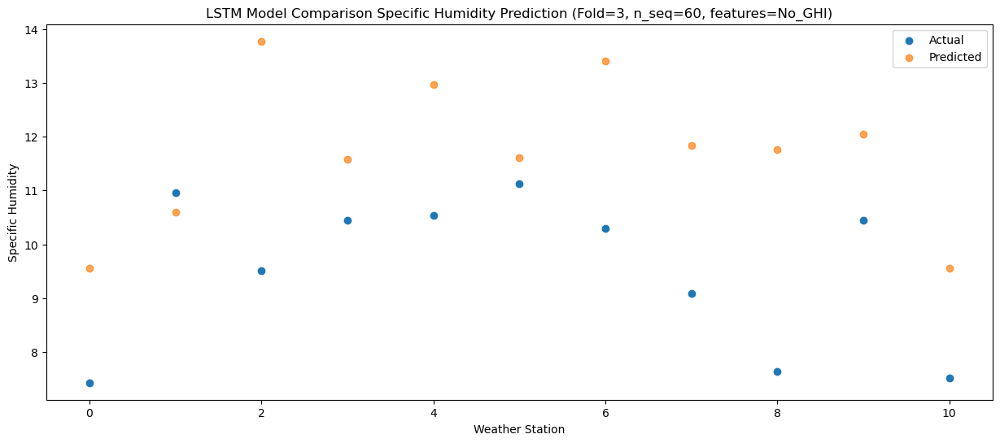

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   6.092902
1                 1    6.99   7.131260
2                 2    8.22  10.312096
3                 3    6.97   8.118223
4                 4    6.76   9.514071
5                 5    7.82   8.139877
6                 6    8.59   9.953103
7                 7    7.36   8.374835
8                 8    6.99   8.298295
9                 9    7.84   8.575077
10               10    4.60   6.085420


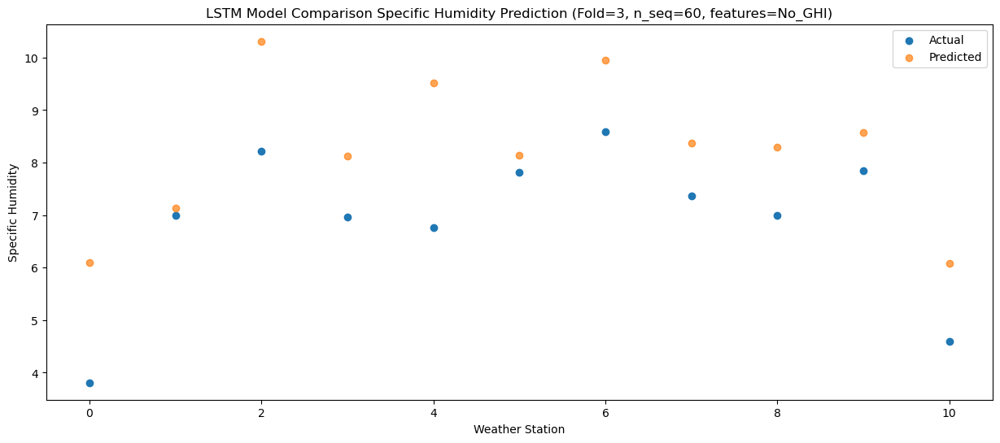

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77   4.029472
1                 1    4.80   5.067035
2                 2    7.08   8.249156
3                 3    4.91   6.055909
4                 4    4.81   7.450186
5                 5    6.20   6.075818
6                 6    7.50   7.891160
7                 7    6.26   6.313598
8                 8    5.96   6.239194
9                 9    5.30   6.516377
10               10    2.70   4.023753


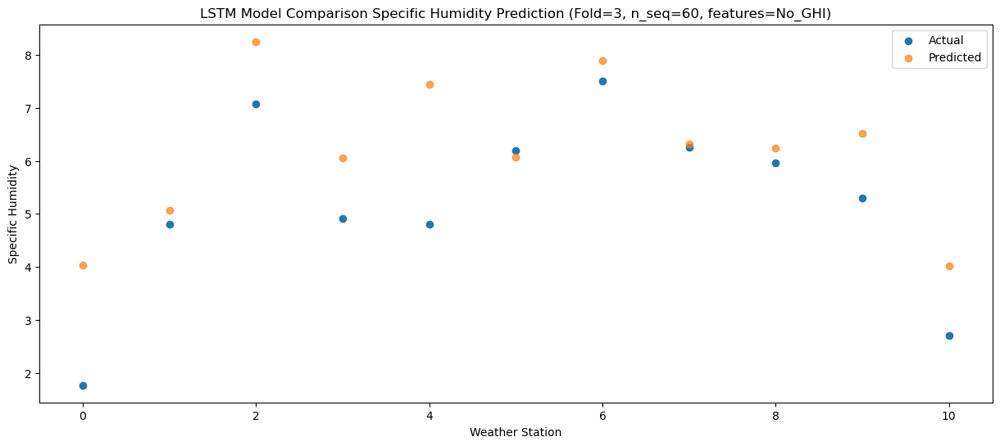

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73  -1.037590
1                 1    0.37   0.000460
2                 2    7.66   3.184239
3                 3   -0.78   0.987144
4                 4   -0.31   2.378806
5                 5    0.33   1.002037
6                 6    6.79   2.824130
7                 7    4.99   1.248132
8                 8    6.18   1.175191
9                 9    0.77   1.447993
10               10   -2.22  -1.047242


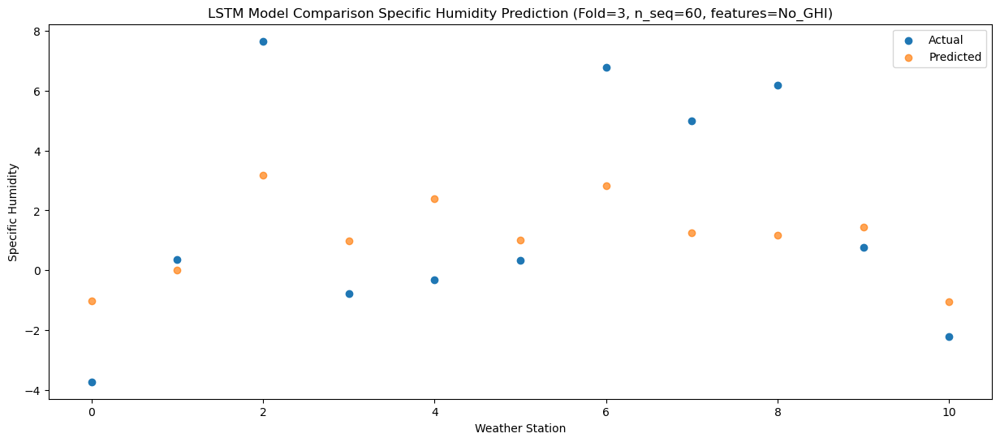

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -0.625932
1                 1    1.34   0.413592
2                 2    6.16   3.593110
3                 3    0.36   1.399354
4                 4    0.39   2.790259
5                 5    1.38   1.413336
6                 6    6.08   3.235700
7                 7    5.13   1.658149
8                 8    4.93   1.586835
9                 9    0.47   1.859280
10               10   -2.32  -0.637049


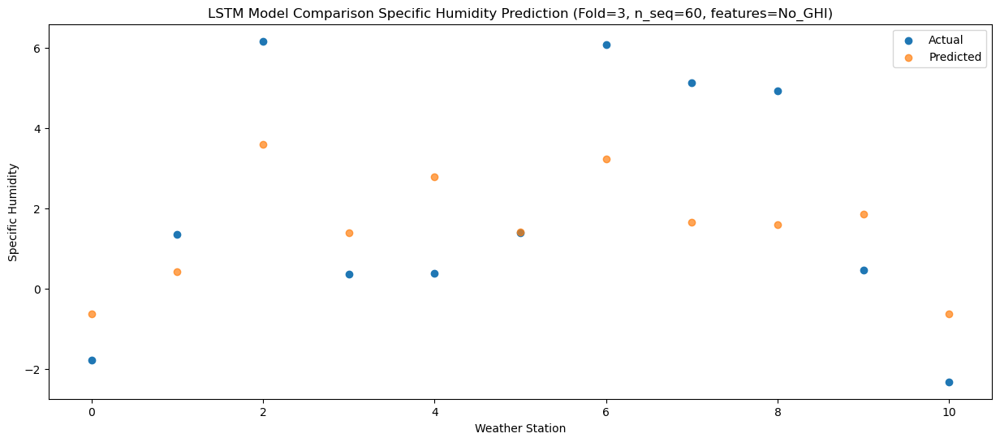

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -2.848363
1                 1   -1.85  -1.809969
2                 2    5.88   1.368482
3                 3   -1.96  -0.821666
4                 4   -2.07   0.568655
5                 5   -1.13  -0.804979
6                 6    5.60   1.012610
7                 7    4.14  -0.566787
8                 8    4.60  -0.640695
9                 9   -1.01  -0.363331
10               10   -3.83  -2.856421


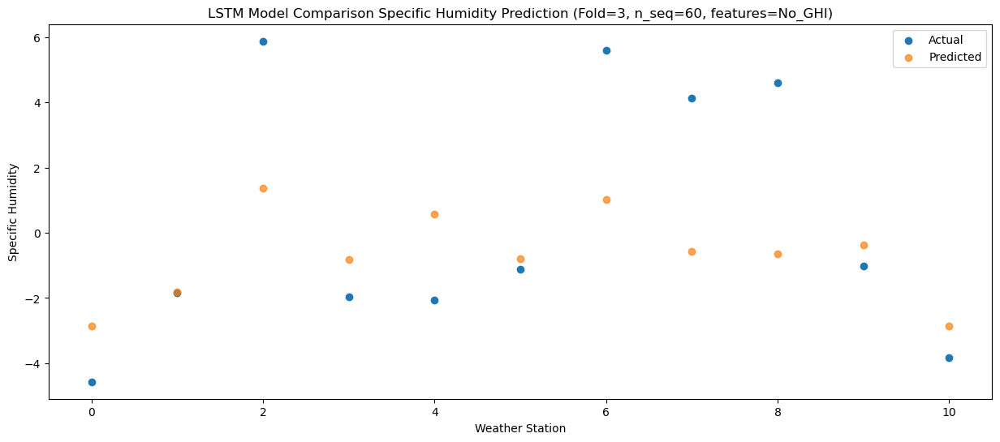

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21  -2.251499
1                 1   -1.48  -1.212356
2                 2    5.10   1.968382
3                 3   -1.44  -0.221456
4                 4   -1.45   1.168934
5                 5   -0.60  -0.205604
6                 6    5.39   1.608864
7                 7    3.71   0.031392
8                 8    3.76  -0.047797
9                 9   -0.42   0.234686
10               10   -3.13  -2.257740


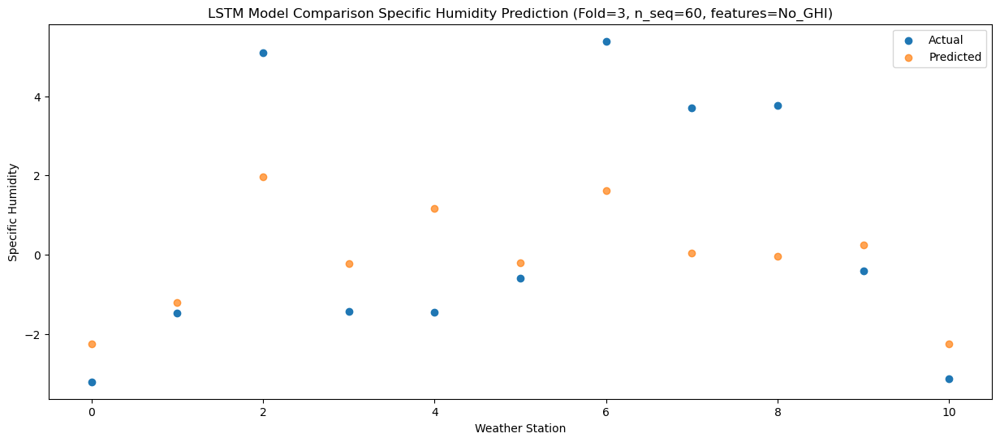

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -0.839075
1                 1   -0.01   0.201281
2                 2    6.44   3.382094
3                 3   -0.46   1.192323
4                 4    0.12   2.583317
5                 5    0.71   1.209480
6                 6    6.07   3.025736
7                 7    4.33   1.446898
8                 8    4.76   1.366088
9                 9    0.42   1.648284
10               10   -2.19  -0.845622


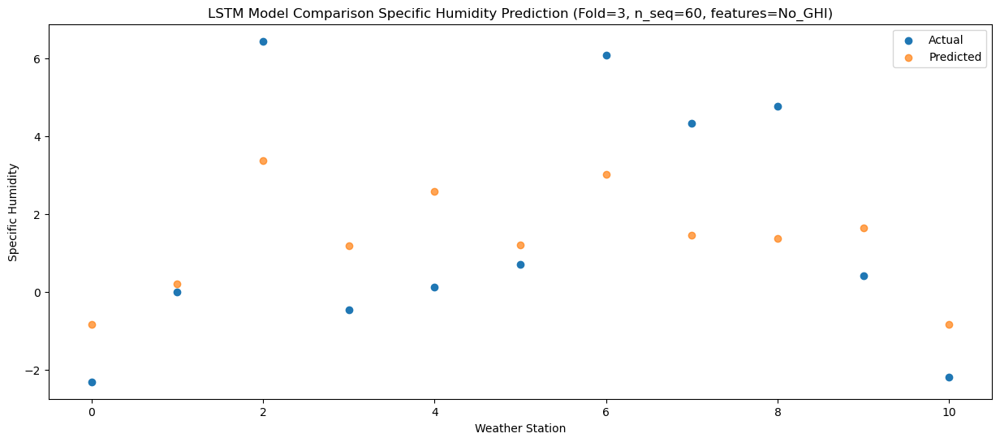

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28   0.370593
1                 1    2.29   1.415044
2                 2    6.11   4.591811
3                 3    0.81   2.402666
4                 4    1.68   3.795001
5                 5    2.24   2.419831
6                 6    6.57   4.235289
7                 7    4.33   2.655800
8                 8    4.86   2.574979
9                 9    1.07   2.857068
10               10   -1.55   0.361670


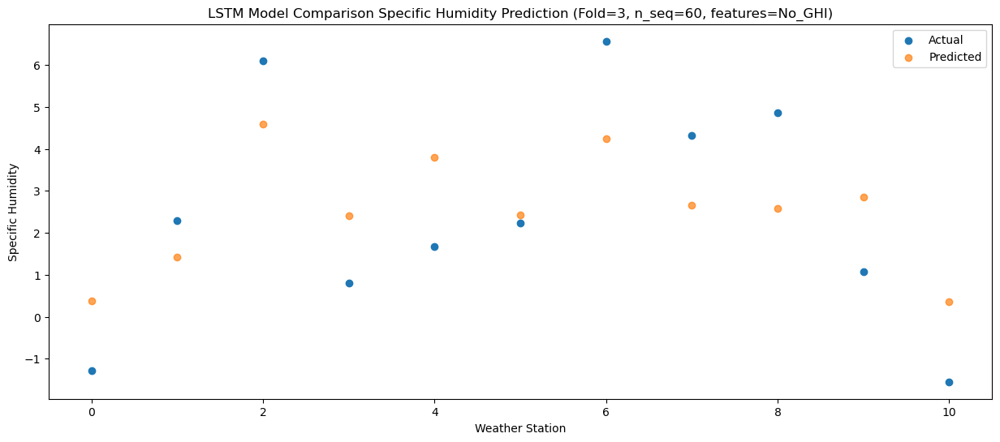

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03   4.439425
1                 1    6.74   5.487948
2                 2    6.29   8.657498
3                 3    5.23   6.473958
4                 4    5.77   7.870254
5                 5    6.47   6.496909
6                 6    7.38   8.304757
7                 7    4.59   6.720997
8                 8    5.23   6.635413
9                 9    4.46   6.925549
10               10    2.63   4.432269


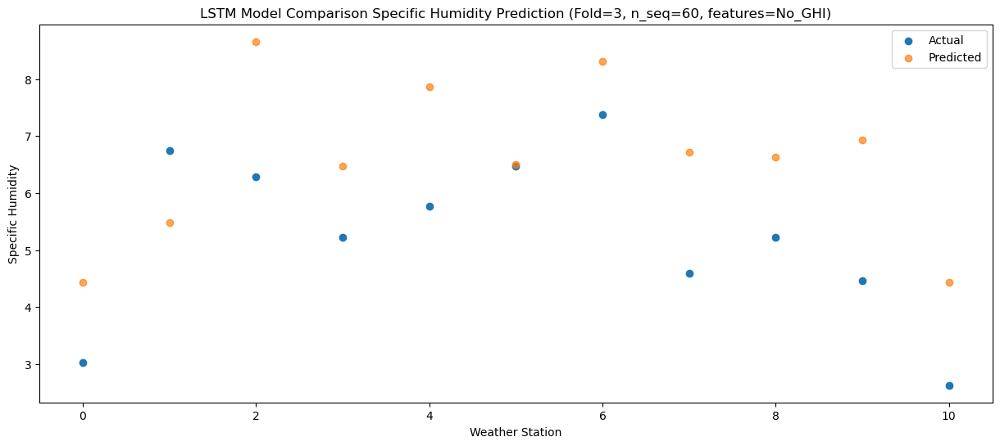

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33   6.530997
1                 1    9.36   7.580213
2                 2    7.46  10.752946
3                 3    7.49   8.566626
4                 4    7.87   9.962183
5                 5    8.54   8.587348
6                 6    9.32  10.398146
7                 7    6.35   8.818642
8                 8    6.72   8.733290
9                 9    6.80   9.019995
10               10    4.03   6.523664


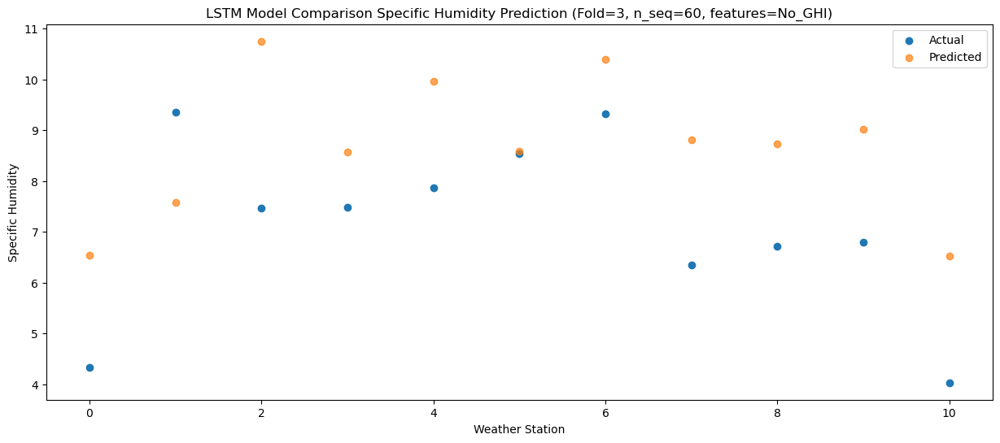

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40   9.271410
1                 1    9.57  10.315051
2                 2    8.63  13.486306
3                 3   10.53  11.304439
4                 4   10.46  12.699141
5                 5   11.32  11.325723
6                 6   12.31  13.131602
7                 7    9.78  11.551303
8                 8    7.55  11.462738
9                 9    9.96  11.757551
10               10    7.01   9.264278


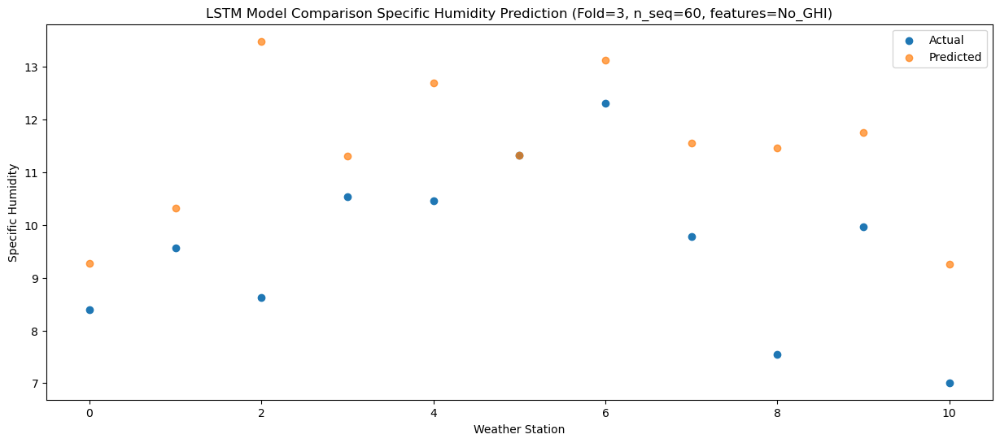

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   8.789367
1                 1   10.18   9.833921
2                 2    9.42  13.007601
3                 3    9.40  10.823355
4                 4    9.96  12.218563
5                 5   10.12  10.845716
6                 6   12.15  12.653571
7                 7   12.85  11.075221
8                 8    8.01  10.984263
9                 9   10.10  11.275473
10               10    6.64   8.781526


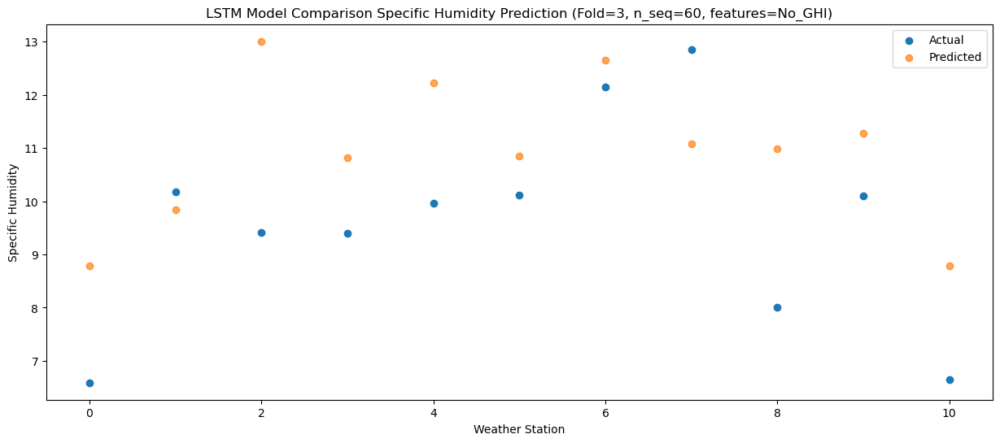

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   5.453622
1                 1    6.33   6.497800
2                 2    9.13   9.670552
3                 3    6.15   7.486134
4                 4    6.86   8.881141
5                 5    7.35   7.507958
6                 6    9.20   9.316443
7                 7    8.94   7.738657
8                 8    7.41   7.645450
9                 9    6.43   7.938608
10               10    3.62   5.445779


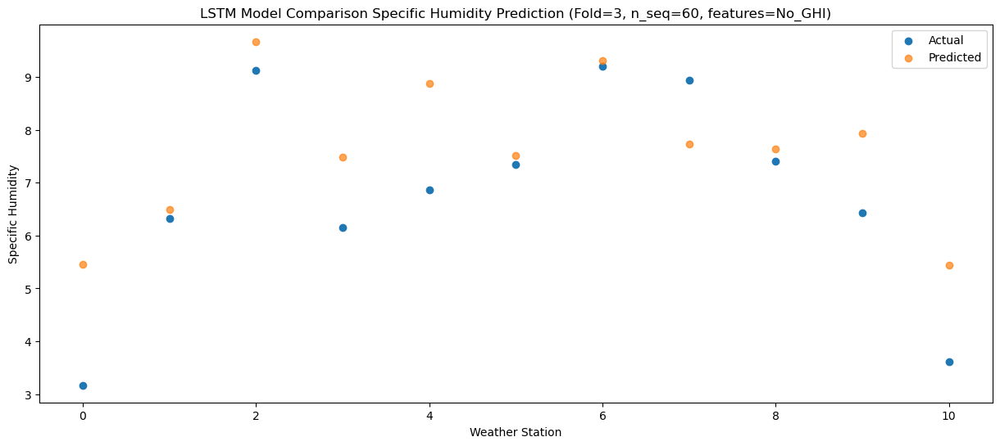

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06   0.908510
1                 1    1.87   1.954977
2                 2    7.96   5.126208
3                 3    1.00   2.942378
4                 4    1.86   4.338224
5                 5    2.05   2.965436
6                 6    7.59   4.778615
7                 7    6.21   3.199427
8                 8    6.10   3.107251
9                 9    3.80   3.401296
10               10    0.20   0.908520


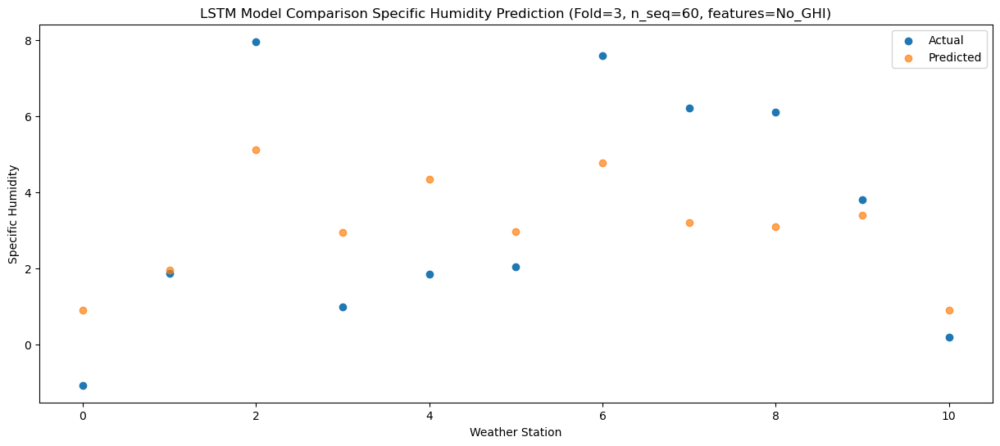

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -0.357661
1                 1    0.84   0.690088
2                 2    5.24   3.857299
3                 3    0.19   1.677040
4                 4    0.47   3.075491
5                 5    0.83   1.703796
6                 6    5.93   3.510731
7                 7    4.44   1.929898
8                 8    3.85   1.832206
9                 9    1.95   2.130856
10               10   -1.02  -0.360323


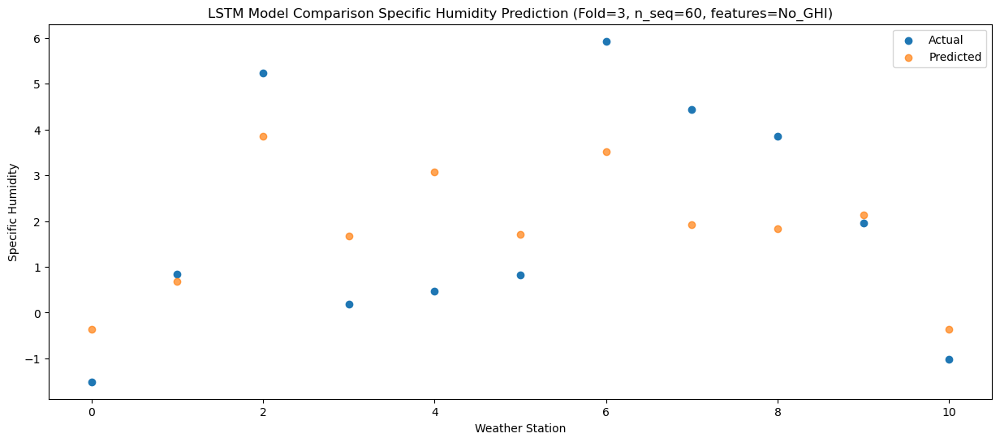

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -1.846307
1                 1   -0.35  -0.798805
2                 2    6.08   2.366808
3                 3   -0.84   0.187656
4                 4   -0.65   1.585661
5                 5    0.07   0.214110
6                 6    5.96   2.019903
7                 7    5.19   0.439275
8                 8    4.64   0.341332
9                 9   -0.02   0.642032
10               10   -2.94  -1.848941


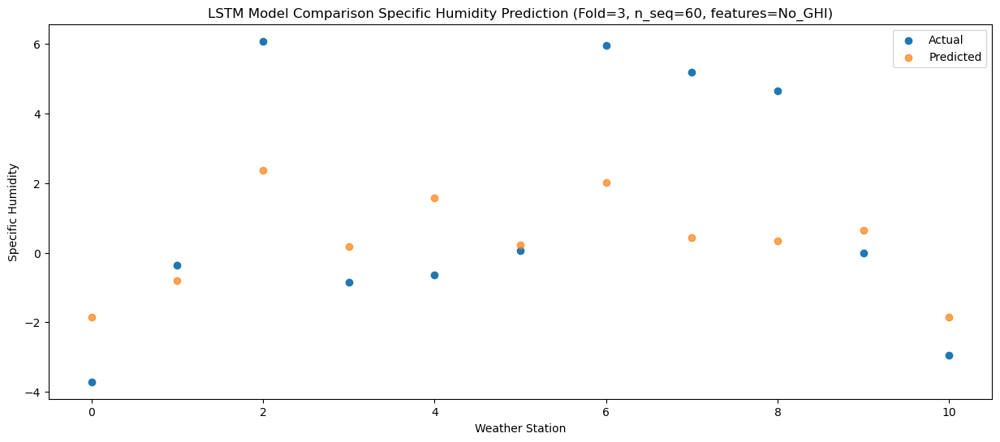

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80  -1.321621
1                 1   -0.43  -0.274845
2                 2    6.23   2.890543
3                 3   -0.30   0.712636
4                 4   -0.27   2.110429
5                 5    0.65   0.738907
6                 6    5.93   2.543751
7                 7    5.58   0.964527
8                 8    4.47   0.866039
9                 9    0.55   1.166406
10               10   -2.16  -1.323429


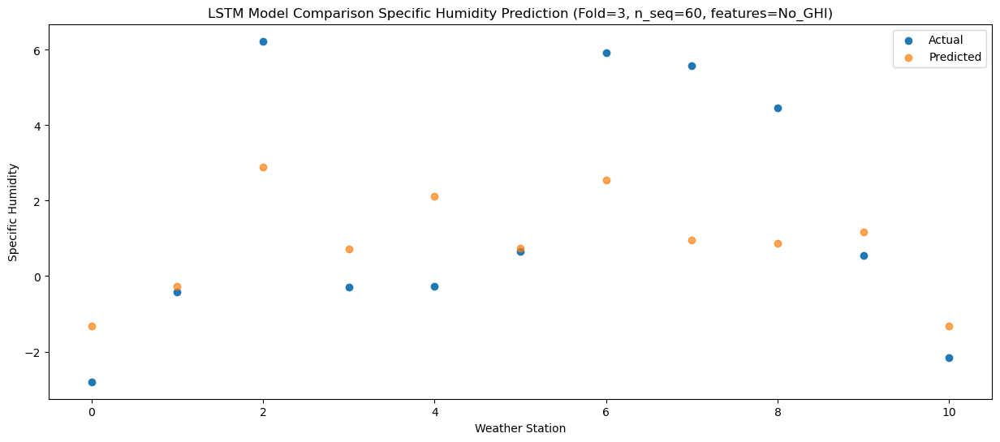

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -1.545262
1                 1   -0.27  -0.498689
2                 2    5.10   2.668493
3                 3   -0.48   0.489118
4                 4    0.61   1.887368
5                 5    0.32   0.517629
6                 6    5.55   2.322452
7                 7    4.33   0.744093
8                 8    3.61   0.643821
9                 9   -0.16   0.944217
10               10   -2.91  -1.545867


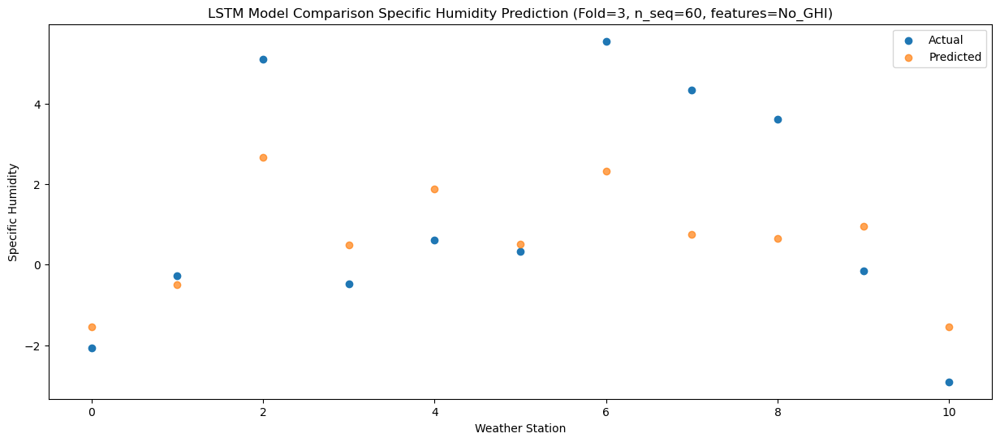

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -1.195097
1                 1    0.67  -0.147553
2                 2    6.62   3.015966
3                 3   -0.61   0.840187
4                 4    0.28   2.239076
5                 5    0.75   0.871405
6                 6    5.85   2.672847
7                 7    5.37   1.093136
8                 8    4.41   0.987651
9                 9    0.05   1.293109
10               10   -2.78  -1.194088


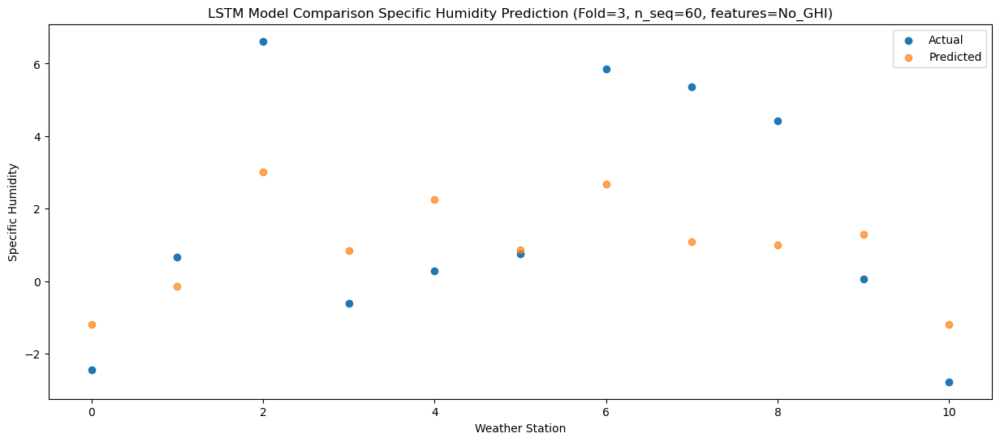

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47   0.526509
1                 1    1.54   1.574052
2                 2    6.82   4.737566
3                 3    0.93   2.562277
4                 4    1.51   3.961927
5                 5    2.06   2.594293
6                 6    6.48   4.392385
7                 7    4.52   2.812539
8                 8    4.79   2.706340
9                 9    2.29   3.013107
10               10   -0.35   0.528131


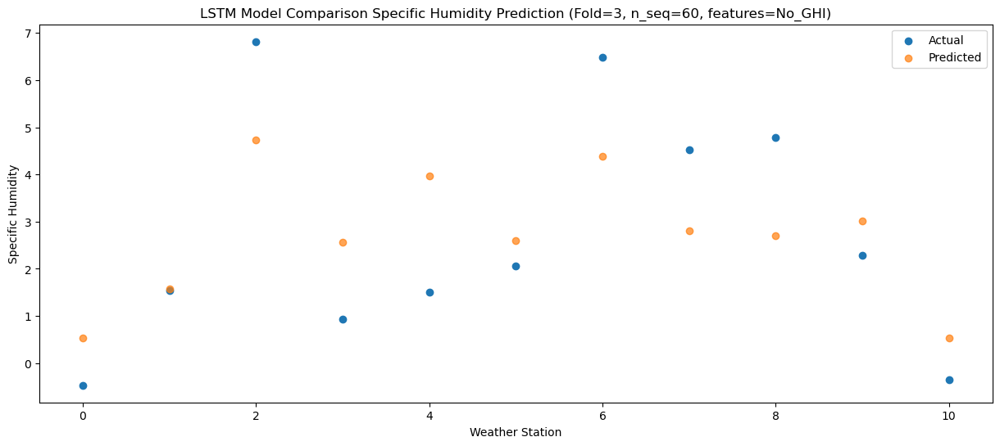

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98   2.847338
1                 1    5.95   3.898948
2                 2    7.76   7.065958
3                 3    3.84   4.883641
4                 4    4.69   6.286198
5                 5    4.66   4.916072
6                 6    8.64   6.722366
7                 7    6.06   5.145422
8                 8    6.38   5.038894
9                 9    2.81   5.338175
10               10    0.12   2.847891


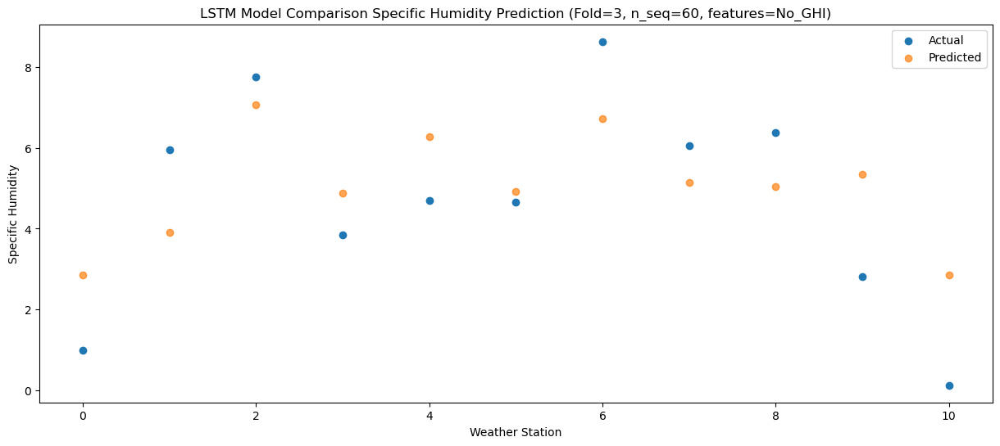

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   5.530077
1                 1    8.59   6.581847
2                 2    8.53   9.745773
3                 3    5.86   7.567980
4                 4    6.82   8.970437
5                 5    6.82   7.602089
6                 6    8.87   9.402631
7                 7    6.56   7.824161
8                 8    6.44   7.716691
9                 9    6.51   8.019009
10               10    3.81   5.531054


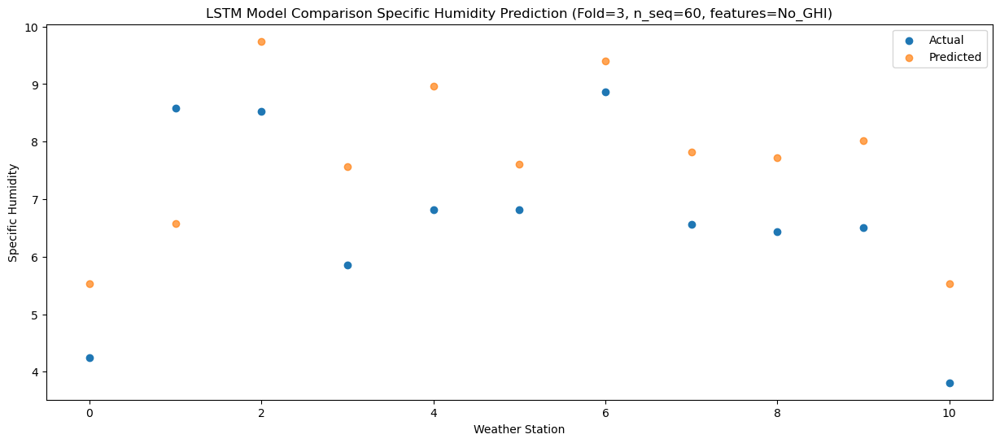

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   9.070318
1                 1   10.86  10.120611
2                 2    9.63  13.279300
3                 3    9.51  11.108745
4                 4   10.59  12.511164
5                 5   11.33  11.143900
6                 6    9.71  12.937585
7                 7    7.53  11.355144
8                 8    7.28  11.246640
9                 9   11.36  11.556107
10               10    7.79   9.071401


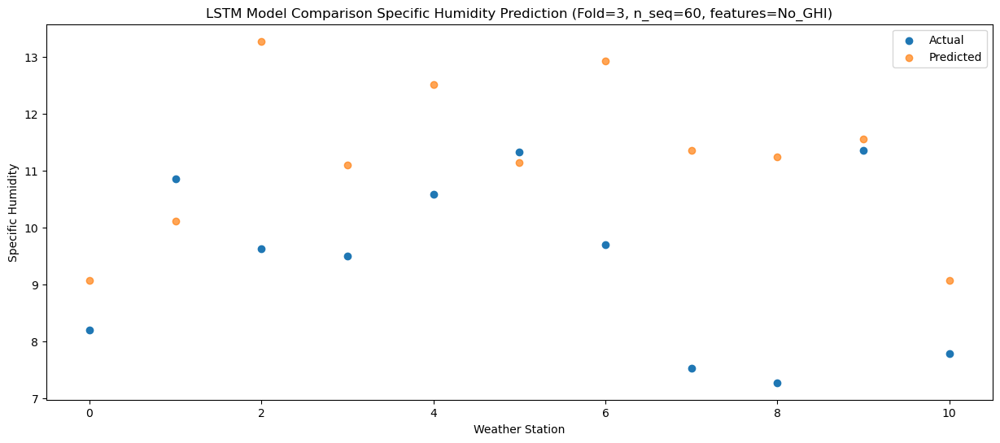

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   8.733085
1                 1   11.10   9.781454
2                 2   10.70  12.941043
3                 3    8.96  10.771780
4                 4   10.98  12.173309
5                 5   10.45  10.807030
6                 6   11.36  12.598054
7                 7   10.11  11.015150
8                 8    8.55  10.905902
9                 9    8.79  11.215250
10               10    6.55   8.731448


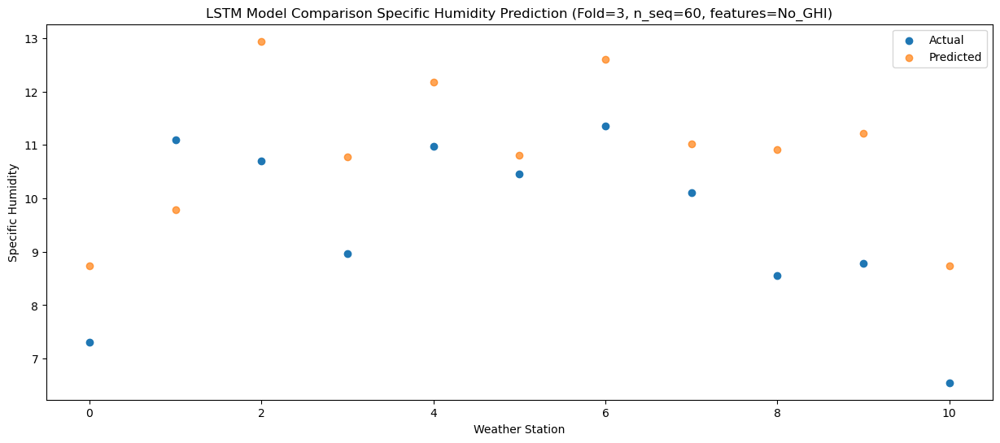

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.815064
1                 1    7.03   6.863403
2                 2    9.16  10.029438
3                 3    6.49   7.853958
4                 4    6.87   9.251258
5                 5    7.22   7.881458
6                 6    8.74   9.678939
7                 7    9.17   8.103199
8                 8    8.00   7.997812
9                 9    7.82   8.302236
10               10    4.86   5.814426


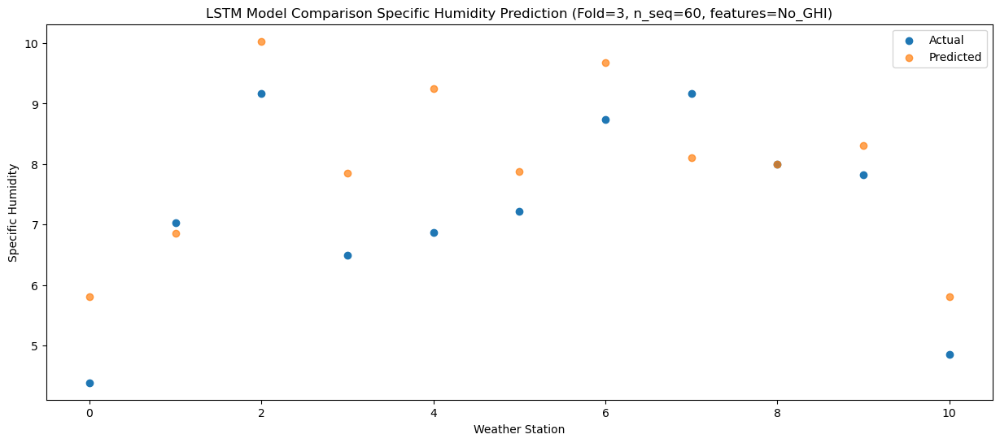

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28   2.262274
1                 1    3.59   3.310435
2                 2    8.00   6.475976
3                 3    2.96   4.301022
4                 4    3.25   5.697569
5                 5    3.84   4.327615
6                 6    7.49   6.123774
7                 7    6.11   4.548540
8                 8    6.57   4.441127
9                 9    4.43   4.750625
10               10    1.59   2.264371


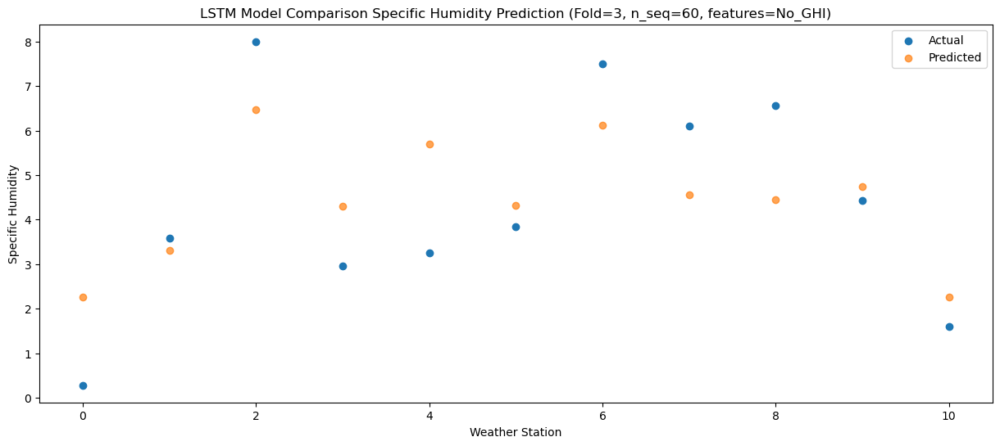

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -0.933716
1                 1    0.71   0.113259
2                 2    5.89   3.278500
3                 3   -0.43   1.103435
4                 4    0.08   2.496878
5                 5    0.65   1.125714
6                 6    6.16   2.922178
7                 7    5.10   1.346003
8                 8    5.48   1.241755
9                 9    0.63   1.551405
10               10   -2.09  -0.934141


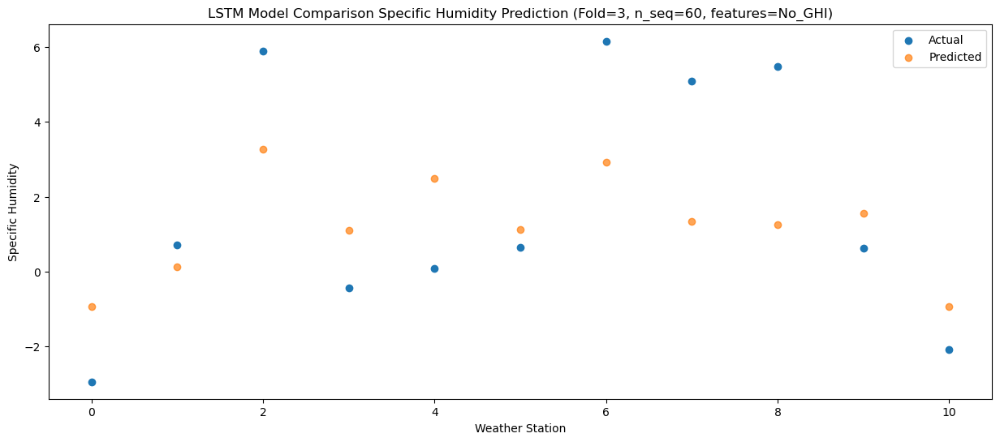

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -1.184360
1                 1   -0.11  -0.137647
2                 2    6.12   3.026366
3                 3   -0.41   0.853771
4                 4   -0.33   2.246404
5                 5    0.61   0.874442
6                 6    6.03   2.671430
7                 7    5.02   1.095929
8                 8    5.86   0.992092
9                 9    0.96   1.305245
10               10   -1.71  -1.179859


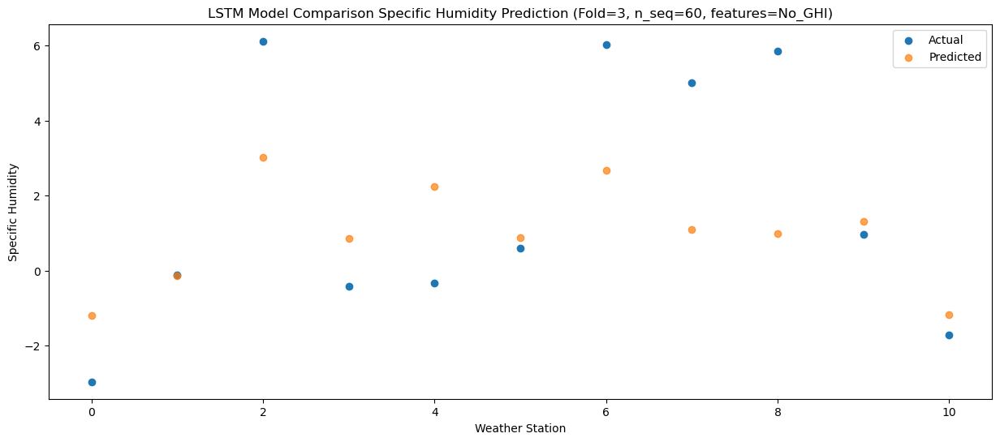

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -2.054931
1                 1   -1.42  -1.008006
2                 2    6.66   2.157279
3                 3   -1.15  -0.015536
4                 4   -1.20   1.375378
5                 5   -0.27   0.001733
6                 6    5.97   1.801594
7                 7    5.56   0.225899
8                 8    5.87   0.123765
9                 9   -0.34   0.439455
10               10   -2.84  -2.045704


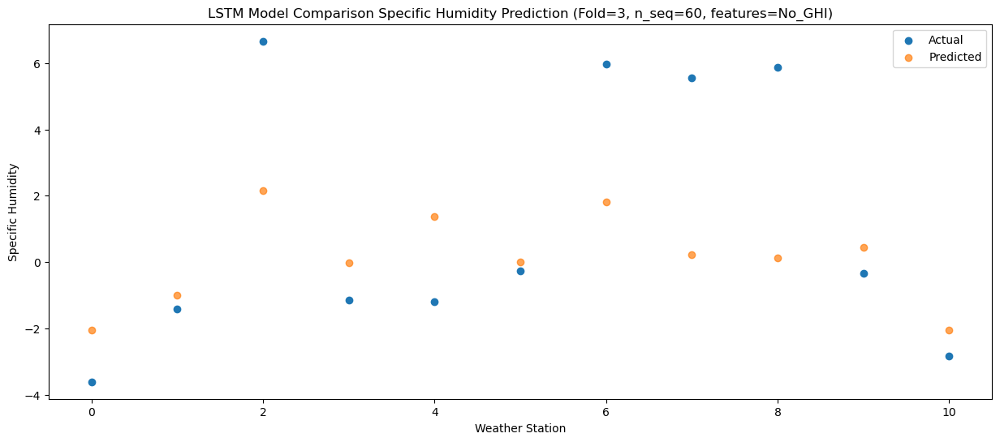

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -1.307196
1                 1 -3.552714e-15  -0.258668
2                 2  6.830000e+00   2.903619
3                 3 -8.300000e-01   0.731312
4                 4 -2.900000e-01   2.124397
5                 5  3.100000e-01   0.750809
6                 6  6.040000e+00   2.550401
7                 7  6.380000e+00   0.973477
8                 8  5.560000e+00   0.872288
9                 9 -4.400000e-01   1.186196
10               10 -2.930000e+00  -1.298409


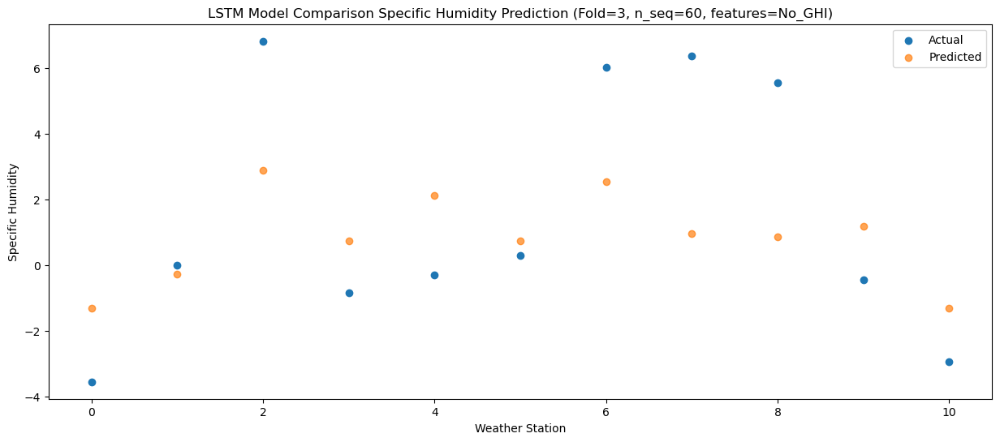

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05  -0.442660
1                 1    1.42   0.605402
2                 2    6.54   3.767915
3                 3    0.13   1.597436
4                 4    0.75   2.989605
5                 5    1.39   1.617024
6                 6    6.40   3.412691
7                 7    5.70   1.837093
8                 8    5.36   1.733126
9                 9    0.61   2.050787
10               10   -1.88  -0.433735


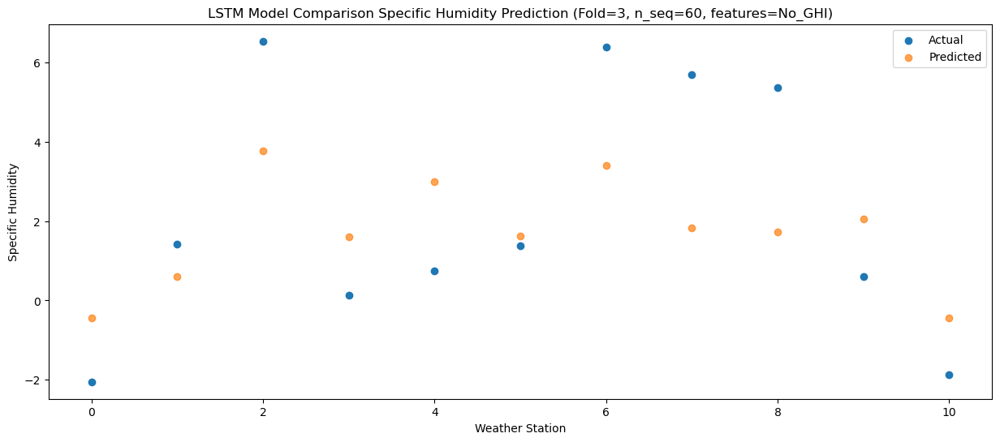

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01   1.506712
1                 1    2.96   2.556770
2                 2    7.22   5.713538
3                 3    2.04   3.548574
4                 4    2.57   4.941252
5                 5    3.64   3.569416
6                 6    7.08   5.361000
7                 7    5.40   3.782638
8                 8    5.80   3.680123
9                 9    1.52   4.000853
10               10   -0.28   1.517078


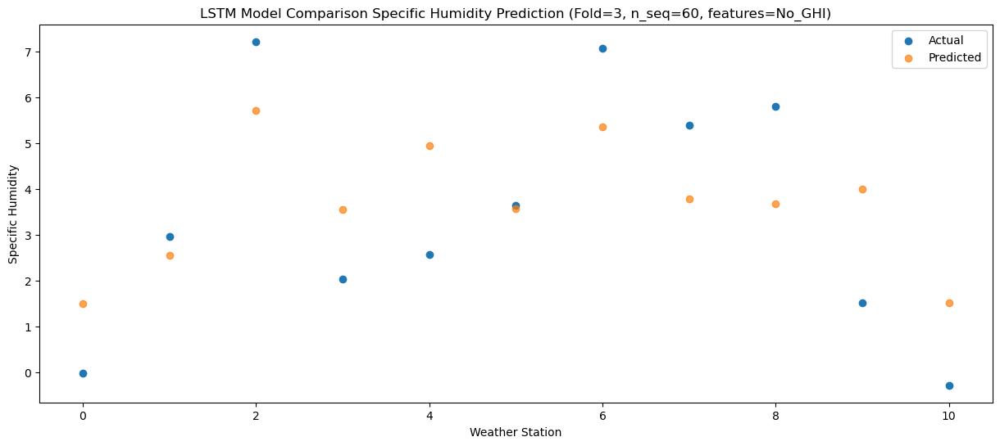

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86   5.279696
1                 1    7.46   6.330764
2                 2    7.09   9.486429
3                 3    6.15   7.322059
4                 4    6.71   8.717068
5                 5    7.31   7.344845
6                 6    7.97   9.133334
7                 7    5.27   7.554316
8                 8    5.96   7.451096
9                 9    4.98   7.775110
10               10    3.35   5.291894


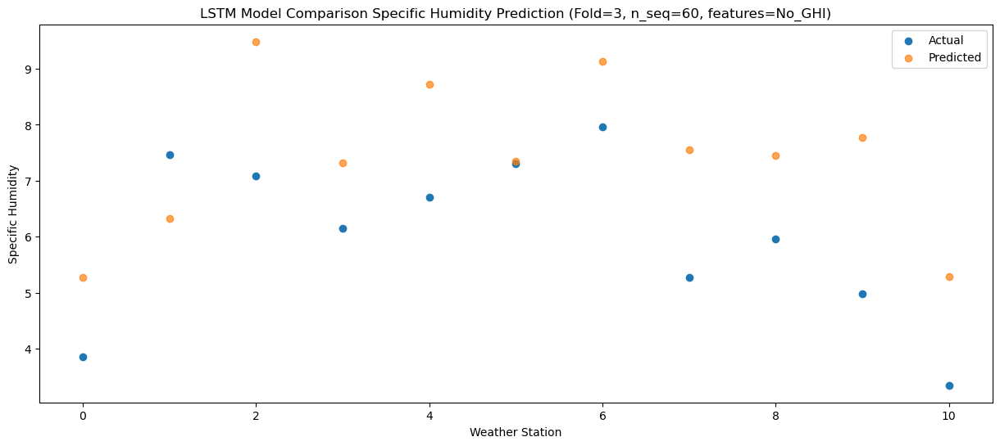

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59   7.541489
1                 1    9.74   8.591987
2                 2    8.36  11.746012
3                 3    7.95   9.582509
4                 4    8.68  10.976665
5                 5    9.13   9.604440
6                 6   10.26  11.394140
7                 7    6.67   9.814928
8                 8    7.11   9.709969
9                 9    7.85  10.034683
10               10    5.03   7.550839


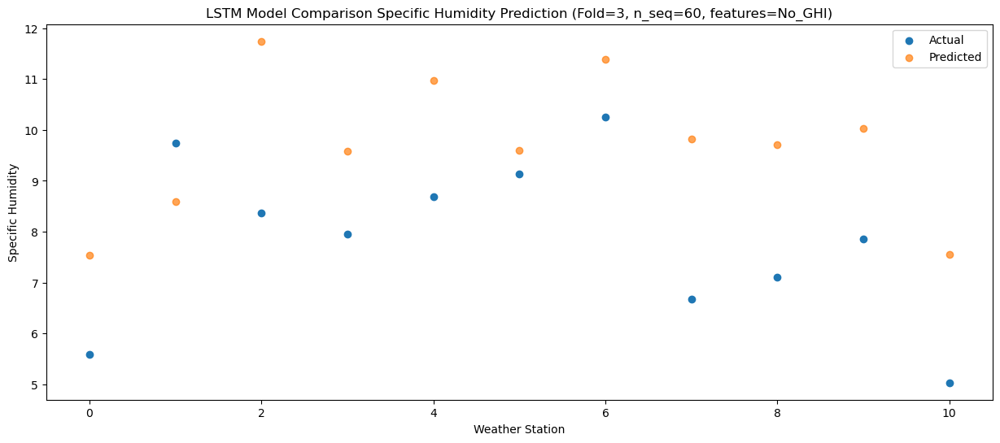

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45   9.284708
1                 1   10.23  10.335597
2                 2   10.34  13.489979
3                 3    8.85  11.326005
4                 4   10.25  12.720282
5                 5   10.32  11.347646
6                 6   10.31  13.139771
7                 7    7.70  11.560733
8                 8    8.69  11.453371
9                 9   11.02  11.779715
10               10    7.91   9.295508


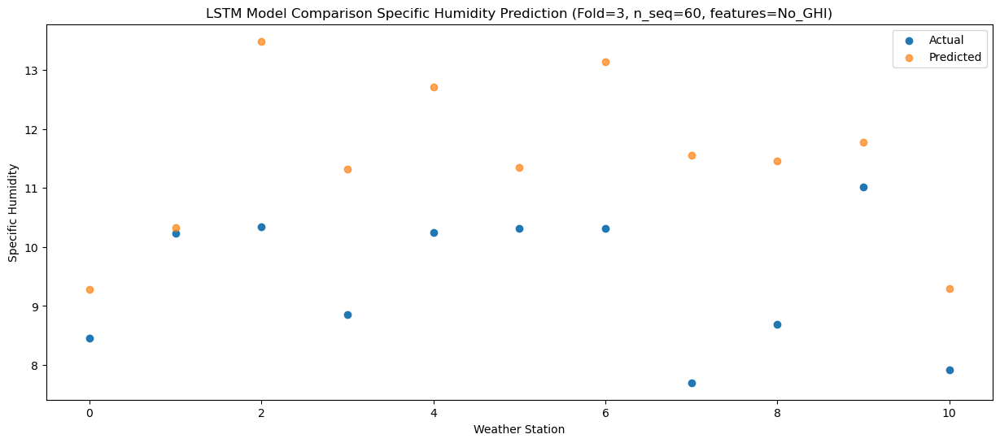

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01   8.437269
1                 1    9.49   9.488663
2                 2    8.65  12.641280
3                 3    7.53  10.479919
4                 4    9.77  11.873035
5                 5    9.76  10.503306
6                 6   11.77  12.292956
7                 7    8.52  10.712218
8                 8    7.96  10.601497
9                 9    9.67  10.932263
10               10    6.63   8.448860


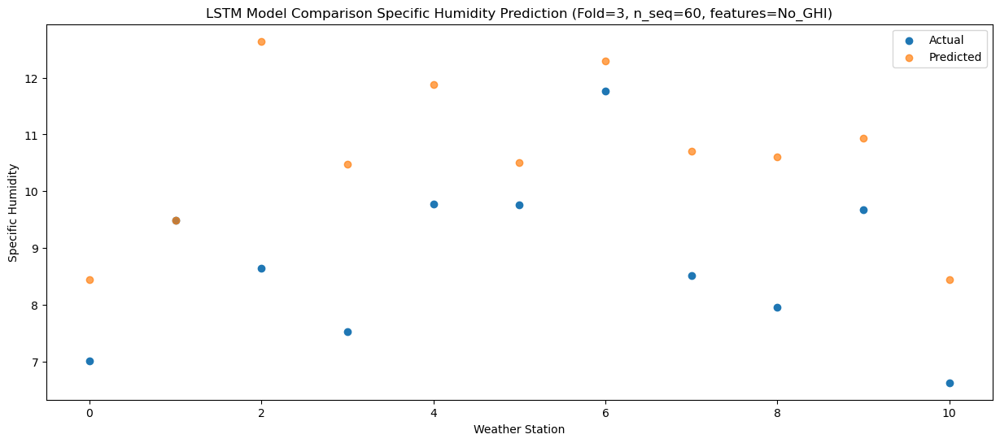

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30   6.016494
1                 1    6.50   7.066642
2                 2    8.92  10.221168
3                 3    5.99   8.058854
4                 4    6.76   9.449779
5                 5    7.14   8.080323
6                 6    9.35   9.872203
7                 7    6.80   8.293228
8                 8    7.64   8.184885
9                 9    6.31   8.512416
10               10    3.81   6.026723


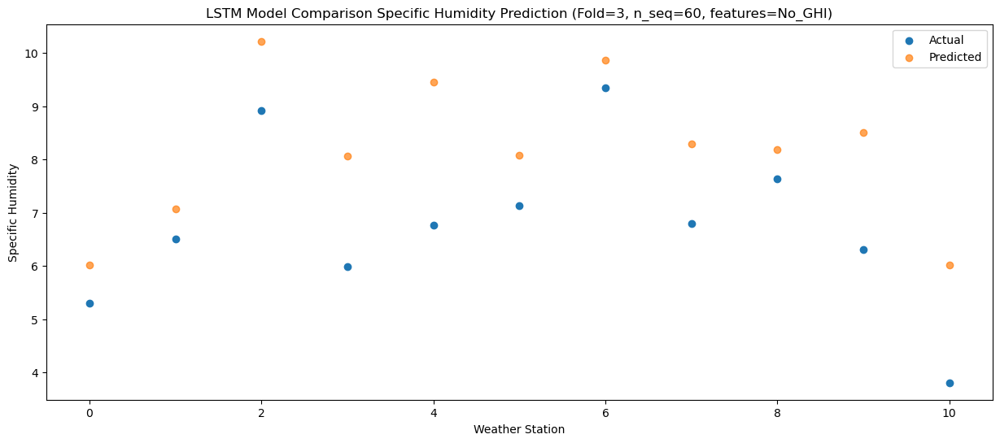

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48   1.854744
1                 1    2.27   2.907048
2                 2    7.81   6.061056
3                 3    2.24   3.899890
4                 4    2.40   5.292242
5                 5    3.27   3.923108
6                 6    7.59   5.714276
7                 7    5.75   4.133684
8                 8    6.05   4.024057
9                 9    3.21   4.354148
10               10   -0.19   1.867868


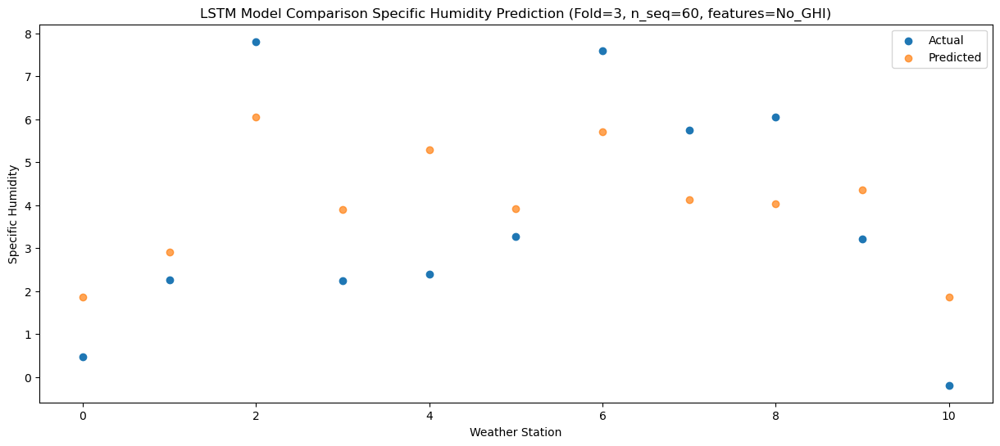

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (1, 1, 1024)              11632640  
                                                                 
 dropout_6 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_7 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_7 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_9 (Dense)             (1, 256)                  262400    
                                                                 
 dense_10 (Dense)            (1, 128)                  32896     
                                                                 
 dense_11 (Dense)            (1, 60)                  

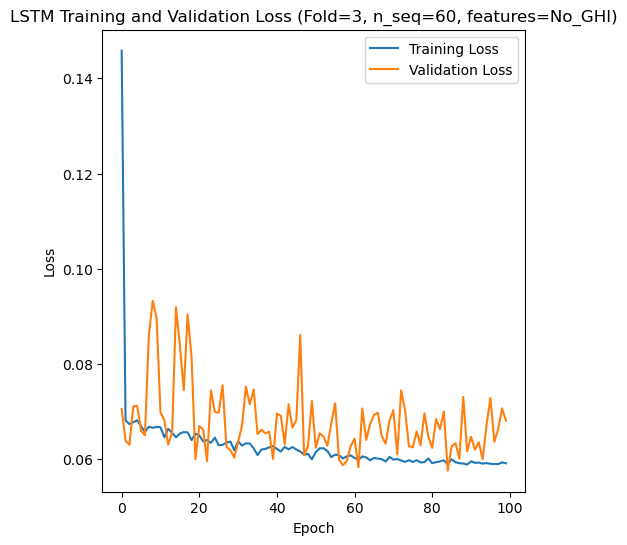

Epoch 1/100
84/84 [==============================] - 23s 109ms/step - loss: 0.1418 - accuracy: 0.2976 - mae: 0.1131 - rmse: 0.1418 - mape: 24.4086 - pearson: 0.6273 - val_loss: 0.0868 - val_accuracy: 0.7000 - val_mae: 0.0683 - val_rmse: 0.0868 - val_mape: 14.8234 - val_pearson: 0.7233
Epoch 2/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0676 - accuracy: 0.4167 - mae: 0.0534 - rmse: 0.0676 - mape: 12.1648 - pearson: 0.7674 - val_loss: 0.0605 - val_accuracy: 0.7000 - val_mae: 0.0471 - val_rmse: 0.0605 - val_mape: 10.3629 - val_pearson: 0.8030
Epoch 3/100
84/84 [==============================] - 4s 49ms/step - loss: 0.0699 - accuracy: 0.5000 - mae: 0.0549 - rmse: 0.0699 - mape: 12.4635 - pearson: 0.7600 - val_loss: 0.0622 - val_accuracy: 0.7000 - val_mae: 0.0493 - val_rmse: 0.0622 - val_mape: 11.1185 - val_pearson: 0.7843
Epoch 4/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0689 - accuracy: 0.4643 - mae: 0.0537 - rmse: 0.0689 - mape: 12.3196 -

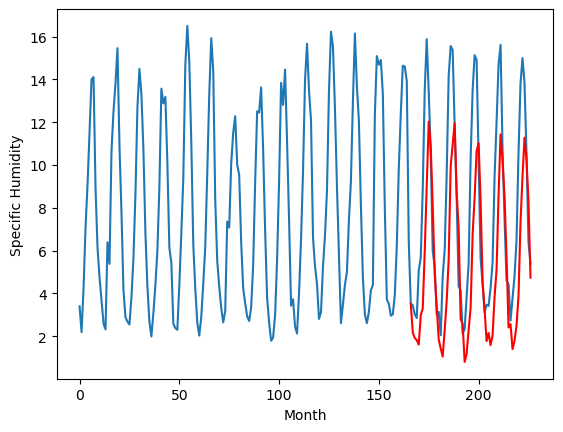

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		0.87		2.23
-1.22		0.61		1.83
-2.78		0.51		3.29
-1.94		0.31		2.25
-0.56		1.68		2.24
0.65		2.00		1.35
1.30		4.69		3.39
4.63		7.73		3.10
6.37		10.73		4.36
6.61		9.57		2.96
6.03		6.78		0.75
3.99		3.63		-0.36
0.93		2.09		1.16
-3.81		0.55		4.36
-3.46		0.13		3.59
-1.47		-0.25		1.22
-1.50		0.99		2.49
-0.75		2.35		3.10
0.58		4.29		3.71
4.87		8.64		3.77
6.08		9.64		3.56
6.47		10.66		4.19
5.67		7.43		1.76
2.75		5.73		2.98
-1.91		1.50		3.41
-0.17		1.28		1.45
-4.03		-0.50		3.53
-2.45		-0.11		2.34
-0.92		0.98		1.90
0.37		2.03		1.66
2.76		5.45		2.69
5.66		7.18		1.52
6.69		9.35		2.66
6.77		9.72		2.95
5.90		7.05		1.15
1.12		3.22		2.10
1.29		1.94		0.65
-2.23		0.47		2.70
-2.74		0.85		3.59
-0.80		0.27		1.07
-0.42		0.72		1.14
1.07		2.53		1.46
1.87		3.79		1.92
5.38		7.26		1.88
7.29		10.11		2.82
7.59		8.88		1.29
5.14		7.18		2.04
1.52		4.38		2.86
-0.78		1.09		1.87
-1.87		1.25		3.12
-2.91		0.08		2.99
-3.60		0.

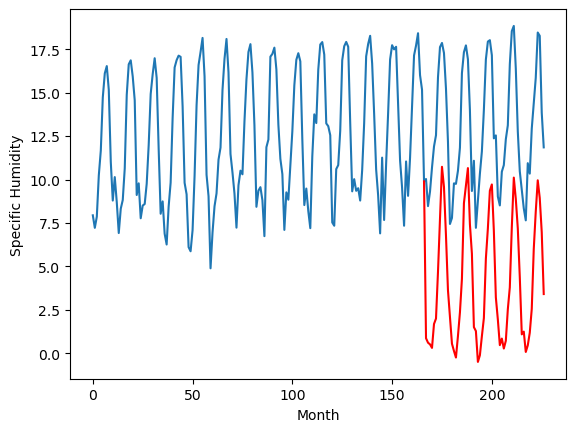

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		0.92		1.98
-0.22		0.67		0.89
-0.36		0.57		0.93
-0.55		0.37		0.92
3.00		1.75		-1.25
1.88		2.06		0.18
4.12		4.75		0.63
7.42		7.79		0.37
10.35		10.79		0.44
8.84		9.63		0.79
6.79		6.84		0.05
3.44		3.69		0.25
0.77		2.14		1.37
-1.61		0.61		2.22
-1.72		0.19		1.91
-1.84		-0.19		1.65
1.22		1.04		-0.18
1.47		2.41		0.94
4.91		4.34		-0.57
9.15		8.69		-0.46
10.80		9.69		-1.11
10.81		10.71		-0.10
7.87		7.47		-0.40
5.09		5.78		0.69
-0.35		1.54		1.89
2.60		1.32		-1.28
-2.13		-0.45		1.68
-1.28		-0.07		1.21
-0.23		1.03		1.26
2.22		2.07		-0.15
6.82		5.50		-1.32
9.20		7.23		-1.97
11.04		9.40		-1.64
10.86		9.76		-1.10
6.62		7.08		0.46
1.66		3.25		1.59
0.91		1.98		1.07
0.37		0.50		0.13
0.27		0.88		0.61
0.94		0.31		-0.63
1.27		0.75		-0.52
2.11		2.56		0.45
5.49		3.83		-1.66
9.06		7.29		-1.77
10.65		10.14		-0.51
9.07		8.92		-0.15
6.05		7.21		1.16
2.12		4.41		2.29
0.14		1.11		0.97
-1.17		1.27		2.44
-1.89		0.11	

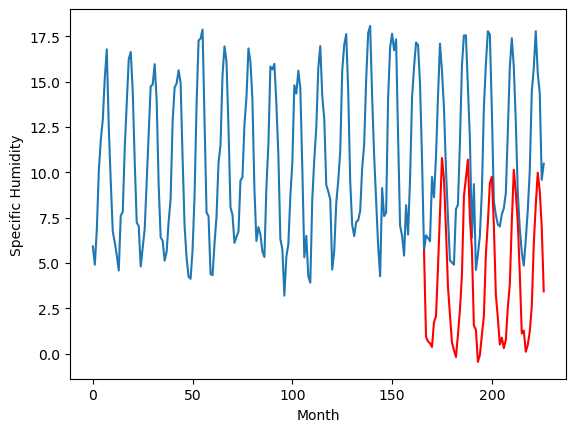

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		0.79		-0.33
0.12		0.53		0.41
0.76		0.43		-0.33
0.14		0.22		0.08
4.09		1.60		-2.49
3.69		1.91		-1.78
6.85		4.60		-2.25
9.01		7.63		-1.38
12.24		10.64		-1.60
9.65		9.47		-0.18
8.44		6.69		-1.75
3.87		3.53		-0.34
2.23		1.98		-0.25
-0.37		0.45		0.82
-0.48		0.03		0.51
-0.80		-0.35		0.45
1.86		0.88		-0.98
3.15		2.25		-0.90
7.15		4.18		-2.97
10.84		8.52		-2.32
11.41		9.53		-1.88
11.80		10.54		-1.26
7.79		7.30		-0.49
4.94		5.60		0.66
1.32		1.37		0.05
3.18		1.15		-2.03
-1.48		-0.63		0.85
-0.95		-0.25		0.70
0.64		0.85		0.21
4.15		1.90		-2.25
8.14		5.32		-2.82
9.91		7.05		-2.86
9.33		9.22		-0.11
10.34		9.58		-0.76
7.06		6.91		-0.15
2.60		3.08		0.48
2.42		1.80		-0.62
0.84		0.32		-0.52
0.15		0.70		0.55
0.51		0.13		-0.38
2.57		0.57		-2.00
3.25		2.38		-0.87
7.51		3.64		-3.87
11.45		7.11		-4.34
11.30		9.96		-1.34
9.20		8.73		-0.47
8.30		7.03		-1.27
4.58		4.23		-0.35
2.05		0.93		-1.12
0.30		1.09		0.79
-

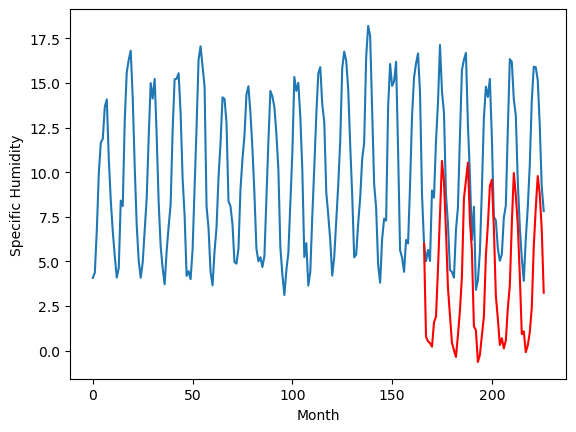

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		0.35		-0.26
-0.36		0.09		0.45
0.33		-0.01		-0.34
-0.33		-0.22		0.11
3.57		1.16		-2.41
3.06		1.47		-1.59
6.30		4.15		-2.15
8.28		7.18		-1.10
11.43		10.19		-1.24
8.78		9.02		0.24
7.89		6.24		-1.65
3.12		3.08		-0.04
1.76		1.54		-0.22
-0.81		0.00		0.81
-0.85		-0.41		0.44
-1.30		-0.80		0.50
1.28		0.43		-0.85
2.64		1.80		-0.84
6.93		3.73		-3.20
10.81		8.08		-2.73
11.19		9.08		-2.11
11.30		10.09		-1.21
7.40		6.85		-0.55
4.67		5.15		0.48
1.06		0.92		-0.14
2.47		0.70		-1.77
-1.86		-1.08		0.78
-1.42		-0.70		0.72
0.10		0.40		0.30
3.78		1.45		-2.33
7.66		4.87		-2.79
9.34		6.59		-2.75
8.84		8.76		-0.08
10.01		9.13		-0.88
6.86		6.46		-0.40
2.40		2.62		0.22
1.98		1.34		-0.64
0.39		-0.14		-0.53
-0.36		0.24		0.60
0.04		-0.33		-0.37
2.01		0.12		-1.89
2.86		1.92		-0.94
7.13		3.19		-3.94
10.61		6.65		-3.96
9.71		9.50		-0.21
8.33		8.27		-0.06
8.00		6.57		-1.43
4.34		3.77		-0.57
1.92		0.47		-1.45
0.16		0.63	

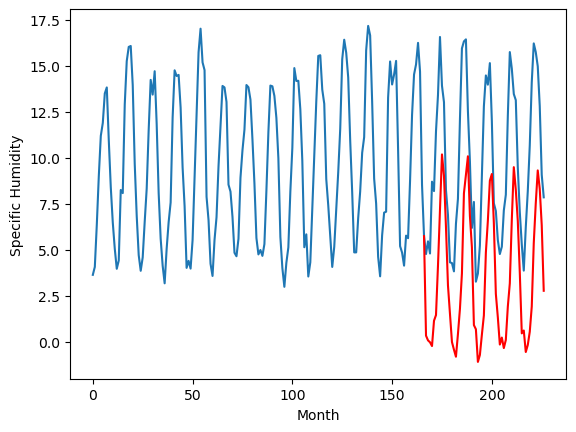

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		4.89		-2.03
5.68		4.63		-1.05
5.56		4.53		-1.03
5.44		4.33		-1.11
8.24		5.70		-2.54
7.49		6.00		-1.49
9.76		8.69		-1.07
11.47		11.72		0.25
12.70		14.73		2.03
11.39		13.56		2.17
11.20		10.78		-0.42
7.55		7.62		0.07
7.09		6.08		-1.01
4.53		4.54		0.01
5.23		4.13		-1.10
4.59		3.74		-0.85
6.08		4.98		-1.10
7.04		6.35		-0.69
11.59		8.28		-3.31
13.89		12.63		-1.26
14.92		13.63		-1.29
14.64		14.64		-0.00
11.39		11.40		0.01
8.34		9.70		1.36
6.62		5.47		-1.15
5.77		5.25		-0.52
4.31		3.47		-0.84
4.30		3.85		-0.45
4.89		4.95		0.06
6.92		6.00		-0.92
9.18		9.42		0.24
12.03		11.15		-0.88
12.72		13.32		0.60
14.71		13.68		-1.03
13.46		11.02		-2.44
9.95		7.18		-2.77
7.25		5.90		-1.35
6.61		4.42		-2.19
5.06		4.81		-0.25
5.18		4.24		-0.94
6.47		4.68		-1.79
6.44		6.49		0.05
11.28		7.76		-3.52
15.14		11.22		-3.92
12.81		14.07		1.26
11.95		12.84		0.89
12.46		11.15		-1.31
10.33		8.34		-1.99
8.03		5.04		-2.99
6

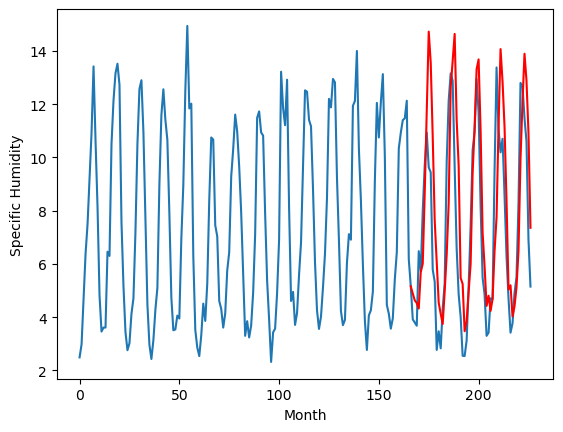

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		2.86		2.40
0.53		2.61		2.08
0.37		2.51		2.14
0.95		2.31		1.36
3.14		3.68		0.54
2.47		3.99		1.52
5.59		6.68		1.09
9.42		9.71		0.29
12.01		12.72		0.71
12.22		11.55		-0.67
8.38		8.76		0.38
5.73		5.60		-0.13
2.90		4.06		1.16
-0.44		2.52		2.96
-0.56		2.11		2.67
-0.31		1.73		2.04
1.40		2.96		1.56
1.81		4.32		2.51
4.79		6.25		1.46
9.48		10.59		1.11
11.08		11.60		0.52
11.46		12.61		1.15
7.88		9.38		1.50
5.67		7.68		2.01
-0.05		3.44		3.49
1.81		3.22		1.41
-1.17		1.44		2.61
0.15		1.83		1.68
0.99		2.92		1.93
2.05		3.97		1.92
6.06		7.39		1.33
8.34		9.12		0.78
11.50		11.29		-0.21
10.31		11.65		1.34
6.76		8.97		2.21
2.08		5.14		3.06
1.90		3.86		1.96
-0.09		2.39		2.48
0.54		2.77		2.23
1.58		2.19		0.61
1.07		2.63		1.56
2.67		4.44		1.77
4.89		5.71		0.82
7.94		9.16		1.22
11.33		12.02		0.69
10.87		10.79		-0.08
7.42		9.09		1.67
3.51		6.29		2.78
0.56		2.98		2.42
0.28		3.14		2.86
-0.50		1.97		2.47
-0.32		2.3

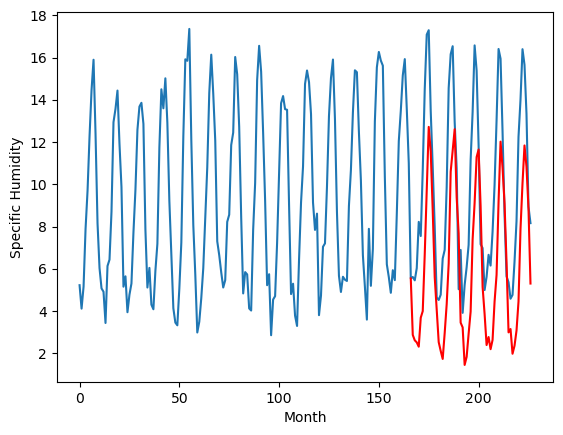

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		1.03		0.36
0.40		0.77		0.37
0.16		0.67		0.51
-0.07		0.47		0.54
2.48		1.84		-0.64
2.80		2.15		-0.65
6.18		4.84		-1.34
9.79		7.87		-1.92
11.84		10.88		-0.96
9.19		9.71		0.52
7.59		6.93		-0.66
3.04		3.77		0.73
1.37		2.22		0.85
-0.56		0.68		1.24
-0.71		0.27		0.98
-1.34		-0.11		1.23
1.03		1.12		0.09
1.95		2.48		0.53
5.11		4.41		-0.70
9.71		8.76		-0.95
10.66		9.76		-0.90
10.40		10.77		0.37
7.14		7.53		0.39
5.05		5.84		0.79
0.36		1.60		1.24
1.83		1.38		-0.45
-1.37		-0.39		0.98
-0.86		-0.01		0.85
0.65		1.08		0.43
2.44		2.13		-0.31
7.15		5.56		-1.59
9.51		7.29		-2.22
10.31		9.46		-0.85
10.78		9.81		-0.97
6.97		7.14		0.17
2.31		3.30		0.99
0.95		2.03		1.08
0.08		0.55		0.47
0.36		0.93		0.57
0.17		0.36		0.19
0.93		0.80		-0.13
1.83		2.61		0.78
6.22		3.87		-2.35
8.78		7.34		-1.44
11.57		10.19		-1.38
11.85		8.97		-2.88
7.65		7.27		-0.38
4.04		4.47		0.43
1.01		1.16		0.15
0.20		1.32		1.12
-0.95		0.15		1.

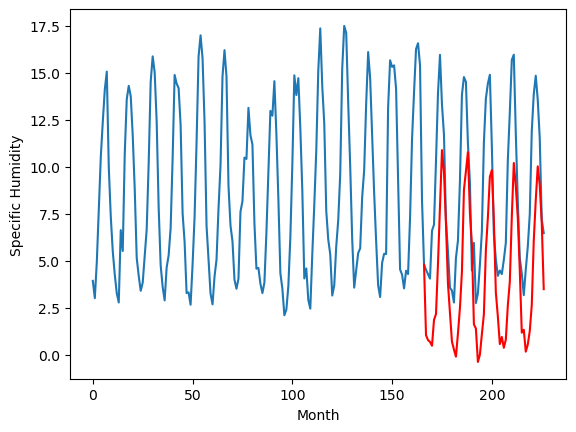

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		0.59		0.46
0.30		0.34		0.04
-0.07		0.24		0.31
-0.47		0.04		0.51
1.45		1.41		-0.04
1.73		1.72		-0.01
4.88		4.41		-0.47
7.62		7.44		-0.18
10.84		10.45		-0.39
9.17		9.28		0.11
6.25		6.50		0.25
2.87		3.33		0.46
1.19		1.79		0.60
-0.41		0.25		0.66
-0.76		-0.16		0.60
-1.33		-0.54		0.79
0.61		0.69		0.08
1.94		2.05		0.11
4.23		3.98		-0.25
9.29		8.33		-0.96
10.55		9.33		-1.22
10.69		10.34		-0.35
7.21		7.11		-0.10
6.06		5.41		-0.65
0.29		1.18		0.89
1.00		0.96		-0.04
-1.38		-0.82		0.56
-0.80		-0.44		0.36
0.51		0.66		0.15
2.00		1.71		-0.29
6.02		5.13		-0.89
7.46		6.86		-0.60
10.20		9.03		-1.17
9.84		9.39		-0.45
7.18		6.71		-0.47
1.85		2.88		1.03
0.81		1.60		0.79
-0.15		0.13		0.28
0.47		0.51		0.04
0.07		-0.07		-0.14
0.42		0.37		-0.05
1.87		2.18		0.31
4.12		3.45		-0.67
6.08		6.91		0.83
10.38		9.77		-0.61
9.84		8.54		-1.30
7.04		6.85		-0.19
3.71		4.04		0.33
0.64		0.74		0.10
0.61		0.90		0.29
-0.47		-0.2

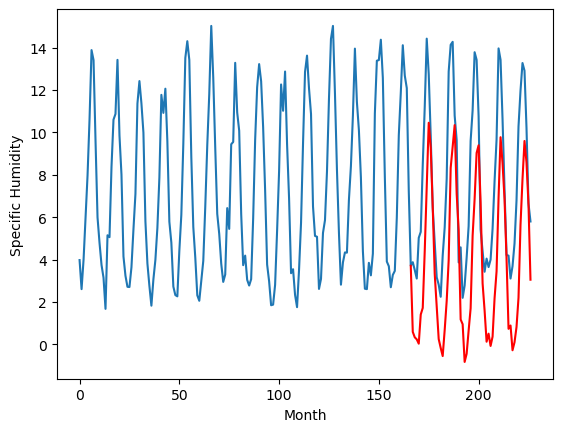

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-0.56		-0.02
-0.37		-0.82		-0.45
-0.85		-0.92		-0.07
-1.12		-1.12		-0.00
0.93		0.25		-0.68
1.52		0.56		-0.96
5.24		3.25		-1.99
7.72		6.29		-1.43
11.28		9.29		-1.99
9.09		8.13		-0.96
6.31		5.34		-0.97
2.15		2.17		0.02
1.06		0.63		-0.43
-0.85		-0.91		-0.06
-1.17		-1.32		-0.15
-1.81		-1.71		0.10
0.56		-0.47		-1.03
1.87		0.89		-0.98
4.49		2.82		-1.67
9.24		7.17		-2.07
10.64		8.17		-2.47
10.89		9.19		-1.70
6.86		5.95		-0.91
4.99		4.25		-0.74
-0.30		0.02		0.32
0.24		-0.20		-0.44
-2.00		-1.97		0.03
-1.30		-1.59		-0.29
0.22		-0.49		-0.71
1.52		0.56		-0.96
5.59		3.98		-1.61
7.83		5.71		-2.12
10.47		7.89		-2.58
9.70		8.24		-1.46
6.33		5.56		-0.77
1.57		1.73		0.16
0.20		0.46		0.26
-0.91		-1.02		-0.11
-0.39		-0.64		-0.25
-0.62		-1.21		-0.59
-0.01		-0.78		-0.77
1.50		1.04		-0.46
4.28		2.30		-1.98
5.92		5.77		-0.15
10.62		8.63		-1.99
10.49		7.40		-3.09
6.71		5.71		-1.00
3.27		2.90		-0.37
-0.12		-0.

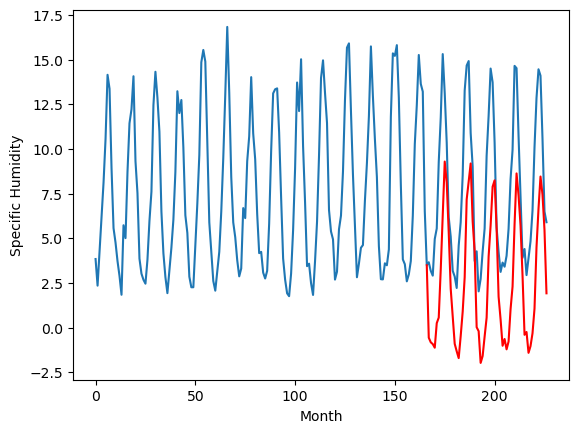

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		2.16		0.63
1.68		1.91		0.23
1.34		1.81		0.47
0.99		1.61		0.62
2.56		2.98		0.42
2.40		3.30		0.90
5.02		5.98		0.96
8.21		9.02		0.81
11.13		12.03		0.90
9.71		10.86		1.15
7.57		8.07		0.50
4.53		4.91		0.38
2.60		3.36		0.76
1.27		1.82		0.55
0.89		1.41		0.52
0.32		1.02		0.70
1.61		2.26		0.65
3.28		3.62		0.34
4.88		5.55		0.67
9.89		9.90		0.01
11.16		10.90		-0.26
12.03		11.92		-0.11
8.27		8.68		0.41
7.26		6.99		-0.27
2.02		2.76		0.74
1.98		2.53		0.55
0.24		0.75		0.51
0.69		1.14		0.45
1.84		2.23		0.39
2.83		3.28		0.45
6.29		6.71		0.42
8.20		8.44		0.24
9.93		10.61		0.68
10.39		10.97		0.58
8.40		8.29		-0.11
3.58		4.46		0.88
2.86		3.19		0.33
1.41		1.72		0.31
2.03		2.10		0.07
1.28		1.52		0.24
1.49		1.95		0.46
3.19		3.77		0.58
4.09		5.03		0.94
7.33		8.50		1.17
10.95		11.36		0.41
10.15		10.13		-0.02
8.44		8.44		-0.00
5.38		5.64		0.26
1.94		2.33		0.39
2.46		2.49		0.03
1.39		1.32		-0.07
1.41		1.70		0.29

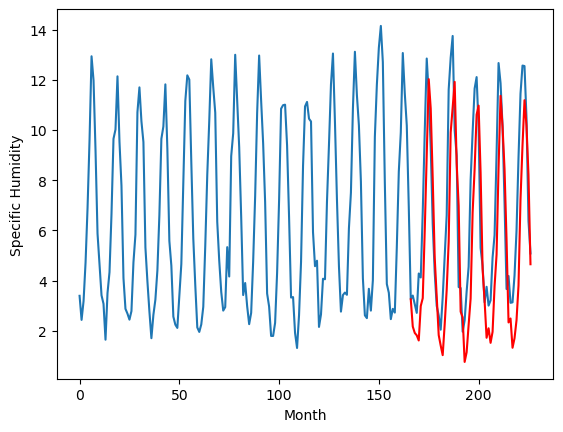

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[2.169372053146362, 0.8658265304565429, 0.9244077014923096, 0.7852440738677977, 0.3468517303466796, 4.887901248931885, 2.8647808265686034, 1.026061372756958, 0.5942148208618163, -0.5644853210449217, 2.164754362106323]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33   2.169372
1                 1   -1.36   0.865827
2                 2   -1.06   0.924408
3                 3    1.12   0.785244
4                 4    0.61   0.346852
5                 5    6.92   4.887901
6                 6    0.46   2.864781
7                 7    0.67   1.026061
8                 8    0.13   0.594215
9                 9   -0.54  -0.564485
10               10    1.53   2.164754


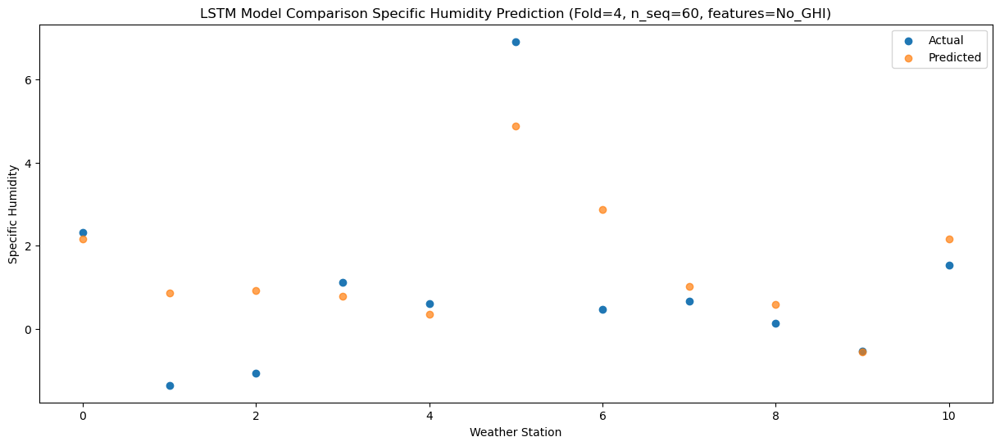

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   1.916236
1                 1   -1.22   0.609529
2                 2   -0.22   0.670470
3                 3    0.12   0.529140
4                 4   -0.36   0.091162
5                 5    5.68   4.633296
6                 6    0.53   2.609649
7                 7    0.40   0.769967
8                 8    0.30   0.338448
9                 9   -0.37  -0.820843
10               10    1.68   1.909957


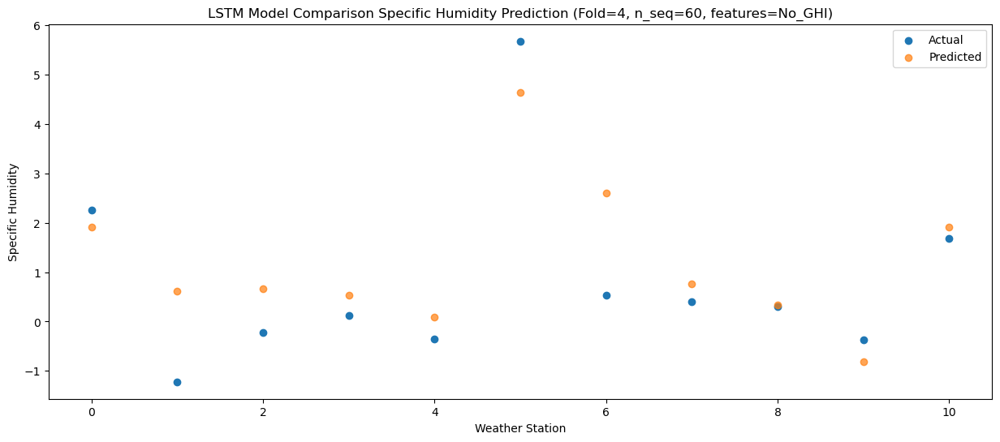

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84   1.817014
1                 1   -2.78   0.512091
2                 2   -0.36   0.572892
3                 3    0.76   0.428234
4                 4    0.33  -0.011849
5                 5    5.56   4.530339
6                 6    0.37   2.510307
7                 7    0.16   0.670471
8                 8   -0.07   0.241435
9                 9   -0.85  -0.919901
10               10    1.34   1.812715


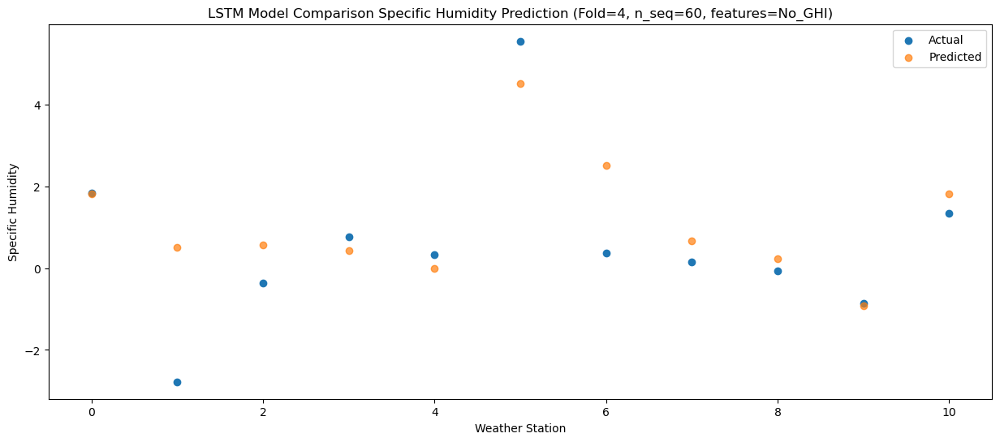

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   1.610465
1                 1   -1.94   0.309951
2                 2   -0.55   0.370708
3                 3    0.14   0.223581
4                 4   -0.33  -0.216788
5                 5    5.44   4.325035
6                 6    0.95   2.307166
7                 7   -0.07   0.467166
8                 8   -0.47   0.038074
9                 9   -1.12  -1.123833
10               10    0.99   1.608783


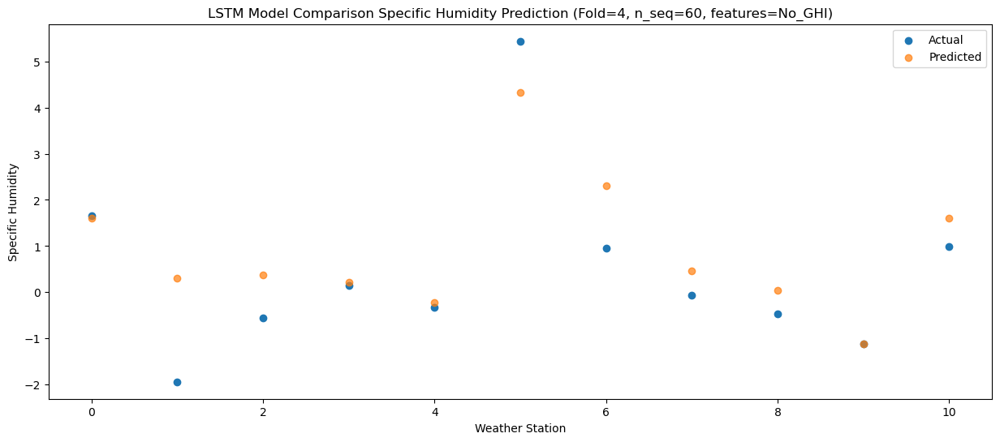

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   2.981657
1                 1   -0.56   1.684796
2                 2    3.00   1.747516
3                 3    4.09   1.597501
4                 4    3.57   1.155871
5                 5    8.24   5.695423
6                 6    3.14   3.680725
7                 7    2.48   1.841367
8                 8    1.45   1.412045
9                 9    0.93   0.250708
10               10    2.56   2.982558


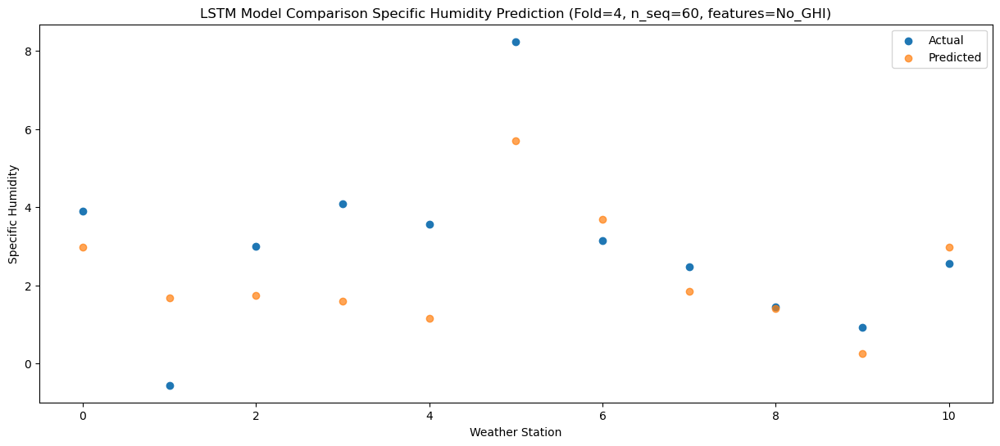

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   3.295964
1                 1    0.65   1.996382
2                 2    1.88   2.059332
3                 3    3.69   1.907470
4                 4    3.06   1.465573
5                 5    7.49   6.004987
6                 6    2.47   3.991310
7                 7    2.80   2.151192
8                 8    1.73   1.723077
9                 9    1.52   0.562028
10               10    2.40   3.295643


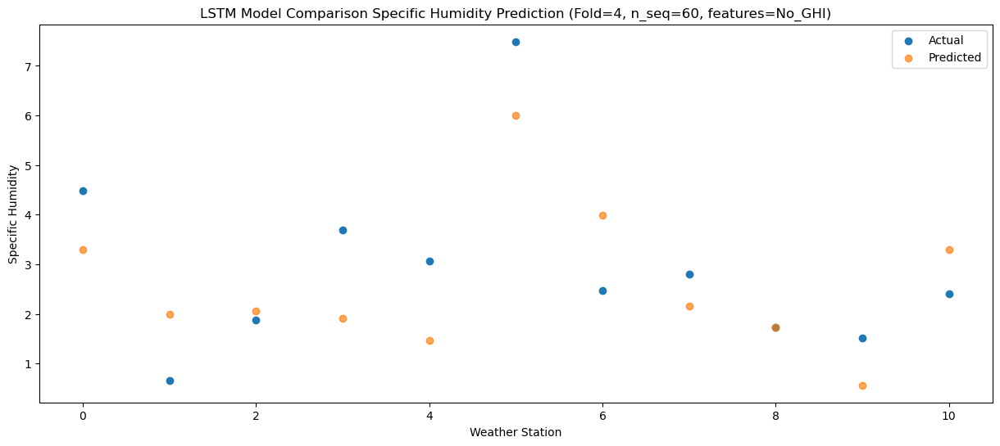

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   5.987621
1                 1    1.30   4.690468
2                 2    4.12   4.751804
3                 3    6.85   4.596481
4                 4    6.30   4.153684
5                 5    9.76   8.691430
6                 6    5.59   6.679740
7                 7    6.18   4.840355
8                 8    4.88   4.412839
9                 9    5.24   3.253153
10               10    5.02   5.984933


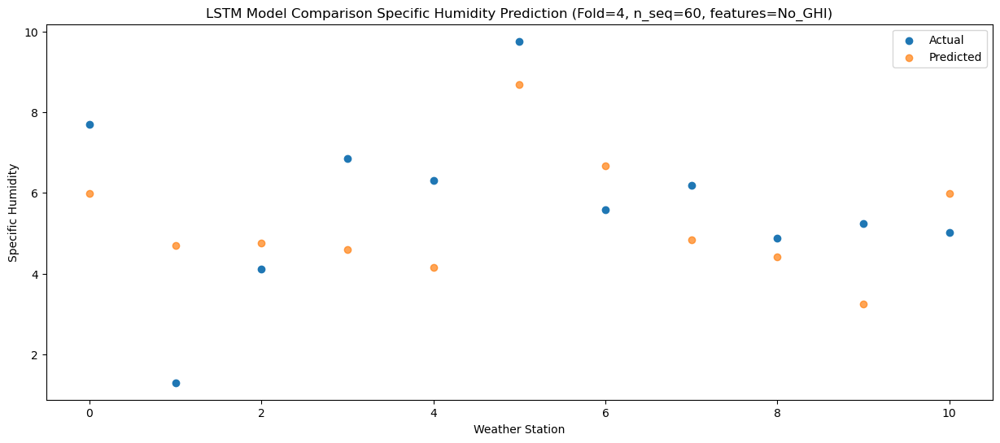

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34   9.022089
1                 1    4.63   7.727208
2                 2    7.42   7.786162
3                 3    9.01   7.629079
4                 4    8.28   7.184537
5                 5   11.47  11.719651
6                 6    9.42   9.710053
7                 7    9.79   7.871245
8                 8    7.62   7.444983
9                 9    7.72   6.286034
10               10    8.21   9.018971


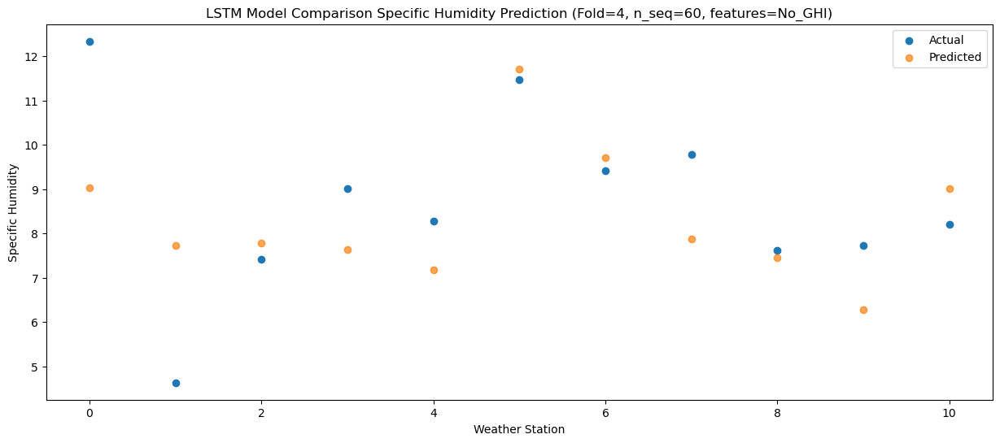

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69  12.025790
1                 1    6.37  10.732560
2                 2   10.35  10.794685
3                 3   12.24  10.635364
4                 4   11.43  10.190679
5                 5   12.70  14.726495
6                 6   12.01  12.719157
7                 7   11.84  10.880607
8                 8   10.84  10.454262
9                 9   11.28   9.294933
10               10   11.13  12.028009


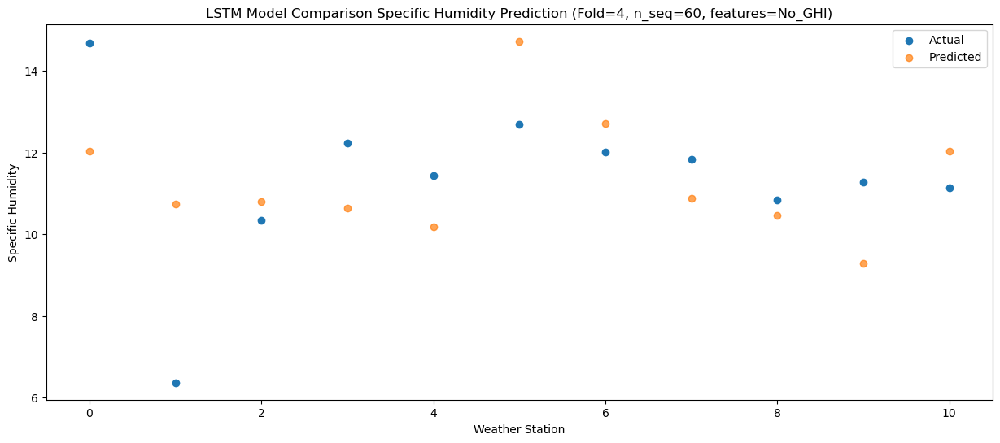

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26  10.865157
1                 1    6.61   9.568480
2                 2    8.84   9.630369
3                 3    9.65   9.470745
4                 4    8.78   9.024977
5                 5   11.39  13.561226
6                 6   12.22  11.550678
7                 7    9.19   9.713125
8                 8    9.17   9.284622
9                 9    9.09   8.125519
10               10    9.71  10.856798


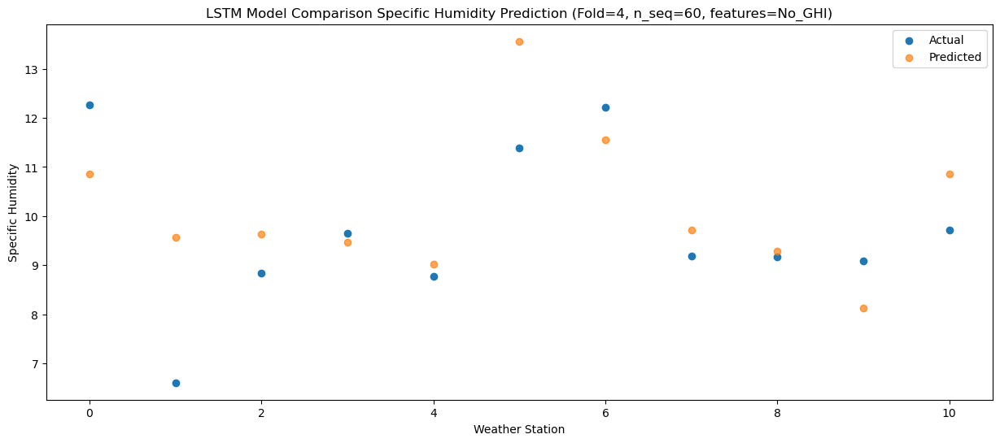

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   8.080528
1                 1    6.03   6.782776
2                 2    6.79   6.843992
3                 3    8.44   6.685701
4                 4    7.89   6.241630
5                 5   11.20  10.778655
6                 6    8.38   8.763784
7                 7    7.59   6.926338
8                 8    6.25   6.496108
9                 9    6.31   5.336857
10               10    7.57   8.066574


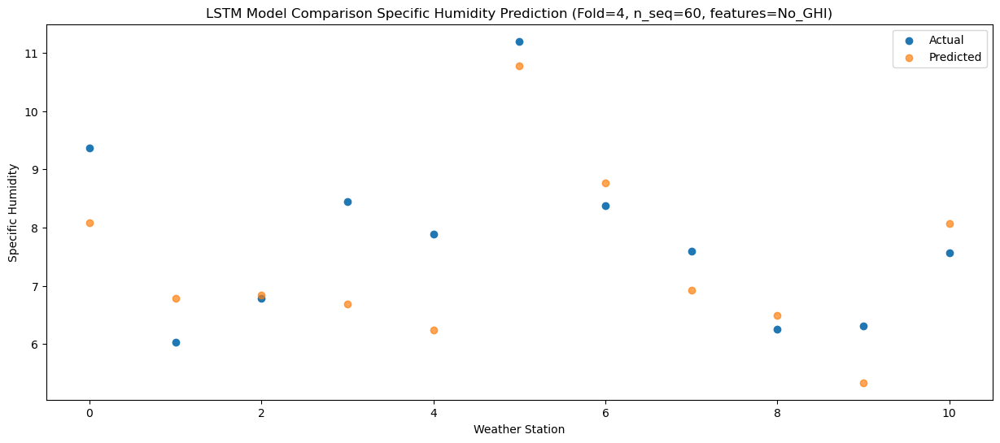

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   4.923701
1                 1    3.99   3.628421
2                 2    3.44   3.686670
3                 3    3.87   3.527115
4                 4    3.12   3.081833
5                 5    7.55   7.620572
6                 6    5.73   5.604784
7                 7    3.04   3.765259
8                 8    2.87   3.334677
9                 9    2.15   2.174447
10               10    4.53   4.905877


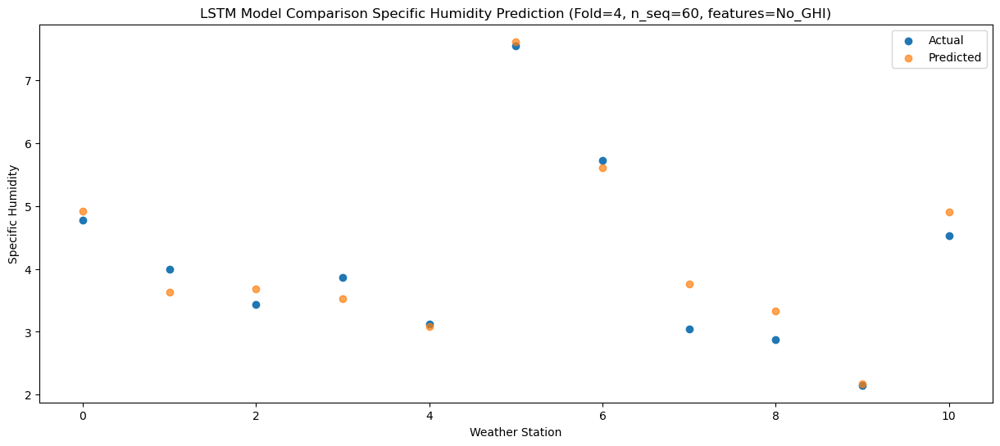

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   3.380350
1                 1    0.93   2.086444
2                 2    0.77   2.141481
3                 3    2.23   1.981333
4                 4    1.76   1.536417
5                 5    7.09   6.076659
6                 6    2.90   4.059398
7                 7    1.37   2.218754
8                 8    1.19   1.788482
9                 9    1.06   0.628213
10               10    2.60   3.359269


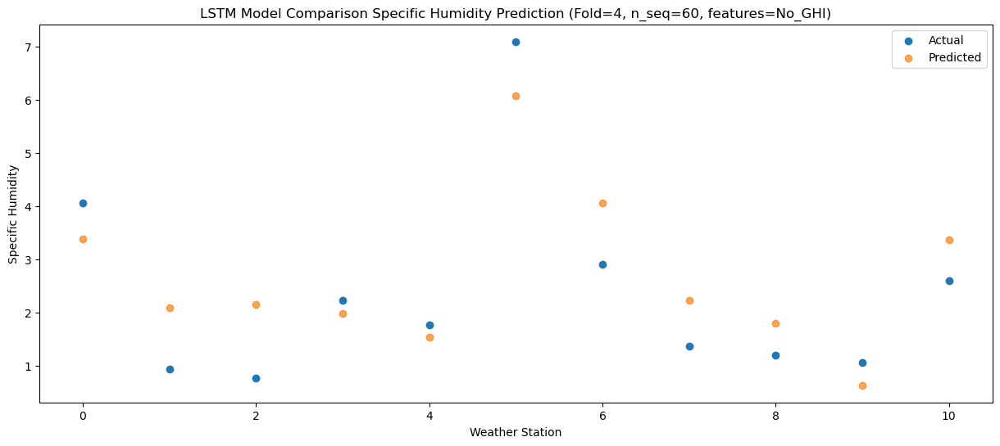

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   1.848628
1                 1   -3.81   0.552951
2                 2   -1.61   0.606817
3                 3   -0.37   0.446455
4                 4   -0.81   0.002489
5                 5    4.53   4.544744
6                 6   -0.44   2.523707
7                 7   -0.56   0.684555
8                 8   -0.41   0.254917
9                 9   -0.85  -0.905062
10               10    1.27   1.823826


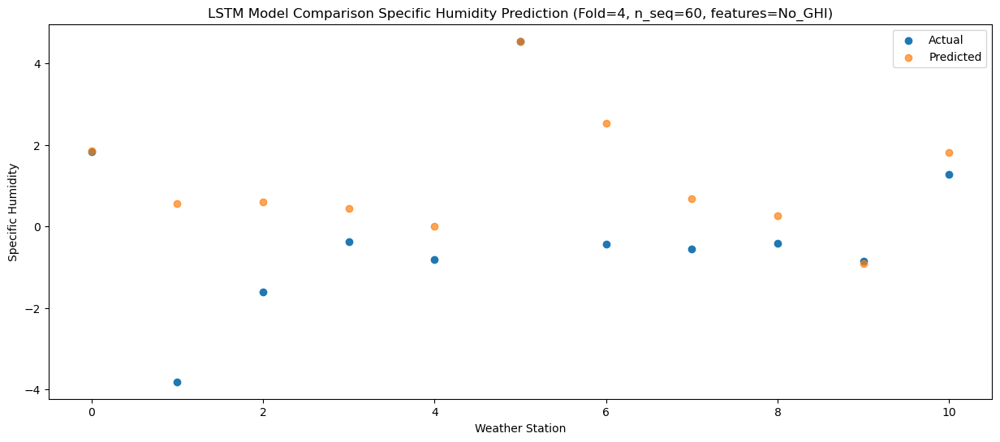

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95   1.430972
1                 1   -3.46   0.134847
2                 2   -1.72   0.192520
3                 3   -0.48   0.031088
4                 4   -0.85  -0.413933
5                 5    5.23   4.127826
6                 6   -0.56   2.107156
7                 7   -0.71   0.266430
8                 8   -0.76  -0.162574
9                 9   -1.17  -1.321797
10               10    0.89   1.405708


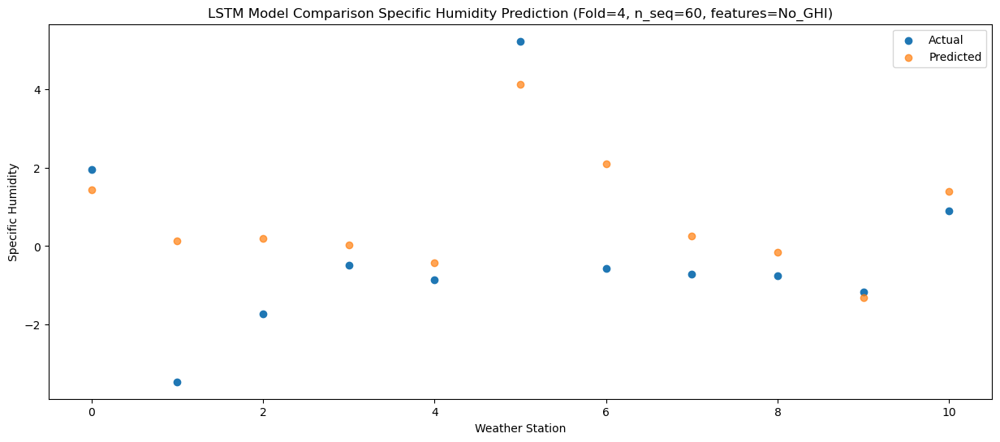

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86   1.050098
1                 1   -1.47  -0.246150
2                 2   -1.84  -0.187122
3                 3   -0.80  -0.350998
4                 4   -1.30  -0.797789
5                 5    4.59   3.744971
6                 6   -0.31   1.727895
7                 7   -1.34  -0.114908
8                 8   -1.33  -0.544317
9                 9   -1.81  -1.705835
10               10    0.32   1.024364


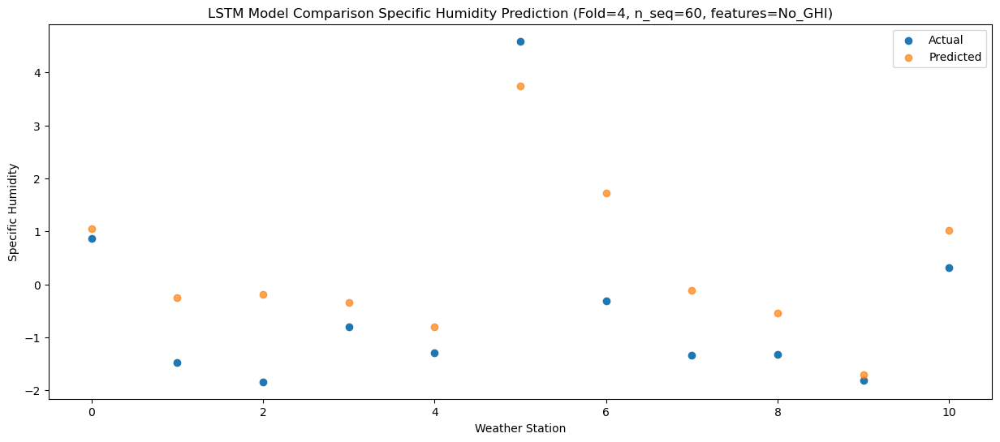

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62   2.287111
1                 1   -1.50   0.986190
2                 2    1.22   1.042441
3                 3    1.86   0.879918
4                 4    1.28   0.434404
5                 5    6.08   4.979414
6                 6    1.40   2.956448
7                 7    1.03   1.115679
8                 8    0.61   0.685378
9                 9    0.56  -0.473237
10               10    1.61   2.255239


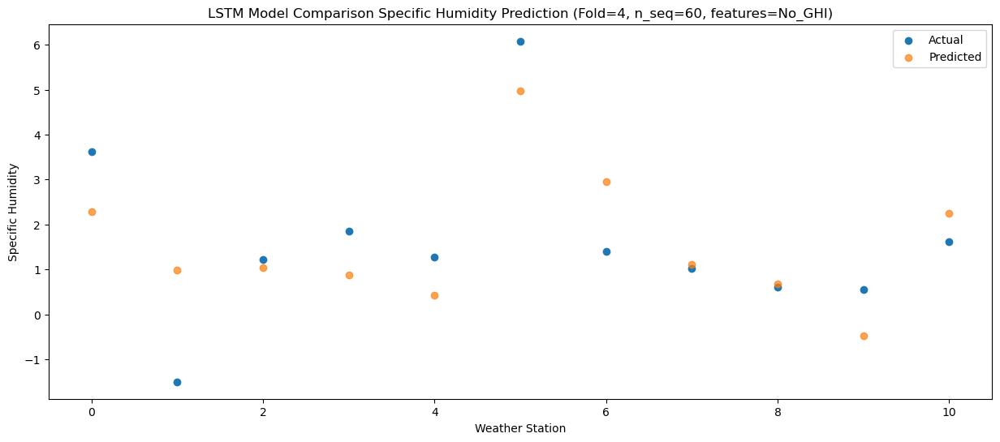

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.655677
1                 1   -0.75   2.353709
2                 2    1.47   2.408878
3                 3    3.15   2.245822
4                 4    2.64   1.800622
5                 5    7.04   6.346092
6                 6    1.81   4.318585
7                 7    1.95   2.480508
8                 8    1.94   2.050698
9                 9    1.87   0.893617
10               10    3.28   3.623349


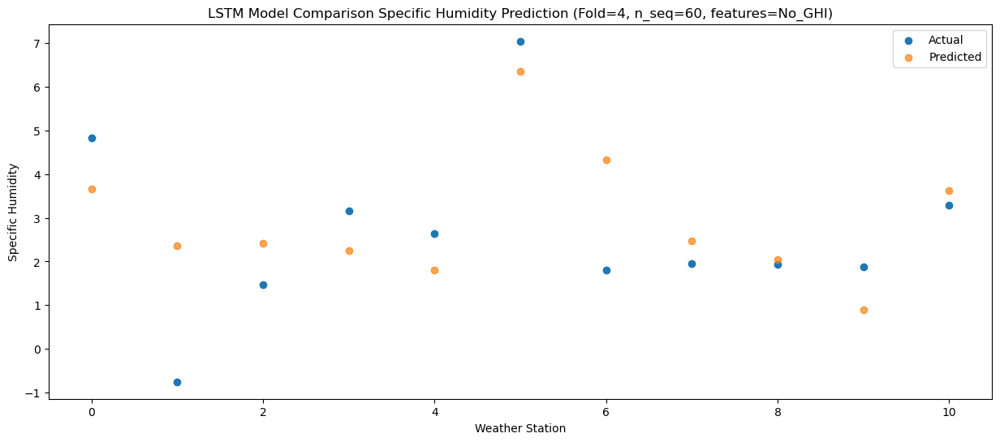

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   5.587264
1                 1    0.58   4.287514
2                 2    4.91   4.341054
3                 3    7.15   4.177691
4                 4    6.93   3.731225
5                 5   11.59   8.278148
6                 6    4.79   6.248110
7                 7    5.11   4.410891
8                 8    4.23   3.978479
9                 9    4.49   2.821818
10               10    4.88   5.549332


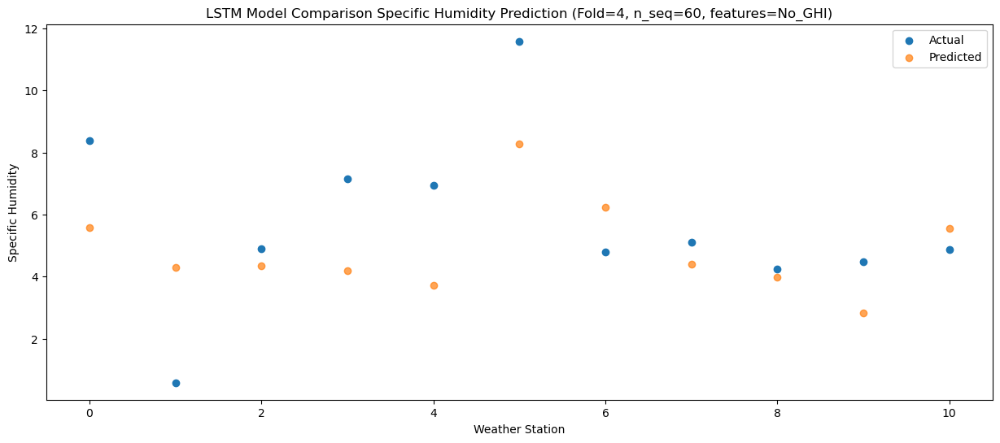

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98   9.940919
1                 1    4.87   8.637581
2                 2    9.15   8.688574
3                 3   10.84   8.524955
4                 4   10.81   8.077942
5                 5   13.89  12.625816
6                 6    9.48  10.594884
7                 7    9.71   8.758059
8                 8    9.29   8.327918
9                 9    9.24   7.173074
10               10    9.89   9.902621


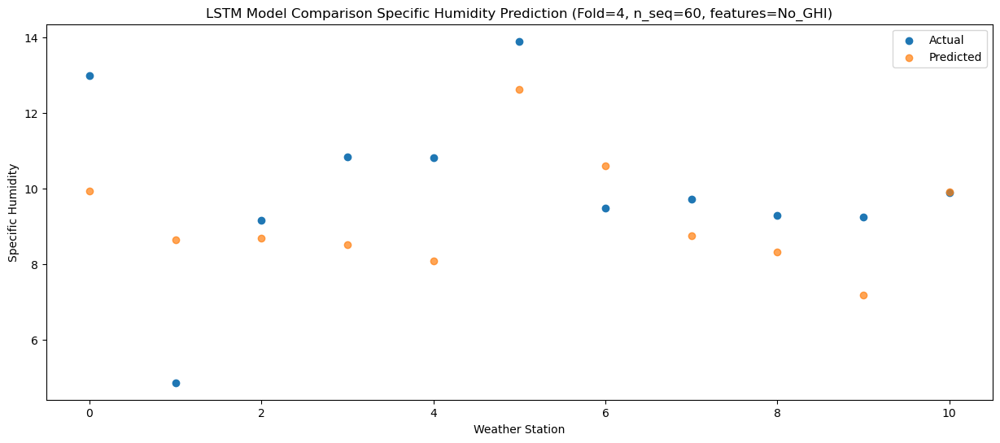

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  10.945142
1                 1    6.08   9.644041
2                 2   10.80   9.691384
3                 3   11.41   9.526925
4                 4   11.19   9.079231
5                 5   14.92  13.628688
6                 6   11.08  11.596513
7                 7   10.66   9.757914
8                 8   10.55   9.328308
9                 9   10.64   8.172220
10               10   11.16  10.902311


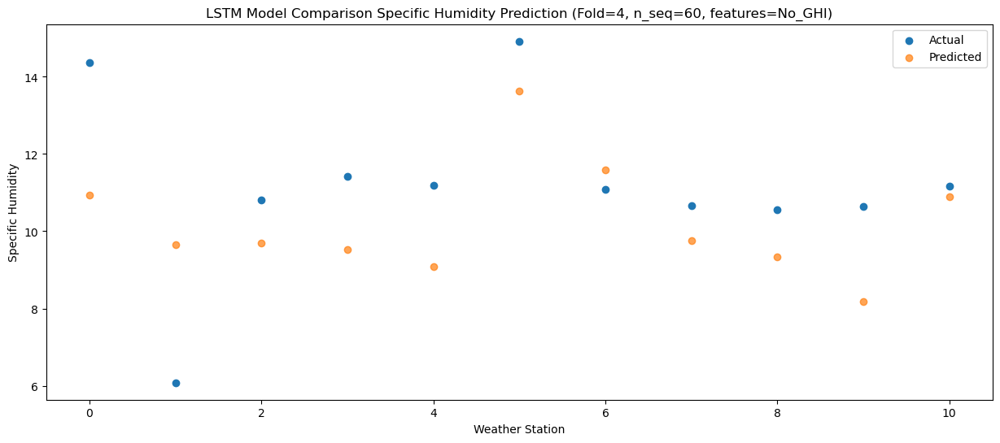

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  11.959169
1                 1    6.47  10.657203
2                 2   10.81  10.705039
3                 3   11.80  10.539246
4                 4   11.30  10.090878
5                 5   14.64  14.639913
6                 6   11.46  12.609652
7                 7   10.40  10.771170
8                 8   10.69  10.343935
9                 9   10.89   9.187437
10               10   12.03  11.919214


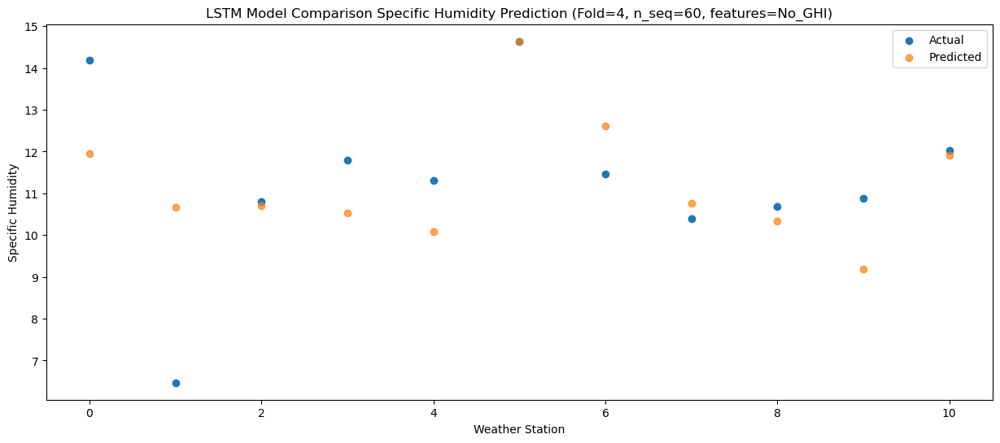

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61   8.723227
1                 1    5.67   7.425303
2                 2    7.87   7.471329
3                 3    7.79   7.301891
4                 4    7.40   6.851473
5                 5   11.39  11.400925
6                 6    7.88   9.375403
7                 7    7.14   7.534201
8                 8    7.21   7.106680
9                 9    6.86   5.949750
10               10    8.27   8.682421


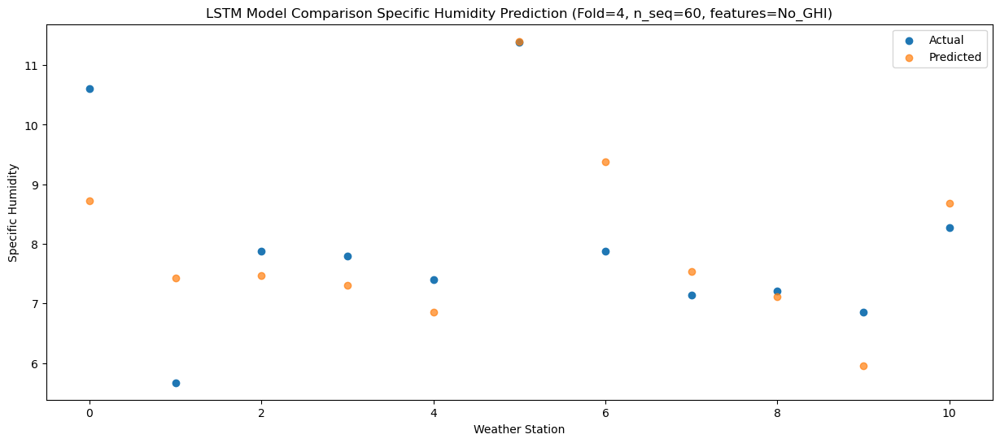

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   7.026029
1                 1    2.75   5.730509
2                 2    5.09   5.776457
3                 3    4.94   5.602135
4                 4    4.67   5.148652
5                 5    8.34   9.697651
6                 6    5.67   7.676374
7                 7    5.05   5.835277
8                 8    6.06   5.410603
9                 9    4.99   4.254527
10               10    7.26   6.989092


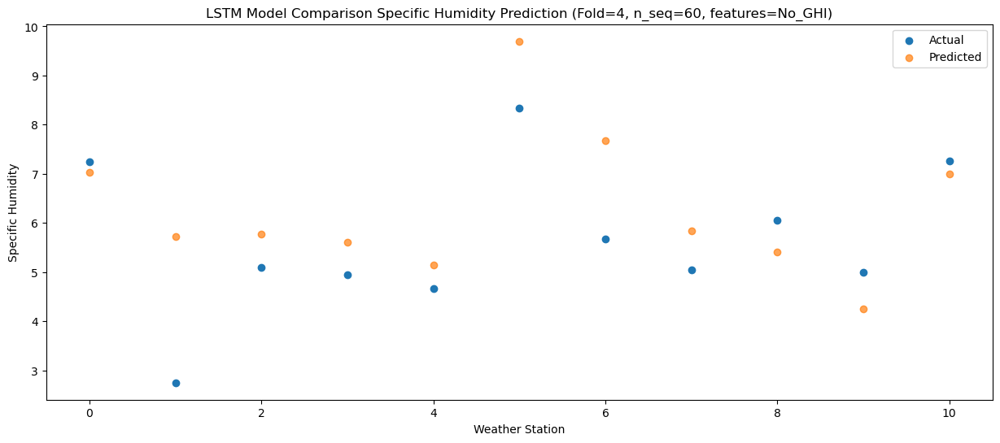

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   2.800775
1                 1   -1.91   1.502913
2                 2   -0.35   1.544448
3                 3    1.32   1.371895
4                 4    1.06   0.920201
5                 5    6.62   5.473236
6                 6   -0.05   3.444770
7                 7    0.36   1.604863
8                 8    0.29   1.179198
9                 9   -0.30   0.023768
10               10    2.02   2.756583


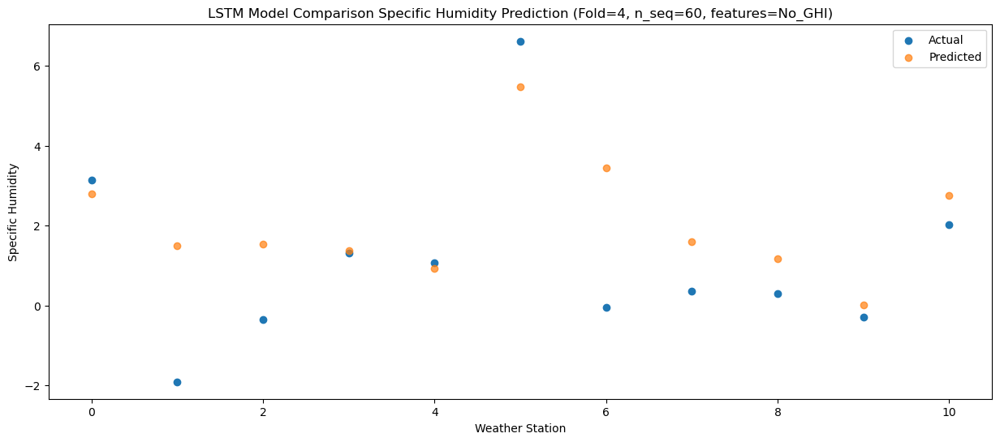

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94   2.573809
1                 1   -0.17   1.278215
2                 2    2.60   1.321964
3                 3    3.18   1.148822
4                 4    2.47   0.696084
5                 5    5.77   5.247241
6                 6    1.81   3.221250
7                 7    1.83   1.382608
8                 8    1.00   0.955895
9                 9    0.24  -0.198713
10               10    1.98   2.532234


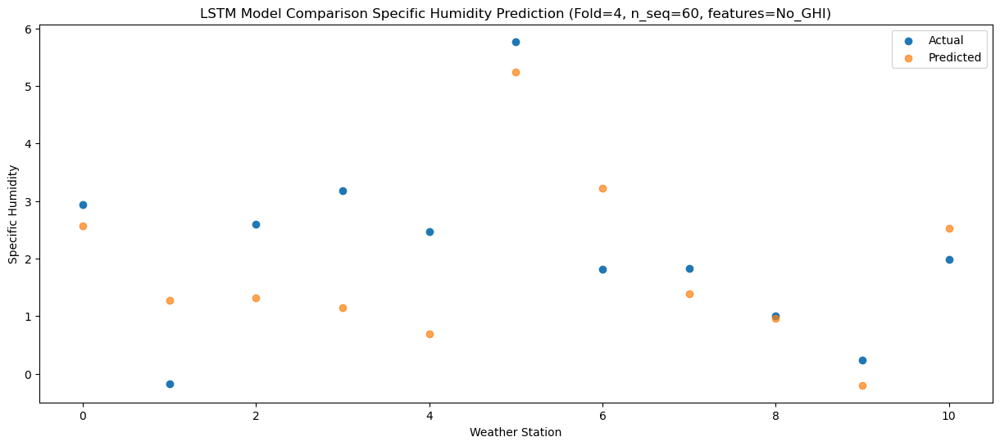

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93   0.799947
1                 1   -4.03  -0.497860
2                 2   -2.13  -0.454640
3                 3   -1.48  -0.627232
4                 4   -1.86  -1.079142
5                 5    4.31   3.472570
6                 6   -1.17   1.443559
7                 7   -1.37  -0.394318
8                 8   -1.38  -0.821761
9                 9   -2.00  -1.974901
10               10    0.24   0.754217


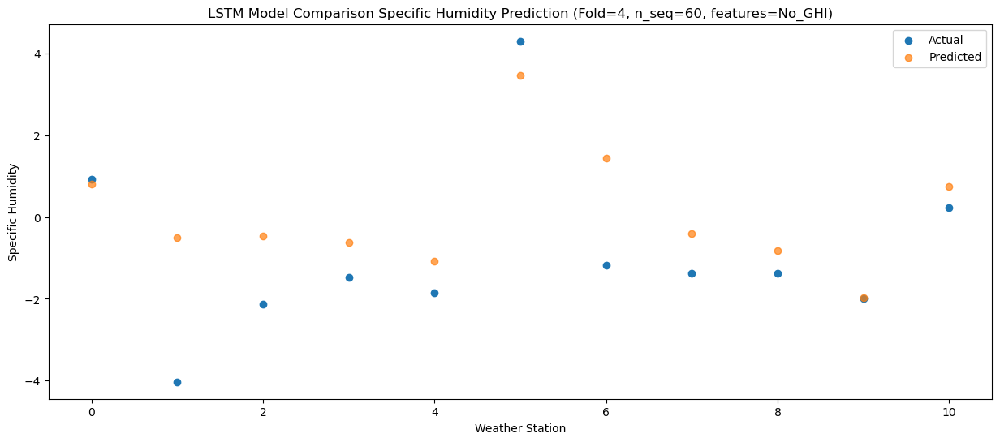

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15   1.182603
1                 1   -2.45  -0.114571
2                 2   -1.28  -0.072106
3                 3   -0.95  -0.247212
4                 4   -1.42  -0.700454
5                 5    4.30   3.852868
6                 6    0.15   1.826080
7                 7   -0.86  -0.012180
8                 8   -0.80  -0.437388
9                 9   -1.30  -1.590208
10               10    0.69   1.139985


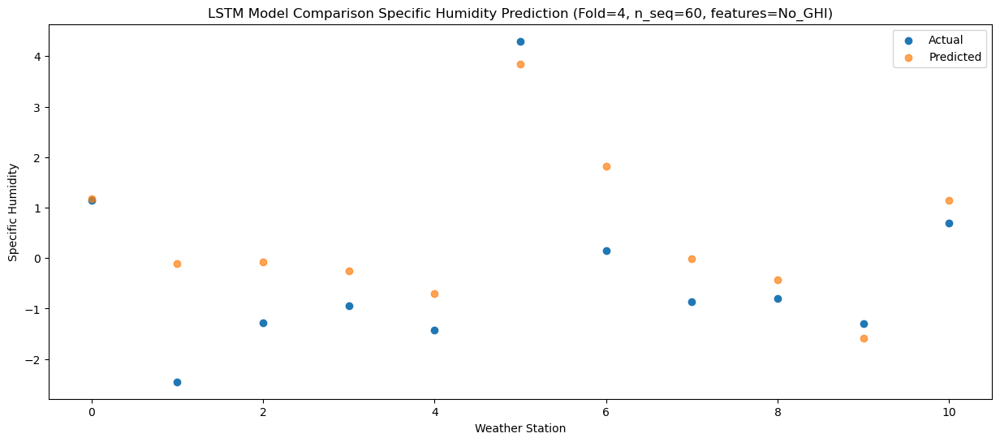

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   2.285246
1                 1   -0.92   0.983238
2                 2   -0.23   1.025652
3                 3    0.64   0.852202
4                 4    0.10   0.400360
5                 5    4.89   4.952884
6                 6    0.99   2.921494
7                 7    0.65   1.084750
8                 8    0.51   0.658604
9                 9    0.22  -0.493036
10               10    1.84   2.232925


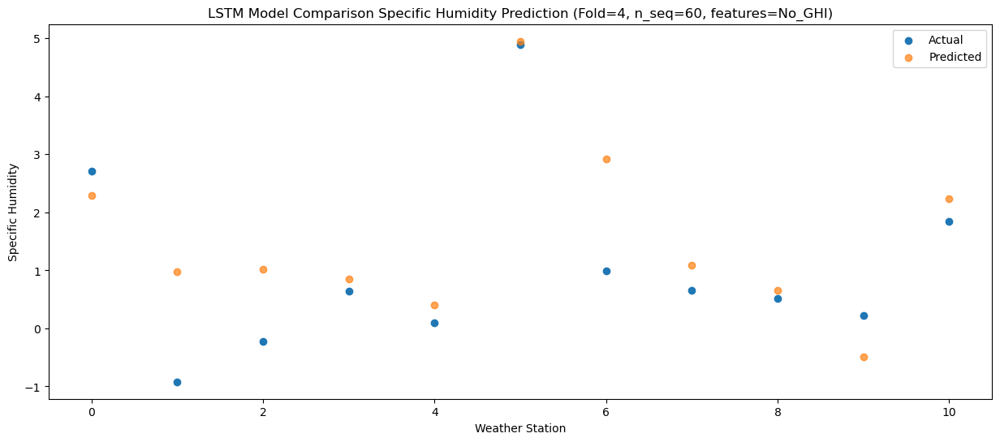

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   3.331244
1                 1    0.37   2.026170
2                 2    2.22   2.072201
3                 3    4.15   1.899770
4                 4    3.78   1.447359
5                 5    6.92   5.998647
6                 6    2.05   3.968663
7                 7    2.44   2.134567
8                 8    2.00   1.707105
9                 9    1.52   0.558148
10               10    2.83   3.282428


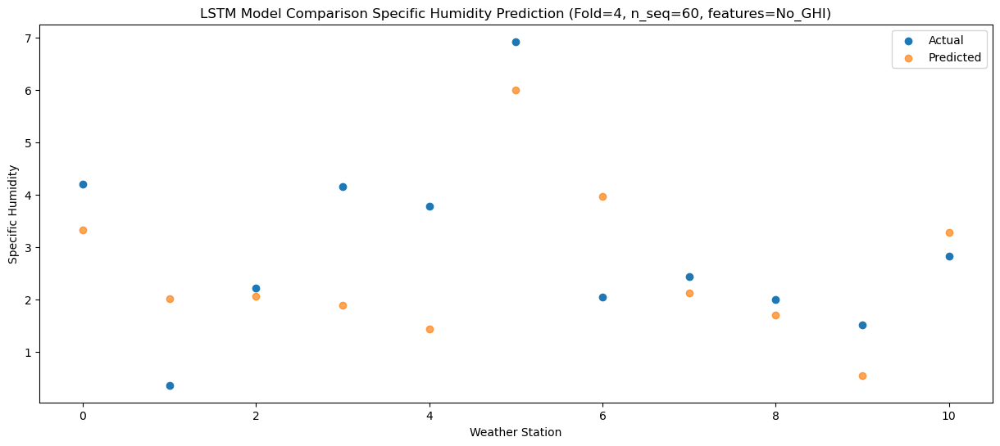

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   6.752268
1                 1    2.76   5.449301
2                 2    6.82   5.497628
3                 3    8.14   5.322374
4                 4    7.66   4.867711
5                 5    9.18   9.417885
6                 6    6.06   7.391347
7                 7    7.15   5.557683
8                 8    6.02   5.132677
9                 9    5.59   3.983546
10               10    6.29   6.709216


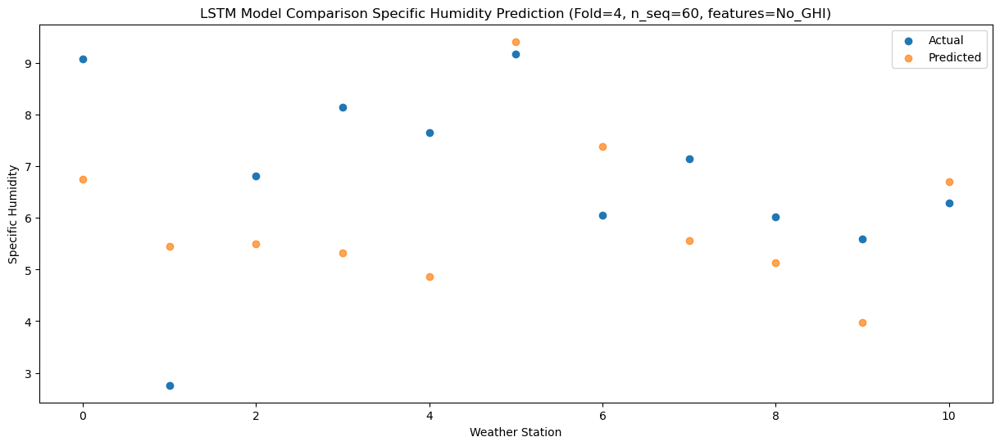

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31   8.483557
1                 1    5.66   7.181477
2                 2    9.20   7.228627
3                 3    9.91   7.049888
4                 4    9.34   6.593577
5                 5   12.03  11.147816
6                 6    8.34   9.121759
7                 7    9.51   7.286983
8                 8    7.46   6.862803
9                 9    7.83   5.713662
10               10    8.20   8.441886


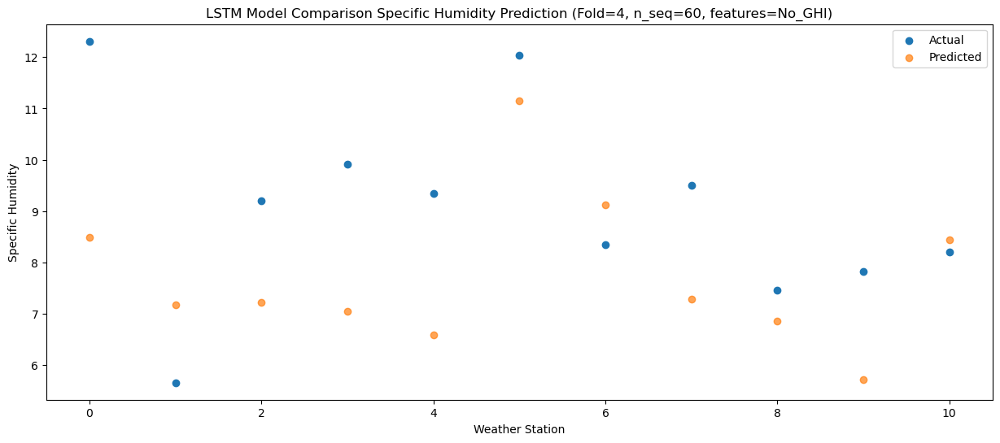

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94  10.658226
1                 1    6.69   9.354338
2                 2   11.04   9.401356
3                 3    9.33   9.221150
4                 4    8.84   8.763266
5                 5   12.72  13.317872
6                 6   11.50  11.289913
7                 7   10.31   9.456227
8                 8   10.20   9.033595
9                 9   10.47   7.886454
10               10    9.93  10.614707


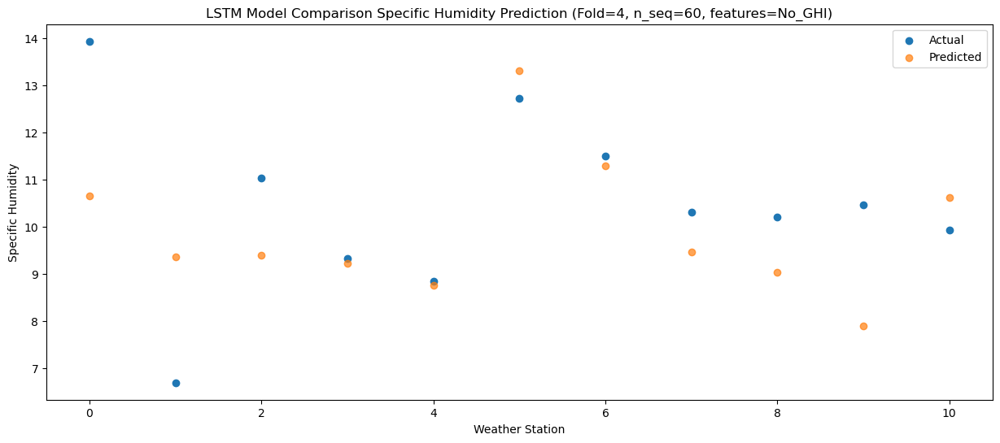

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73  11.021705
1                 1    6.77   9.716273
2                 2   10.86   9.758053
3                 3   10.34   9.581525
4                 4   10.01   9.125321
5                 5   14.71  13.682704
6                 6   10.31  11.646546
7                 7   10.78   9.814625
8                 8    9.84   9.391649
9                 9    9.70   8.244214
10               10   10.39  10.972388


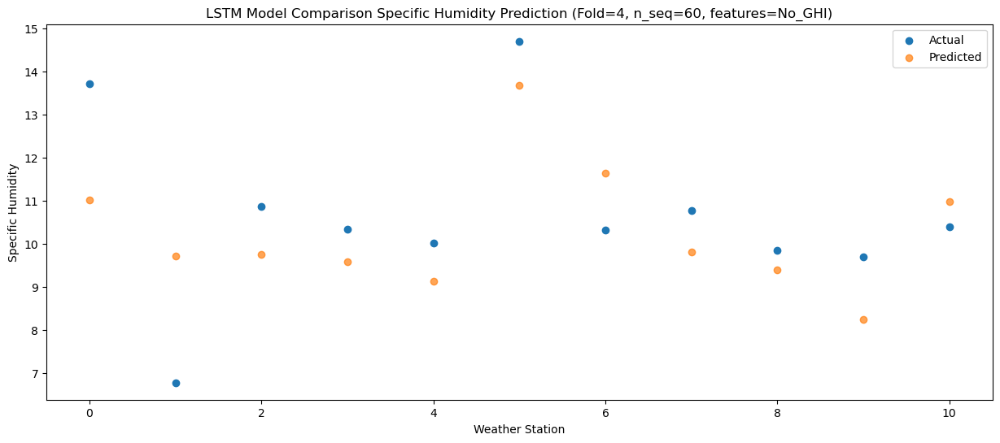

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03   8.352294
1                 1    5.90   7.046987
2                 2    6.62   7.084243
3                 3    7.06   6.909342
4                 4    6.86   6.455334
5                 5   13.46  11.015510
6                 6    6.76   8.973033
7                 7    6.97   7.139398
8                 8    7.18   6.712740
9                 9    6.33   5.564399
10               10    8.40   8.292061


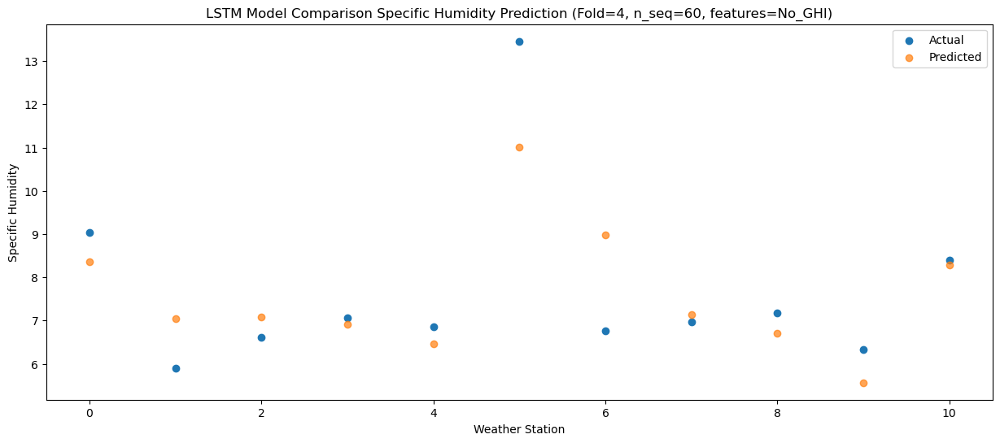

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   4.522244
1                 1    1.12   3.218079
2                 2    1.66   3.253400
3                 3    2.60   3.075291
4                 4    2.40   2.617487
5                 5    9.95   7.178275
6                 6    2.08   5.139328
7                 7    2.31   3.304581
8                 8    1.85   2.880002
9                 9    1.57   1.731680
10               10    3.58   4.464494


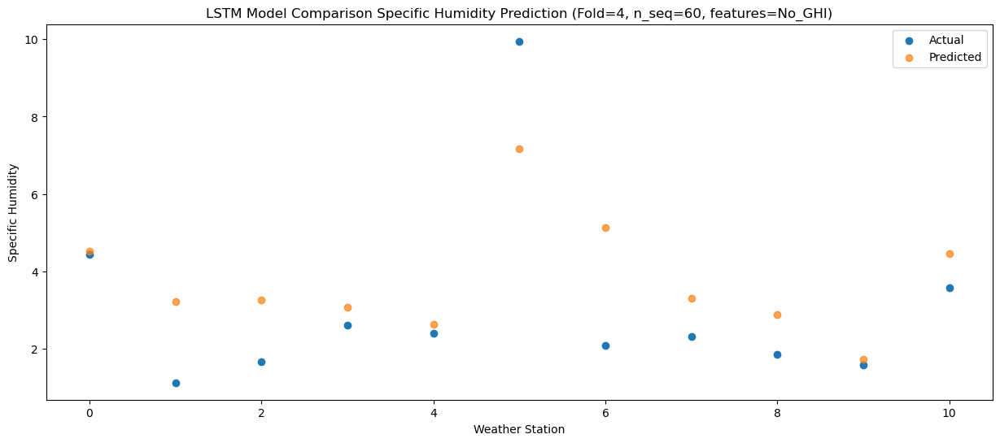

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   3.244109
1                 1    1.29   1.942888
2                 2    0.91   1.975745
3                 3    2.42   1.795791
4                 4    1.98   1.337146
5                 5    7.25   5.897895
6                 6    1.90   3.860085
7                 7    0.95   2.025634
8                 8    0.81   1.603587
9                 9    0.20   0.455960
10               10    2.86   3.187352


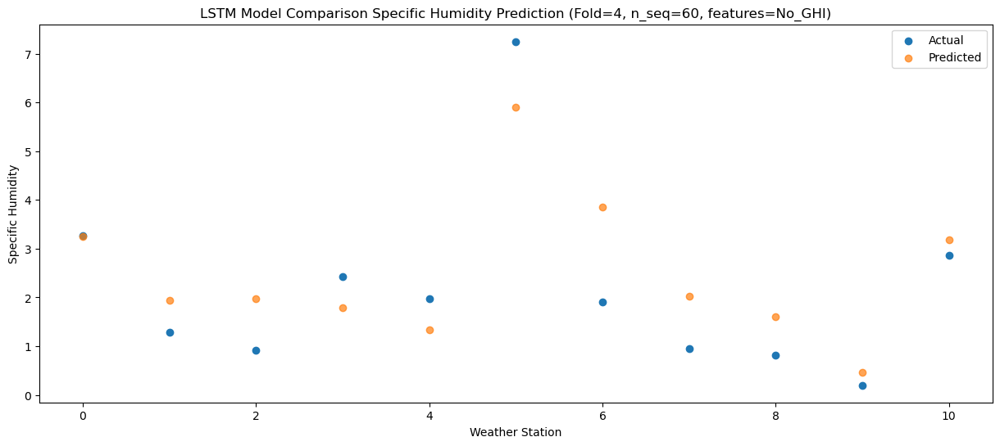

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93   1.773072
1                 1   -2.23   0.467020
2                 2    0.37   0.501427
3                 3    0.84   0.321749
4                 4    0.39  -0.136037
5                 5    6.61   4.424752
6                 6   -0.09   2.385920
7                 7    0.08   0.552645
8                 8   -0.15   0.131115
9                 9   -0.91  -1.015113
10               10    1.41   1.717430


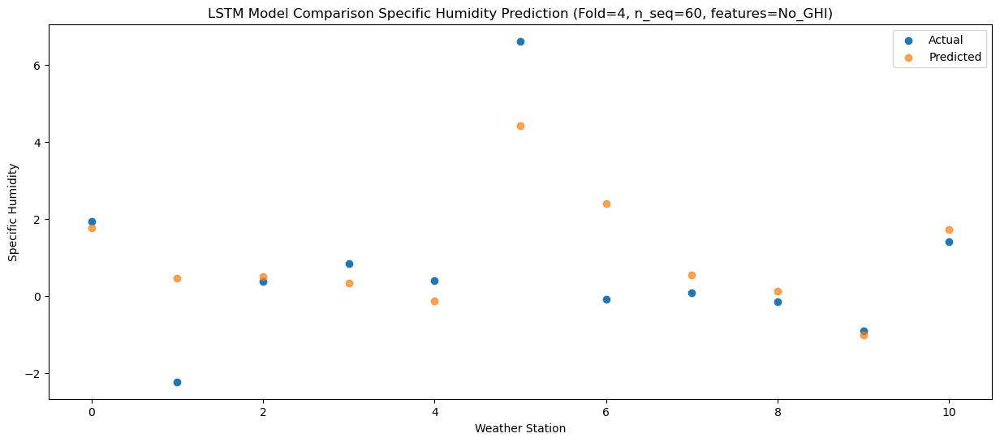

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28   2.153885
1                 1   -2.74   0.846596
2                 2    0.27   0.881305
3                 3    0.15   0.701670
4                 4   -0.36   0.244584
5                 5    5.06   4.806929
6                 6    0.54   2.765669
7                 7    0.36   0.934291
8                 8    0.47   0.510894
9                 9   -0.39  -0.635475
10               10    2.03   2.096631


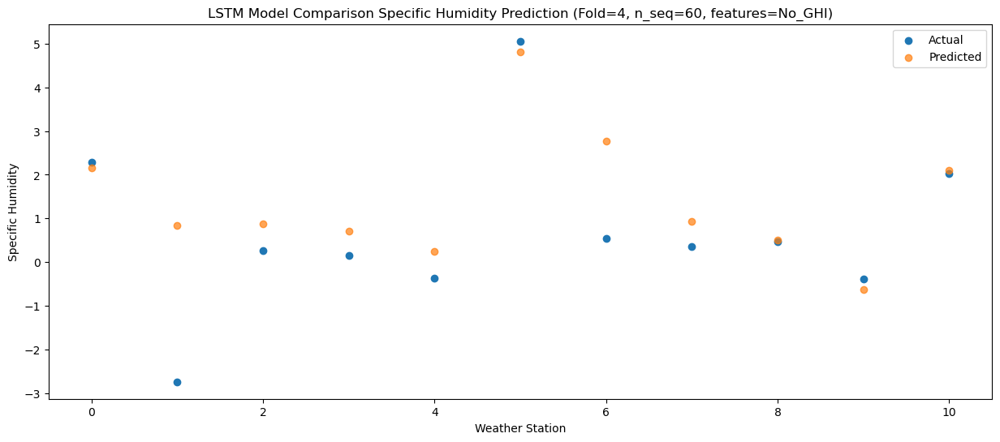

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23   1.584849
1                 1   -0.80   0.272235
2                 2    0.94   0.306163
3                 3    0.51   0.128461
4                 4    0.04  -0.327135
5                 5    5.18   4.237104
6                 6    1.58   2.188665
7                 7    0.17   0.357010
8                 8    0.07  -0.069087
9                 9   -0.62  -1.214398
10               10    1.28   1.515529


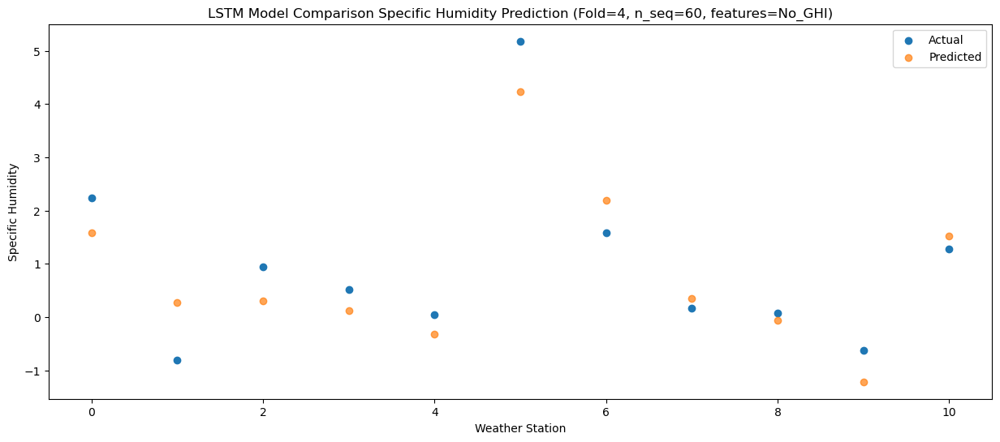

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.031228
1                 1   -0.42   0.718263
2                 2    1.27   0.749082
3                 3    2.57   0.571302
4                 4    2.01   0.115179
5                 5    6.47   4.681928
6                 6    1.07   2.628953
7                 7    0.93   0.796932
8                 8    0.42   0.369551
9                 9   -0.01  -0.775110
10               10    1.49   1.954116


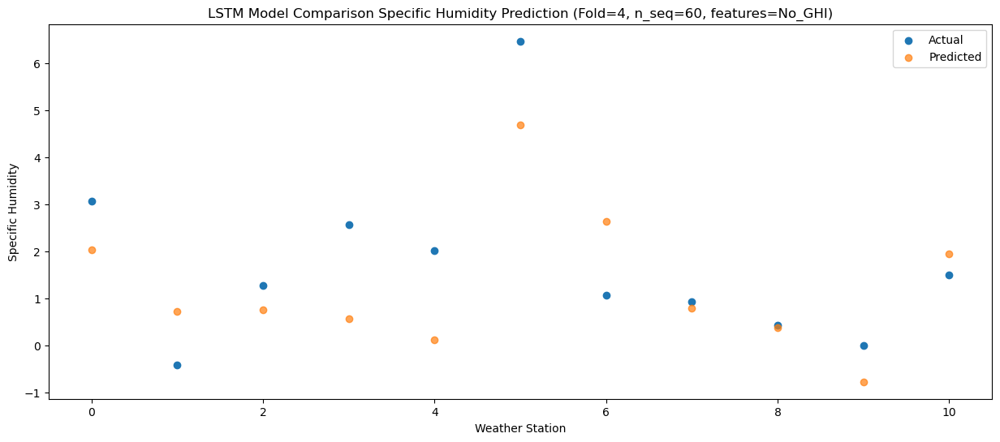

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   3.843652
1                 1    1.07   2.530029
2                 2    2.11   2.561060
3                 3    3.25   2.381277
4                 4    2.86   1.924206
5                 5    6.44   6.493021
6                 6    2.67   4.442079
7                 7    1.83   2.610044
8                 8    1.87   2.183027
9                 9    1.50   1.038084
10               10    3.19   3.769444


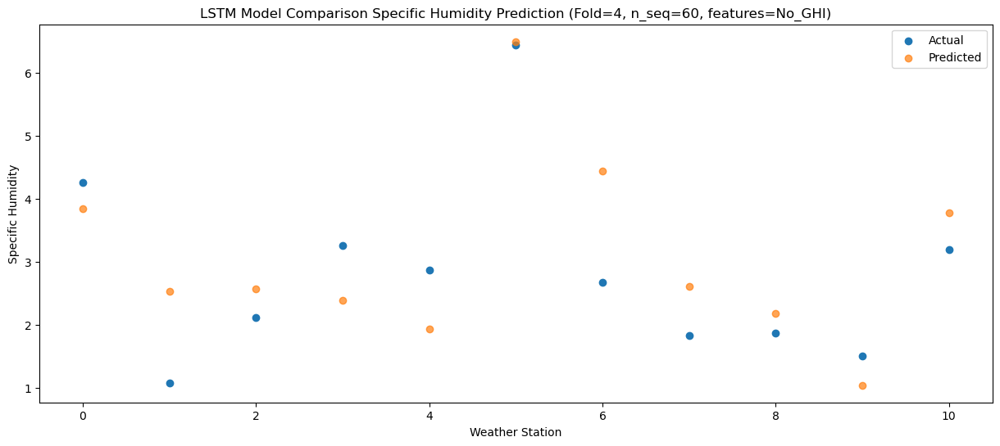

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   5.109724
1                 1    1.87   3.794500
2                 2    5.49   3.825508
3                 3    7.51   3.644659
4                 4    7.13   3.188433
5                 5   11.28   7.759398
6                 6    4.89   5.705887
7                 7    6.22   3.874897
8                 8    4.12   3.447768
9                 9    4.28   2.301575
10               10    4.09   5.030438


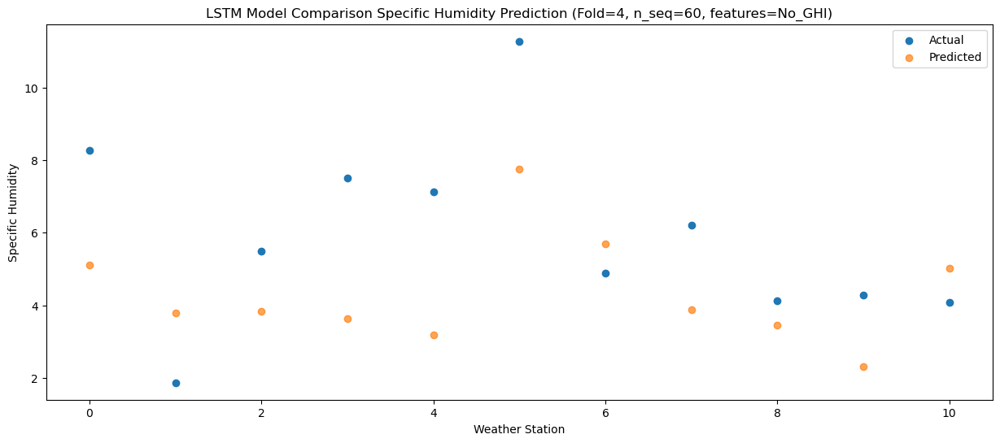

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81   8.578666
1                 1    5.38   7.255482
2                 2    9.06   7.286179
3                 3   11.45   7.105752
4                 4   10.61   6.649233
5                 5   15.14  11.220919
6                 6    7.94   9.164573
7                 7    8.78   7.339055
8                 8    6.08   6.914460
9                 9    5.92   5.772448
10               10    7.33   8.501389


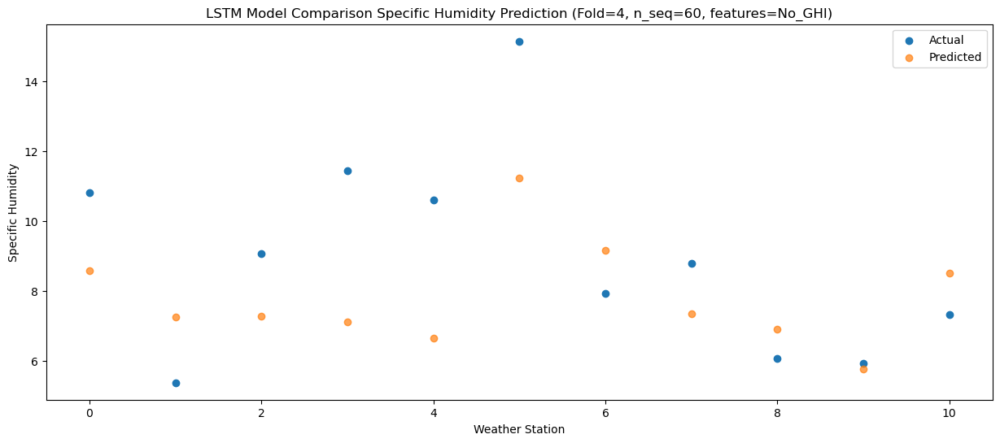

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50  11.431306
1                 1    7.29  10.111028
2                 2   10.65  10.144275
3                 3   11.30   9.957948
4                 4    9.71   9.498769
5                 5   12.81  14.069289
6                 6   11.33  12.020419
7                 7   11.57  10.194343
8                 8   10.38   9.772710
9                 9   10.62   8.631401
10               10   10.95  11.363073


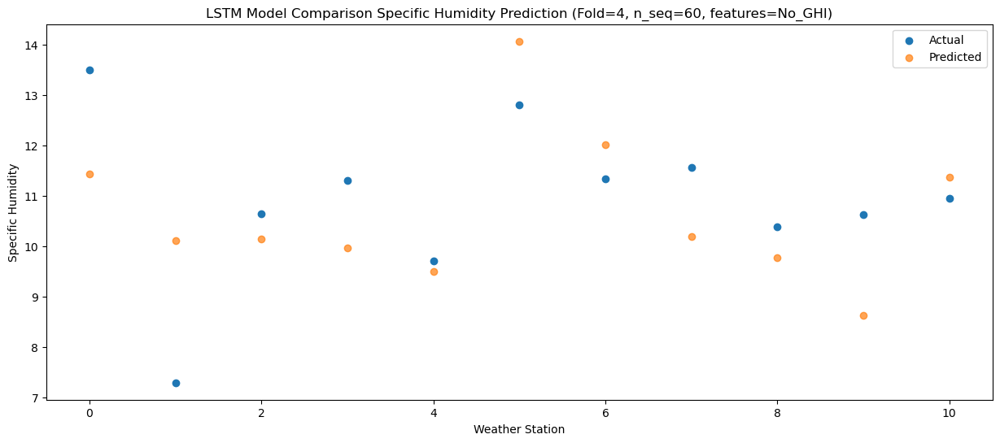

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43  10.206308
1                 1    7.59   8.882666
2                 2    9.07   8.915527
3                 3    9.20   8.731185
4                 4    8.33   8.273666
5                 5   11.95  12.844592
6                 6   10.87  10.792279
7                 7   11.85   8.966811
8                 8    9.84   8.543637
9                 9   10.49   7.402097
10               10   10.15  10.133072


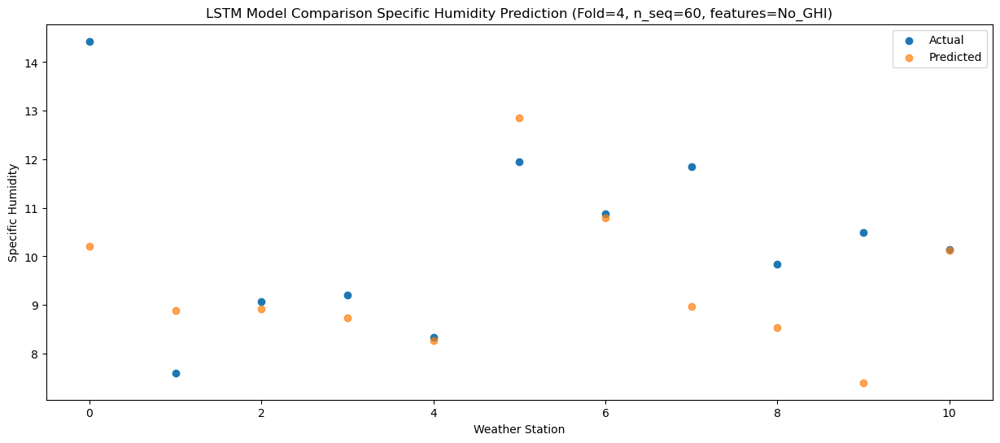

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51   8.509995
1                 1    5.14   7.184500
2                 2    6.05   7.214119
3                 3    8.30   7.031382
4                 4    8.00   6.574535
5                 5   12.46  11.146102
6                 6    7.42   9.091514
7                 7    7.65   7.268307
8                 8    7.04   6.845680
9                 9    6.71   5.705259
10               10    8.44   8.436963


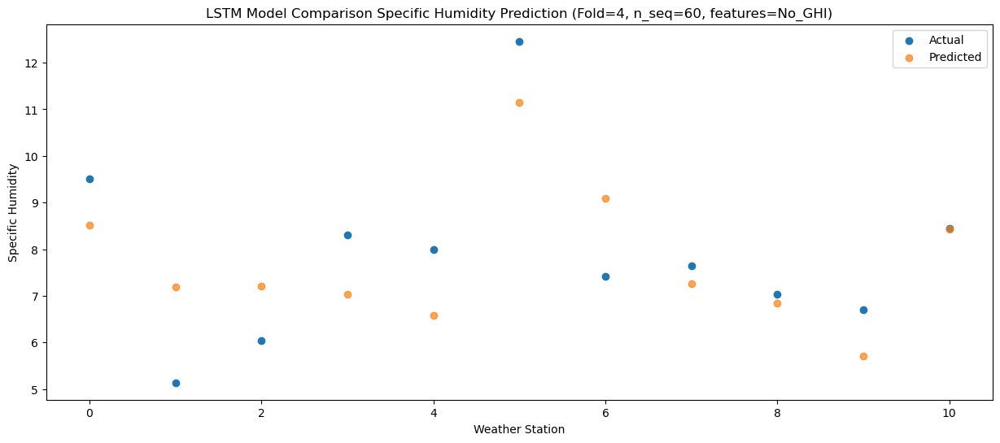

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   5.709937
1                 1    1.52   4.384565
2                 2    2.12   4.413434
3                 3    4.58   4.230174
4                 4    4.34   3.773372
5                 5   10.33   8.344462
6                 6    3.51   6.288557
7                 7    4.04   4.467007
8                 8    3.71   4.043753
9                 9    3.27   2.904490
10               10    5.38   5.635535


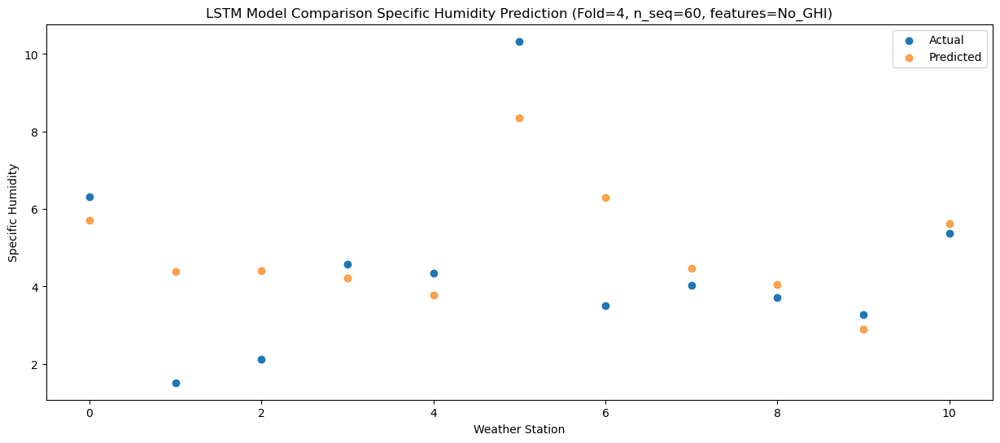

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   2.407291
1                 1   -0.78   1.088135
2                 2    0.14   1.114840
3                 3    2.05   0.929676
4                 4    1.92   0.471458
5                 5    8.03   5.041102
6                 6    0.56   2.984727
7                 7    1.01   1.161369
8                 8    0.64   0.738265
9                 9   -0.12  -0.401559
10               10    1.94   2.328040


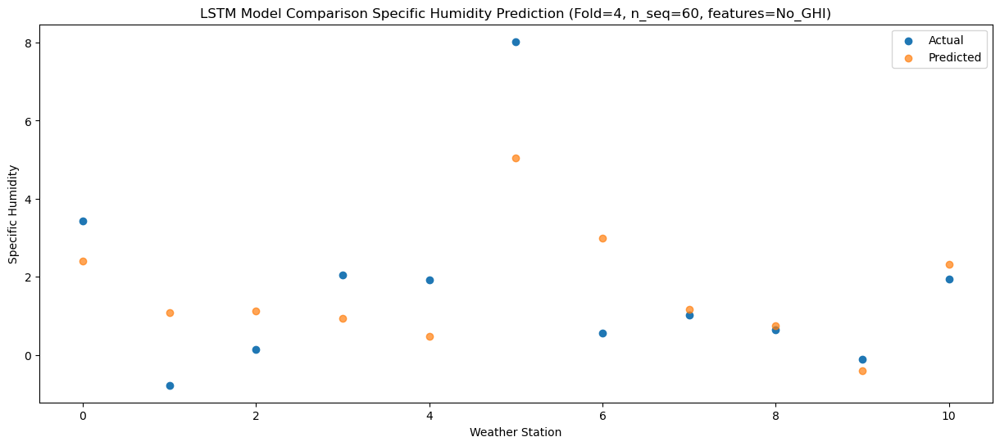

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   2.565380
1                 1   -1.87   1.246536
2                 2   -1.17   1.274072
3                 3    0.30   1.086060
4                 4    0.16   0.627775
5                 5    6.45   5.198242
6                 6    0.28   3.143978
7                 7    0.20   1.317861
8                 8    0.61   0.895681
9                 9    0.37  -0.244349
10               10    2.46   2.486111


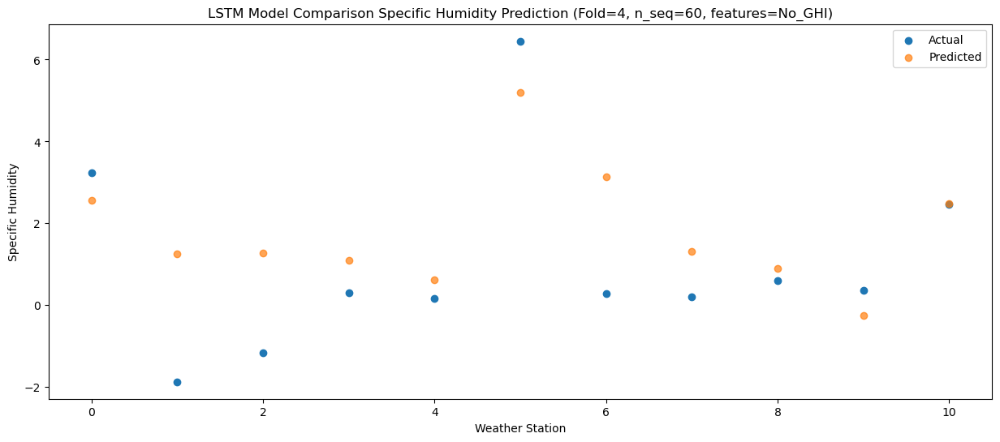

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54   1.398508
1                 1   -2.91   0.075204
2                 2   -1.89   0.105310
3                 3   -0.98  -0.082031
4                 4   -1.26  -0.541379
5                 5    5.18   4.028719
6                 6   -0.50   1.973478
7                 7   -0.95   0.149849
8                 8   -0.47  -0.271461
9                 9   -1.09  -1.411067
10               10    1.39   1.319099


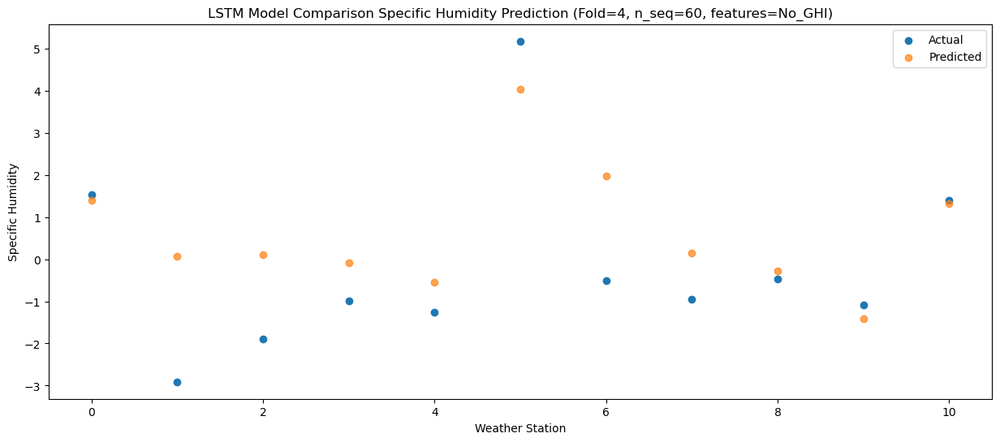

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.779783
1                 1   -3.60   0.455056
2                 2   -0.46   0.485863
3                 3    1.36   0.298332
4                 4    1.09  -0.160916
5                 5    5.53   4.409981
6                 6   -0.32   2.352410
7                 7    0.41   0.528790
8                 8    0.11   0.106906
9                 9   -0.17  -1.032771
10               10    1.41   1.697709


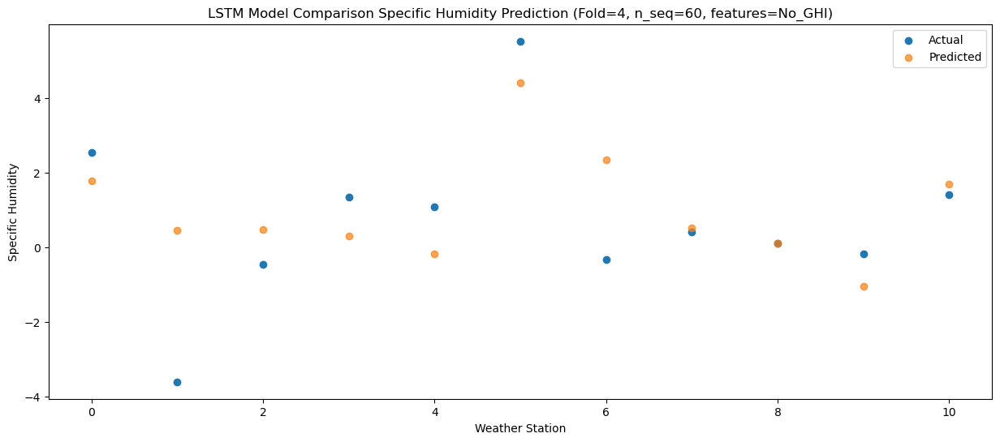

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   2.501322
1                 1   -0.31   1.179607
2                 2    1.17   1.211111
3                 3    3.15   1.020001
4                 4    3.04   0.559378
5                 5    6.67   5.131980
6                 6    1.25   3.073717
7                 7    1.62   1.249470
8                 8    1.18   0.826317
9                 9    0.80  -0.313900
10               10    2.48   2.415462


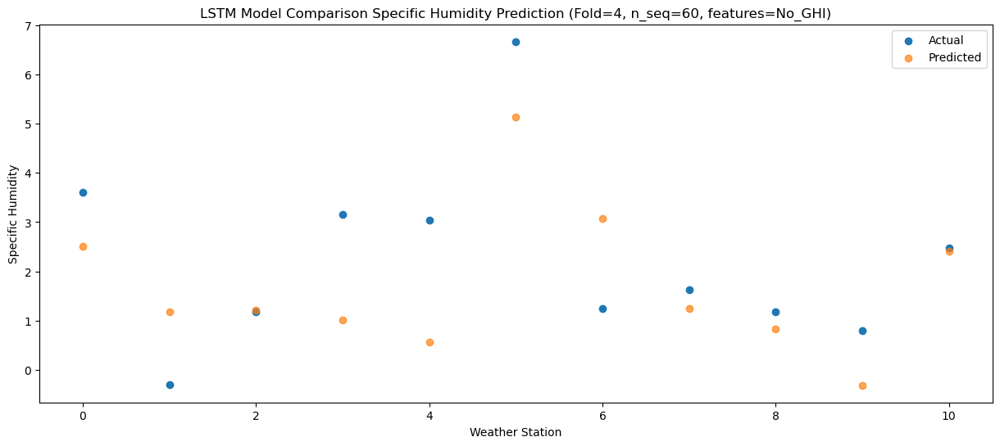

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   3.876360
1                 1   -0.91   2.555462
2                 2    3.35   2.586268
3                 3    5.52   2.392430
4                 4    5.54   1.930216
5                 5    7.27   6.500875
6                 6    3.17   4.447256
7                 7    3.35   2.623814
8                 8    3.21   2.204593
9                 9    2.52   1.066991
10               10    4.26   3.798487


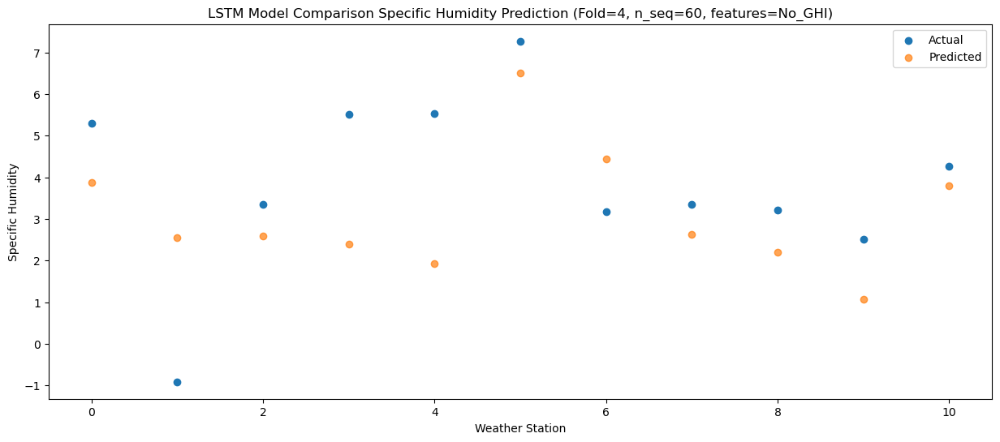

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36   7.317385
1                 1    1.68   5.995184
2                 2    7.67   6.023951
3                 3    9.09   5.830760
4                 4    8.97   5.367770
5                 5   10.03   9.938037
6                 6    7.17   7.883391
7                 7    7.77   6.059922
8                 8    6.70   5.640549
9                 9    6.06   4.502337
10               10    7.18   7.233417


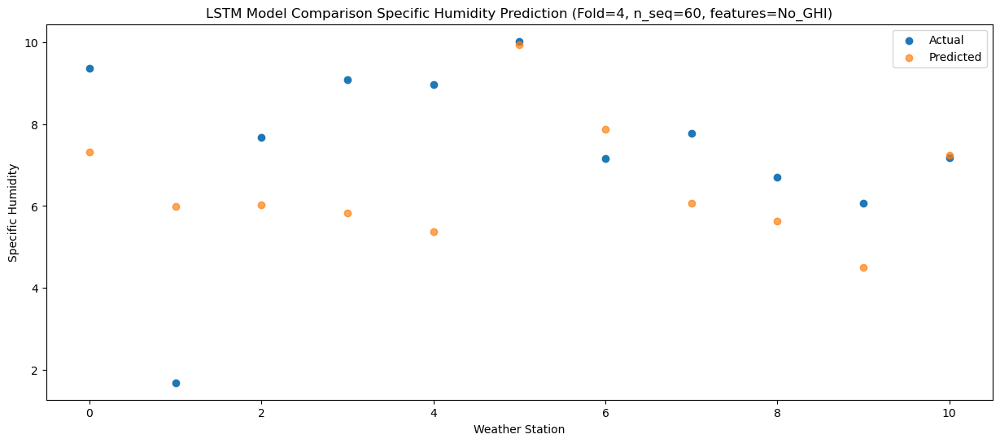

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62   9.472910
1                 1    3.14   8.148604
2                 2    9.01   8.177603
3                 3   11.03   7.985897
4                 4   11.08   7.522702
5                 5   14.56  12.095269
6                 6    8.93  10.036147
7                 7    9.75   8.213555
8                 8    8.39   7.791379
9                 9    8.82   6.653464
10               10    9.73   9.383031


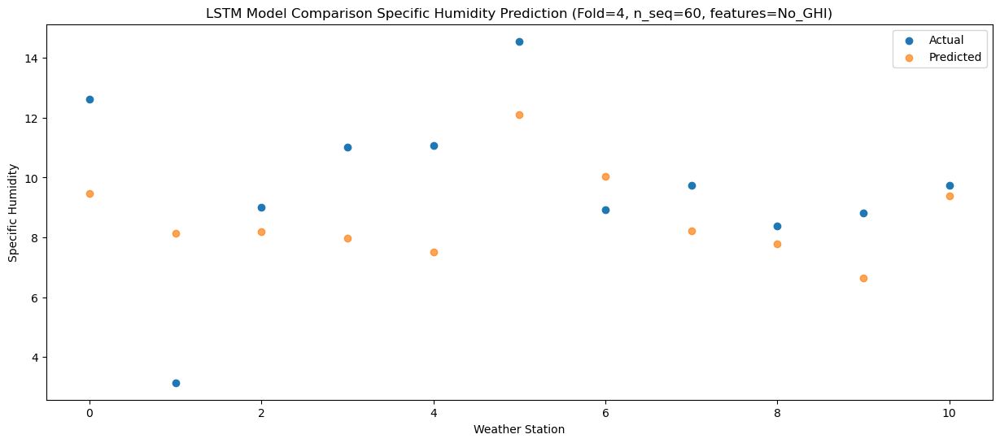

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81  11.277063
1                 1    4.60   9.955033
2                 2   11.04   9.984569
3                 3   10.99   9.788441
4                 4   10.61   9.322699
5                 5   14.44  13.895167
6                 6   11.32  11.839693
7                 7   10.73  10.015977
8                 8    9.69   9.594899
9                 9   10.43   8.457404
10               10   10.85  11.188772


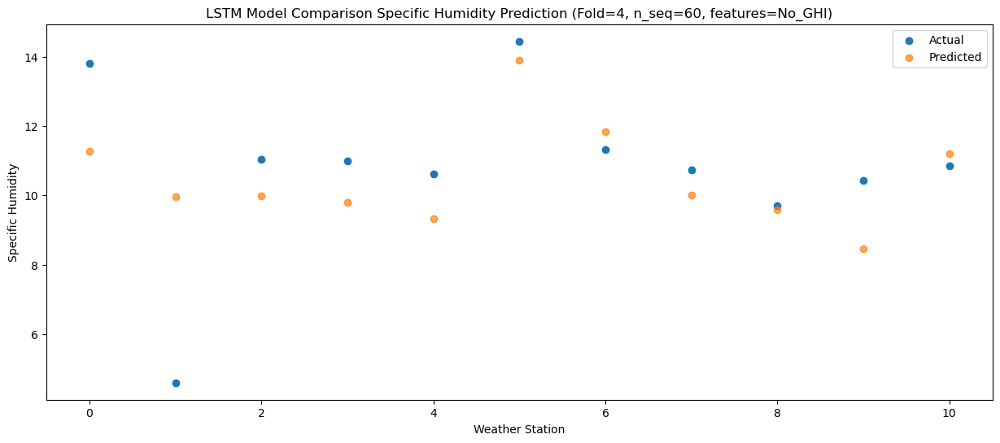

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65  10.267111
1                 1    7.21   8.937276
2                 2    8.73   8.972322
3                 3   10.28   8.779021
4                 4    9.84   8.314781
5                 5   13.24  12.886784
6                 6   10.58  10.828308
7                 7    9.44   9.008238
8                 8    9.33   8.584799
9                 9   10.07   7.449103
10               10   10.83  10.175875


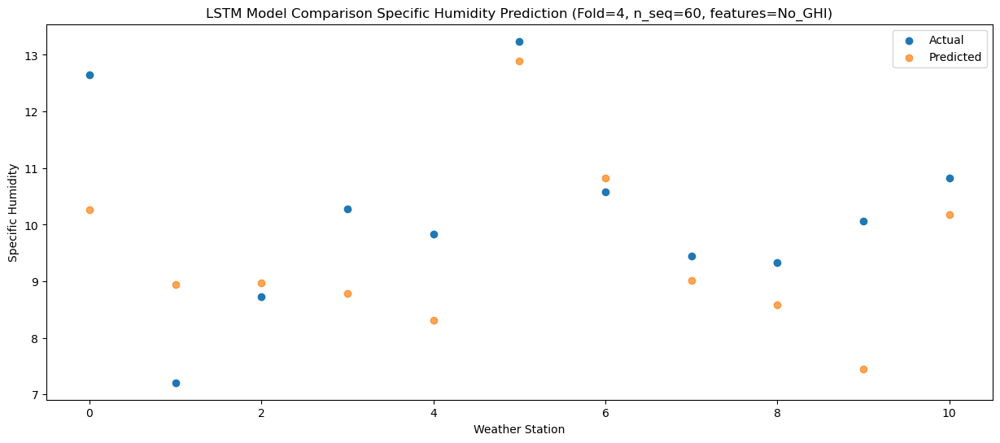

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35   8.298845
1                 1    7.02   6.968462
2                 2    7.63   7.002717
3                 3    7.75   6.809700
4                 4    7.68   6.345774
5                 5   12.36  10.918666
6                 6    8.26   8.859919
7                 7    7.40   7.039292
8                 8    6.65   6.615160
9                 9    6.57   5.480528
10               10    8.76   8.206707


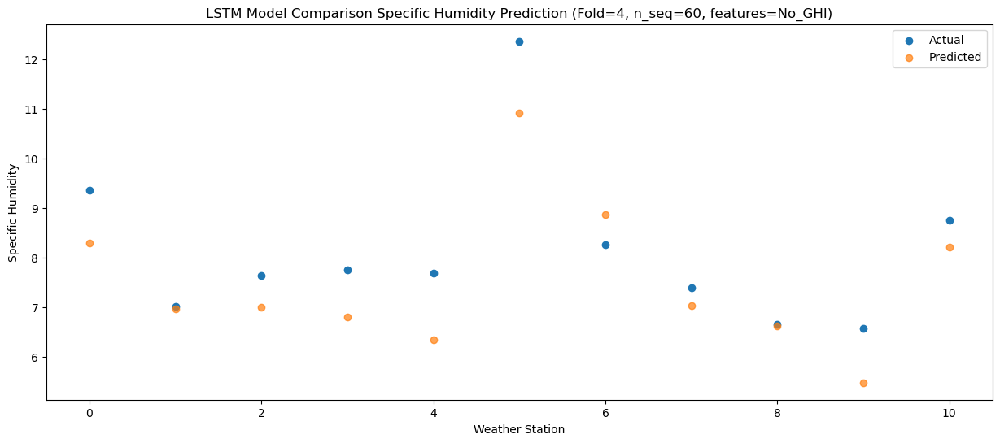

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22   4.738237
1                 1    2.60   3.407591
2                 2    2.84   3.440777
3                 3    4.29   3.248525
4                 4    3.94   2.784552
5                 5    8.67   7.357059
6                 6    3.86   5.298359
7                 7    3.08   3.478193
8                 8    3.07   3.054877
9                 9    2.47   1.921048
10               10    4.65   4.648755


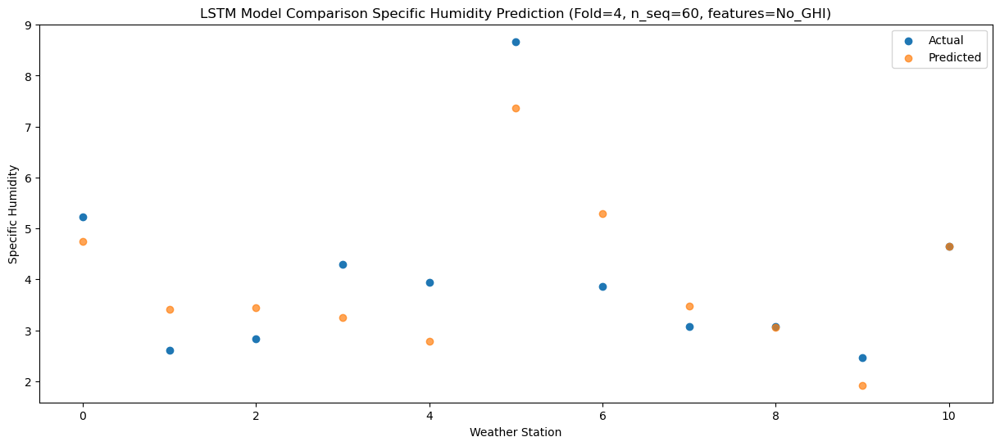

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (1, 1, 1024)              11632640  
                                                                 
 dropout_8 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_9 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_9 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_12 (Dense)            (1, 256)                  262400    
                                                                 
 dense_13 (Dense)            (1, 128)                  32896     
                                                                 
 dense_14 (Dense)            (1, 60)                  

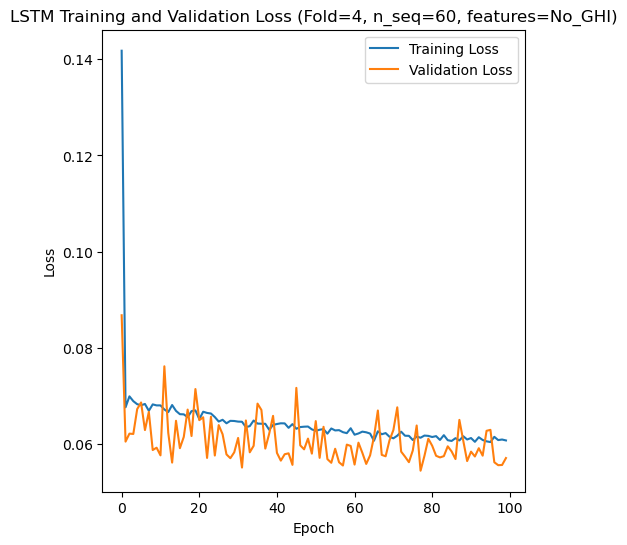

[[1.5598653059198122, 1.2068515154549342, 1.2594516629389731, 0.9359504839981075, 1.2860045375097011, 1.2662870846142018, 1.319091893295234, 1.1325104365628063, 1.4388323670195589, 0.8840707594129672, 0.9078385783242083, 0.3455033645111199, 1.0224735164059089, 1.7488263075645485, 1.4693058131869121, 1.1709299688499861, 1.0614102677587967, 1.30482957296699, 1.4693395481986675, 1.3289530616504337, 1.4001614978068948, 1.3279027679593034, 1.0987346096909705, 1.238689981137794, 1.9646402856761103, 1.3162948131152863, 1.61088088197597, 1.1787615317332056, 1.15495879487869, 1.2847977557637995, 1.2248714538293388, 1.3592980966605903, 1.7163253599817996, 1.4525619258270814, 1.2752331681839966, 1.6523342731094042, 1.2120205003956486, 1.4792581563260203, 1.3216804009218772, 0.7236952995388151, 1.138639570603974, 0.9826827785721066, 1.6083203095471805, 1.7613933225776943, 1.49228134255881, 1.3206389697786085, 1.3584832173248718, 1.9651005179430205, 1.7386316378221833, 2.1765156727933226, 1.9990662

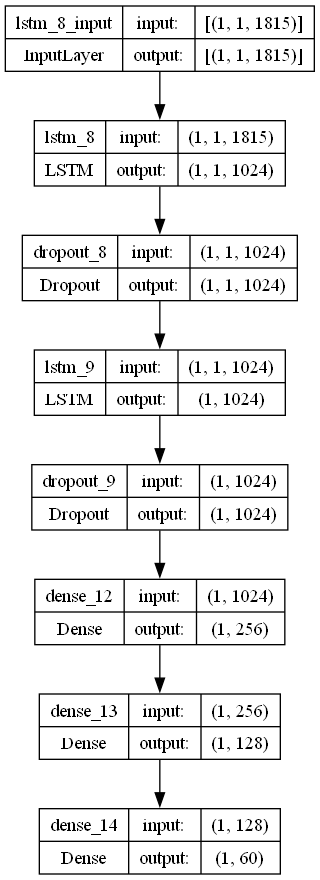

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.06159798934538093
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.33005465858705746

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [3]:
print(np.mean(mape_avg_list[0]))

1.4535929730974388


In [4]:
print(np.mean(mape_avg_list[1]))

8899061768853.57


In [5]:
print(np.mean(mape_avg_list[2]))

1.3525074841897733


In [6]:
print(np.mean(mape_avg_list[3]))

12146741294511.916


In [7]:
print(np.mean(mape_avg_list[4]))

0.9507018718865755


In [8]:
print(mape_avg_list[1])

[1.0607776279991006, 1.7150599280674135, 369083592571284.75, 13.514523580593055, 0.5548248438117604, 5.897138496557443, 0.2592736524450207, 0.11864461993701324, 0.13859349753206882, 0.09054329874102524, 0.08674850677600959, 0.11205244435446109, 1.963095599846843, 2.1820651078341977, 3.210474305930002, 1.8715690183235478, 2.0344744775134895, 9.692342493289303, 0.4160375865332325, 0.15817004057869927, 0.11059076349929912, 0.12494679109005452, 0.12239359368144903, 0.3726310415552929, 1.0412022822811444, 1.5819670414884812, 1.4110322315550432, 3.1496002103555485, 17.159357096653693, 164860113559820.62, 0.23195984171255846, 0.14742400431730898, 0.08186667373053137, 0.06460445665871983, 0.14432437254772867, 5.974321411992549, 2.4060202186590205, 1.6008284251245606, 1.1630907126990893, 8.616850666377294, 1.9394219804203277, 0.49626823793093405, 0.35678375502277215, 0.22225899108526878, 0.11381821980879354, 0.10668326595749145, 0.11522093655977592, 0.43298389710812446, 0.9159035319388071, 1.19

In [9]:
print(mape_avg_list[3])

[0.9465698914355449, 1.014927393860044, 1.7551089745032982, 1.3983976012952324, 0.9753748654541051, 0.8191296266785334, 0.3657882188277881, 0.22926712120509674, 0.295558263327714, 0.17596724564054933, 0.13869710250971073, 0.27468385355380714, 0.8613596781748488, 0.9361613026547212, 0.8034214762158794, 0.6680517399989849, 722185518296597.8, 0.7651633264054089, 0.6161248285757916, 0.26448367386077953, 0.187762707058475, 0.24777639042576993, 0.21703384836606565, 0.28426888731340383, 1.7120969762129692, 1.4842003929126348, 0.6635073706601207, 0.8133087100460415, 4.7710537784960305, 0.8492014425591473, 0.3390637158051668, 0.3003899296370116, 0.20914478304338163, 0.19893331231009226, 0.205205885941736, 0.9975617287980069, 1.6241154483554185, 4.099325328325598, 1.587814576494566, 1.4463066271227065, 3.5784539039089633, 0.9132378466972824, 2.4747159622991224, 0.23031579143002115, 0.2260118955151037, 0.17751010699850744, 0.1430650831515433, 0.9035961074430137, 3.6842737568611086, 1.410808858627

In [10]:
print(mape_avg_list[1][2])

369083592571284.75


In [11]:
print(mape_avg_list[1][29])

164860113559820.62


In [12]:
print(mape_avg_list[3][16])

722185518296597.8


In [13]:
print(mape_avg_list[3][51])

6618959374047.215


In [14]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

89.97151375679914


In [15]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

68.17215079991674


In [16]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(89.97151375679914/58))

MAPE Average for Fold 2 (removing >1e14 values): 1.5512329958068818


In [17]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(68.17215079991674/58))

MAPE Average for Fold 4 (removing >1e14 values): 1.175381910343392


In [18]:
print("Average MAPE: "+str((1.4535929730974388+1.5512329958068818+1.3525074841897733+1.175381910343392+0.9507018718865755)/5))

Average MAPE: 1.2966834470648123
